In [1]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, Conv1D, MaxPooling1D, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot
    
# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for temperature
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for temperature
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for temperature
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    #print("Agg:")
    agg.columns = names
    #print(type(agg))
    #print(agg)

    #print("Test columns:")
    #print(agg.iloc[:, -36]) # Column containing response actual values (temperature) at time t

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    print(n_vars)
    print(len(data))
    print(type(data))

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    #print("Diff values:")
    #print(len(diff_values))
    #print(len(diff_values[0]))
    #print(len(diff_values_for_training))
    #print(len(diff_values_for_training[0]))
    
    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    #diff_values_training = np.array(diff_values_for_training)
    #diff_values_training = diff_values_training.reshape(1, -1) 
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (temperatures) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    #print("Scaled values rows:")
    #print(len(scaled_values))

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        #print("Batch "+str(ws+1)+":")
        #print("Range: "+str(first)+"-"+str(last))
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
        #print("Supervised count:")
        #print(len(supervised_values))
        #print(len(supervised_values[0]))
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    print(n_vars)
    print(len(data))
    print(type(data))

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)


    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    #print("Diff values:")
    #print(len(diff_values))
    #print(len(diff_values[0]))
    #print(len(diff_values_for_training))
    #print(len(diff_values_for_training[0]))
    
    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        #print("Batch "+str(ws+1)+":")
        #print("Range: "+str(first)+"-"+str(last))
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
        #print("Supervised count:")
        #print(len(supervised_values))
        #print(len(supervised_values[0]))
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)
    
X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    #new_df = new_df.iloc[:180, :]
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['temperatures'].iloc[j])
    y.append(add_to_y)
    #new_df = new_df.drop(['temperatures'], axis=1)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
    #print("Train_X Fold "+str(i)+":")
    #print(len(train_X[i]))
    #print(len(train_X[i][0]))
    #print(len(train_X[i][0][0])) 
    #print("Train_y Fold "+str(i)+":")
    #print(len(train_y[i]))
    #print(len(train_y[i][0]))
    #print(train_y[i][0][0])
    #print("Validation_X Fold "+str(i)+":")
    #print(len(val_X[i]))
    #print(len(val_X[i][0]))
    #print(len(val_X[i][0][0]))
    #print("Validation_y Fold "+str(i)+":")
    #print(len(val_y[i]))
    #print(len(val_y[i][0]))
    #print(val_y[i][0][0])
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df)

    #print(len(dataset))
    #print(len(dataset[0]))
    #print(len(dataset_scaling))
    #print(len(dataset_scaling[:][0]))
    #print("Stop")
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['temperatures']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df) 

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['temperatures']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + 12*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
    #X_train = train1[:][:-n_seq]
    #y_train = train1[:][-n_seq:]
    #X_test = test1[:][:-n_seq]
    #y_test = test1[:][-n_seq:]


Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
Fold 1
Fold 2
Fold 3
Fold 4
Fold 5
Fold 1:
12
84
<class 'list'>
12
21
<class 'list'>
(84, 1, 1, 2040)
(11, 1, 1, 2040)
(10, 1, 1, 2040)
(84, 1, 2040)
(11, 1, 2040)
(10, 1, 2040)
(84, 2040)
(11, 2040)
(10, 2040)
[[0.39307412 0.69695044 0.32924264 ... 0.45808019 0.42952612 0.37788578]
 [0.45747266 0.51683609 0.42215989 ... 0.49422843 0.47691373 0.38882139]
 [0.38487242 0.62674714 0.3411641  ... 0.51032807 0.38244228 0.37363305]
 ...
 [0.54100851 0.46473952 0.46949509 ... 0.48025516 0.45504253 0.40583232]
 [0.44896719 0.51620076 0.3997195  ... 0.49696233 0.45170109 0.39611179]
 [0.46780073 0.52414231 0.42356241 ... 0.49301337 0.4881531  0.43772783]]
Fold 2:
12
84
<class 'list'>
12
21
<class 'list'>
(84, 1, 1, 2040)
(11, 1, 1, 2040)
(10, 1, 1, 2040)
(84, 1, 2040)
(11, 1, 2040)
(10, 1, 2040)
(84, 2040)
(11, 2040)
(10, 2040)
[[0.38166311 0.

In [2]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 2040)
(11, 2040)


In [3]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit a CNN-LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    filters = trial.suggest_categorical('filters', [256, 512, 1024]) # Used for CNN-LSTM model
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(MaxPooling1D(pool_size=1)) # CNN-LSTM Only
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units, return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model

# make forecast with the CNN-LSTM best model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_cnnlstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_cnnlstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    plt.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "CNN-LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

for i in range(5):
    print("Fold "+str(i+1)+":")
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
    X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
    X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
    X = X.reshape(X.shape[0], 1, X.shape[1])
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Plotting the training and validation loss
    plt.figure(figsize=(10, 4))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title1 = "CNN-LSTM Training and Validation Loss for Best Model"
    plt.title(title1)
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error Loss')
    plt.legend()
    plt.show()

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    #print("Forecasts:")
    #print(forecasts)
    #print("Actual:")
    #print(actual)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    for j in range(len(X_test)):
        print("Weather Station "+str(j+1)+":")
        dataset_df = pd.DataFrame(y_test[j].flatten())
        dataset = dataset_df.values
        dataset = dataset[:, 0]
        dataset = np.array(dataset).reshape(-1, 1)
        dataset = dataset.flatten()
        dataset = pd.DataFrame(dataset)
        series = scaler[i].inverse_transform(dataset)
        series = pd.Series(series.flatten())

    # plot forecasts
    plot_forecasts(series, forecasts, 1)
    
    best_model.summary()

    # Print out table of actual and predicted values for each weather station
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")

[I 2025-05-18 04:09:52,177] A new study created in memory with name: no-name-a4703ba6-1f47-4b5b-b463-ee7ec2d8fe53
[I 2025-05-18 04:22:20,476] Trial 0 finished with value: 0.47915634512901306 and parameters: {'lr': 0.9532172732937129, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.29924575481574284}. Best is trial 0 with value: 0.47915634512901306.


Cross Validation Accuracies:
[0.48704731464385986, 0.46072855591773987, 0.488824725151062, 0.48137596249580383, 0.47780516743659973]
Mean Cross Validation Accuracy:
0.47915634512901306
Standard Deviation of Cross Validation Accuracy:
0.010020786094529192


[I 2025-05-18 04:29:54,816] Trial 1 finished with value: 0.48934118151664735 and parameters: {'lr': 0.0011012891790183029, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.1322138393261756}. Best is trial 0 with value: 0.47915634512901306.


Cross Validation Accuracies:
[0.49132540822029114, 0.48957520723342896, 0.4934368133544922, 0.478589802980423, 0.49377867579460144]
Mean Cross Validation Accuracy:
0.48934118151664735
Standard Deviation of Cross Validation Accuracy:
0.0055865842819167785


[I 2025-05-18 04:41:33,724] Trial 2 finished with value: 0.051435638964176175 and parameters: {'lr': 0.08491972324795977, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.11740586677030894}. Best is trial 2 with value: 0.051435638964176175.


Cross Validation Accuracies:
[0.0420183390378952, 0.04568125307559967, 0.05675654113292694, 0.06357560306787491, 0.04914645850658417]
Mean Cross Validation Accuracy:
0.051435638964176175
Standard Deviation of Cross Validation Accuracy:
0.007781125501521121


[I 2025-05-18 04:50:54,715] Trial 3 finished with value: 7.6490401268005375 and parameters: {'lr': 0.6997167228385955, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.1429000856480027}. Best is trial 2 with value: 0.051435638964176175.


Cross Validation Accuracies:
[11.727191925048828, 8.120593070983887, 4.935151100158691, 6.891178607940674, 6.5710859298706055]
Mean Cross Validation Accuracy:
7.6490401268005375
Standard Deviation of Cross Validation Accuracy:
2.2783861503308964


[I 2025-05-18 04:58:39,786] Trial 4 finished with value: 4.274830865859985 and parameters: {'lr': 0.34042285806066286, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.41637662709933954}. Best is trial 2 with value: 0.051435638964176175.


Cross Validation Accuracies:
[2.818347930908203, 3.547917366027832, 5.8314208984375, 5.405588626861572, 3.7708795070648193]
Mean Cross Validation Accuracy:
4.274830865859985
Standard Deviation of Cross Validation Accuracy:
1.1493736025905998


[I 2025-05-18 05:09:30,909] Trial 5 finished with value: 0.1066246435046196 and parameters: {'lr': 0.0632779939510413, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.436870443582137}. Best is trial 2 with value: 0.051435638964176175.


Cross Validation Accuracies:
[0.11675126105546951, 0.09473082423210144, 0.1137750893831253, 0.09343671053647995, 0.11442933231592178]
Mean Cross Validation Accuracy:
0.1066246435046196
Standard Deviation of Cross Validation Accuracy:
0.010295386729825697


[I 2025-05-18 05:17:06,337] Trial 6 finished with value: 0.05071800947189331 and parameters: {'lr': 0.0754121306914182, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.40251091964288643}. Best is trial 6 with value: 0.05071800947189331.


Cross Validation Accuracies:
[0.0425136461853981, 0.045114729553461075, 0.055459700524806976, 0.06227662414312363, 0.04822534695267677]
Mean Cross Validation Accuracy:
0.05071800947189331
Standard Deviation of Cross Validation Accuracy:
0.0072250521987742835


[I 2025-05-18 05:29:24,898] Trial 7 finished with value: 0.21254937648773192 and parameters: {'lr': 0.41425447270835575, 'optimizer': 'RMSprop', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.23659173423526123}. Best is trial 6 with value: 0.05071800947189331.


Cross Validation Accuracies:
[0.21544404327869415, 0.2074120044708252, 0.2153887301683426, 0.22023557126522064, 0.2042665332555771]
Mean Cross Validation Accuracy:
0.21254937648773192
Standard Deviation of Cross Validation Accuracy:
0.005839806478991256


[I 2025-05-18 05:38:55,472] Trial 8 finished with value: 0.051261772960424425 and parameters: {'lr': 0.06316662912921288, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.23619629288997357}. Best is trial 6 with value: 0.05071800947189331.


Cross Validation Accuracies:
[0.04111344367265701, 0.048069849610328674, 0.055293407291173935, 0.062136147171258926, 0.04969601705670357]
Mean Cross Validation Accuracy:
0.051261772960424425
Standard Deviation of Cross Validation Accuracy:
0.007072971700919233


[I 2025-05-18 05:47:28,136] Trial 9 finished with value: 0.056044069677591325 and parameters: {'lr': 0.7038127264295163, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.15357131846087763}. Best is trial 6 with value: 0.05071800947189331.


Cross Validation Accuracies:
[0.05063176527619362, 0.045994941145181656, 0.06137680634856224, 0.06912392377853394, 0.05309291183948517]
Mean Cross Validation Accuracy:
0.056044069677591325
Standard Deviation of Cross Validation Accuracy:
0.008228098437470929


[I 2025-05-18 05:55:22,112] Trial 10 finished with value: 0.051517286151647565 and parameters: {'lr': 0.004408215023080536, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.49990532809616806}. Best is trial 6 with value: 0.05071800947189331.


Cross Validation Accuracies:
[0.04041295498609543, 0.04524592310190201, 0.05957629904150963, 0.0630287230014801, 0.04932253062725067]
Mean Cross Validation Accuracy:
0.051517286151647565
Standard Deviation of Cross Validation Accuracy:
0.008542996945504339


[I 2025-05-18 06:04:11,857] Trial 11 finished with value: 0.05243324115872383 and parameters: {'lr': 0.01679784764739798, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.333712436933679}. Best is trial 6 with value: 0.05071800947189331.


Cross Validation Accuracies:
[0.044398628175258636, 0.04639642313122749, 0.05906382575631142, 0.06302018463611603, 0.04928714409470558]
Mean Cross Validation Accuracy:
0.05243324115872383
Standard Deviation of Cross Validation Accuracy:
0.007306765751365777


[I 2025-05-18 06:13:19,266] Trial 12 finished with value: 0.05150057151913643 and parameters: {'lr': 0.01854424215355864, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.24095061762960013}. Best is trial 6 with value: 0.05071800947189331.


Cross Validation Accuracies:
[0.043484464287757874, 0.04578493908047676, 0.05677536502480507, 0.06269033998250961, 0.04876774922013283]
Mean Cross Validation Accuracy:
0.05150057151913643
Standard Deviation of Cross Validation Accuracy:
0.007175362176616518


[I 2025-05-18 06:20:46,857] Trial 13 finished with value: 0.05317094698548317 and parameters: {'lr': 0.11077176365815779, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.3578402606914569}. Best is trial 6 with value: 0.05071800947189331.


Cross Validation Accuracies:
[0.04445594549179077, 0.04933731257915497, 0.05551248416304588, 0.06569637358188629, 0.05085261911153793]
Mean Cross Validation Accuracy:
0.05317094698548317
Standard Deviation of Cross Validation Accuracy:
0.007188765620095659


[I 2025-05-18 06:28:08,840] Trial 14 finished with value: 0.05132314115762711 and parameters: {'lr': 0.036503381334123744, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.22945706852107034}. Best is trial 6 with value: 0.05071800947189331.


Cross Validation Accuracies:
[0.04303497448563576, 0.045589473098516464, 0.056926485151052475, 0.06227785721421242, 0.048786915838718414]
Mean Cross Validation Accuracy:
0.05132314115762711
Standard Deviation of Cross Validation Accuracy:
0.007202837813696924


[I 2025-05-18 06:36:48,177] Trial 15 finished with value: 0.06377962231636047 and parameters: {'lr': 0.22630390760626468, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.3907762373354453}. Best is trial 6 with value: 0.05071800947189331.


Cross Validation Accuracies:
[0.05870681628584862, 0.06137041747570038, 0.0641547217965126, 0.07887247949838638, 0.055793676525354385]
Mean Cross Validation Accuracy:
0.06377962231636047
Standard Deviation of Cross Validation Accuracy:
0.008040497456020826


[I 2025-05-18 06:45:57,510] Trial 16 finished with value: 0.05245933458209038 and parameters: {'lr': 0.008582489837842674, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.2924580824533101}. Best is trial 6 with value: 0.05071800947189331.


Cross Validation Accuracies:
[0.04181196913123131, 0.04884533956646919, 0.057096194475889206, 0.06311403214931488, 0.0514291375875473]
Mean Cross Validation Accuracy:
0.05245933458209038
Standard Deviation of Cross Validation Accuracy:
0.00724584994032291


[I 2025-05-18 06:56:21,820] Trial 17 finished with value: 0.049820664525032046 and parameters: {'lr': 0.15342861238690964, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.49160316872728915}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.042080510407686234, 0.043236762285232544, 0.05431567505002022, 0.061763081699609756, 0.047707293182611465]
Mean Cross Validation Accuracy:
0.049820664525032046
Standard Deviation of Cross Validation Accuracy:
0.007355957320238745


[I 2025-05-18 07:04:55,338] Trial 18 finished with value: 0.050710993260145186 and parameters: {'lr': 0.1595328391521024, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.49637293729829124}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04156821221113205, 0.044700976461172104, 0.05662138760089874, 0.06234034523367882, 0.04832404479384422]
Mean Cross Validation Accuracy:
0.050710993260145186
Standard Deviation of Cross Validation Accuracy:
0.0076887301786764655


[I 2025-05-18 07:14:50,510] Trial 19 finished with value: 1.2314826607704163 and parameters: {'lr': 0.1874352357788998, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.47444420485744493}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.9506815075874329, 1.9742629528045654, 1.122849702835083, 1.014110803604126, 1.095508337020874]
Mean Cross Validation Accuracy:
1.2314826607704163
Standard Deviation of Cross Validation Accuracy:
0.37632765256358097


[I 2025-05-18 07:24:10,252] Trial 20 finished with value: 0.05127172619104385 and parameters: {'lr': 0.17092732530070756, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4555804203604632}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04447463899850845, 0.04458235204219818, 0.05747532472014427, 0.061286237090826035, 0.04854007810354233]
Mean Cross Validation Accuracy:
0.05127172619104385
Standard Deviation of Cross Validation Accuracy:
0.006887453598424271


[I 2025-05-18 07:31:44,217] Trial 21 finished with value: 0.05091791152954102 and parameters: {'lr': 0.03943835533265045, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4805826675280689}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04270981252193451, 0.04498831555247307, 0.05585309490561485, 0.06249645724892616, 0.048541877418756485]
Mean Cross Validation Accuracy:
0.05091791152954102
Standard Deviation of Cross Validation Accuracy:
0.0073020174170829065


[I 2025-05-18 07:40:02,688] Trial 22 finished with value: 0.05059844702482223 and parameters: {'lr': 0.11935007858807677, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4079190598547463}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04129381477832794, 0.04474789276719093, 0.05690555274486542, 0.06213332712650299, 0.04791164770722389]
Mean Cross Validation Accuracy:
0.05059844702482223
Standard Deviation of Cross Validation Accuracy:
0.007757023894007137


[I 2025-05-18 07:48:45,363] Trial 23 finished with value: 0.05074447765946388 and parameters: {'lr': 0.14158763559539292, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.44345823850131133}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04174615070223808, 0.04485427588224411, 0.05525585263967514, 0.06364471465349197, 0.048221394419670105]
Mean Cross Validation Accuracy:
0.05074447765946388
Standard Deviation of Cross Validation Accuracy:
0.007858739501403452


[I 2025-05-18 07:57:07,087] Trial 24 finished with value: 0.05004151463508606 and parameters: {'lr': 0.24934534125365482, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.3720315534176375}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04228134825825691, 0.044163912534713745, 0.055088721215724945, 0.0614912249147892, 0.047182366251945496]
Mean Cross Validation Accuracy:
0.05004151463508606
Standard Deviation of Cross Validation Accuracy:
0.007204322006684185


[I 2025-05-18 08:04:10,810] Trial 25 finished with value: 0.052281927317380905 and parameters: {'lr': 0.38953343799879514, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.36673041455380107}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04397943615913391, 0.04737992212176323, 0.05586268752813339, 0.06044692173600197, 0.053740669041872025]
Mean Cross Validation Accuracy:
0.052281927317380905
Standard Deviation of Cross Validation Accuracy:
0.005908941010577527


[I 2025-05-18 08:12:57,058] Trial 26 finished with value: 0.05062802881002426 and parameters: {'lr': 0.2850467593778694, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.3273895451341525}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04160864278674126, 0.046248432248830795, 0.054931048303842545, 0.06223618611693382, 0.04811583459377289]
Mean Cross Validation Accuracy:
0.05062802881002426
Standard Deviation of Cross Validation Accuracy:
0.007212580715418237


[I 2025-05-18 08:23:02,229] Trial 27 finished with value: 0.05205835998058319 and parameters: {'lr': 0.021589474196529502, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3760945819962137}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.043730173259973526, 0.04595547541975975, 0.05786865949630737, 0.06352207064628601, 0.049215421080589294]
Mean Cross Validation Accuracy:
0.05205835998058319
Standard Deviation of Cross Validation Accuracy:
0.007481476302101719


[I 2025-05-18 08:34:43,872] Trial 28 finished with value: 51.261326217651366 and parameters: {'lr': 0.5630903007650461, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.4130052992989179}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[54.10495376586914, 26.63707160949707, 57.52742004394531, 58.86196517944336, 59.17522048950195]
Mean Cross Validation Accuracy:
51.261326217651366
Standard Deviation of Cross Validation Accuracy:
12.442696650273605


[I 2025-05-18 08:43:56,306] Trial 29 finished with value: 0.05100496038794518 and parameters: {'lr': 0.04770684346843424, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.3032806454070357}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04298187419772148, 0.0450463742017746, 0.05595250427722931, 0.06226223334670067, 0.04878181591629982]
Mean Cross Validation Accuracy:
0.05100496038794518
Standard Deviation of Cross Validation Accuracy:
0.007155716843194799


[I 2025-05-18 08:56:04,167] Trial 30 finished with value: 9.629928684234619 and parameters: {'lr': 0.11178890614564958, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.42716290925203665}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[9.025238990783691, 9.397008895874023, 7.515928745269775, 10.910707473754883, 11.300759315490723]
Mean Cross Validation Accuracy:
9.629928684234619
Standard Deviation of Cross Validation Accuracy:
1.365354628010448


[I 2025-05-18 09:03:56,876] Trial 31 finished with value: 0.05143982246518135 and parameters: {'lr': 0.27057425624268594, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.31907014400135997}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.042692940682172775, 0.04670167341828346, 0.05672065168619156, 0.06182540953159332, 0.049258437007665634]
Mean Cross Validation Accuracy:
0.05143982246518135
Standard Deviation of Cross Validation Accuracy:
0.006920462640695441


[I 2025-05-18 09:14:12,609] Trial 32 finished with value: 0.05300246253609657 and parameters: {'lr': 0.8833176768537905, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.3445273039430554}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04709381237626076, 0.049172233790159225, 0.055707111954689026, 0.061898671090602875, 0.05114048346877098]
Mean Cross Validation Accuracy:
0.05300246253609657
Standard Deviation of Cross Validation Accuracy:
0.005282185534936365


[I 2025-05-18 09:22:43,031] Trial 33 finished with value: 0.051939642429351805 and parameters: {'lr': 0.29683911134784285, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.27107079250622784}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04342150315642357, 0.04558989778161049, 0.05739453807473183, 0.06391960382461548, 0.04937266930937767]
Mean Cross Validation Accuracy:
0.051939642429351805
Standard Deviation of Cross Validation Accuracy:
0.007651701331039856


[I 2025-05-18 09:30:49,739] Trial 34 finished with value: 0.05168818980455399 and parameters: {'lr': 0.4659203786909108, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.3845632921533488}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04390249773859978, 0.04588867351412773, 0.055291272699832916, 0.0637013241648674, 0.0496571809053421]
Mean Cross Validation Accuracy:
0.05168818980455399
Standard Deviation of Cross Validation Accuracy:
0.007150859959566458


[I 2025-05-18 09:40:39,933] Trial 35 finished with value: 0.5070058226585388 and parameters: {'lr': 0.0014017096105415161, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.45439154954322897}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.5092870593070984, 0.5127527117729187, 0.5077378749847412, 0.4933309555053711, 0.5119205117225647]
Mean Cross Validation Accuracy:
0.5070058226585388
Standard Deviation of Cross Validation Accuracy:
0.0070699764639049366


[I 2025-05-18 09:49:23,915] Trial 36 finished with value: 0.0511177733540535 and parameters: {'lr': 0.10203791751128473, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.34398704109405825}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.043198324739933014, 0.04472758248448372, 0.0566953644156456, 0.06215246021747589, 0.04881513491272926]
Mean Cross Validation Accuracy:
0.0511177733540535
Standard Deviation of Cross Validation Accuracy:
0.007235028482553897


[I 2025-05-18 10:01:56,918] Trial 37 finished with value: 19.544866180419923 and parameters: {'lr': 0.2182710355245775, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.2824642874581591}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[15.966205596923828, 17.332197189331055, 21.70047378540039, 19.024219512939453, 23.701234817504883]
Mean Cross Validation Accuracy:
19.544866180419923
Standard Deviation of Cross Validation Accuracy:
2.8247418636876


[I 2025-05-18 10:10:23,597] Trial 38 finished with value: 0.05078767538070679 and parameters: {'lr': 0.07501890901490088, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4013131257097885}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04253366217017174, 0.04467756673693657, 0.055848632007837296, 0.062279924750328064, 0.04859859123826027]
Mean Cross Validation Accuracy:
0.05078767538070679
Standard Deviation of Cross Validation Accuracy:
0.007320373332779282


[I 2025-05-18 10:18:04,049] Trial 39 finished with value: 0.051406098157167436 and parameters: {'lr': 0.28396199727762556, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.25935564032988245}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04456682130694389, 0.04436822608113289, 0.05778295174241066, 0.0625310093164444, 0.047781482338905334]
Mean Cross Validation Accuracy:
0.051406098157167436
Standard Deviation of Cross Validation Accuracy:
0.0074009877850468135


[I 2025-05-18 10:29:28,400] Trial 40 finished with value: 87.19149017333984 and parameters: {'lr': 0.9574916663338457, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.1927507751669484}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[94.22720336914062, 78.17833709716797, 109.90074920654297, 89.37405395507812, 64.27710723876953]
Mean Cross Validation Accuracy:
87.19149017333984
Standard Deviation of Cross Validation Accuracy:
15.338064834382937


[I 2025-05-18 10:37:50,302] Trial 41 finished with value: 0.05042748227715492 and parameters: {'lr': 0.1520871939460998, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4950950451272397}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.041002947837114334, 0.044786397367715836, 0.0550306998193264, 0.06191878020763397, 0.04939858615398407]
Mean Cross Validation Accuracy:
0.05042748227715492
Standard Deviation of Cross Validation Accuracy:
0.007415414424924286


[I 2025-05-18 10:46:19,339] Trial 42 finished with value: 0.050473077595233916 and parameters: {'lr': 0.12315427949742604, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4592665552512292}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04132935032248497, 0.04461906477808952, 0.05681696906685829, 0.061896275728940964, 0.04770372807979584]
Mean Cross Validation Accuracy:
0.050473077595233916
Standard Deviation of Cross Validation Accuracy:
0.007697803918599609


[I 2025-05-18 10:54:05,838] Trial 43 finished with value: 0.05104197934269905 and parameters: {'lr': 0.12971964250791682, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.47206650993907096}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.041558489203453064, 0.04482142627239227, 0.05720961093902588, 0.06276882439851761, 0.04885154590010643]
Mean Cross Validation Accuracy:
0.05104197934269905
Standard Deviation of Cross Validation Accuracy:
0.007861150537412348


[I 2025-05-18 11:02:37,695] Trial 44 finished with value: 0.050821765512228015 and parameters: {'lr': 0.07058900051827455, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.42923349212392126}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.041484929621219635, 0.045697156339883804, 0.055534735321998596, 0.06313084065914154, 0.048261165618896484]
Mean Cross Validation Accuracy:
0.050821765512228015
Standard Deviation of Cross Validation Accuracy:
0.007664466202401825


[I 2025-05-18 11:10:20,041] Trial 45 finished with value: 0.05095904543995857 and parameters: {'lr': 0.05685626333261721, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.45341151987292094}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04223525896668434, 0.0449855700135231, 0.05604565516114235, 0.06266426295042038, 0.04886448010802269]
Mean Cross Validation Accuracy:
0.05095904543995857
Standard Deviation of Cross Validation Accuracy:
0.007470739969429019


[I 2025-05-18 11:20:17,504] Trial 46 finished with value: 2.6503326892852783 and parameters: {'lr': 0.530364869995873, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.48523896877116046}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[3.5980050563812256, 1.9591000080108643, 2.758226156234741, 2.793606996536255, 2.1427252292633057]
Mean Cross Validation Accuracy:
2.6503326892852783
Standard Deviation of Cross Validation Accuracy:
0.5771861737459816


[I 2025-05-18 11:30:09,147] Trial 47 finished with value: 0.05062777623534202 and parameters: {'lr': 0.08519111494554256, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.46374642305780794}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04221263527870178, 0.04552560672163963, 0.05596257746219635, 0.06154210492968559, 0.04789595678448677]
Mean Cross Validation Accuracy:
0.05062777623534202
Standard Deviation of Cross Validation Accuracy:
0.007097777730486734


[I 2025-05-18 11:37:31,169] Trial 48 finished with value: 0.05083505660295486 and parameters: {'lr': 0.09615138641214811, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4147382095567389}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04274848848581314, 0.04427608847618103, 0.056142497807741165, 0.06209748610854149, 0.0489107221364975]
Mean Cross Validation Accuracy:
0.05083505660295486
Standard Deviation of Cross Validation Accuracy:
0.007309267548127862


[I 2025-05-18 11:44:52,727] Trial 49 finished with value: 0.051375599950551985 and parameters: {'lr': 0.02593676542961331, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.4382343076619998}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04358067736029625, 0.04545913636684418, 0.05644622817635536, 0.06267278641462326, 0.048719171434640884]
Mean Cross Validation Accuracy:
0.051375599950551985
Standard Deviation of Cross Validation Accuracy:
0.007157648560719849


[I 2025-05-18 11:52:50,726] Trial 50 finished with value: 0.050326849520206454 and parameters: {'lr': 0.2158446501936486, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.4914511264553804}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.042848140001297, 0.04365425929427147, 0.05635347217321396, 0.06172991171479225, 0.04704846441745758]
Mean Cross Validation Accuracy:
0.050326849520206454
Standard Deviation of Cross Validation Accuracy:
0.007450535192705701


[I 2025-05-18 12:01:49,274] Trial 51 finished with value: 0.05101310461759567 and parameters: {'lr': 0.2056363339023256, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.49983208893249537}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04236181452870369, 0.044339507818222046, 0.055470407009124756, 0.06276073306798935, 0.05013306066393852]
Mean Cross Validation Accuracy:
0.05101310461759567
Standard Deviation of Cross Validation Accuracy:
0.007456949920995432


[I 2025-05-18 12:10:17,231] Trial 52 finished with value: 0.05099468231201172 and parameters: {'lr': 0.14197634030785503, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.485410285683871}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.042026080191135406, 0.045796629041433334, 0.055898092687129974, 0.06250608712434769, 0.04874652251601219]
Mean Cross Validation Accuracy:
0.05099468231201172
Standard Deviation of Cross Validation Accuracy:
0.007335743702379403


[I 2025-05-18 12:19:44,644] Trial 53 finished with value: 0.05165935456752777 and parameters: {'lr': 0.1790819378416231, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.46675159493289636}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04292408749461174, 0.04576791450381279, 0.05741003528237343, 0.06275028735399246, 0.049444448202848434]
Mean Cross Validation Accuracy:
0.05165935456752777
Standard Deviation of Cross Validation Accuracy:
0.007375620459619505


[I 2025-05-18 12:28:22,953] Trial 54 finished with value: 0.050473012030124664 and parameters: {'lr': 0.3616083426821619, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.4471337662634264}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04128533974289894, 0.04576337710022926, 0.05413597822189331, 0.06389324367046356, 0.047287121415138245]
Mean Cross Validation Accuracy:
0.050473012030124664
Standard Deviation of Cross Validation Accuracy:
0.007877357689522526


[I 2025-05-18 12:37:08,048] Trial 55 finished with value: 3.7028738498687743 and parameters: {'lr': 0.7335259519877532, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.4438977134797767}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[3.871148109436035, 3.1962778568267822, 5.034975051879883, 3.1441144943237305, 3.2678537368774414]
Mean Cross Validation Accuracy:
3.7028738498687743
Standard Deviation of Cross Validation Accuracy:
0.7156680592445993


[I 2025-05-18 12:46:52,565] Trial 56 finished with value: 0.05760657414793968 and parameters: {'lr': 0.3554066485864745, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.48837525241801566}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04431556165218353, 0.05616573244333267, 0.059209194034338, 0.07228464633226395, 0.05605773627758026]
Mean Cross Validation Accuracy:
0.05760657414793968
Standard Deviation of Cross Validation Accuracy:
0.008934653102132768


[I 2025-05-18 12:55:51,150] Trial 57 finished with value: 0.054216063022613524 and parameters: {'lr': 0.3831831987933883, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.4696432798842825}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04596126452088356, 0.04585014656186104, 0.06040466949343681, 0.0653369277715683, 0.05352730676531792]
Mean Cross Validation Accuracy:
0.054216063022613524
Standard Deviation of Cross Validation Accuracy:
0.00775341375820583


[I 2025-05-18 13:04:43,941] Trial 58 finished with value: 0.05616109743714333 and parameters: {'lr': 0.5534433659702436, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.43118212012852575}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04484359920024872, 0.04755821079015732, 0.06354480236768723, 0.06714474409818649, 0.057714130729436874]
Mean Cross Validation Accuracy:
0.05616109743714333
Standard Deviation of Cross Validation Accuracy:
0.00871397647329803


[I 2025-05-18 13:14:17,069] Trial 59 finished with value: 0.14082455039024352 and parameters: {'lr': 0.012257253642509642, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.45537197027097515}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.138671875, 0.14114981889724731, 0.11129245162010193, 0.13520967960357666, 0.17779892683029175]
Mean Cross Validation Accuracy:
0.14082455039024352
Standard Deviation of Cross Validation Accuracy:
0.021333147708616117


[I 2025-05-18 13:24:38,662] Trial 60 finished with value: 19.457355308532716 and parameters: {'lr': 0.22528926169091185, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 256, 'dropout_rate': 0.4935386038032917}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[12.661911964416504, 18.72987937927246, 21.725942611694336, 22.598417282104492, 21.57062530517578]
Mean Cross Validation Accuracy:
19.457355308532716
Standard Deviation of Cross Validation Accuracy:
3.6382946616057064


[I 2025-05-18 13:31:50,860] Trial 61 finished with value: 0.05064225420355797 and parameters: {'lr': 0.12381868005252893, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.40271479390859766}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.042199745774269104, 0.044615525752305984, 0.055856768041849136, 0.06211540848016739, 0.04842382296919823]
Mean Cross Validation Accuracy:
0.05064225420355797
Standard Deviation of Cross Validation Accuracy:
0.007366726072957209


[I 2025-05-18 13:40:35,568] Trial 62 finished with value: 0.050936716794967654 and parameters: {'lr': 0.05172337817157805, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.41988399977137963}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.042143307626247406, 0.045089028775691986, 0.05662509426474571, 0.06270220130681992, 0.04812395200133324]
Mean Cross Validation Accuracy:
0.050936716794967654
Standard Deviation of Cross Validation Accuracy:
0.0076186010500739155


[I 2025-05-18 13:48:19,390] Trial 63 finished with value: 0.05003626570105553 and parameters: {'lr': 0.15445762210365951, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4789308400111577}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04148233309388161, 0.043959617614746094, 0.05611630901694298, 0.06159789860248566, 0.0470251701772213]
Mean Cross Validation Accuracy:
0.05003626570105553
Standard Deviation of Cross Validation Accuracy:
0.007613151690818661


[I 2025-05-18 13:58:25,777] Trial 64 finished with value: 0.05034287720918655 and parameters: {'lr': 0.16816657262075294, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.47474472602736123}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04001827538013458, 0.0457984060049057, 0.05530459061264992, 0.06243233382701874, 0.04816078022122383]
Mean Cross Validation Accuracy:
0.05034287720918655
Standard Deviation of Cross Validation Accuracy:
0.0077818343587155794


[I 2025-05-18 14:07:59,843] Trial 65 finished with value: 0.05100584030151367 and parameters: {'lr': 0.252508081458702, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.4827103754461523}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.03798821195960045, 0.04500947147607803, 0.057870373129844666, 0.06360520422458649, 0.050555940717458725]
Mean Cross Validation Accuracy:
0.05100584030151367
Standard Deviation of Cross Validation Accuracy:
0.009071750421961953


[I 2025-05-18 14:17:24,062] Trial 66 finished with value: 0.7929956316947937 and parameters: {'lr': 0.1658032649217257, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.4427778944186016}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.673510730266571, 0.680761992931366, 0.6792724132537842, 0.8570747971534729, 1.0743582248687744]
Mean Cross Validation Accuracy:
0.7929956316947937
Standard Deviation of Cross Validation Accuracy:
0.1568929890310214


[I 2025-05-18 14:27:20,096] Trial 67 finished with value: 0.0552042156457901 and parameters: {'lr': 0.35249519696417164, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.47609648210823097}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.044190533459186554, 0.04526273161172867, 0.06084334850311279, 0.06794503331184387, 0.05777943134307861]
Mean Cross Validation Accuracy:
0.0552042156457901
Standard Deviation of Cross Validation Accuracy:
0.009174903707143004


[I 2025-05-18 14:36:20,383] Trial 68 finished with value: 0.05767809450626373 and parameters: {'lr': 0.6751666122493722, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.4971146211235367}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.05323926359415054, 0.054207757115364075, 0.060683682560920715, 0.06833527982234955, 0.05192448943853378]
Mean Cross Validation Accuracy:
0.05767809450626373
Standard Deviation of Cross Validation Accuracy:
0.006123064447874242


[I 2025-05-18 14:46:03,535] Trial 69 finished with value: 0.054366853833198545 and parameters: {'lr': 0.4575611616958704, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.47471100802921445}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04754282161593437, 0.04807150363922119, 0.06020980700850487, 0.06385680288076401, 0.0521533340215683]
Mean Cross Validation Accuracy:
0.054366853833198545
Standard Deviation of Cross Validation Accuracy:
0.0065619776661881525


[I 2025-05-18 14:53:47,559] Trial 70 finished with value: 0.050880780816078185 and parameters: {'lr': 0.19285894743709212, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.448305797718587}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04247354716062546, 0.04340270906686783, 0.05602965131402016, 0.06327999383211136, 0.04921800270676613]
Mean Cross Validation Accuracy:
0.050880780816078185
Standard Deviation of Cross Validation Accuracy:
0.007869171705917544


[I 2025-05-18 14:58:08,161] Trial 71 finished with value: 0.05090807527303696 and parameters: {'lr': 0.14060661466142746, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.46094812632762133}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04318898171186447, 0.04451294243335724, 0.056757546961307526, 0.06135967746376991, 0.048721227794885635]
Mean Cross Validation Accuracy:
0.05090807527303696
Standard Deviation of Cross Validation Accuracy:
0.007052896408160184


[I 2025-05-18 15:02:11,642] Trial 72 finished with value: 0.050940423458814624 and parameters: {'lr': 0.08729994928133754, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.46358692799856566}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.042260635644197464, 0.04513503983616829, 0.05640546977519989, 0.06226419284939766, 0.0486367791891098]
Mean Cross Validation Accuracy:
0.050940423458814624
Standard Deviation of Cross Validation Accuracy:
0.007381632026666625


[I 2025-05-18 15:06:26,589] Trial 73 finished with value: 0.050593315809965136 and parameters: {'lr': 0.30278671933225737, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.10626543069818817}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.041983071714639664, 0.045758724212646484, 0.05762099847197533, 0.06046036258339882, 0.047143422067165375]
Mean Cross Validation Accuracy:
0.050593315809965136
Standard Deviation of Cross Validation Accuracy:
0.0071576292409932345


[I 2025-05-18 15:10:44,659] Trial 74 finished with value: 0.05104996487498283 and parameters: {'lr': 0.2433755507701114, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.48087653160875615}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.0443635918200016, 0.04411541670560837, 0.0566711388528347, 0.06179322302341461, 0.048306453973054886]
Mean Cross Validation Accuracy:
0.05104996487498283
Standard Deviation of Cross Validation Accuracy:
0.007033314830801705


[I 2025-05-18 15:14:43,499] Trial 75 finished with value: 0.05092116519808769 and parameters: {'lr': 0.15739020534175263, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.3903545209824815}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.040891699492931366, 0.04611534997820854, 0.05612868443131447, 0.06259198486804962, 0.048878107219934464]
Mean Cross Validation Accuracy:
0.05092116519808769
Standard Deviation of Cross Validation Accuracy:
0.007631335616965377


[I 2025-05-18 15:22:30,136] Trial 76 finished with value: 10.045861434936523 and parameters: {'lr': 0.11076060244733421, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.4906490553456335}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[9.912317276000977, 10.704216003417969, 11.666747093200684, 8.879781723022461, 9.066245079040527]
Mean Cross Validation Accuracy:
10.045861434936523
Standard Deviation of Cross Validation Accuracy:
1.0390308173167113


[I 2025-05-18 15:26:52,668] Trial 77 finished with value: 0.05110170692205429 and parameters: {'lr': 0.04025346265235812, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.42326032188171914}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.04278874397277832, 0.04522176459431648, 0.056533876806497574, 0.06230976805090904, 0.048654381185770035]
Mean Cross Validation Accuracy:
0.05110170692205429
Standard Deviation of Cross Validation Accuracy:
0.007277328932439902


[I 2025-05-18 15:31:29,017] Trial 78 finished with value: 0.4535916566848755 and parameters: {'lr': 0.0026765104815319046, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4350689992017442}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.45122483372688293, 0.47355028986930847, 0.449909508228302, 0.44031742215156555, 0.4529562294483185]
Mean Cross Validation Accuracy:
0.4535916566848755
Standard Deviation of Cross Validation Accuracy:
0.010900607111347084


[I 2025-05-18 15:35:26,117] Trial 79 finished with value: 0.0620217889547348 and parameters: {'lr': 0.31731364132217804, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.36016282443713354}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[0.051312219351530075, 0.05590897426009178, 0.06980033218860626, 0.07224921137094498, 0.060838207602500916]
Mean Cross Validation Accuracy:
0.0620217889547348
Standard Deviation of Cross Validation Accuracy:
0.007982081852688457


[I 2025-05-18 15:39:16,424] Trial 80 finished with value: 1.2569039106369018 and parameters: {'lr': 0.1903063486692154, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.4986771983938551}. Best is trial 17 with value: 0.049820664525032046.


Cross Validation Accuracies:
[1.4256285429000854, 1.2306737899780273, 1.1074055433273315, 1.8172610998153687, 0.7035505771636963]
Mean Cross Validation Accuracy:
1.2569039106369018
Standard Deviation of Cross Validation Accuracy:
0.366525817295386


[I 2025-05-18 15:43:54,222] Trial 81 finished with value: 0.049157936871051786 and parameters: {'lr': 0.30144585686915315, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.22685187063940204}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[0.04035953804850578, 0.044526293873786926, 0.05315621942281723, 0.05996336042881012, 0.04778427258133888]
Mean Cross Validation Accuracy:
0.049157936871051786
Standard Deviation of Cross Validation Accuracy:
0.006833656911227468


[I 2025-05-18 15:49:05,691] Trial 82 finished with value: 0.052822339534759524 and parameters: {'lr': 0.42193490552464824, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.19421162039439482}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[0.04599739611148834, 0.042816199362277985, 0.06190405786037445, 0.06317547708749771, 0.05021856725215912]
Mean Cross Validation Accuracy:
0.052822339534759524
Standard Deviation of Cross Validation Accuracy:
0.008284291024747589


[I 2025-05-18 15:53:51,575] Trial 83 finished with value: 0.05205972641706467 and parameters: {'lr': 0.25997792239721274, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.4748604606705793}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[0.04133813828229904, 0.04907551780343056, 0.05764101445674896, 0.06317184120416641, 0.04907212033867836]
Mean Cross Validation Accuracy:
0.05205972641706467
Standard Deviation of Cross Validation Accuracy:
0.007581736140020887


[I 2025-05-18 15:58:39,074] Trial 84 finished with value: 0.05059833601117134 and parameters: {'lr': 0.1552222210348078, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.2089417509141222}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[0.043156709522008896, 0.04472874850034714, 0.05438251793384552, 0.06165153160691261, 0.04907217249274254]
Mean Cross Validation Accuracy:
0.05059833601117134
Standard Deviation of Cross Validation Accuracy:
0.006762428604251862


[I 2025-05-18 16:03:30,104] Trial 85 finished with value: 0.05163646191358566 and parameters: {'lr': 0.21499465300630713, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.14781920662425183}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[0.0450577586889267, 0.04504328966140747, 0.05714449658989906, 0.06217397749423981, 0.048762787133455276]
Mean Cross Validation Accuracy:
0.05163646191358566
Standard Deviation of Cross Validation Accuracy:
0.006875826405821891


[I 2025-05-18 16:08:29,549] Trial 86 finished with value: 0.05094127580523491 and parameters: {'lr': 0.11909112829078371, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.16587313784201949}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[0.04326556250452995, 0.04641103371977806, 0.05504235252737999, 0.061618078500032425, 0.04836935177445412]
Mean Cross Validation Accuracy:
0.05094127580523491
Standard Deviation of Cross Validation Accuracy:
0.006585854649354583


[I 2025-05-18 16:13:18,626] Trial 87 finished with value: 0.05112121254205704 and parameters: {'lr': 0.06300547252934655, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.30952173438395847}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[0.04233766719698906, 0.044868625700473785, 0.057146310806274414, 0.062486432492733, 0.048767026513814926]
Mean Cross Validation Accuracy:
0.05112121254205704
Standard Deviation of Cross Validation Accuracy:
0.007579679894516574


[I 2025-05-18 16:19:20,324] Trial 88 finished with value: 0.05078704059123993 and parameters: {'lr': 0.09349360118040631, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.457602044010328}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[0.042841747403144836, 0.04484011232852936, 0.05626561865210533, 0.061658505350351334, 0.04832921922206879]
Mean Cross Validation Accuracy:
0.05078704059123993
Standard Deviation of Cross Validation Accuracy:
0.007109684790016605


[I 2025-05-18 16:24:41,748] Trial 89 finished with value: 30.780385208129882 and parameters: {'lr': 0.31763190857375345, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.24868246058860802}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[32.25974655151367, 33.65434646606445, 31.776416778564453, 31.014732360839844, 25.196683883666992]
Mean Cross Validation Accuracy:
30.780385208129882
Standard Deviation of Cross Validation Accuracy:
2.92139970748617


[I 2025-05-18 16:31:02,827] Trial 90 finished with value: 0.0503958560526371 and parameters: {'lr': 0.07509532145096622, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.4469138878695623}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[0.04177290201187134, 0.04495839402079582, 0.05546366050839424, 0.06177986040711403, 0.04800446331501007]
Mean Cross Validation Accuracy:
0.0503958560526371
Standard Deviation of Cross Validation Accuracy:
0.007278987376098285


[I 2025-05-18 16:37:07,977] Trial 91 finished with value: 0.0505088821053505 and parameters: {'lr': 0.07563727253808766, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.46801447789621337}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[0.041335079818964005, 0.04507298022508621, 0.055611539632081985, 0.06237775459885597, 0.0481470562517643]
Mean Cross Validation Accuracy:
0.0505088821053505
Standard Deviation of Cross Validation Accuracy:
0.007565621548907127


[I 2025-05-18 16:42:58,361] Trial 92 finished with value: 0.05073757469654083 and parameters: {'lr': 0.13526529102818366, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.482194192030867}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[0.0428437814116478, 0.04501665011048317, 0.05688953027129173, 0.06144070252776146, 0.047497209161520004]
Mean Cross Validation Accuracy:
0.05073757469654083
Standard Deviation of Cross Validation Accuracy:
0.007182540248542858


[I 2025-05-18 16:51:34,967] Trial 93 finished with value: 0.04967838674783707 and parameters: {'lr': 0.17948498609323174, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.44731918105373786}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[0.04012120142579079, 0.0438198447227478, 0.05470646917819977, 0.06227867305278778, 0.047465745359659195]
Mean Cross Validation Accuracy:
0.04967838674783707
Standard Deviation of Cross Validation Accuracy:
0.00793229999111988


[I 2025-05-18 16:59:24,627] Trial 94 finished with value: 0.05031521171331406 and parameters: {'lr': 0.1774996734593864, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.4518675231183759}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[0.04431748762726784, 0.04552854597568512, 0.05272093042731285, 0.061353329569101334, 0.04765576496720314]
Mean Cross Validation Accuracy:
0.05031521171331406
Standard Deviation of Cross Validation Accuracy:
0.006222299388821846


[I 2025-05-18 17:06:39,969] Trial 95 finished with value: 0.04965920671820641 and parameters: {'lr': 0.18331724275336672, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.37523788949170706}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[0.04168590158224106, 0.044145602732896805, 0.05468720570206642, 0.06087169796228409, 0.046905625611543655]
Mean Cross Validation Accuracy:
0.04965920671820641
Standard Deviation of Cross Validation Accuracy:
0.007107128341168737


[I 2025-05-18 17:13:25,238] Trial 96 finished with value: 0.04916261285543442 and parameters: {'lr': 0.19058367142589208, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.37117230845536486}. Best is trial 81 with value: 0.049157936871051786.


Cross Validation Accuracies:
[0.040816400200128555, 0.043548788875341415, 0.05415016785264015, 0.06025473773479462, 0.04704296961426735]
Mean Cross Validation Accuracy:
0.04916261285543442
Standard Deviation of Cross Validation Accuracy:
0.007121490181504902


[I 2025-05-18 17:19:00,374] Trial 97 finished with value: 0.04857913851737976 and parameters: {'lr': 0.19234474220376732, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.38382301488750553}. Best is trial 97 with value: 0.04857913851737976.


Cross Validation Accuracies:
[0.04081575199961662, 0.0424196831882, 0.052468132227659225, 0.06192908436059952, 0.04526304081082344]
Mean Cross Validation Accuracy:
0.04857913851737976
Standard Deviation of Cross Validation Accuracy:
0.007778828835644467


[I 2025-05-18 17:24:00,062] Trial 98 finished with value: 0.0630200020968914 and parameters: {'lr': 0.22480012592368054, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3457374259645833}. Best is trial 97 with value: 0.04857913851737976.


Cross Validation Accuracies:
[0.055258143693208694, 0.05493497848510742, 0.0694321021437645, 0.06946858018636703, 0.06600620597600937]
Mean Cross Validation Accuracy:
0.0630200020968914
Standard Deviation of Cross Validation Accuracy:
0.006591367880444221


[I 2025-05-18 17:27:41,330] Trial 99 finished with value: 0.05079420134425163 and parameters: {'lr': 0.1829644481820748, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.33066787876092835}. Best is trial 97 with value: 0.04857913851737976.


Cross Validation Accuracies:
[0.042430777102708817, 0.045208994299173355, 0.05539032071828842, 0.06306848675012589, 0.047872427850961685]
Mean Cross Validation Accuracy:
0.05079420134425163
Standard Deviation of Cross Validation Accuracy:
0.007502806923435572
Number of finished trials: 100
Best trial: {'lr': 0.19234474220376732, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.38382301488750553}
Best hyperparameters:  {'lr': 0.19234474220376732, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.38382301488750553}
Fold 1:
Epoch 1/100
84/84 [==============================] - 16s 86ms/step - loss: 0.1439 - val_loss: 0.0710
Epoch 2/100
84/84 [==============================] - 4s 46ms/step - loss: 0.0691 - val_loss: 0.0708
Epoch 3/100
84/84 [==============================] - 4s 47ms/step - loss: 0.0626 - val_loss: 0.0634
Epoch 4/100
84/84 [==============================] - 5s 58ms/

NameError: name 'series' is not defined

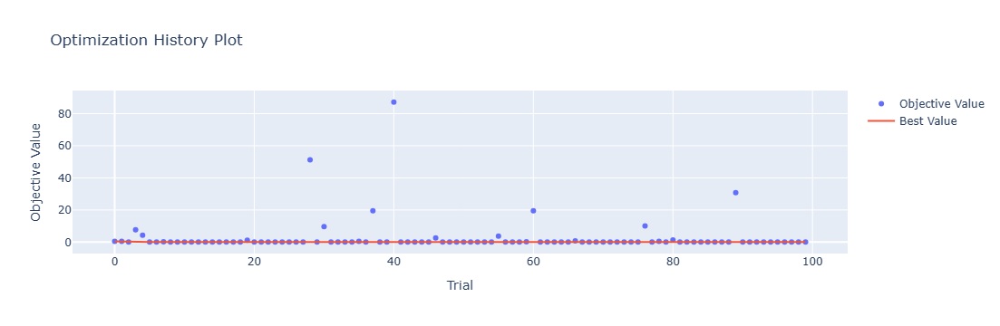

In [4]:
optuna.visualization.plot_optimization_history(study)

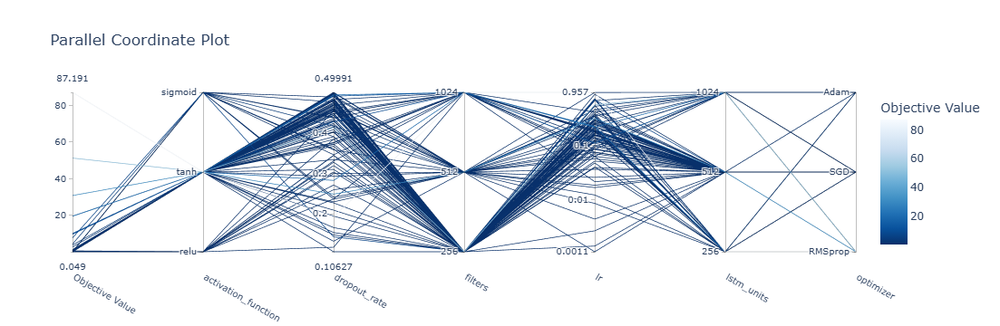

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

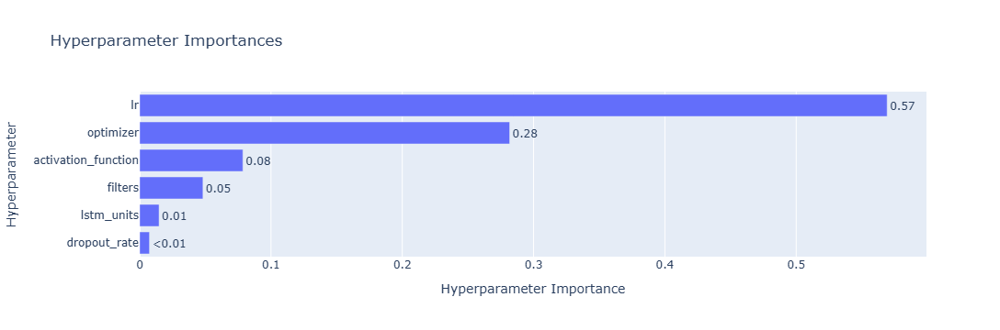

In [6]:
optuna.visualization.plot_param_importances(study)

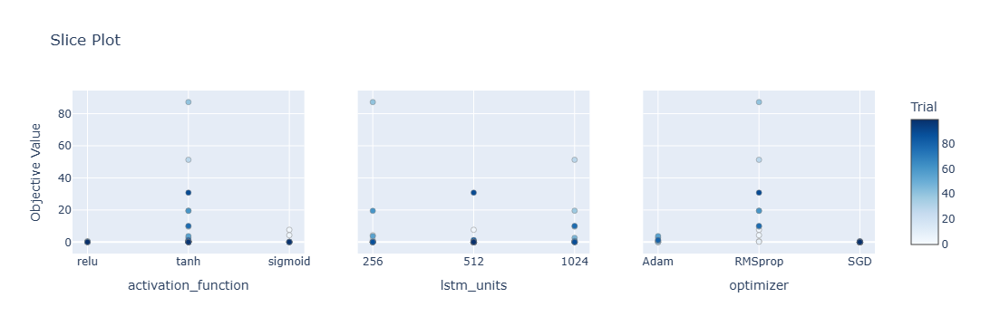

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

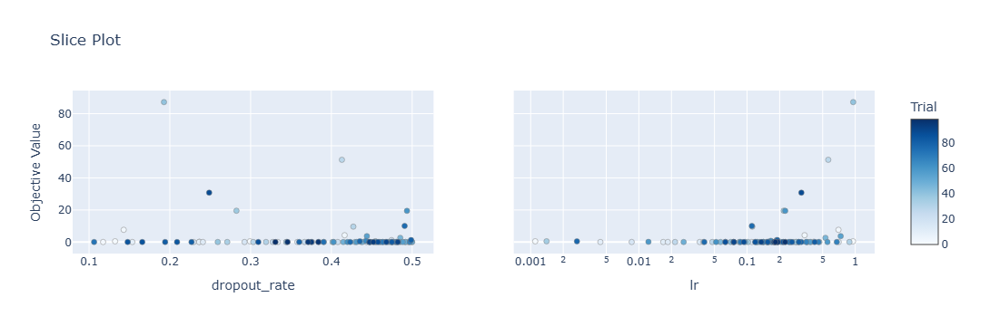

In [8]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

[[12.21  8.17 15.68 ... 23.86 20.59 15.82]
 [14.52 12.85 16.77 ... 26.49 23.17 21.15]
 [ 8.91  6.23 11.39 ... 22.62 16.72 14.05]
 ...
 [ 7.87  5.76 10.62 ... 21.07 15.24 12.04]
 [ 6.49  2.73  9.77 ... 21.93 16.5  11.44]
 [ 5.29  1.27  5.84 ... 22.11 15.37  9.87]]
Epoch 1/100
84/84 [==============================] - 8s 43ms/step - loss: 0.1452 - accuracy: 0.2738 - mae: 0.1254 - rmse: 0.1452 - mape: inf - pearson: 0.6107 - val_loss: 0.0762 - val_accuracy: 0.4000 - val_mae: 0.0606 - val_rmse: 0.0762 - val_mape: 13.8119 - val_pearson: 0.7471
Epoch 2/100
84/84 [==============================] - 2s 23ms/step - loss: 0.0698 - accuracy: 0.4286 - mae: 0.0555 - rmse: 0.0698 - mape: inf - pearson: 0.8022 - val_loss: 0.0722 - val_accuracy: 0.4000 - val_mae: 0.0569 - val_rmse: 0.0722 - val_mape: 12.9813 - val_pearson: 0.7639
Epoch 3/100
84/84 [==============================] - 2s 22ms/step - loss: 0.0634 - accuracy: 0.5000 - mae: 0.0499 - rmse: 0.0634 - mape: inf - pearson: 0.8256 - val_loss: 0.061

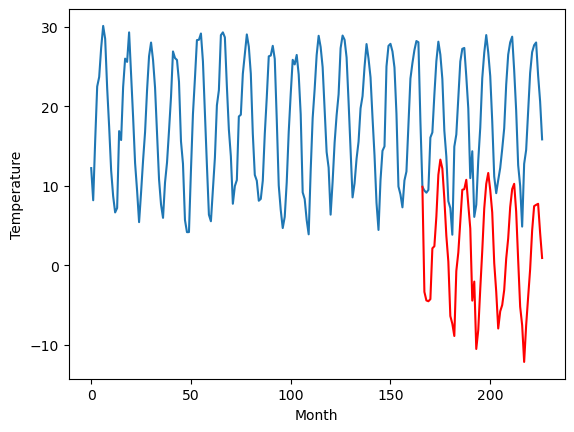

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.39		3.36		-0.03
2.49		2.28		-0.21
2.11		2.47		0.36
2.86		3.23		0.37
8.69		8.18		-0.51
9.18		8.08		-1.10
11.95		10.67		-1.28
15.70		14.49		-1.21
16.18		16.53		0.35
16.81		16.06		-0.75
13.83		13.31		-0.52
11.20		10.21		-0.99
7.78		6.03		-1.75
0.57		-0.61		-1.18
1.23		-1.21		-2.44
1.14		-0.34		-1.48
6.20		3.79		-2.41
7.60		6.08		-1.52
11.62		9.54		-2.08
15.10		11.84		-3.26
16.32		12.18		-4.14
16.66		13.23		-3.43
14.53		10.32		-4.21
11.90		8.38		-3.52
6.39		-0.10		-6.49
6.15		2.81		-3.34
-0.53		-4.16		-3.63
2.24		-1.13		-3.37
6.10		2.44		-3.66
9.07		6.02		-3.05
13.38		10.10		-3.28
17.07		12.44		-4.63
17.21		13.23		-3.98
16.66		11.86		-4.80
15.64		9.56		-6.08
10.04		3.86		-6.18
7.35		2.00		-5.35
3.50		-2.20		-5.70
4.29		-0.02		-4.31
5.39		1.03		-4.36
6.98		2.12		-4.86
9.13		5.18		-3.95
12.31		5.92		-6.39
15.39		9.16		-6.23
17.22		12.03		-5.19
18.81		12.35		-6.46
15.43		8.96		-6.47
10.32		4.32		-

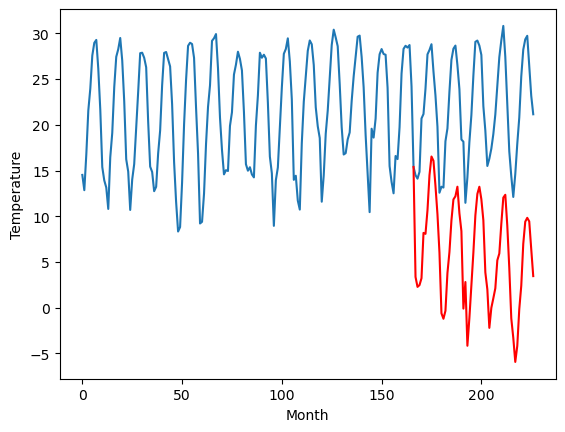

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.93		5.53		0.60
4.82		4.33		-0.49
4.20		4.45		0.25
4.82		5.04		0.22
11.07		10.19		-0.88
10.83		10.36		-0.47
14.52		13.53		-0.99
18.24		18.02		-0.22
20.61		20.25		-0.36
19.85		19.42		-0.43
16.46		16.26		-0.20
12.74		12.60		-0.14
7.81		8.59		0.78
0.81		1.88		1.07
1.63		1.01		-0.62
2.49		1.18		-1.31
8.47		6.44		-2.03
10.11		9.01		-1.10
14.09		12.68		-1.41
18.23		15.72		-2.51
19.99		16.03		-3.96
20.27		17.10		-3.17
16.70		13.99		-2.71
12.82		11.74		-1.08
4.46		2.87		-1.59
6.64		5.24		-1.40
0.63		-2.13		-2.76
4.58		0.96		-3.62
8.08		5.00		-3.08
10.82		8.80		-2.02
16.58		13.56		-3.02
20.36		16.14		-4.22
21.28		17.20		-4.08
20.05		15.78		-4.27
16.93		13.17		-3.76
9.79		7.16		-2.63
7.31		4.92		-2.39
2.79		0.21		-2.58
4.74		2.52		-2.22
7.52		3.30		-4.22
7.50		4.48		-3.02
10.57		8.31		-2.26
13.98		9.50		-4.48
17.30		12.95		-4.35
20.40		15.92		-4.48
20.01		15.99		-4.02
16.56		12.67		-3.89
10.58		7.77		

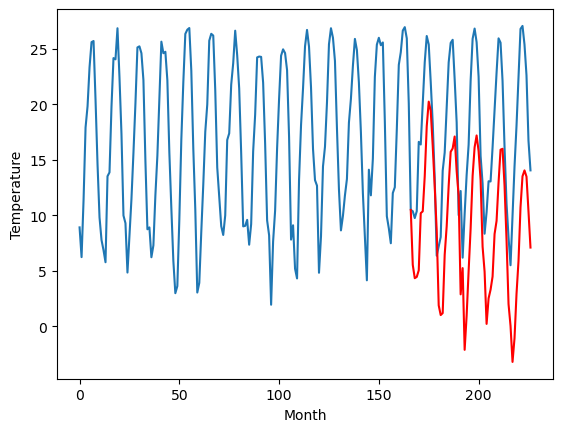

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
1.13		0.37		-0.76
1.11		-0.55		-1.66
1.15		-0.47		-1.62
1.15		0.10		-1.05
8.07		5.97		-2.10
8.15		5.79		-2.36
11.04		8.52		-2.52
13.95		12.58		-1.37
14.92		14.31		-0.61
15.26		13.77		-1.49
12.93		10.72		-2.21
8.87		7.14		-1.73
6.03		3.47		-2.56
-1.43		-3.26		-1.83
-1.34		-3.78		-2.44
-2.91		-3.87		-0.96
5.00		2.01		-2.99
6.79		3.93		-2.86
10.76		7.49		-3.27
14.04		10.15		-3.89
14.67		10.34		-4.33
14.72		11.49		-3.23
12.21		8.69		-3.52
9.90		6.35		-3.55
1.81		-2.10		-3.91
4.58		1.21		-3.37
-2.77		-6.50		-3.73
-0.33		-4.07		-3.74
3.46		0.14		-3.32
8.25		4.45		-3.80
12.77		8.62		-4.15
15.20		11.22		-3.98
15.18		12.10		-3.08
13.99		10.17		-3.82
12.75		7.87		-4.88
7.13		2.06		-5.07
3.02		-0.61		-3.63
0.84		-4.49		-5.33
2.28		-2.48		-4.76
2.69		-1.30		-3.99
6.21		0.31		-5.90
7.63		2.99		-4.64
12.06		4.57		-7.49
15.81		8.03		-7.78
16.93		10.34		-6.59
18.46		11.24		-7.22
15.02		7.70		-7.32
8.77		2.26

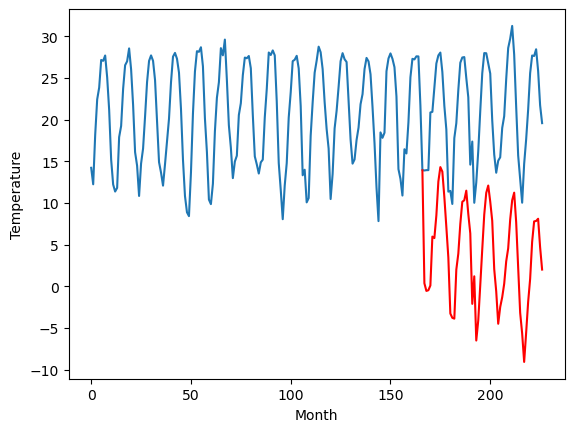

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
7.34		5.94		-1.40
5.29		4.97		-0.32
6.03		4.83		-1.20
5.36		5.06		-0.30
13.11		11.93		-1.18
13.36		12.08		-1.28
18.34		15.68		-2.66
22.54		20.81		-1.73
24.15		22.44		-1.71
24.64		21.46		-3.18
18.93		17.62		-1.31
14.05		12.84		-1.21
11.53		9.83		-1.70
5.06		3.00		-2.06
4.18		2.22		-1.96
1.09		0.31		-0.78
10.99		9.10		-1.89
12.92		11.08		-1.84
16.78		14.99		-1.79
21.98		18.92		-3.06
22.41		18.94		-3.47
23.17		20.11		-3.06
21.16		17.14		-4.02
16.81		13.97		-2.84
9.24		5.17		-4.07
11.57		7.88		-3.69
3.12		-0.77		-3.89
2.89		1.17		-1.72
9.38		6.55		-2.83
15.42		11.69		-3.73
20.13		16.79		-3.34
24.47		19.99		-4.48
26.83		21.34		-5.49
24.47		18.90		-5.57
21.52		16.20		-5.32
15.60		9.88		-5.72
8.67		5.80		-2.87
5.94		1.62		-4.32
6.91		3.62		-3.29
7.04		4.57		-2.47
11.76		6.80		-4.96
13.26		10.24		-3.02
18.79		13.23		-5.56
23.34		17.18		-6.16
26.33		19.06		-7.27
28.07		20.23		-7.84
23.59		16.59		-7.00

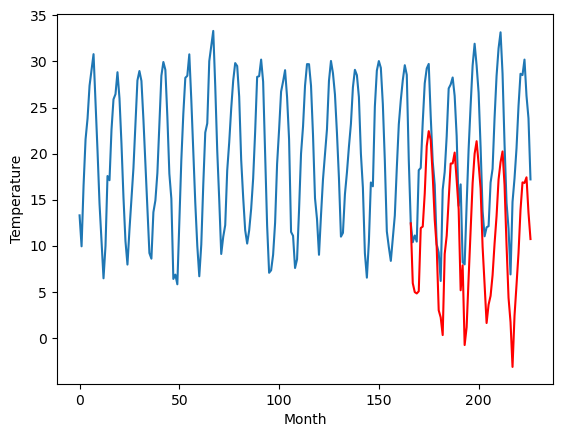

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.63		4.03		-0.60
4.06		2.58		-1.48
3.53		2.75		-0.78
3.22		3.41		0.19
6.81		7.92		1.11
8.78		8.32		-0.46
12.47		11.73		-0.74
16.82		16.41		-0.41
20.56		19.01		-1.55
19.71		18.06		-1.65
16.68		14.90		-1.78
12.59		11.29		-1.30
8.47		6.95		-1.52
1.72		0.32		-1.40
-0.06		-0.75		-0.69
0.59		-0.19		-0.78
5.49		4.27		-1.22
8.86		7.32		-1.54
12.37		11.01		-1.36
16.94		14.22		-2.72
18.93		14.63		-4.30
19.41		15.62		-3.79
16.40		12.30		-4.10
12.80		10.18		-2.62
4.63		1.10		-3.53
5.68		2.79		-2.89
-0.70		-4.15		-3.45
2.91		-0.60		-3.51
6.83		3.21		-3.62
9.70		6.59		-3.11
14.33		11.65		-2.68
17.90		14.18		-3.72
20.04		15.34		-4.70
19.19		14.36		-4.83
16.54		11.55		-4.99
9.98		5.47		-4.51
8.29		3.58		-4.71
1.77		-1.62		-3.39
3.46		0.88		-2.58
4.95		1.36		-3.59
5.86		2.20		-3.66
10.54		6.78		-3.76
12.06		7.58		-4.48
15.88		10.98		-4.90
19.71		14.47		-5.24
19.23		13.94		-5.29
15.71		10.79		-4.92
11.36		6.3

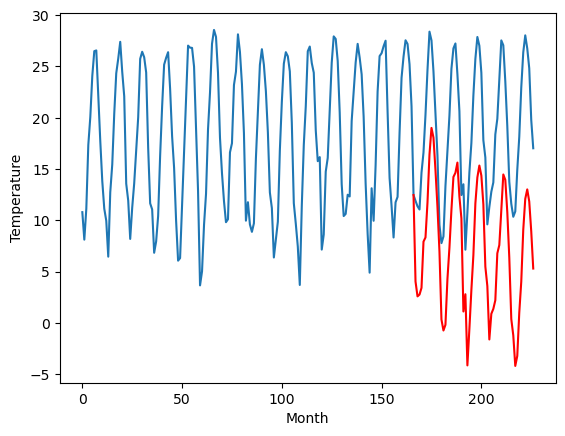

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.68		1.66		0.98
0.32		0.26		-0.06
-0.15		0.38		0.53
0.96		0.96		0.00
6.38		5.81		-0.57
7.62		6.22		-1.40
9.96		9.73		-0.23
15.21		14.53		-0.68
18.28		17.02		-1.26
17.25		16.04		-1.21
13.36		12.73		-0.63
9.36		8.91		-0.45
5.18		4.75		-0.43
-1.75		-1.90		-0.15
-2.33		-2.96		-0.63
-1.69		-2.80		-1.11
5.29		2.36		-2.93
6.32		5.30		-1.02
10.03		9.06		-0.97
14.36		12.46		-1.90
15.98		12.82		-3.16
15.92		13.83		-2.09
11.87		10.54		-1.33
8.64		8.23		-0.41
-0.01		-0.83		-0.82
1.93		0.91		-1.02
-4.72		-6.28		-1.56
-0.74		-2.96		-2.22
3.60		1.10		-2.50
6.52		4.76		-1.76
11.59		9.89		-1.70
15.50		12.53		-2.97
16.60		13.75		-2.85
15.31		12.57		-2.74
12.25		9.74		-2.51
5.31		3.59		-1.72
3.08		1.34		-1.74
-3.43		-3.77		-0.34
-0.24		-1.33		-1.09
2.76		-0.82		-3.58
3.24		0.22		-3.02
6.80		4.72		-2.08
9.49		5.86		-3.63
12.84		9.36		-3.48
16.55		12.66		-3.89
15.86		12.32		-3.54
12.35		9.10		-3.25
7.14		4.36		-

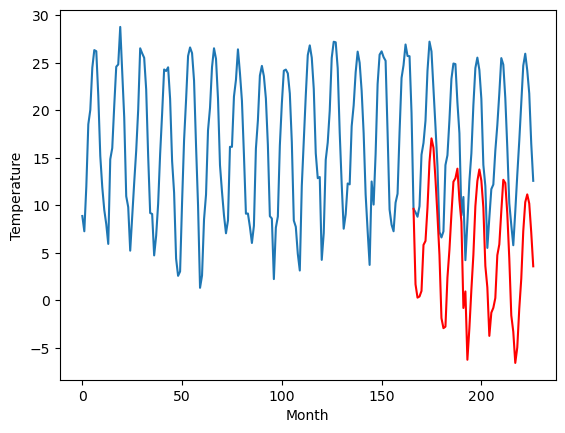

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.37		-0.47		0.90
-1.74		-2.00		-0.26
-1.86		-1.90		-0.04
-0.82		-1.39		-0.57
4.76		3.36		-1.40
5.66		3.97		-1.69
8.78		7.83		-0.95
14.30		13.01		-1.29
17.56		15.71		-1.85
16.19		14.51		-1.68
11.32		11.02		-0.30
7.48		6.96		-0.52
3.25		2.78		-0.47
-3.68		-3.89		-0.21
-4.62		-5.14		-0.52
-4.00		-5.19		-1.19
2.52		0.25		-2.27
6.15		3.49		-2.66
9.17		7.35		-1.82
13.96		11.15		-2.81
16.08		11.51		-4.57
16.03		12.52		-3.51
11.52		9.07		-2.45
7.67		6.67		-1.00
-1.83		-2.68		-0.85
0.23		-1.40		-1.63
-6.95		-8.67		-1.72
-2.71		-5.17		-2.46
2.13		-0.96		-3.09
5.45		2.67		-2.78
10.43		8.24		-2.19
14.43		10.98		-3.45
16.30		12.36		-3.94
14.62		11.28		-3.34
10.92		8.24		-2.68
3.73		1.94		-1.79
1.53		-0.38		-1.91
-5.64		-5.89		-0.25
-2.47		-3.33		-0.86
0.50		-3.05		-3.55
1.18		-2.09		-3.27
5.80		3.01		-2.79
8.09		4.23		-3.86
11.84		7.82		-4.02
15.98		11.32		-4.66
14.84		10.68		-4.16
11.08		7.56		-3.52
5.

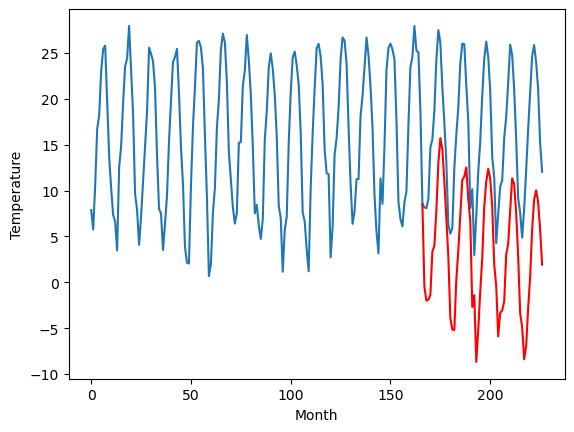

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.95		-1.00		-0.05
-1.11		-2.32		-1.21
-2.30		-2.57		-0.27
-1.80		-2.51		-0.71
4.77		4.01		-0.76
7.05		4.77		-2.28
11.93		9.48		-2.45
17.86		15.85		-2.01
20.60		18.07		-2.53
17.59		16.38		-1.21
14.03		11.96		-2.07
6.77		6.38		-0.39
3.91		3.36		-0.55
-2.80		-3.58		-0.78
-3.59		-5.03		-1.44
-7.86		-7.65		0.21
4.61		2.07		-2.54
7.21		4.97		-2.24
11.90		9.18		-2.72
18.09		14.37		-3.72
18.66		14.40		-4.26
18.60		15.54		-3.06
14.86		12.00		-2.86
10.90		8.55		-2.35
0.86		-1.16		-2.02
2.66		0.07		-2.59
-5.85		-8.85		-3.00
-3.81		-6.22		-2.41
3.41		-0.41		-3.82
7.36		4.53		-2.83
14.20		11.05		-3.15
18.72		14.51		-4.21
21.05		16.33		-4.72
18.17		14.26		-3.91
14.53		10.86		-3.67
7.97		4.00		-3.97
2.00		-0.16		-2.16
-3.29		-5.72		-2.43
-0.73		-3.33		-2.60
0.88		-2.99		-3.87
2.70		-1.04		-3.74
8.48		4.39		-4.09
14.07		7.59		-6.48
17.94		11.87		-6.07
19.43		14.34		-5.09
18.17		14.49		-3.68
15.00		11.11		-

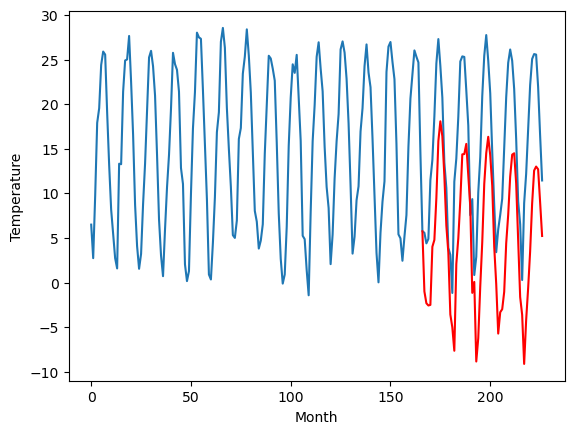

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.56		-2.83		1.73
-4.38		-4.42		-0.04
-5.66		-4.53		1.13
-6.53		-4.38		2.15
0.66		1.21		0.55
2.32		2.19		-0.13
7.41		7.02		-0.39
14.39		13.38		-1.01
17.02		16.11		-0.91
14.64		14.34		-0.30
10.97		10.08		-0.89
4.58		4.85		0.27
0.90		1.29		0.39
-6.61		-5.54		1.07
-8.20		-7.17		1.03
-10.37		-8.94		1.43
0.38		-0.70		-1.08
3.44		2.75		-0.69
7.91		6.94		-0.97
14.39		12.09		-2.30
15.40		12.25		-3.15
16.00		13.33		-2.67
12.14		9.61		-2.53
7.67		6.49		-1.18
-2.99		-3.43		-0.44
-1.76		-2.84		-1.08
-10.73		-11.12		-0.39
-7.15		-7.91		-0.76
-0.17		-2.59		-2.42
2.56		1.78		-0.78
10.73		8.44		-2.29
14.63		11.71		-2.92
16.66		13.55		-3.11
14.75		12.06		-2.69
11.02		8.51		-2.51
3.98		1.68		-2.30
-1.04		-1.79		-0.75
-6.75		-7.84		-1.09
-4.86		-5.23		-0.37
-2.82		-5.26		-2.44
-2.48		-3.85		-1.37
3.80		2.25		-1.55
8.76		4.70		-4.06
12.60		8.84		-3.76
15.43		12.02		-3.41
14.63		11.40		-3.23
12.02		8.27		-3.75


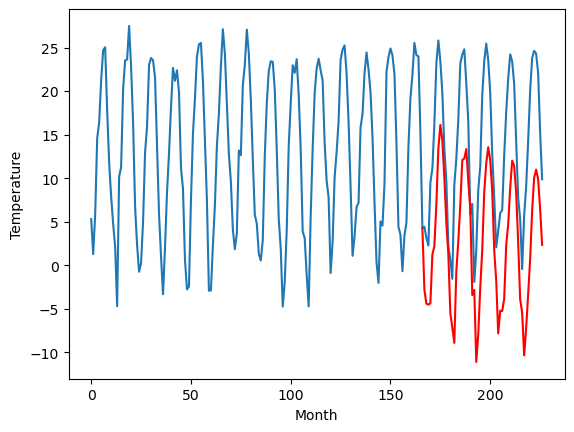

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-5.06		-4.17		0.89
-5.73		-5.94		-0.21
-6.76		-6.12		0.64
-8.22		-6.09		2.13
-2.08		-0.41		1.67
0.57		0.84		0.27
7.00		6.18		-0.82
14.96		13.17		-1.79
18.12		16.07		-2.05
15.43		14.03		-1.40
10.60		9.43		-1.17
3.85		3.69		-0.16
0.37		0.24		-0.13
-6.66		-6.64		0.02
-8.27		-8.53		-0.26
-12.58		-10.89		1.69
-0.85		-1.84		-0.99
3.12		1.95		-1.17
8.27		6.30		-1.97
15.58		12.07		-3.51
16.17		12.18		-3.99
16.88		13.22		-3.66
12.83		9.28		-3.55
8.48		5.93		-2.55
-2.38		-4.37		-1.99
-3.28		-4.46		-1.18
-12.23		-12.95		-0.72
-8.99		-9.66		-0.67
-2.08		-3.98		-1.90
1.53		0.48		-1.05
10.85		7.78		-3.07
15.61		11.25		-4.36
16.72		13.34		-3.38
15.60		11.90		-3.70
11.76		8.05		-3.71
4.52		0.98		-3.54
-0.51		-2.80		-2.29
-6.69		-9.34		-2.65
-5.56		-6.62		-1.06
-5.15		-6.93		-1.78
-3.29		-5.49		-2.20
3.56		1.43		-2.13
8.58		4.25		-4.33
14.09		8.58		-5.51
16.55		11.79		-4.76
14.74		10.95		-3.79
12.36		7.90		-

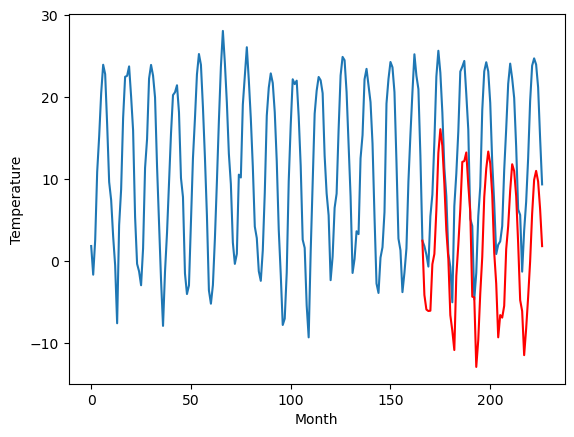

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -2.98  -3.347402
1                 1    3.39   3.364089
2                 2    4.93   5.533478
3                 3    1.13   0.370165
4                 4    7.34   5.942878
5                 5    4.63   4.025092
6                 6    0.68   1.655225
7                 7   -1.37  -0.474886
8                 8   -0.95  -1.001494
9                 9   -4.56  -2.825755
10               10   -5.06  -4.167355


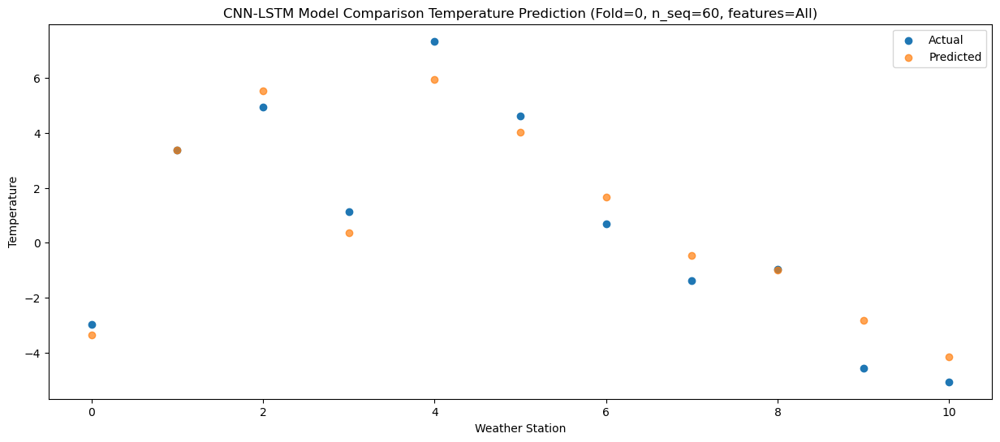

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -3.45  -4.418734
1                 1    2.49   2.277721
2                 2    4.82   4.331502
3                 3    1.11  -0.549206
4                 4    5.29   4.972448
5                 5    4.06   2.578261
6                 6    0.32   0.258024
7                 7   -1.74  -1.998134
8                 8   -1.11  -2.323844
9                 9   -4.38  -4.423142
10               10   -5.73  -5.942512


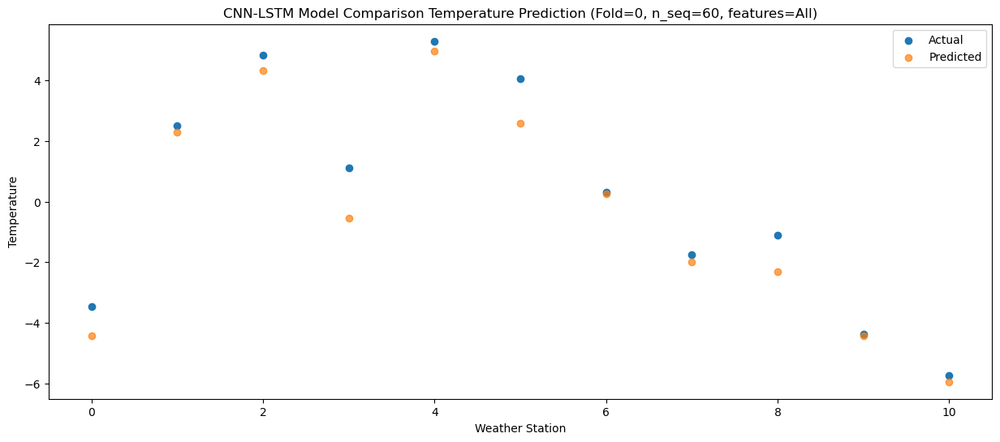

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -3.72  -4.523306
1                 1    2.11   2.473304
2                 2    4.20   4.447640
3                 3    1.15  -0.465385
4                 4    6.03   4.827383
5                 5    3.53   2.752772
6                 6   -0.15   0.375837
7                 7   -1.86  -1.898100
8                 8   -2.30  -2.573340
9                 9   -5.66  -4.531896
10               10   -6.76  -6.124338


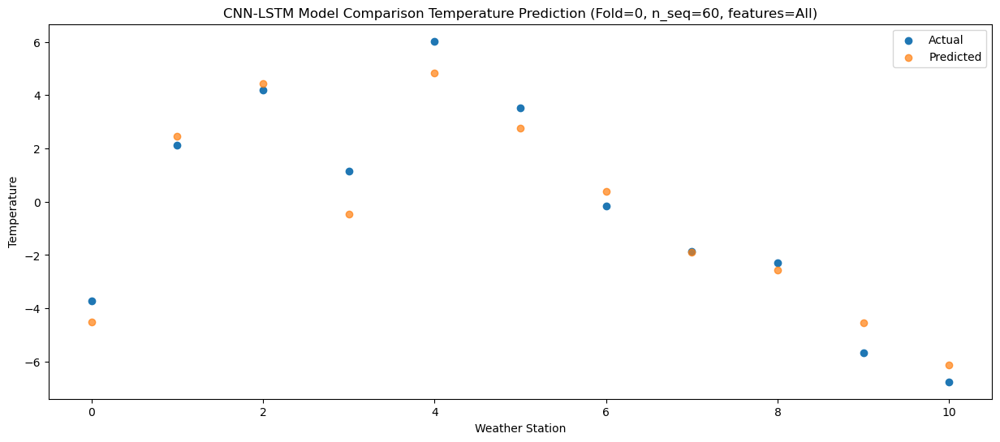

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -3.37  -4.259610
1                 1    2.86   3.228165
2                 2    4.82   5.041264
3                 3    1.15   0.099614
4                 4    5.36   5.062343
5                 5    3.22   3.407418
6                 6    0.96   0.961556
7                 7   -0.82  -1.385148
8                 8   -1.80  -2.507475
9                 9   -6.53  -4.381326
10               10   -8.22  -6.087581


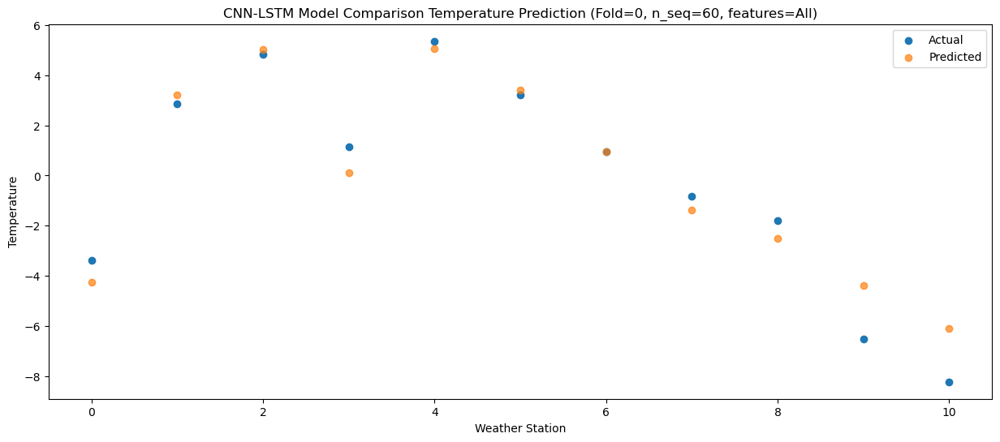

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.21   2.130190
1                 1    8.69   8.179114
2                 2   11.07  10.194385
3                 3    8.07   5.973764
4                 4   13.11  11.929074
5                 5    6.81   7.916405
6                 6    6.38   5.806292
7                 7    4.76   3.357492
8                 8    4.77   4.010925
9                 9    0.66   1.214841
10               10   -2.08  -0.406298


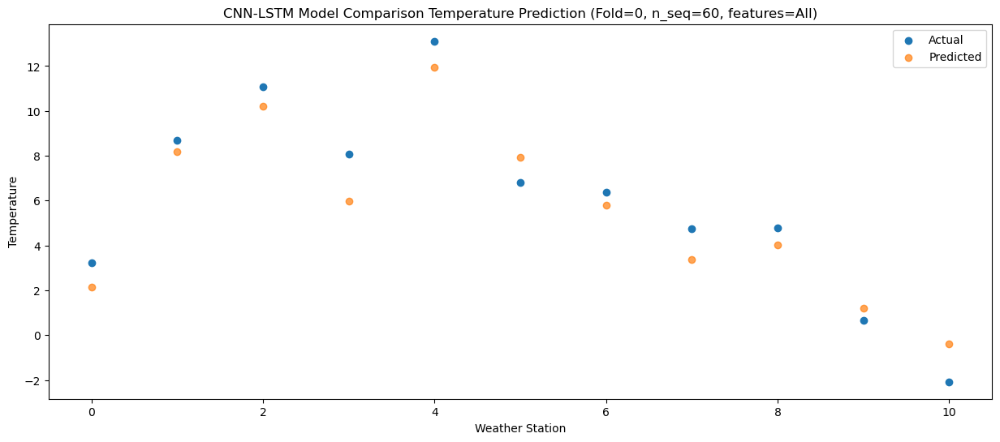

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.86   2.391094
1                 1    9.18   8.076639
2                 2   10.83  10.358740
3                 3    8.15   5.794427
4                 4   13.36  12.079436
5                 5    8.78   8.324977
6                 6    7.62   6.221918
7                 7    5.66   3.968752
8                 8    7.05   4.771036
9                 9    2.32   2.194205
10               10    0.57   0.835804


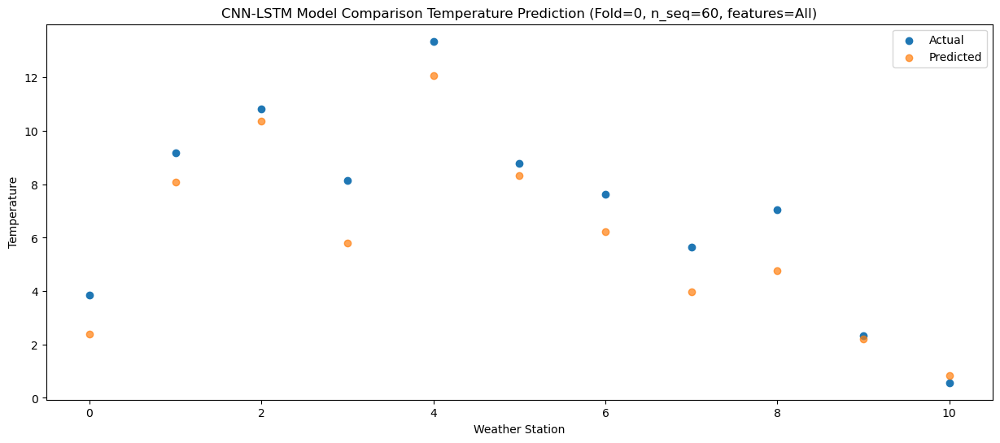

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    8.59   6.118449
1                 1   11.95  10.669726
2                 2   14.52  13.532817
3                 3   11.04   8.520000
4                 4   18.34  15.678476
5                 5   12.47  11.734120
6                 6    9.96   9.733064
7                 7    8.78   7.827393
8                 8   11.93   9.477825
9                 9    7.41   7.022706
10               10    7.00   6.183143


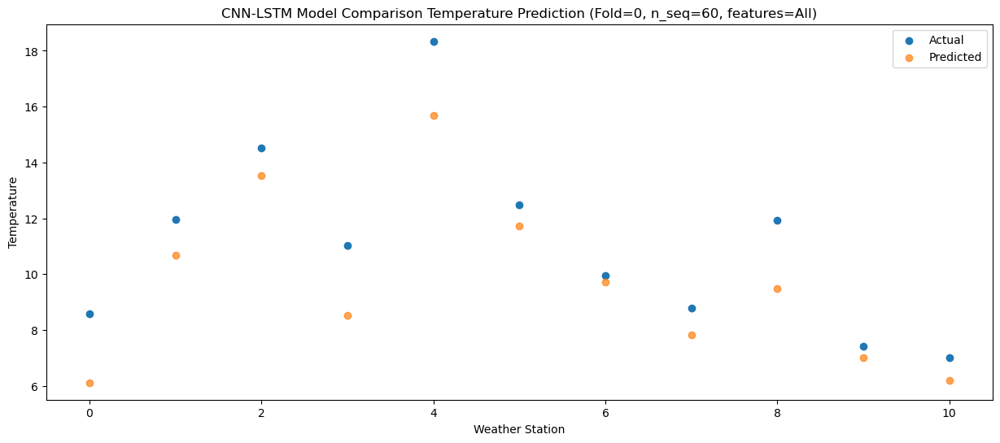

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   12.81  11.366634
1                 1   15.70  14.491348
2                 2   18.24  18.022330
3                 3   13.95  12.580303
4                 4   22.54  20.814071
5                 5   16.82  16.414575
6                 6   15.21  14.530751
7                 7   14.30  13.011177
8                 8   17.86  15.850912
9                 9   14.39  13.383902
10               10   14.96  13.167662


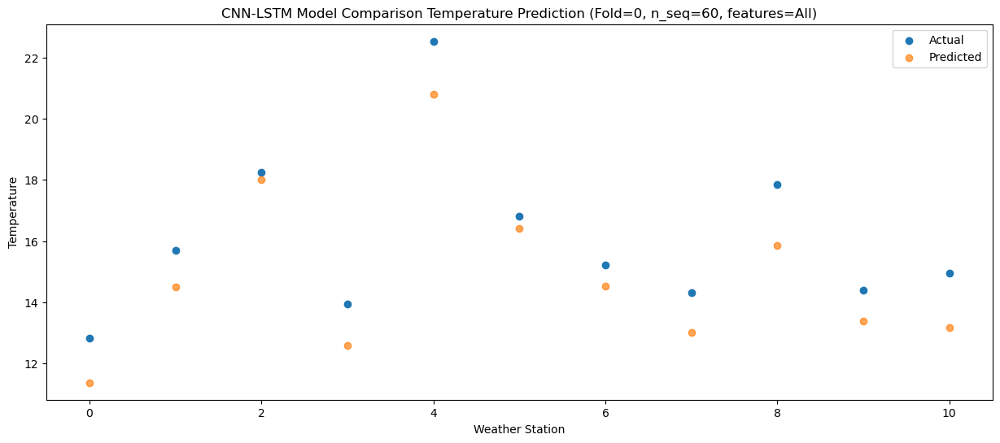

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   15.26  13.278861
1                 1   16.18  16.532379
2                 2   20.61  20.245978
3                 3   14.92  14.313285
4                 4   24.15  22.440100
5                 5   20.56  19.005161
6                 6   18.28  17.016690
7                 7   17.56  15.711055
8                 8   20.60  18.071096
9                 9   17.02  16.114318
10               10   18.12  16.067255


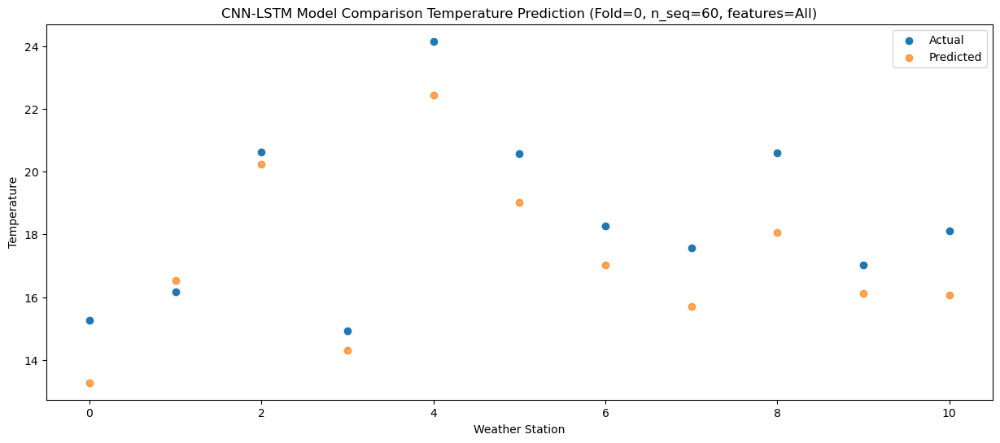

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   13.63  12.152955
1                 1   16.81  16.060667
2                 2   19.85  19.420327
3                 3   15.26  13.768544
4                 4   24.64  21.464111
5                 5   19.71  18.055375
6                 6   17.25  16.037141
7                 7   16.19  14.508609
8                 8   17.59  16.384400
9                 9   14.64  14.341218
10               10   15.43  14.025510


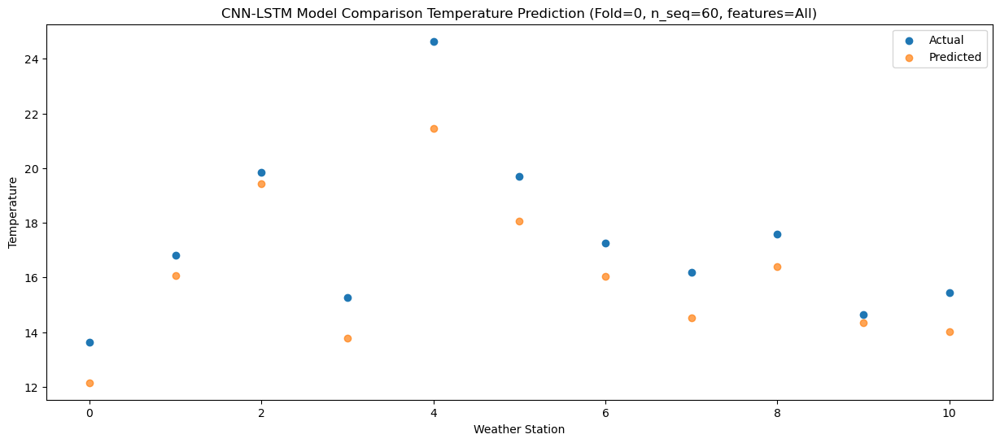

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   10.57   8.365767
1                 1   13.83  13.314870
2                 2   16.46  16.261455
3                 3   12.93  10.721436
4                 4   18.93  17.619366
5                 5   16.68  14.895488
6                 6   13.36  12.733868
7                 7   11.32  11.020360
8                 8   14.03  11.961287
9                 9   10.97  10.080494
10               10   10.60   9.433351


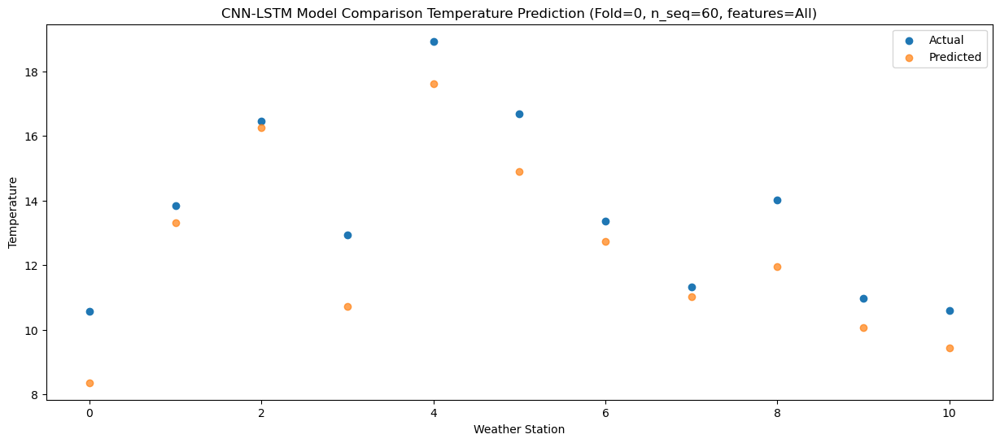

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.07   3.704542
1                 1   11.20  10.208867
2                 2   12.74  12.599467
3                 3    8.87   7.135723
4                 4   14.05  12.835556
5                 5   12.59  11.293984
6                 6    9.36   8.911088
7                 7    7.48   6.956181
8                 8    6.77   6.380954
9                 9    4.58   4.851499
10               10    3.85   3.688827


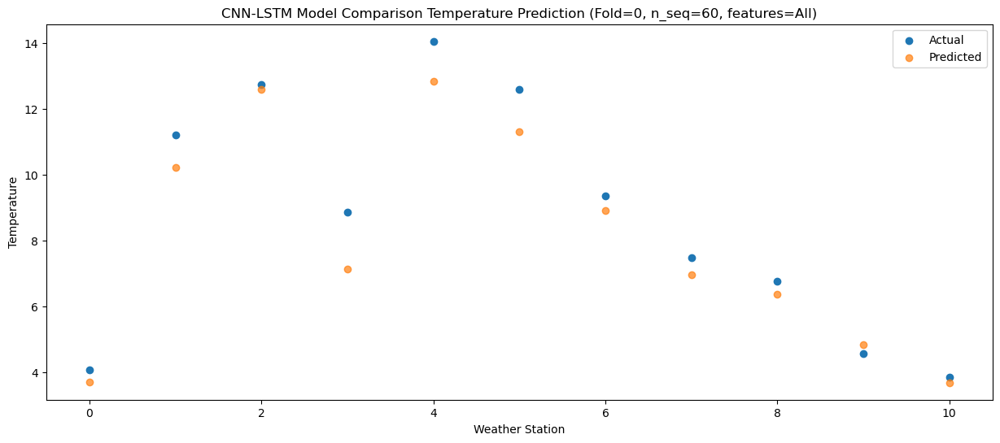

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    0.83   0.464245
1                 1    7.78   6.029994
2                 2    7.81   8.593486
3                 3    6.03   3.466916
4                 4   11.53   9.828500
5                 5    8.47   6.953525
6                 6    5.18   4.753473
7                 7    3.25   2.782841
8                 8    3.91   3.355208
9                 9    0.90   1.288823
10               10    0.37   0.244712


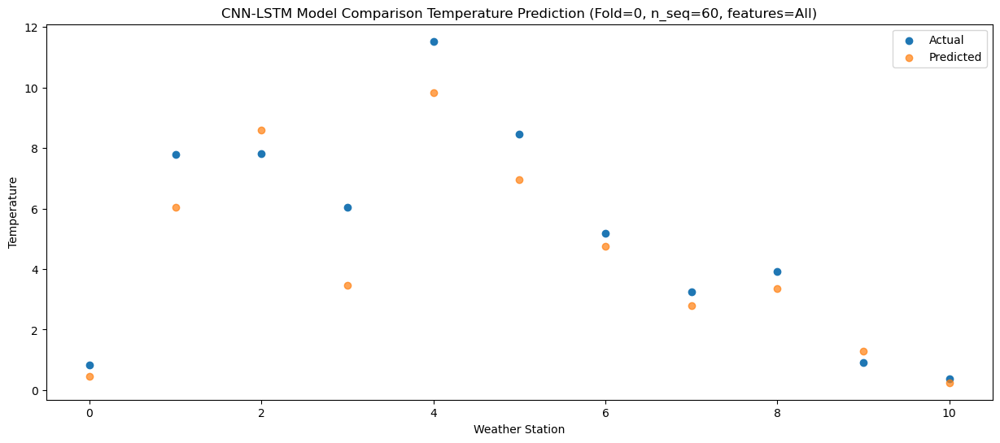

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -4.79  -6.386072
1                 1    0.57  -0.611161
2                 2    0.81   1.882595
3                 3   -1.43  -3.261246
4                 4    5.06   2.998254
5                 5    1.72   0.322420
6                 6   -1.75  -1.901809
7                 7   -3.68  -3.887942
8                 8   -2.80  -3.584522
9                 9   -6.61  -5.537580
10               10   -6.66  -6.637765


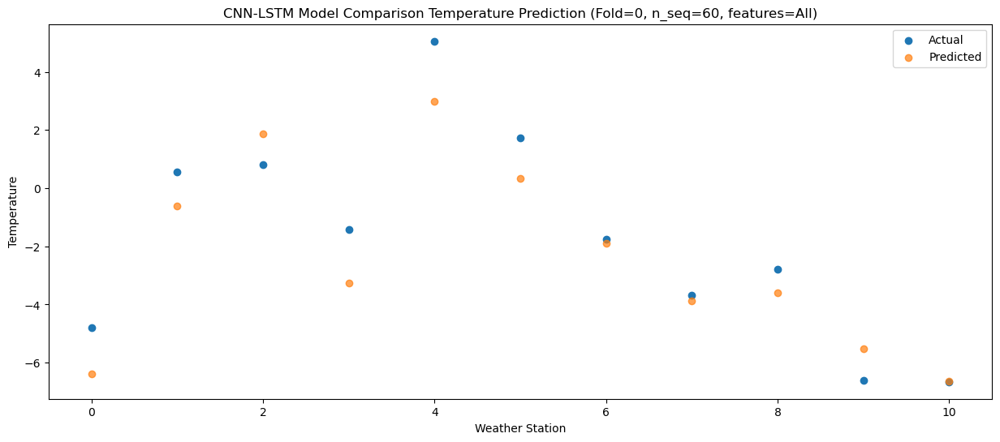

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -5.65  -7.344272
1                 1    1.23  -1.207476
2                 2    1.63   1.007542
3                 3   -1.34  -3.781681
4                 4    4.18   2.223717
5                 5   -0.06  -0.749717
6                 6   -2.33  -2.956306
7                 7   -4.62  -5.139991
8                 8   -3.59  -5.027675
9                 9   -8.20  -7.171443
10               10   -8.27  -8.534783


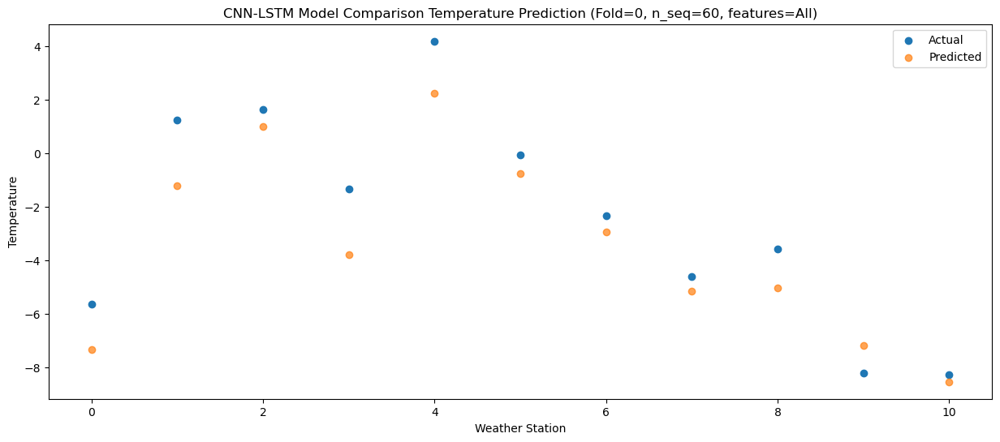

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -9.00  -8.887597
1                 1    1.14  -0.336501
2                 2    2.49   1.183135
3                 3   -2.91  -3.873943
4                 4    1.09   0.311230
5                 5    0.59  -0.193104
6                 6   -1.69  -2.799408
7                 7   -4.00  -5.194681
8                 8   -7.86  -7.649958
9                 9  -10.37  -8.935129
10               10  -12.58 -10.885886


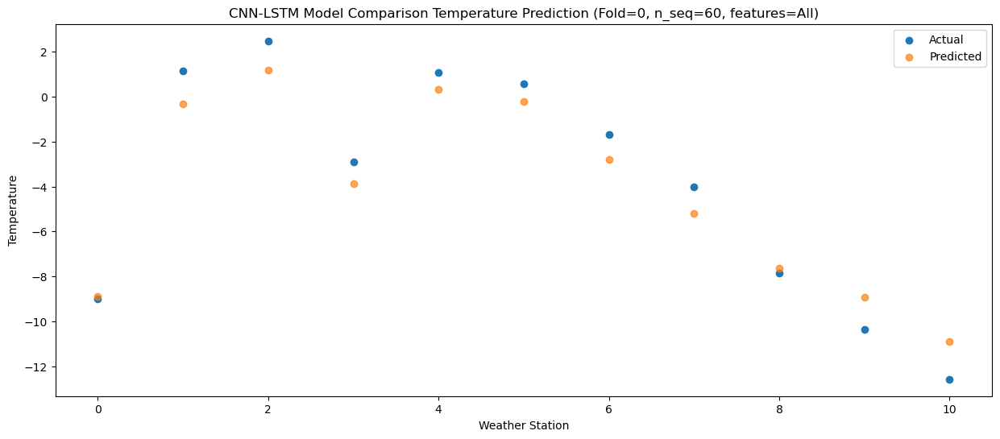

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.07  -0.717265
1                 1    6.20   3.793090
2                 2    8.47   6.442748
3                 3    5.00   2.010593
4                 4   10.99   9.104677
5                 5    5.49   4.272449
6                 6    5.29   2.358782
7                 7    2.52   0.251636
8                 8    4.61   2.073025
9                 9    0.38  -0.701016
10               10   -0.85  -1.835438


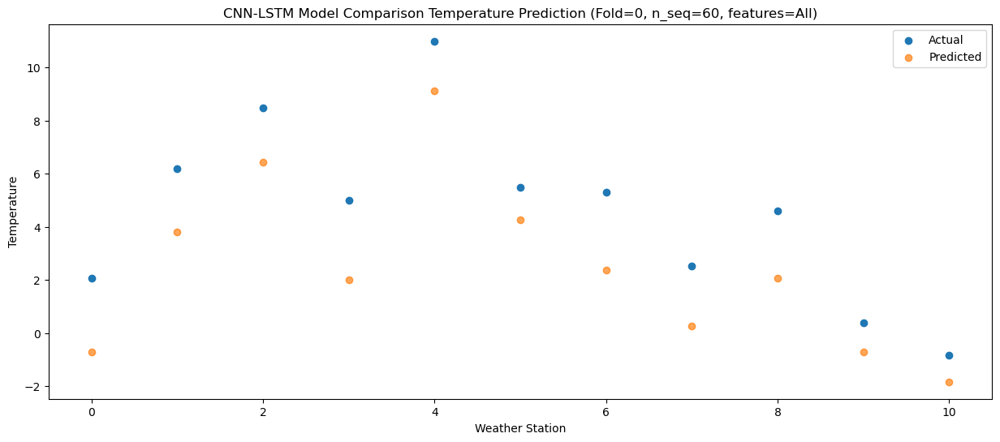

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    3.60   1.599228
1                 1    7.60   6.080535
2                 2   10.11   9.013840
3                 3    6.79   3.925836
4                 4   12.92  11.082709
5                 5    8.86   7.322504
6                 6    6.32   5.300482
7                 7    6.15   3.489043
8                 8    7.21   4.973339
9                 9    3.44   2.754026
10               10    3.12   1.947058


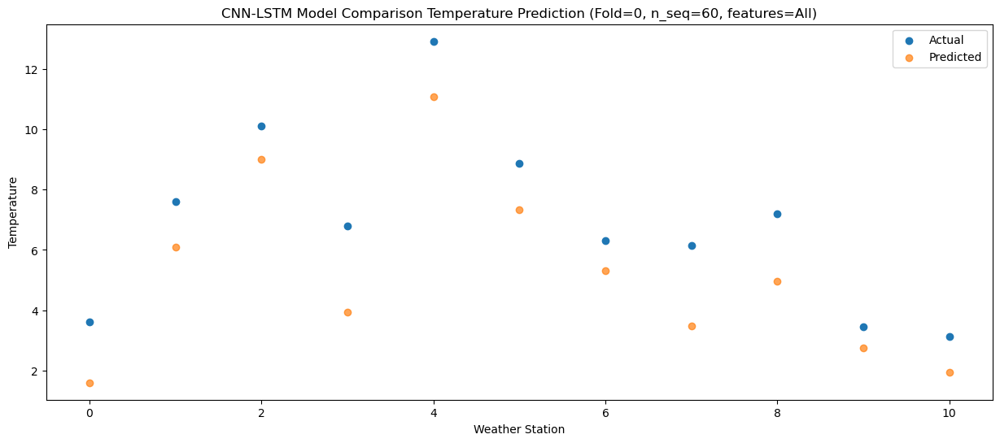

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    8.10   5.505291
1                 1   11.62   9.538905
2                 2   14.09  12.675330
3                 3   10.76   7.493226
4                 4   16.78  14.989827
5                 5   12.37  11.010246
6                 6   10.03   9.056494
7                 7    9.17   7.345400
8                 8   11.90   9.178258
9                 9    7.91   6.941172
10               10    8.27   6.295966


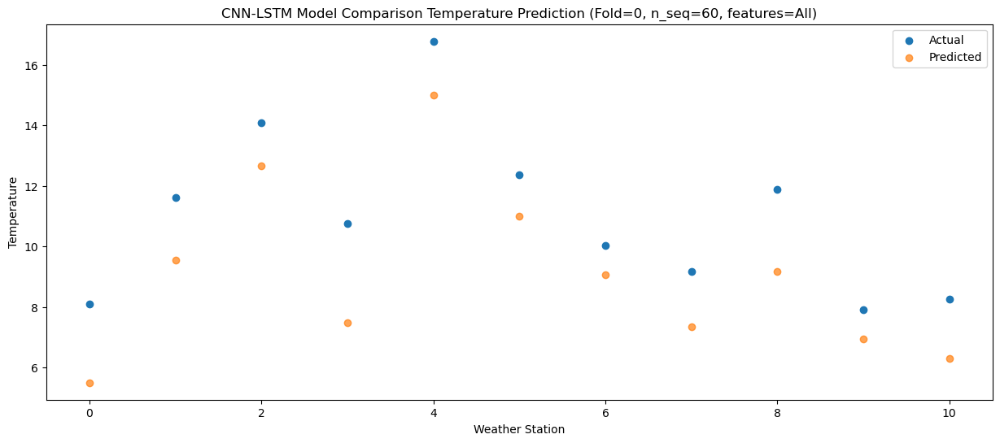

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   12.77   9.486144
1                 1   15.10  11.835847
2                 2   18.23  15.724879
3                 3   14.04  10.147293
4                 4   21.98  18.918412
5                 5   16.94  14.224735
6                 6   14.36  12.455340
7                 7   13.96  11.149776
8                 8   18.09  14.368983
9                 9   14.39  12.088365
10               10   15.58  12.070602


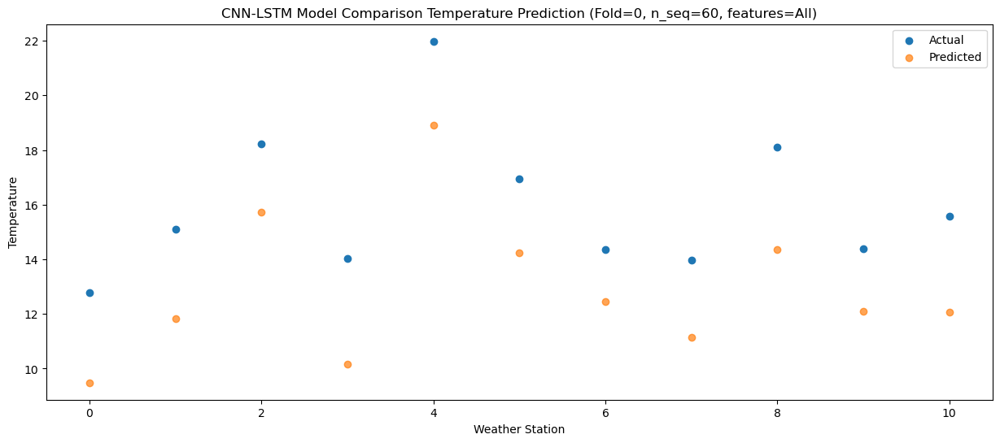

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   14.36   9.566207
1                 1   16.32  12.182481
2                 2   19.99  16.025945
3                 3   14.67  10.336738
4                 4   22.41  18.941010
5                 5   18.93  14.629327
6                 6   15.98  12.816447
7                 7   16.08  11.509818
8                 8   18.66  14.401626
9                 9   15.40  12.253193
10               10   16.17  12.179044


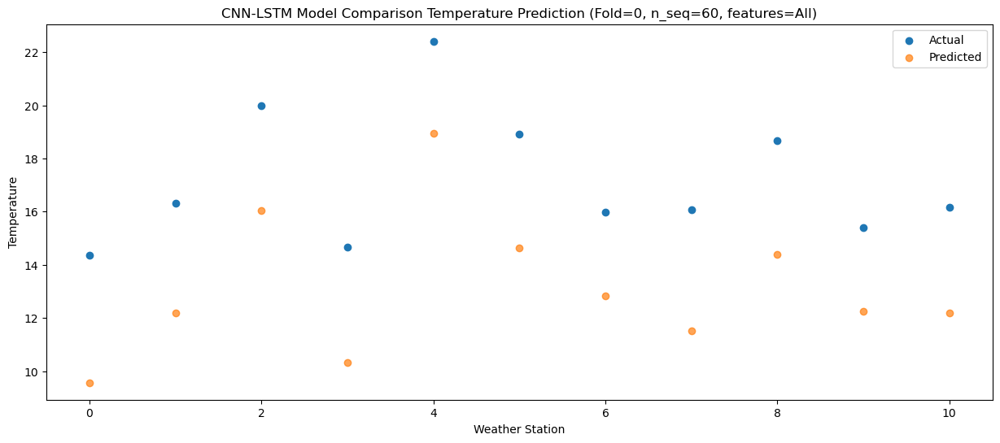

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   14.47  10.737388
1                 1   16.66  13.229469
2                 2   20.27  17.102714
3                 3   14.72  11.485790
4                 4   23.17  20.111603
5                 5   19.41  15.623221
6                 6   15.92  13.831418
7                 7   16.03  12.519124
8                 8   18.60  15.537994
9                 9   16.00  13.334333
10               10   16.88  13.223421


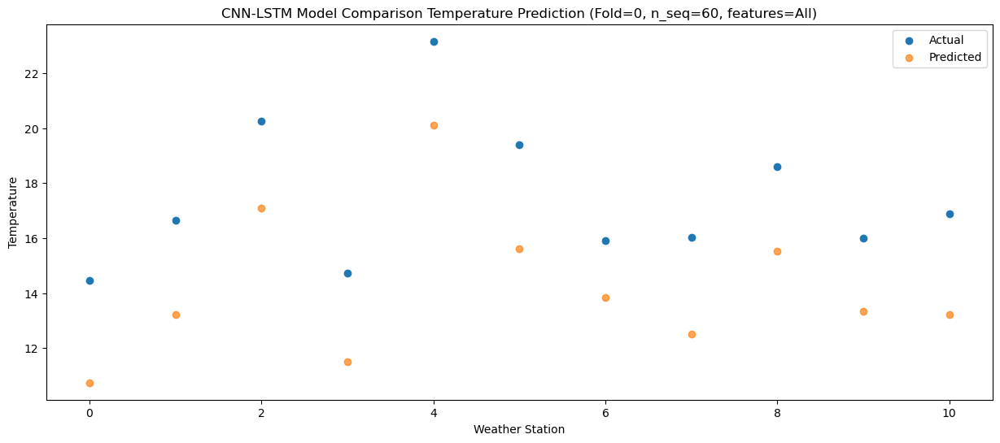

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   10.89   7.600442
1                 1   14.53  10.320444
2                 2   16.70  13.988887
3                 3   12.21   8.692736
4                 4   21.16  17.137844
5                 5   16.40  12.303813
6                 6   11.87  10.543121
7                 7   11.52   9.065838
8                 8   14.86  12.000948
9                 9   12.14   9.614180
10               10   12.83   9.284335


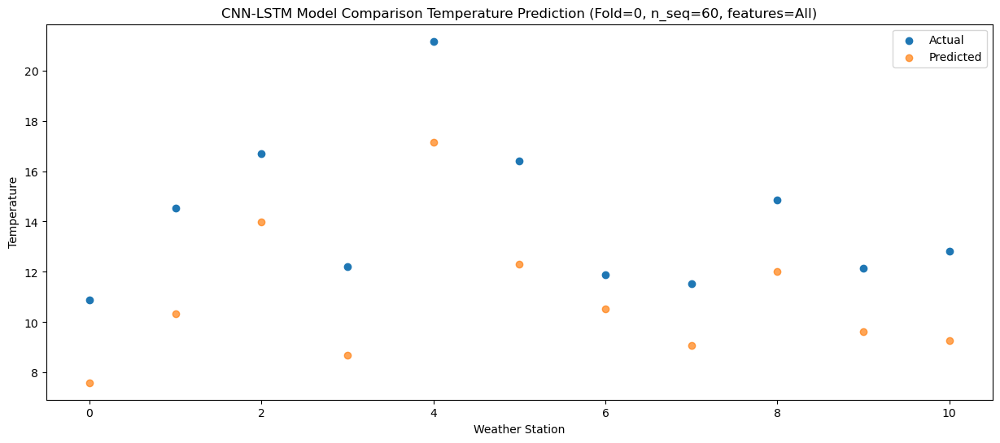

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    6.87   4.625521
1                 1   11.90   8.376495
2                 2   12.82  11.743581
3                 3    9.90   6.352248
4                 4   16.81  13.968784
5                 5   12.80  10.183766
6                 6    8.64   8.231163
7                 7    7.67   6.670018
8                 8   10.90   8.554331
9                 9    7.67   6.489239
10               10    8.48   5.927054


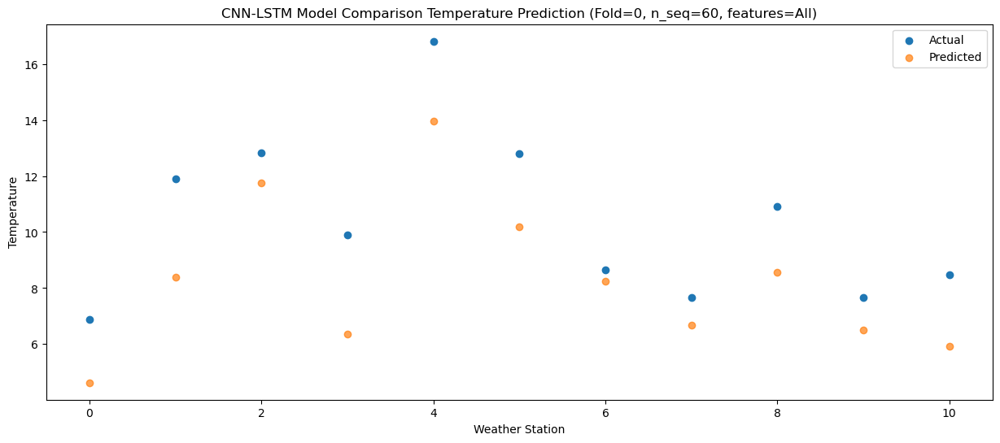

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -1.89  -4.441220
1                 1    6.39  -0.097184
2                 2    4.46   2.873638
3                 3    1.81  -2.101379
4                 4    9.24   5.170730
5                 5    4.63   1.104013
6                 6   -0.01  -0.832226
7                 7   -1.83  -2.682535
8                 8    0.86  -1.158520
9                 9   -2.99  -3.432850
10               10   -2.38  -4.370629


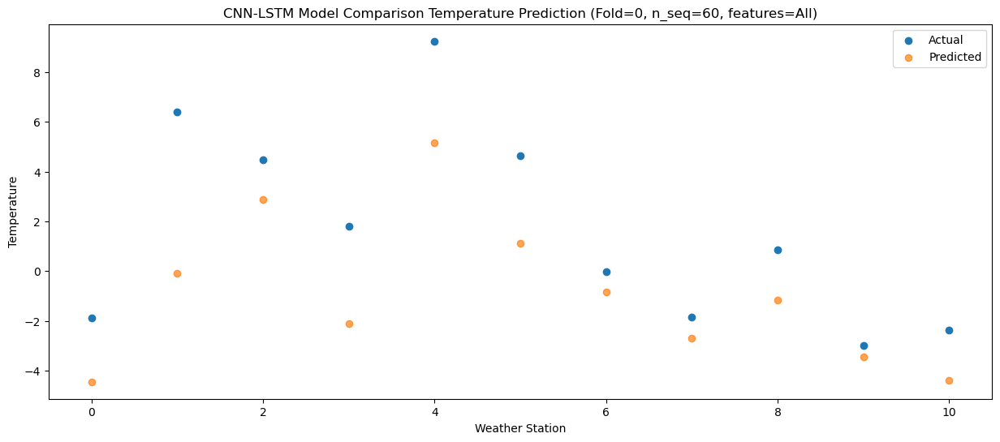

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    1.49  -2.049625
1                 1    6.15   2.808388
2                 2    6.64   5.240353
3                 3    4.58   1.205974
4                 4   11.57   7.878516
5                 5    5.68   2.786449
6                 6    1.93   0.908181
7                 7    0.23  -1.399592
8                 8    2.66   0.066862
9                 9   -1.76  -2.840939
10               10   -3.28  -4.461344


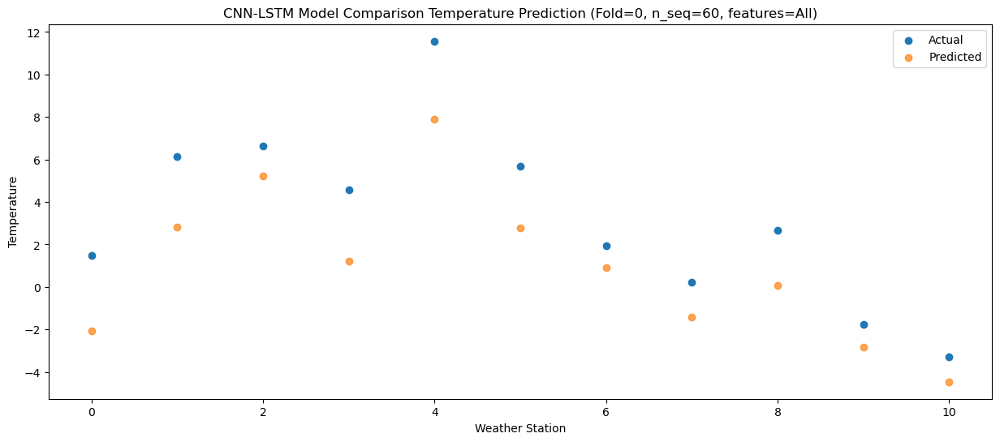

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -6.76 -10.518908
1                 1   -0.53  -4.160485
2                 2    0.63  -2.125970
3                 3   -2.77  -6.502314
4                 4    3.12  -0.770699
5                 5   -0.70  -4.152806
6                 6   -4.72  -6.282223
7                 7   -6.95  -8.671164
8                 8   -5.85  -8.854319
9                 9  -10.73 -11.115858
10               10  -12.23 -12.947528


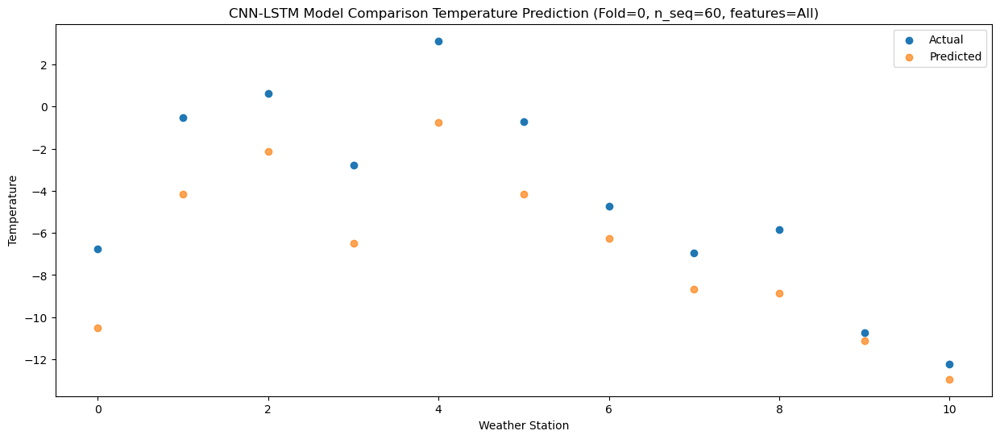

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -5.24  -8.128433
1                 1    2.24  -1.128320
2                 2    4.58   0.961619
3                 3   -0.33  -4.074685
4                 4    2.89   1.166618
5                 5    2.91  -0.596153
6                 6   -0.74  -2.955499
7                 7   -2.71  -5.173498
8                 8   -3.81  -6.223959
9                 9   -7.15  -7.913184
10               10   -8.99  -9.658072


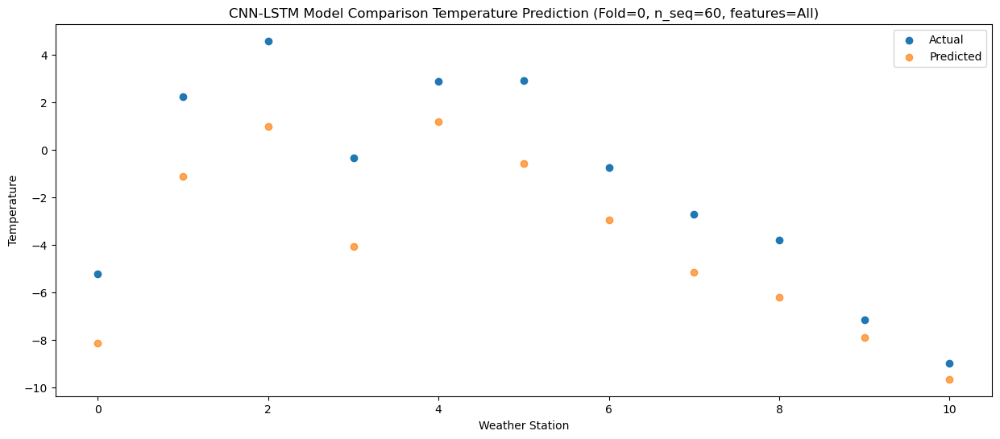

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    0.34  -2.980758
1                 1    6.10   2.444214
2                 2    8.08   4.995102
3                 3    3.46   0.139700
4                 4    9.38   6.549477
5                 5    6.83   3.206247
6                 6    3.60   1.104538
7                 7    2.13  -0.963466
8                 8    3.41  -0.414966
9                 9   -0.17  -2.593417
10               10   -2.08  -3.981279


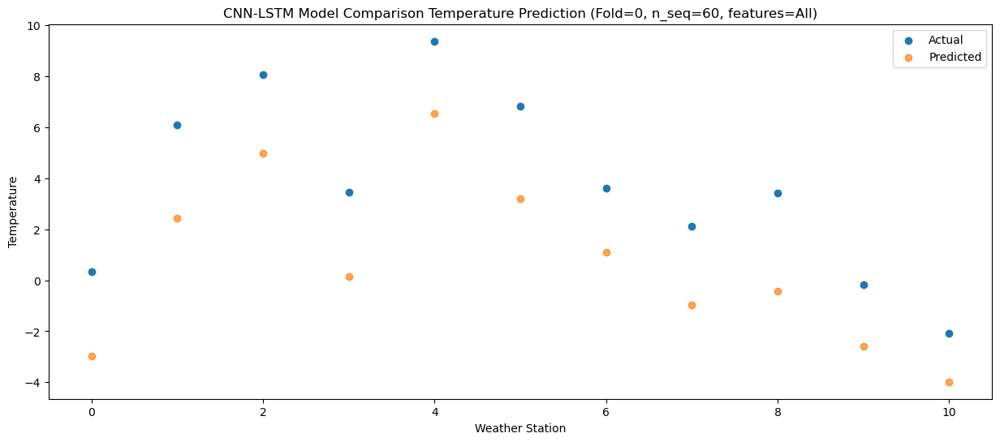

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    4.47   1.799811
1                 1    9.07   6.024063
2                 2   10.82   8.803324
3                 3    8.25   4.449282
4                 4   15.42  11.692227
5                 5    9.70   6.594991
6                 6    6.52   4.756117
7                 7    5.45   2.674880
8                 8    7.36   4.528072
9                 9    2.56   1.775721
10               10    1.53   0.476095


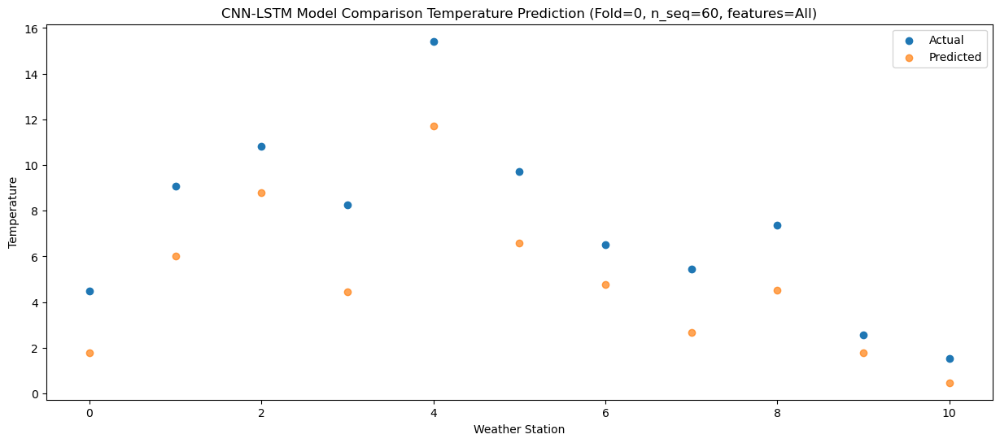

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   10.66   7.148778
1                 1   13.38  10.096539
2                 2   16.58  13.561971
3                 3   12.77   8.615789
4                 4   20.13  16.794824
5                 5   14.33  11.647103
6                 6   11.59   9.885620
7                 7   10.43   8.236422
8                 8   14.20  11.049132
9                 9   10.73   8.442683
10               10   10.85   7.780007


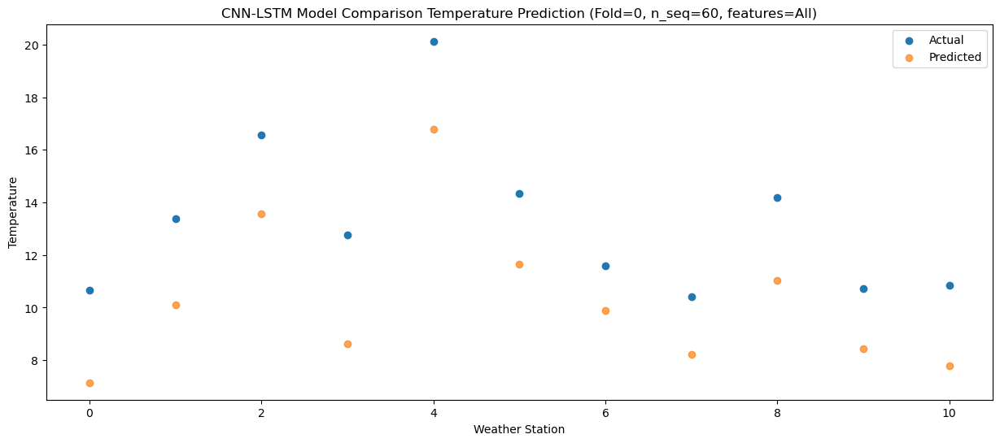

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   13.87  10.230913
1                 1   17.07  12.440408
2                 2   20.36  16.136764
3                 3   15.20  11.221053
4                 4   24.47  19.985874
5                 5   17.90  14.180229
6                 6   15.50  12.531210
7                 7   14.43  10.979600
8                 8   18.72  14.511659
9                 9   14.63  11.708889
10               10   15.61  11.252014


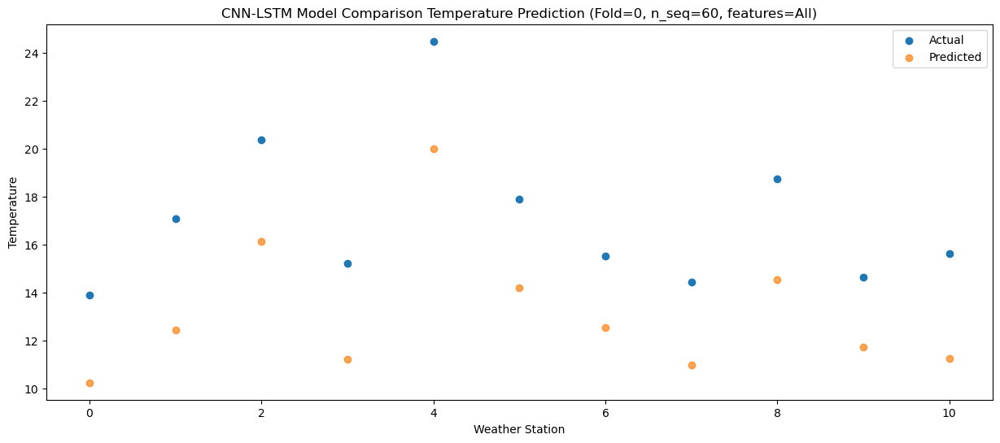

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   16.09  11.595483
1                 1   17.21  13.226862
2                 2   21.28  17.196219
3                 3   15.18  12.102196
4                 4   26.83  21.344558
5                 5   20.04  15.337469
6                 6   16.60  13.750971
7                 7   16.30  12.356942
8                 8   21.05  16.334003
9                 9   16.66  13.551326
10               10   16.72  13.339799


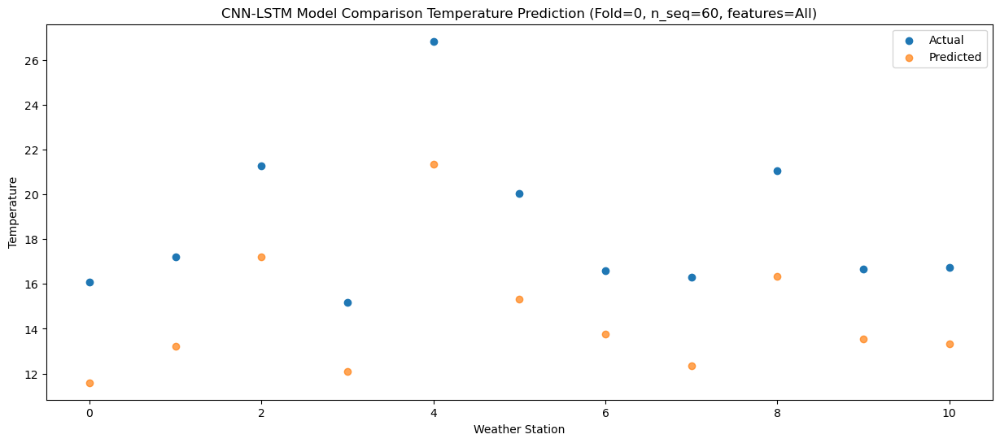

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   13.91   9.459207
1                 1   16.66  11.861161
2                 2   20.05  15.780246
3                 3   13.99  10.169679
4                 4   24.47  18.898515
5                 5   19.19  14.356518
6                 6   15.31  12.565568
7                 7   14.62  11.283729
8                 8   18.17  14.256736
9                 9   14.75  12.055801
10               10   15.60  11.903779


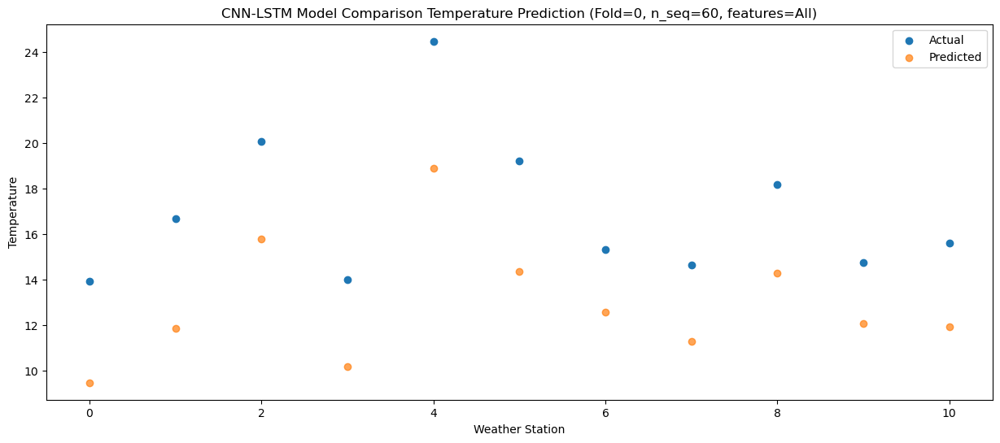

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   10.94   6.637786
1                 1   15.64   9.561095
2                 2   16.93  13.165730
3                 3   12.75   7.873224
4                 4   21.52  16.199092
5                 5   16.54  11.554795
6                 6   12.25   9.737474
7                 7   10.92   8.236386
8                 8   14.53  10.862800
9                 9   11.02   8.508586
10               10   11.76   8.053761


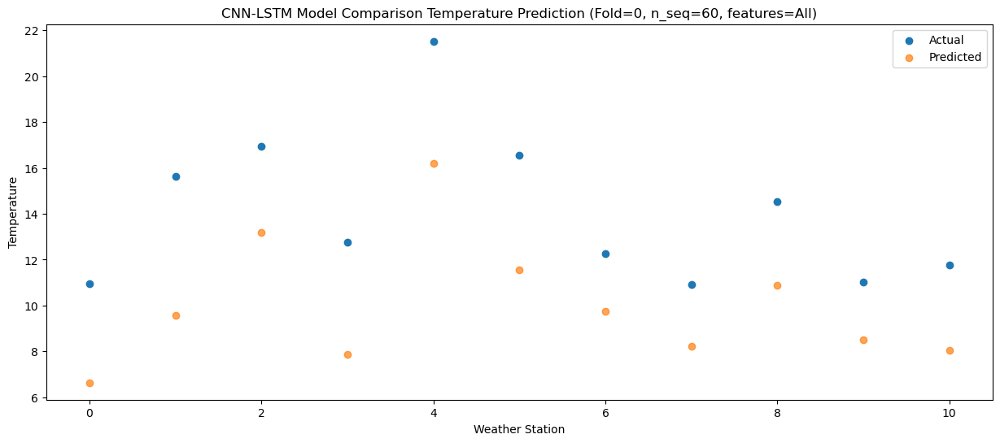

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    5.26   0.283536
1                 1   10.04   3.856195
2                 2    9.79   7.164543
3                 3    7.13   2.064584
4                 4   15.60   9.878237
5                 5    9.98   5.473034
6                 6    5.31   3.591623
7                 7    3.73   1.935952
8                 8    7.97   4.001488
9                 9    3.98   1.684560
10               10    4.52   0.984249


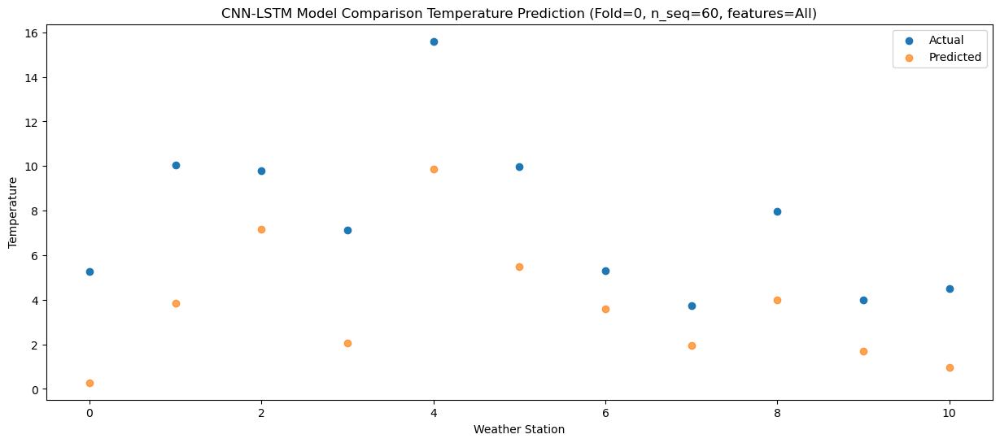

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -1.69  -3.311098
1                 1    7.35   2.004764
2                 2    7.31   4.917937
3                 3    3.02  -0.606662
4                 4    8.67   5.800826
5                 5    8.29   3.581552
6                 6    3.08   1.335112
7                 7    1.53  -0.383118
8                 8    2.00  -0.162648
9                 9   -1.04  -1.785049
10               10   -0.51  -2.797814


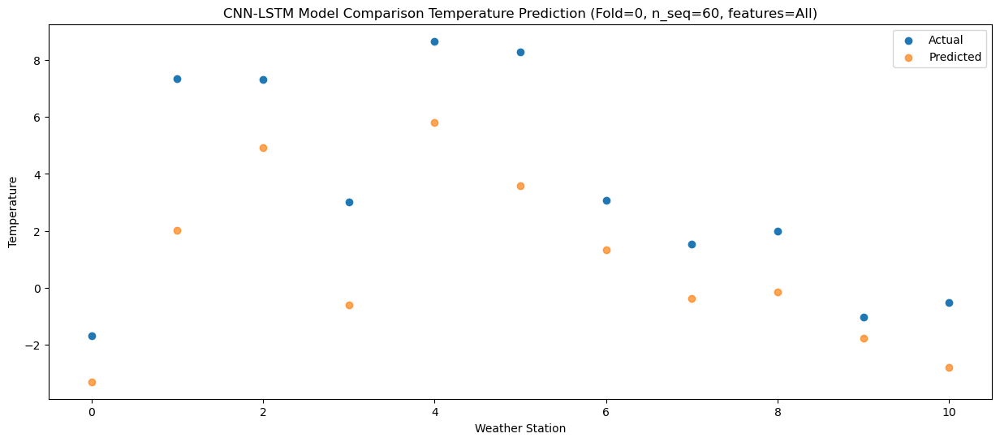

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -3.78  -7.947374
1                 1    3.50  -2.204013
2                 2    2.79   0.211921
3                 3    0.84  -4.490149
4                 4    5.94   1.619187
5                 5    1.77  -1.623885
6                 6   -3.43  -3.769010
7                 7   -5.64  -5.888398
8                 8   -3.29  -5.723307
9                 9   -6.75  -7.836129
10               10   -6.69  -9.337310


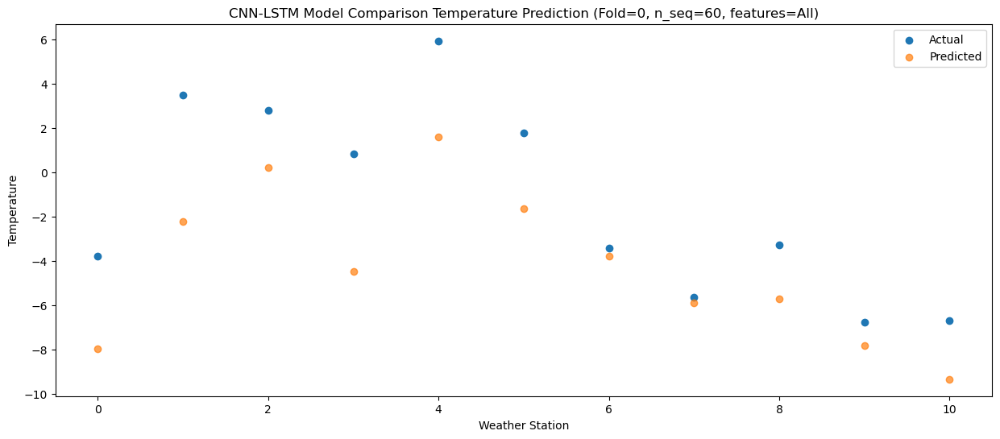

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -2.14  -5.791502
1                 1    4.29  -0.019018
2                 2    4.74   2.515809
3                 3    2.28  -2.477756
4                 4    6.91   3.617429
5                 5    3.46   0.878070
6                 6   -0.24  -1.325705
7                 7   -2.47  -3.325896
8                 8   -0.73  -3.332754
9                 9   -4.86  -5.232457
10               10   -5.56  -6.619499


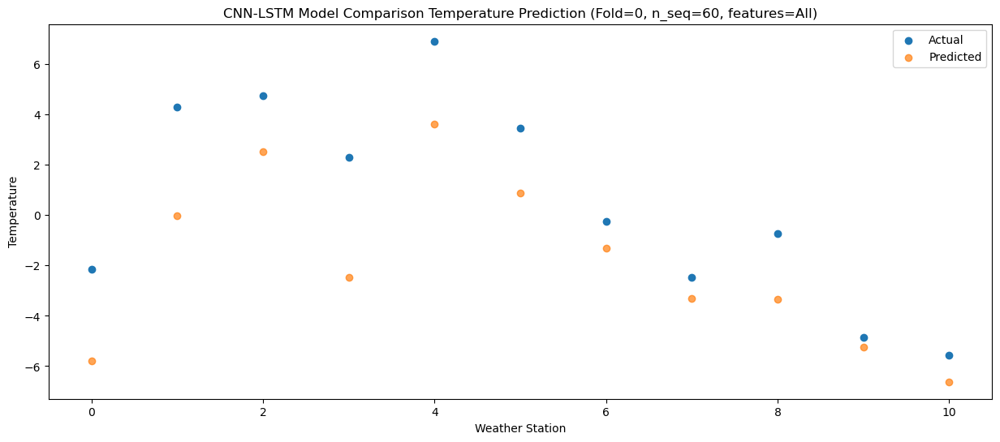

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -0.61  -5.001699
1                 1    5.39   1.027537
2                 2    7.52   3.301052
3                 3    2.69  -1.304857
4                 4    7.04   4.566079
5                 5    4.95   1.360226
6                 6    2.76  -0.816512
7                 7    0.50  -3.054885
8                 8    0.88  -2.992165
9                 9   -2.82  -5.263775
10               10   -5.15  -6.930280


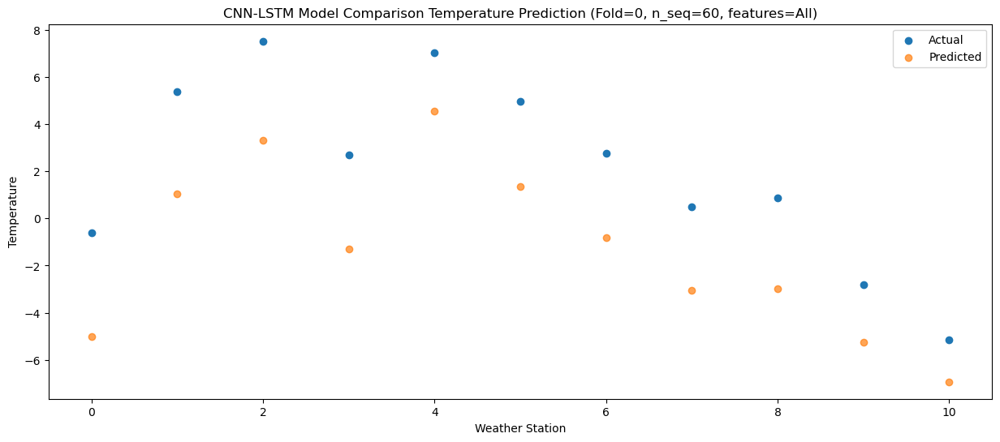

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.76  -3.106723
1                 1    6.98   2.121553
2                 2    7.50   4.478704
3                 3    6.21   0.312744
4                 4   11.76   6.804261
5                 5    5.86   2.200955
6                 6    3.24   0.216092
7                 7    1.18  -2.093630
8                 8    2.70  -1.040233
9                 9   -2.48  -3.853889
10               10   -3.29  -5.490634


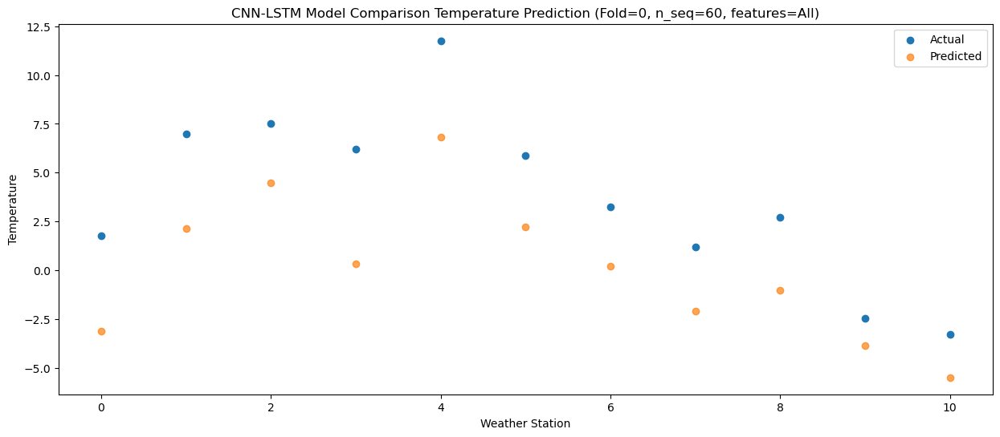

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    4.38   0.829214
1                 1    9.13   5.180823
2                 2   10.57   8.313300
3                 3    7.63   2.994981
4                 4   13.26  10.243007
5                 5   10.54   6.781421
6                 6    6.80   4.717501
7                 7    5.80   3.006560
8                 8    8.48   4.390328
9                 9    3.80   2.250763
10               10    3.56   1.431691


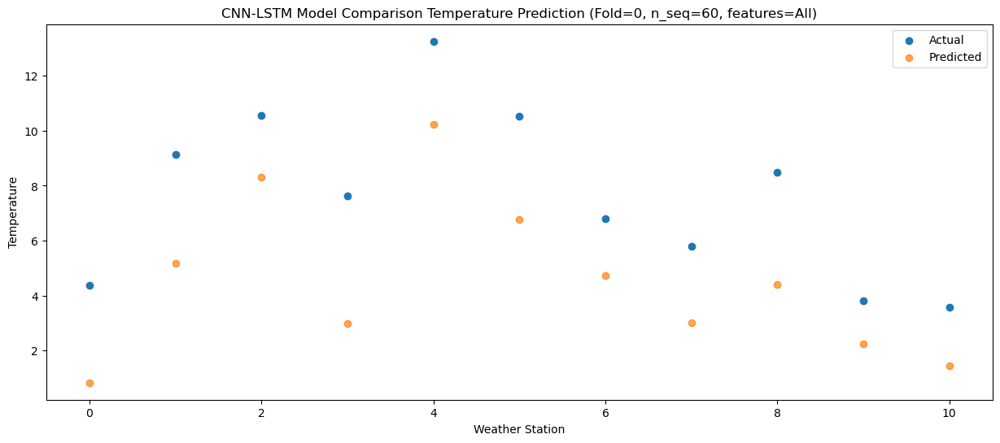

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    9.85   3.389438
1                 1   12.31   5.922820
2                 2   13.98   9.495348
3                 3   12.06   4.567625
4                 4   18.79  13.227910
5                 5   12.06   7.579493
6                 6    9.49   5.864571
7                 7    8.09   4.231928
8                 8   14.07   7.593500
9                 9    8.76   4.703368
10               10    8.58   4.246222


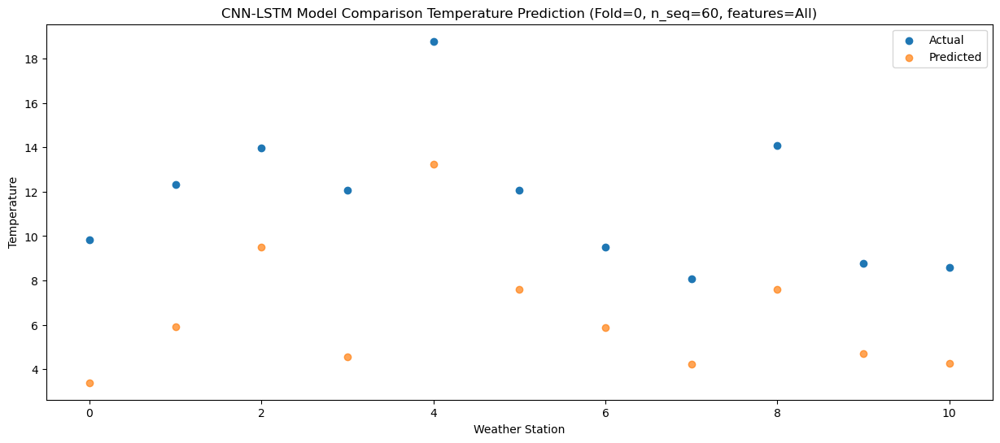

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   13.63   7.309554
1                 1   15.39   9.155417
2                 2   17.30  12.954801
3                 3   15.81   8.026731
4                 4   23.34  17.183871
5                 5   15.88  10.975387
6                 6   12.84   9.355592
7                 7   11.84   7.820882
8                 8   17.94  11.874752
9                 9   12.60   8.839992
10               10   14.09   8.579652


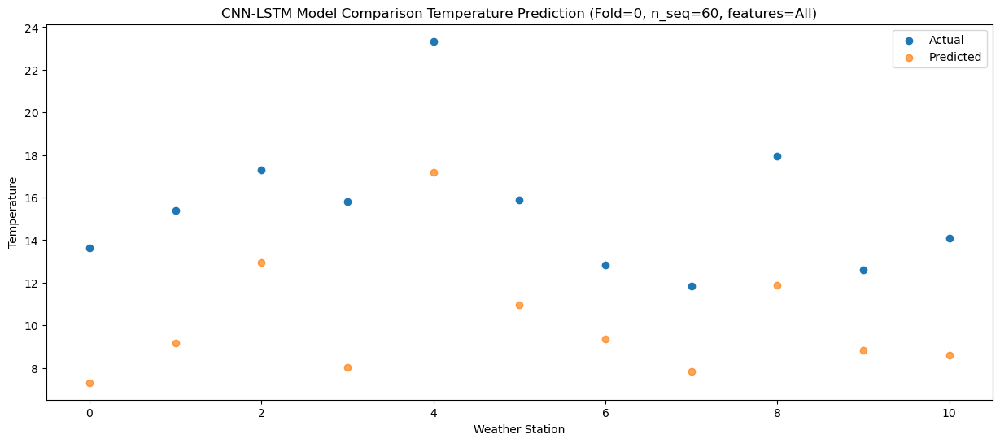

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   15.17   9.576978
1                 1   17.22  12.034994
2                 2   20.40  15.917088
3                 3   16.93  10.336939
4                 4   26.33  19.064767
5                 5   19.71  14.466921
6                 6   16.55  12.659550
7                 7   15.98  11.323569
8                 8   19.43  14.335028
9                 9   15.43  12.019041
10               10   16.55  11.791209


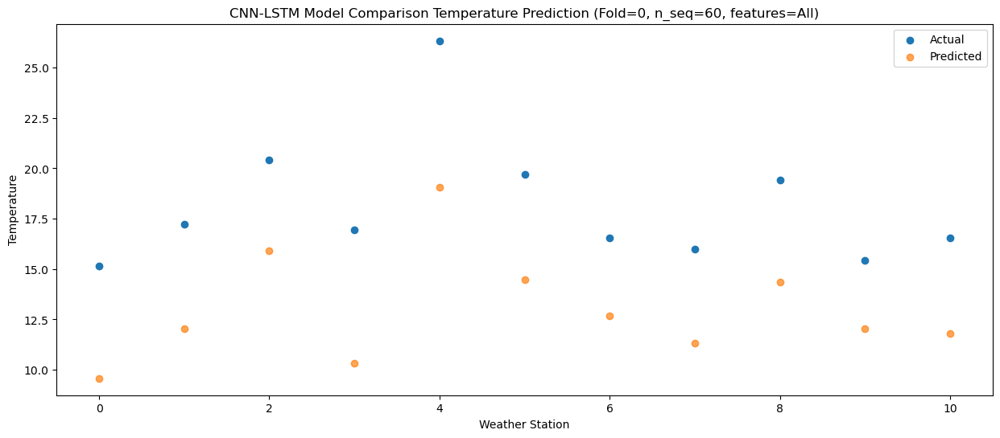

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   15.89  10.238156
1                 1   18.81  12.347433
2                 2   20.01  15.993292
3                 3   18.46  11.244815
4                 4   28.07  20.233064
5                 5   19.23  13.935202
6                 6   15.86  12.319619
7                 7   14.84  10.681803
8                 8   18.17  14.488045
9                 9   14.63  11.400761
10               10   14.74  10.952807


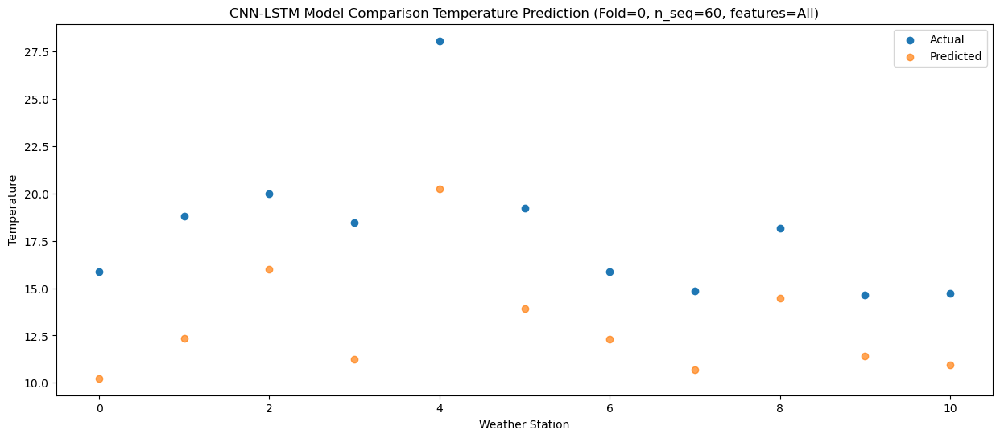

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   11.66   6.738436
1                 1   15.43   8.961045
2                 2   16.56  12.671079
3                 3   15.02   7.700964
4                 4   23.59  16.585786
5                 5   15.71  10.790124
6                 6   12.35   9.099917
7                 7   11.08   7.558366
8                 8   15.00  11.108119
9                 9   12.02   8.272460
10               10   12.36   7.903607


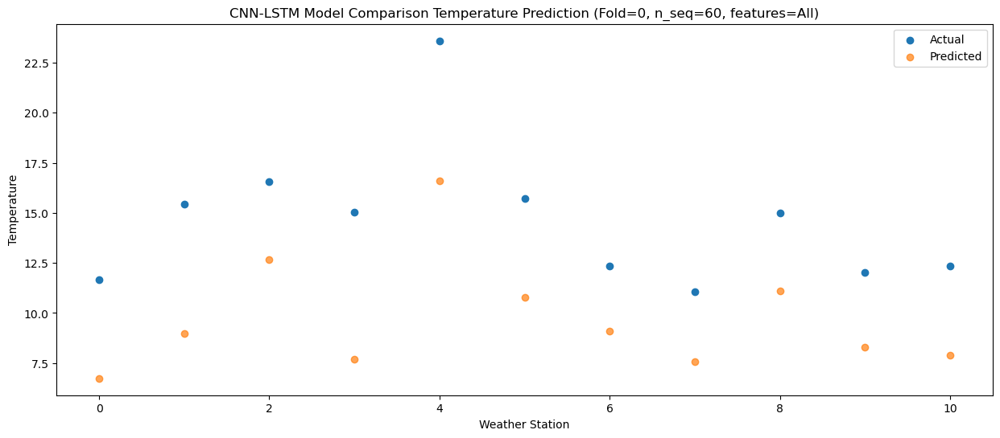

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    6.60   0.665298
1                 1   10.32   4.320651
2                 2   10.58   7.770634
3                 3    8.77   2.259925
4                 4   15.93  10.079946
5                 5   11.36   6.351232
6                 6    7.14   4.362112
7                 7    5.69   2.838238
8                 8    9.40   4.755203
9                 9    5.44   2.653683
10               10    6.40   2.107484


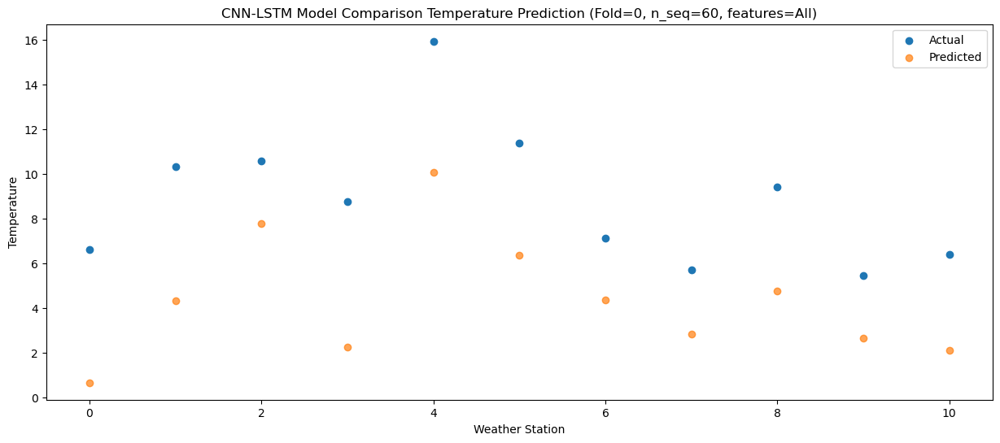

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -0.26  -5.210099
1                 1    5.08  -1.168775
2                 2    5.49   1.998303
3                 3    2.91  -3.171220
4                 4    9.57   4.358733
5                 5    5.92   0.368686
6                 6    1.27  -1.608684
7                 7   -0.76  -3.351424
8                 8    2.41  -1.625693
9                 9   -1.06  -3.933323
10               10   -1.24  -4.787732


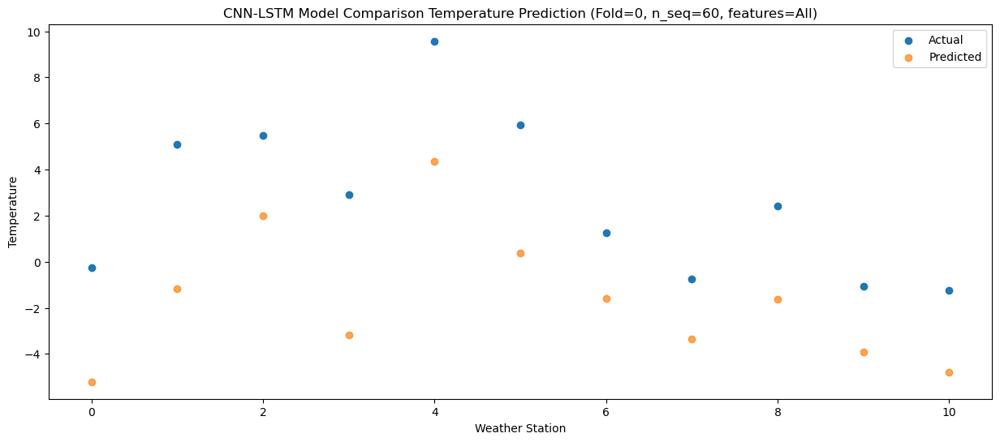

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -2.86  -7.533489
1                 1    2.38  -3.288658
2                 2    2.46   0.036432
3                 3    0.12  -5.657521
4                 4    6.78   1.713895
5                 5    3.78  -1.227609
6                 6   -1.02  -3.326785
7                 7   -2.35  -4.876843
8                 8   -0.15  -3.621146
9                 9   -3.49  -5.463344
10               10   -1.92  -6.134972


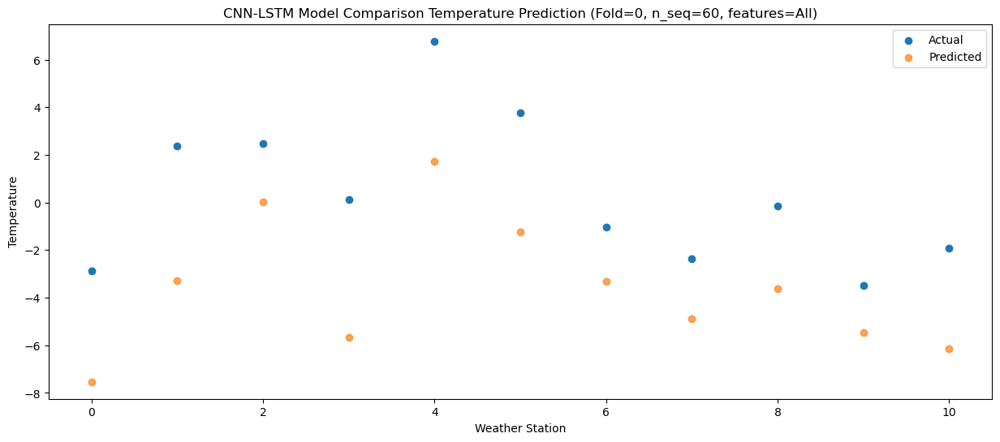

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -7.98 -12.147273
1                 1    0.11  -5.927227
2                 2   -0.05  -3.215805
3                 3   -2.76  -9.070906
4                 4    1.80  -3.144424
5                 5    2.51  -4.203356
6                 6   -3.15  -6.615504
7                 7   -5.05  -8.374688
8                 8   -6.41  -9.124839
9                 9   -9.25 -10.369719
10               10   -8.84 -11.512225


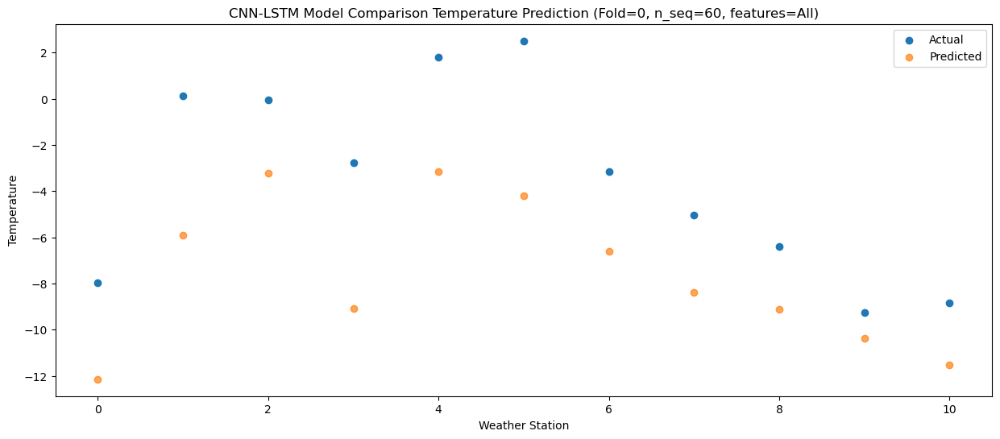

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -0.10  -7.562593
1                 1    2.61  -4.177325
2                 2    4.46  -1.072041
3                 3    1.89  -5.571196
4                 4    9.67   2.411026
5                 5    3.03  -3.230775
6                 6    0.41  -4.983841
7                 7   -1.91  -6.941700
8                 8    2.21  -4.222398
9                 9   -3.11  -7.255880
10               10   -3.83  -8.278909


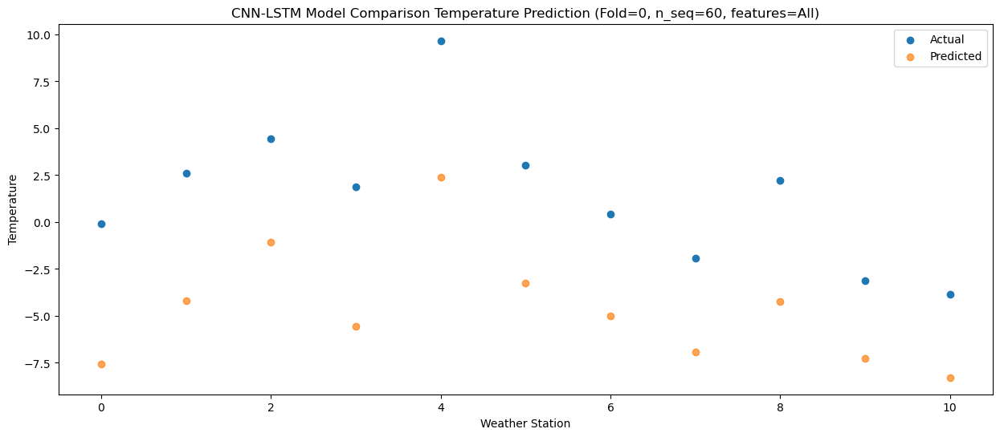

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    1.65  -3.994079
1                 1    5.91  -0.165980
2                 2    8.84   2.916364
3                 3    4.83  -1.877238
4                 4   12.22   5.759365
5                 5    7.08   0.978312
6                 6    4.25  -0.914913
7                 7    2.24  -2.815888
8                 8    5.49  -0.627302
9                 9    0.21  -3.373091
10               10   -0.33  -4.419128


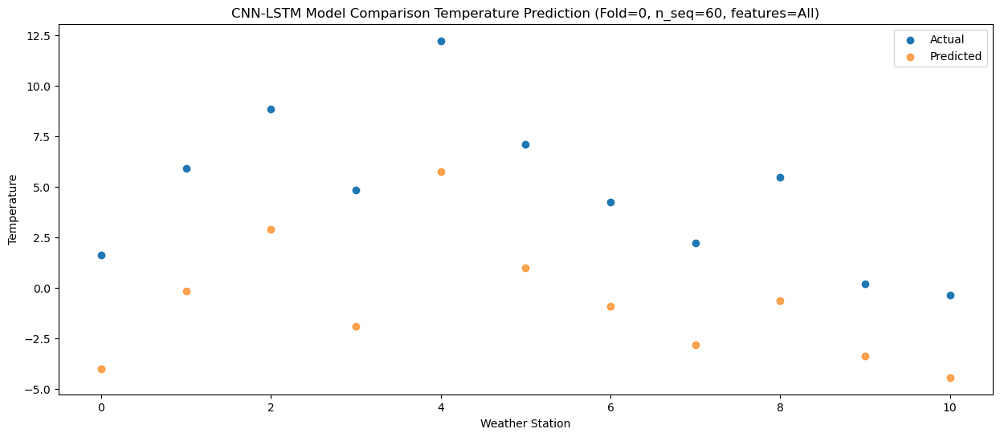

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    6.42  -0.503660
1                 1    8.79   2.400857
2                 2   12.53   5.893556
3                 3    8.40   0.893930
4                 4   15.49   9.219125
5                 5   10.30   4.013247
6                 6    7.84   2.237337
7                 7    6.72   0.544805
8                 8   10.37   3.498953
9                 9    5.43   0.684835
10               10    5.01  -0.046827


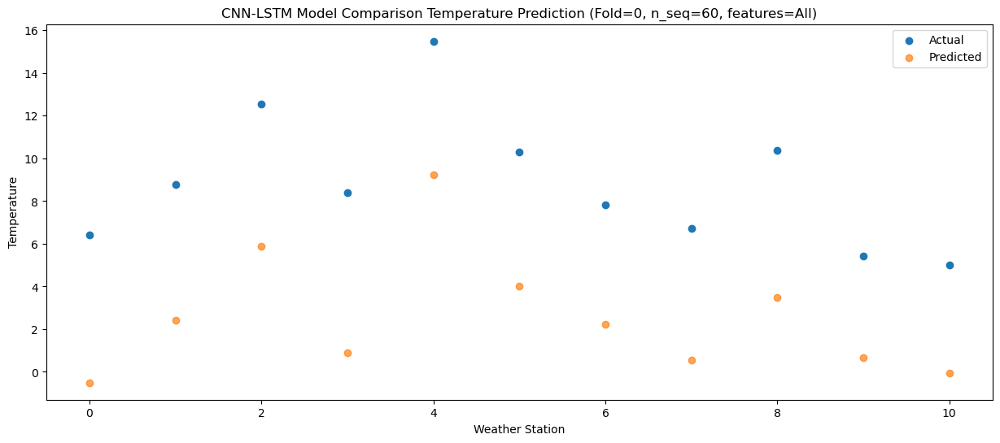

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   11.33   4.352634
1                 1   13.28   6.979189
2                 2   17.01  10.720131
3                 3   12.79   5.337218
4                 4   20.07  13.879457
5                 5   15.11   9.068497
6                 6   11.84   7.246147
7                 7   10.68   5.741694
8                 8   15.44   8.842963
9                 9   11.23   6.209258
10               10   11.98   5.729476


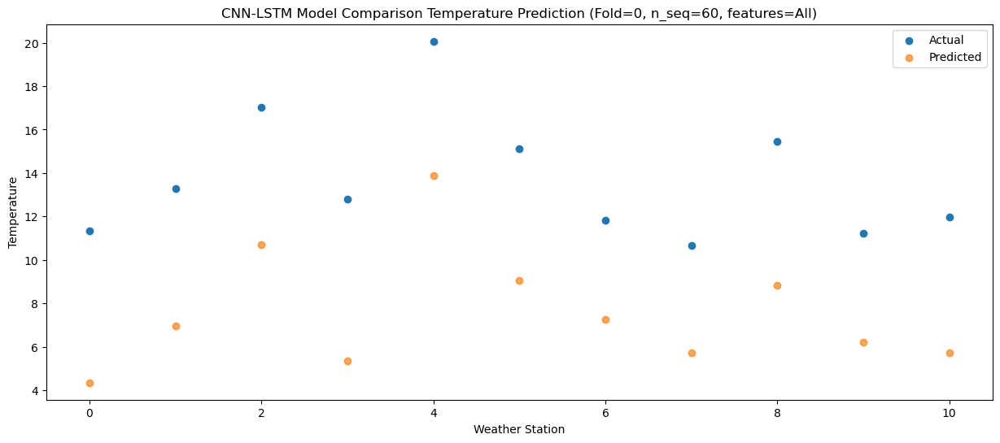

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   13.94   7.434692
1                 1   16.21   9.405580
2                 2   21.25  13.514557
3                 3   14.91   7.797547
4                 4   23.57  16.878576
5                 5   18.54  12.082985
6                 6   15.75  10.303826
7                 7   14.70   9.031229
8                 8   18.37  12.554059
9                 9   14.99  10.043485
10               10   16.30   9.881503


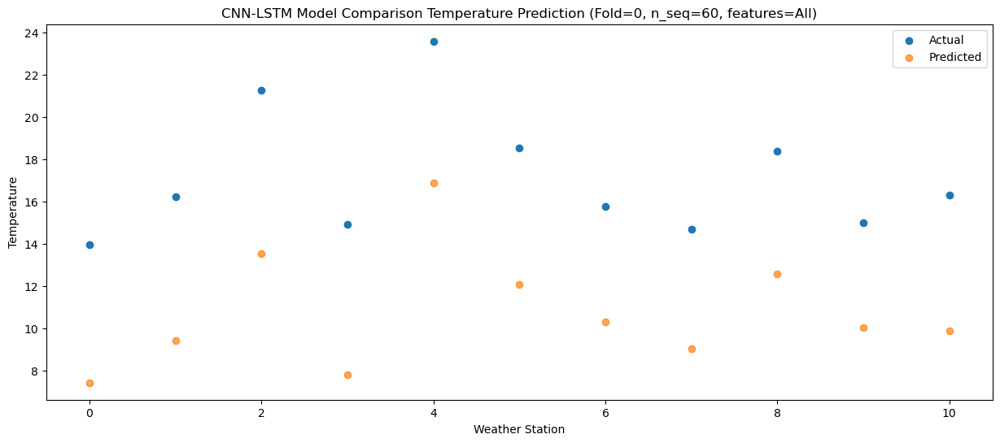

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   14.82   7.591761
1                 1   17.34   9.827509
2                 2   21.52  14.047049
3                 3   14.85   7.848785
4                 4   23.43  16.816020
5                 5   20.20  13.011148
6                 6   17.01  11.122165
7                 7   15.92  10.020619
8                 8   18.92  12.998521
9                 9   15.83  10.975633
10               10   17.19  10.980752


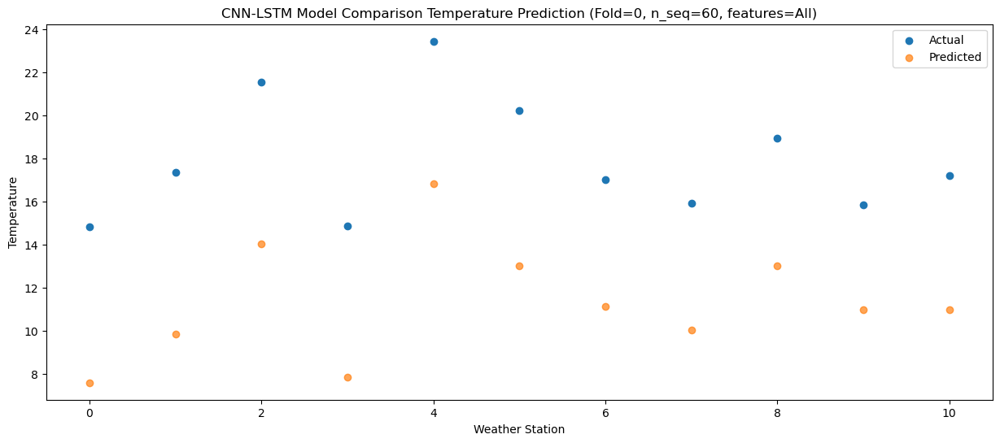

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   15.16   7.723458
1                 1   17.73   9.435468
2                 2   19.84  13.485956
3                 3   15.66   8.114369
4                 4   25.11  17.428424
5                 5   18.93  11.828147
6                 6   15.26  10.161071
7                 7   14.08   8.777297
8                 8   18.86  12.695543
9                 9   15.50   9.891754
10               10   16.44   9.680738


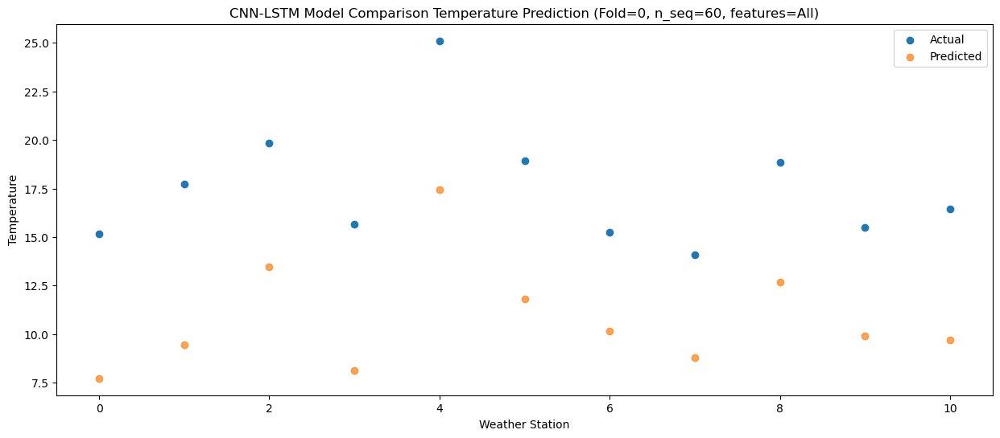

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   11.02   4.076059
1                 1   14.49   6.409367
2                 2   17.07  10.354135
3                 3   13.07   4.694473
4                 4   21.19  13.591546
5                 5   16.99   8.920860
6                 6   12.83   7.120282
7                 7   11.15   5.750116
8                 8   15.24   9.003495
9                 9   13.31   6.497768
10               10   13.66   6.292341


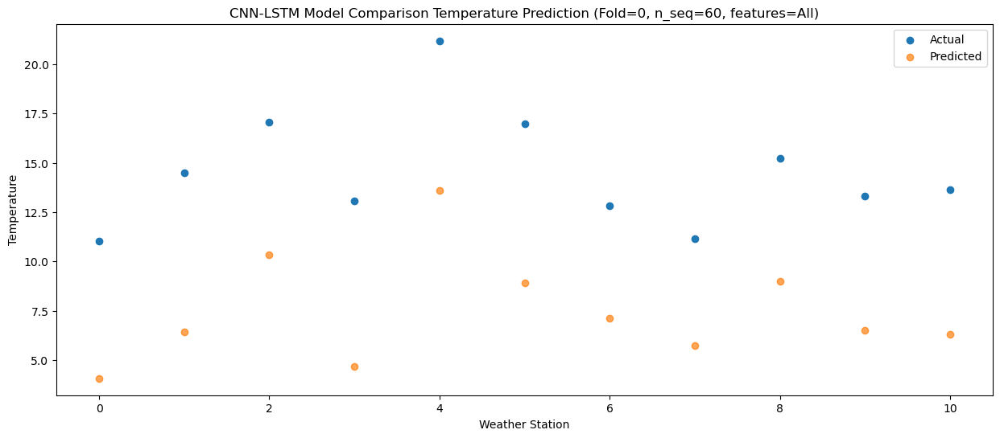

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    7.75   0.912907
1                 1   11.17   3.454711
2                 2   11.17   7.092967
3                 3    8.93   2.014056
4                 4   18.74  10.728541
5                 5   11.96   5.291202
6                 6    7.56   3.551758
7                 7    5.32   1.919306
8                 8    9.81   5.217240
9                 9    6.57   2.339201
10               10    7.43   1.793449


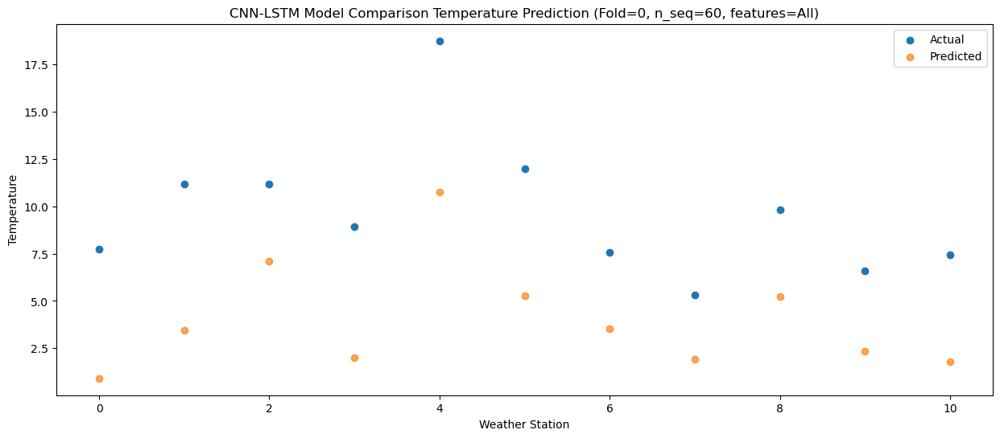

f, t:
[[-2.980e+00  3.390e+00  4.930e+00  1.130e+00  7.340e+00  4.630e+00
   6.800e-01 -1.370e+00 -9.500e-01 -4.560e+00 -5.060e+00]
 [-3.450e+00  2.490e+00  4.820e+00  1.110e+00  5.290e+00  4.060e+00
   3.200e-01 -1.740e+00 -1.110e+00 -4.380e+00 -5.730e+00]
 [-3.720e+00  2.110e+00  4.200e+00  1.150e+00  6.030e+00  3.530e+00
  -1.500e-01 -1.860e+00 -2.300e+00 -5.660e+00 -6.760e+00]
 [-3.370e+00  2.860e+00  4.820e+00  1.150e+00  5.360e+00  3.220e+00
   9.600e-01 -8.200e-01 -1.800e+00 -6.530e+00 -8.220e+00]
 [ 3.210e+00  8.690e+00  1.107e+01  8.070e+00  1.311e+01  6.810e+00
   6.380e+00  4.760e+00  4.770e+00  6.600e-01 -2.080e+00]
 [ 3.860e+00  9.180e+00  1.083e+01  8.150e+00  1.336e+01  8.780e+00
   7.620e+00  5.660e+00  7.050e+00  2.320e+00  5.700e-01]
 [ 8.590e+00  1.195e+01  1.452e+01  1.104e+01  1.834e+01  1.247e+01
   9.960e+00  8.780e+00  1.193e+01  7.410e+00  7.000e+00]
 [ 1.281e+01  1.570e+01  1.824e+01  1.395e+01  2.254e+01  1.682e+01
   1.521e+01  1.430e+01  1.786e+01  1.439e+0

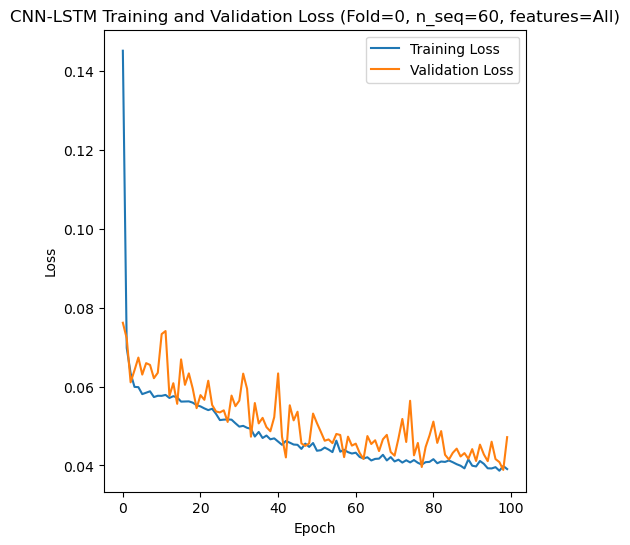

[[12.2  10.03 13.86 ... 24.46 19.58 17.03]
 [ 8.35  6.22 11.74 ... 22.47 18.02 13.98]
 [10.82  7.37 13.36 ... 24.57 19.57 16.15]
 ...
 [ 7.69  4.56 11.66 ... 25.3  19.83 13.28]
 [ 8.93  6.7  14.14 ... 25.37 21.51 12.55]
 [ 7.96  5.46 11.14 ... 25.13 20.28 10.63]]
Epoch 1/100
84/84 [==============================] - 39s 191ms/step - loss: 0.1419 - accuracy: 0.2143 - mae: 0.1231 - rmse: 0.1419 - mape: inf - pearson: 0.6384 - val_loss: 0.0750 - val_accuracy: 0.6000 - val_mae: 0.0590 - val_rmse: 0.0750 - val_mape: 12.6061 - val_pearson: 0.8203
Epoch 2/100
84/84 [==============================] - 9s 107ms/step - loss: 0.0684 - accuracy: 0.4762 - mae: 0.0540 - rmse: 0.0684 - mape: inf - pearson: 0.8016 - val_loss: 0.0615 - val_accuracy: 0.6000 - val_mae: 0.0489 - val_rmse: 0.0615 - val_mape: 10.9320 - val_pearson: 0.8518
Epoch 3/100
84/84 [==============================] - 9s 109ms/step - loss: 0.0636 - accuracy: 0.4881 - mae: 0.0505 - rmse: 0.0636 - mape: inf - pearson: 0.8270 - val_loss: 0

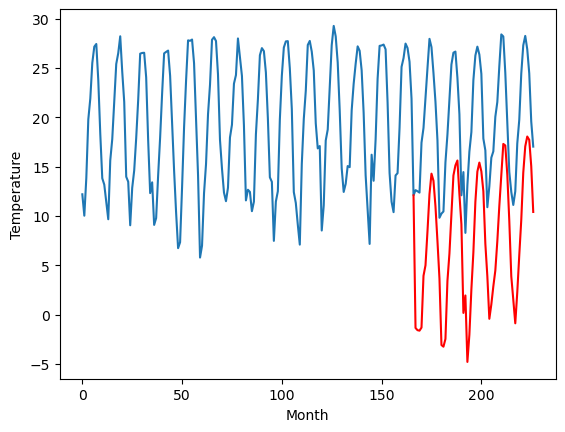

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.52		2.76		-0.76
2.61		2.38		-0.23
1.50		2.25		0.75
1.59		2.35		0.76
7.59		8.08		0.49
8.81		9.28		0.47
12.16		13.28		1.12
16.51		17.79		1.28
19.88		19.94		0.06
18.47		18.89		0.42
14.93		15.86		0.93
11.21		11.63		0.42
7.11		8.19		1.08
0.22		1.28		1.06
0.02		0.73		0.71
0.68		0.60		-0.08
7.45		7.92		0.47
9.59		10.84		1.25
13.32		15.00		1.68
17.46		19.59		2.13
18.84		20.52		1.68
19.11		21.07		1.96
15.37		17.48		2.11
11.59		14.19		2.60
3.93		4.69		0.76
5.56		6.20		0.64
-1.17		-1.15		0.02
3.06		1.62		-1.44
6.63		6.76		0.13
9.63		10.74		1.11
15.51		16.57		1.06
19.48		19.87		0.39
19.98		21.06		1.08
18.52		19.97		1.45
15.43		17.58		2.15
9.09		12.01		2.92
6.09		8.34		2.25
0.28		3.56		3.28
2.47		5.10		2.63
5.84		6.81		0.97
6.61		8.44		1.83
9.88		12.07		2.19
13.16		16.19		3.03
16.35		19.57		3.22
19.95		22.55		2.60
19.41		22.29		2.88
15.90		19.36		3.46
10.89		14.26		3.37
5.27		8.37		3.10
2.13		6.07		3.94

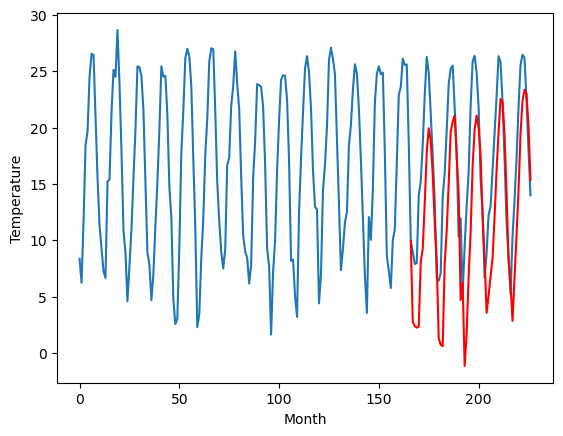

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.48		-1.08		0.40
-1.05		-1.39		-0.34
-1.58		-1.50		0.08
-1.30		-1.35		-0.05
5.80		4.31		-1.49
4.83		5.43		0.60
8.98		9.27		0.29
13.21		13.59		0.38
14.68		15.71		1.03
14.67		14.72		0.05
11.87		11.81		-0.06
7.52		7.76		0.24
2.72		4.27		1.55
-4.34		-2.63		1.71
-3.92		-3.08		0.84
-3.43		-3.00		0.43
3.63		4.04		0.41
5.03		6.87		1.84
9.15		10.97		1.82
13.03		15.37		2.34
13.80		16.33		2.53
14.46		16.88		2.42
11.44		13.35		1.91
7.66		10.14		2.48
-0.08		0.74		0.82
2.52		2.42		-0.10
-4.37		-4.84		-0.47
-1.02		-2.07		-1.05
2.98		2.94		-0.04
6.57		6.88		0.31
11.93		12.51		0.58
14.90		15.74		0.84
15.61		16.86		1.25
14.00		15.77		1.77
11.61		13.49		1.88
4.92		7.98		3.06
1.60		4.43		2.83
-1.56		-0.21		1.35
-0.56		1.30		1.86
2.03		3.09		1.06
3.46		4.71		1.25
6.15		8.12		1.97
9.39		12.11		2.72
13.14		15.43		2.29
15.51		18.41		2.90
15.95		18.22		2.27
12.99		15.28		2.29
6.95		10.25		3.30
0.39		4.44		4.05
-2.3

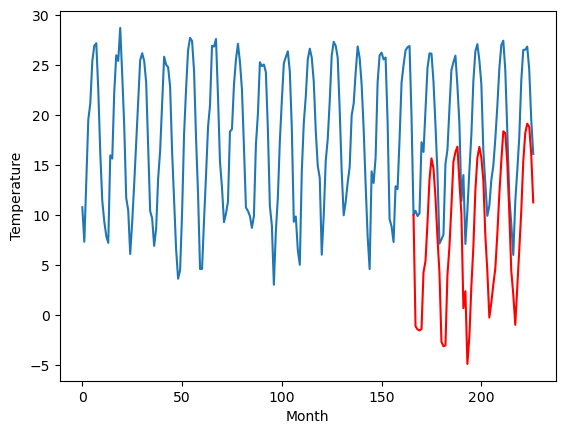

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.05		1.88		-2.17
2.63		1.38		-1.25
3.38		1.25		-2.13
2.85		1.32		-1.53
10.49		7.29		-3.20
10.37		8.59		-1.78
14.12		12.63		-1.49
16.90		17.28		0.38
18.55		19.23		0.68
18.79		18.30		-0.49
15.38		15.07		-0.31
10.84		10.36		-0.48
7.94		7.08		-0.86
1.76		0.26		-1.50
1.66		-0.20		-1.86
0.07		-0.99		-1.06
7.44		7.15		-0.29
9.78		9.88		0.10
13.67		14.03		0.36
17.56		18.92		1.36
17.44		19.94		2.50
18.41		20.33		1.92
15.40		16.85		1.45
12.71		13.12		0.41
5.55		3.95		-1.60
8.92		5.31		-3.61
0.87		-1.93		-2.80
0.40		0.36		-0.04
6.24		5.81		-0.43
12.24		9.95		-2.29
16.67		15.67		-1.00
19.67		19.27		-0.40
20.61		20.65		0.04
18.97		19.34		0.37
16.20		17.00		0.80
10.64		11.29		0.65
5.59		6.75		1.16
3.50		2.25		-1.25
4.21		3.75		-0.46
5.21		5.55		0.34
9.04		7.40		-1.64
9.88		10.93		1.05
14.47		15.63		1.16
18.62		19.05		0.43
20.34		21.78		1.44
22.31		21.82		-0.49
19.23		18.69		-0.54
11.97		13.13		1.16
5.69		

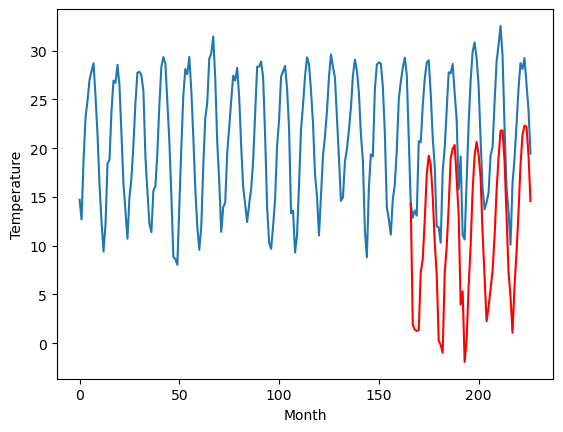

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
8.11		5.73		-2.38
6.22		5.23		-0.99
7.03		5.07		-1.96
6.65		5.10		-1.55
14.69		11.19		-3.50
14.43		12.50		-1.93
18.23		16.62		-1.61
21.26		21.43		0.17
23.30		23.35		0.05
23.54		22.36		-1.18
19.96		19.06		-0.90
15.02		14.22		-0.80
11.92		11.03		-0.89
5.56		4.15		-1.41
5.55		3.62		-1.93
3.85		2.62		-1.23
11.46		11.11		-0.35
13.76		13.83		0.07
17.88		18.01		0.13
21.35		23.01		1.66
21.44		24.01		2.57
22.41		24.42		2.01
18.83		20.92		2.09
15.79		17.14		1.35
8.24		7.85		-0.39
12.12		9.22		-2.90
3.64		1.82		-1.82
3.33		4.10		0.77
9.11		9.67		0.56
15.38		13.87		-1.51
20.00		19.72		-0.28
23.37		23.37		0.00
24.46		24.78		0.32
22.45		23.40		0.95
19.27		21.01		1.74
13.88		15.25		1.37
8.88		10.63		1.75
6.86		6.06		-0.80
7.34		7.57		0.23
8.52		9.38		0.86
12.34		11.24		-1.10
13.30		14.85		1.55
17.94		19.67		1.73
22.83		23.14		0.31
24.78		25.79		1.01
26.21		25.84		-0.37
22.36		22.70		0.34
14.96		17.03		2.07


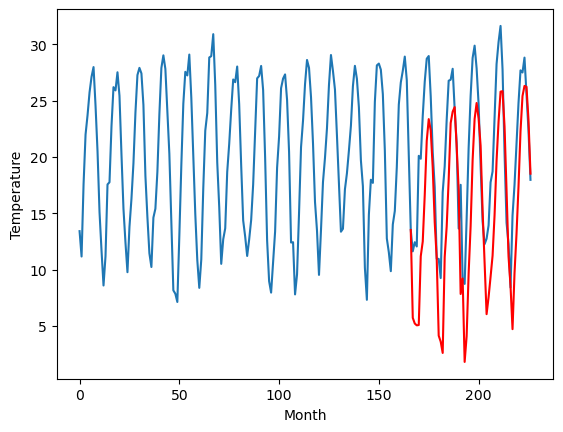

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
7.80		4.82		-2.98
5.77		3.95		-1.82
5.11		3.79		-1.32
4.59		3.82		-0.77
11.94		9.60		-2.34
14.73		11.38		-3.35
19.92		15.93		-3.99
22.64		20.91		-1.73
25.34		23.07		-2.27
25.19		22.14		-3.05
17.66		18.54		0.88
14.82		13.32		-1.50
11.10		9.96		-1.14
4.35		3.38		-0.97
2.84		2.77		-0.07
3.22		1.55		-1.67
10.56		9.88		-0.68
12.83		13.05		0.22
18.42		17.37		-1.05
22.69		22.85		0.16
22.03		23.86		1.83
21.44		24.07		2.63
21.08		20.42		-0.66
16.76		16.29		-0.47
10.29		7.34		-2.95
10.55		7.49		-3.06
3.23		0.72		-2.51
3.12		2.87		-0.25
10.07		8.53		-1.54
16.98		12.64		-4.34
22.38		18.73		-3.65
24.44		22.63		-1.81
25.36		24.32		-1.04
22.51		23.23		0.72
19.46		20.59		1.13
13.38		14.73		1.35
6.42		9.45		3.03
5.30		4.73		-0.57
5.76		6.26		0.50
5.90		7.64		1.74
10.96		9.62		-1.34
14.12		13.90		-0.22
18.73		19.04		0.31
25.42		22.50		-2.92
26.52		25.44		-1.08
25.71		25.23		-0.48
23.43		22.12		-1.31
15.83		16.

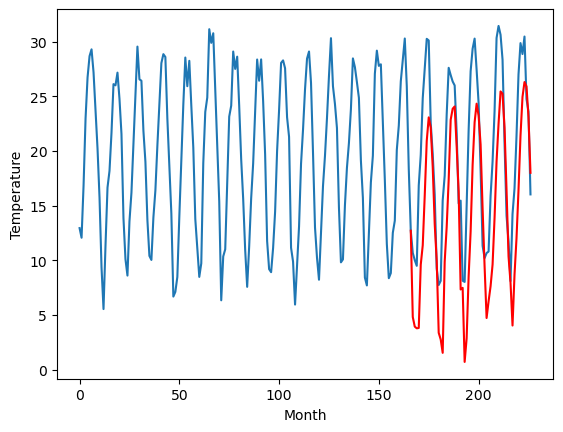

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.88		3.50		-0.38
3.15		3.12		-0.03
2.34		2.99		0.65
2.41		3.10		0.69
8.08		8.80		0.72
9.71		10.00		0.29
12.49		14.00		1.51
17.16		18.48		1.32
20.34		20.65		0.31
18.71		19.61		0.90
15.29		16.59		1.30
11.80		12.38		0.58
7.65		8.93		1.28
0.44		2.02		1.58
0.24		1.48		1.24
1.02		1.39		0.37
7.30		8.64		1.34
9.87		11.57		1.70
13.64		15.72		2.08
17.65		20.29		2.64
19.01		21.22		2.21
19.27		21.78		2.51
15.94		18.18		2.24
11.99		14.90		2.91
4.39		5.43		1.04
5.91		6.92		1.01
-0.48		-0.41		0.07
3.33		2.38		-0.95
7.17		7.49		0.32
9.93		11.47		1.54
15.85		17.28		1.43
19.43		20.56		1.13
20.17		21.75		1.58
18.67		20.68		2.01
15.78		18.29		2.51
9.44		12.74		3.30
6.55		9.09		2.54
0.54		4.32		3.78
2.67		5.85		3.18
6.26		7.55		1.29
6.93		9.18		2.25
10.19		12.81		2.62
13.19		16.89		3.70
16.47		20.27		3.80
19.92		23.27		3.35
19.50		23.00		3.50
16.33		20.08		3.75
11.32		15.00		3.68
5.63		9.11		3.48
2.89		6.82		3.9

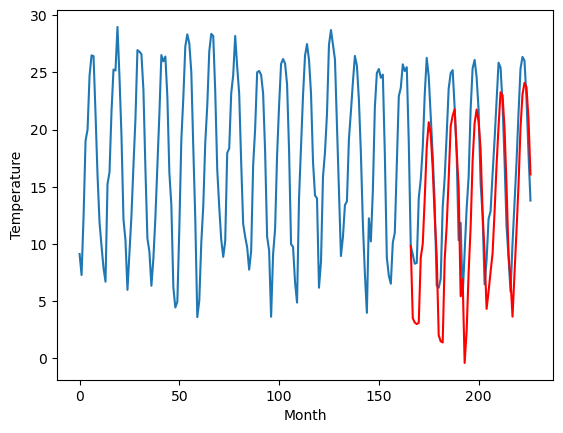

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.92		0.04		-0.88
0.30		-0.85		-1.15
-0.55		-1.33		-0.78
0.13		-1.61		-1.74
7.05		5.17		-1.88
8.19		6.97		-1.22
12.69		12.19		-0.50
18.25		18.43		0.18
20.79		20.56		-0.23
18.77		19.01		0.24
15.47		14.79		-0.68
8.70		8.55		-0.15
5.03		5.95		0.92
-1.57		-1.17		0.40
-1.88		-2.41		-0.53
-4.88		-5.13		-0.25
6.44		5.79		-0.65
8.15		9.03		0.88
12.81		13.62		0.81
18.89		19.94		1.05
19.88		20.72		0.84
21.10		21.12		0.02
17.39		17.16		-0.23
12.19		12.86		0.67
2.89		2.74		-0.15
5.30		2.89		-2.41
-3.53		-5.27		-1.74
-1.48		-2.95		-1.47
4.47		3.60		-0.87
9.66		8.06		-1.60
15.13		15.37		0.24
19.19		19.54		0.35
23.32		21.52		-1.80
20.45		20.02		-0.43
16.61		16.84		0.23
9.94		10.58		0.64
3.34		5.08		1.74
-0.40		-0.56		-0.16
0.79		1.09		0.30
2.29		2.50		0.21
5.12		4.42		-0.70
9.52		9.62		0.10
14.87		15.51		0.64
18.68		19.41		0.73
20.98		21.75		0.77
21.48		21.45		-0.03
17.86		18.45		0.59
11.55		12.07		0.52
4.1

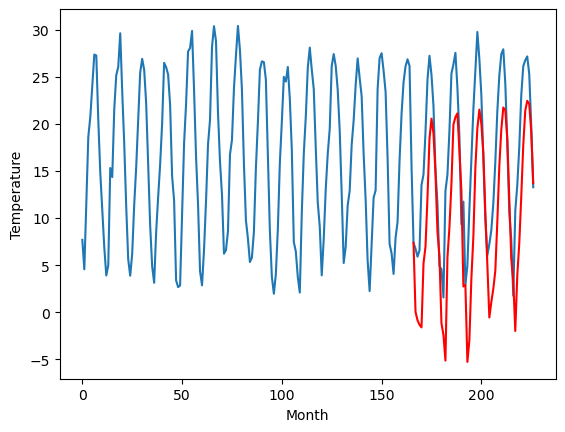

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.44		-0.70		-1.14
-1.41		-1.94		-0.53
-1.23		-2.55		-1.32
-1.74		-2.85		-1.11
6.09		4.18		-1.91
7.47		6.34		-1.13
13.58		11.98		-1.60
18.69		18.67		-0.02
21.23		20.72		-0.51
20.30		19.22		-1.08
13.65		14.49		0.84
7.47		7.39		-0.08
4.59		5.01		0.42
-2.09		-1.94		0.15
-2.44		-3.20		-0.76
-7.22		-7.00		0.22
5.34		5.09		-0.25
7.14		8.38		1.24
11.95		13.15		1.20
17.98		20.15		2.17
19.49		21.00		1.51
19.88		21.09		1.21
17.37		17.11		-0.26
11.12		12.10		0.98
3.37		2.32		-1.05
2.56		1.46		-1.10
-5.06		-6.36		-1.30
-4.08		-4.58		-0.50
3.17		2.50		-0.67
10.28		7.09		-3.19
15.64		14.66		-0.98
19.93		19.37		-0.56
24.08		21.75		-2.33
21.41		20.17		-1.24
17.58		16.82		-0.76
9.35		10.25		0.90
1.50		3.47		1.97
-2.13		-2.27		-0.14
-1.27		-0.58		0.69
-0.90		0.73		1.63
3.53		2.91		-0.62
7.86		8.65		0.79
13.55		15.50		1.95
18.48		19.47		0.99
21.36		21.57		0.21
23.17		21.46		-1.71
18.53		18.33		-0.20
9.95		11.28

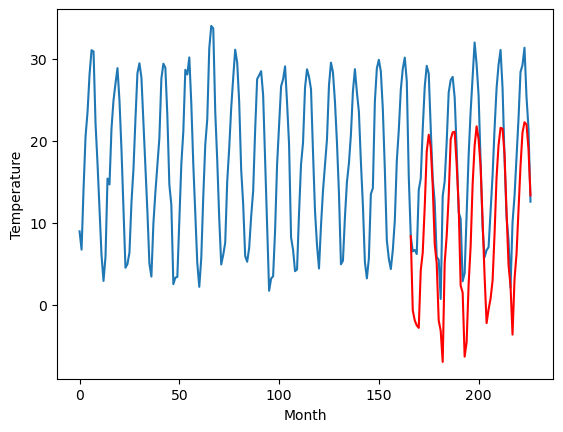

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.68		0.72		-3.96
3.32		-0.72		-4.04
2.87		-1.28		-4.15
1.63		-1.54		-3.17
9.59		5.17		-4.42
11.90		7.55		-4.35
18.43		13.34		-5.09
24.81		19.92		-4.89
26.39		22.14		-4.25
25.16		20.75		-4.41
18.41		15.96		-2.45
11.81		8.86		-2.95
8.63		6.28		-2.35
1.36		-0.45		-1.81
1.47		-1.68		-3.15
-2.90		-5.30		-2.40
7.81		6.23		-1.58
11.57		9.80		-1.77
16.12		14.62		-1.50
23.23		21.71		-1.52
23.90		22.60		-1.30
23.75		22.57		-1.18
21.80		18.54		-3.26
14.36		13.44		-0.92
8.11		3.94		-4.17
6.50		2.43		-4.07
-0.42		-4.89		-4.47
-0.36		-3.11		-2.75
6.57		3.83		-2.74
13.05		8.30		-4.75
18.50		15.86		-2.64
23.07		20.61		-2.46
26.67		23.07		-3.60
23.84		21.76		-2.08
21.43		18.34		-3.09
12.89		11.80		-1.09
3.90		4.85		0.95
1.55		-0.92		-2.47
1.83		0.76		-1.07
2.98		1.84		-1.14
6.71		4.06		-2.65
12.06		10.08		-1.98
17.17		16.94		-0.23
20.40		20.84		0.44
25.02		23.20		-1.82
25.42		22.93		-2.49
21.90		19.85		-2.0

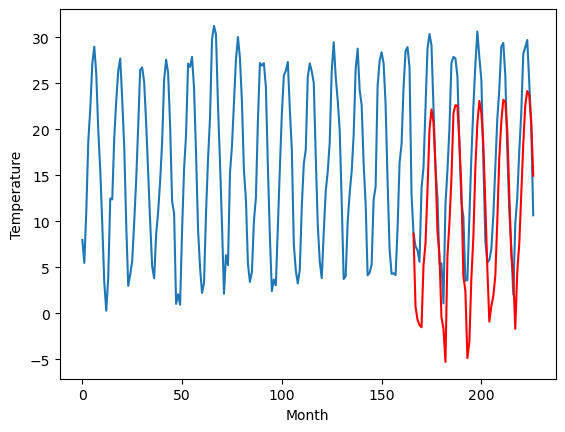

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.56		-2.01		-0.45
-4.37		-3.24		1.13
-4.03		-3.43		0.60
-3.29		-3.88		-0.59
1.03		1.95		0.92
2.66		4.04		1.38
8.12		9.97		1.85
15.44		16.28		0.84
19.31		19.35		0.04
17.12		17.41		0.29
12.59		13.23		0.64
7.05		7.43		0.38
2.85		4.22		1.37
-4.16		-2.83		1.33
-6.00		-4.63		1.37
-6.96		-6.17		0.79
0.26		2.88		2.62
4.91		7.23		2.32
9.45		11.97		2.52
15.54		18.44		2.90
17.77		18.98		1.21
17.55		19.75		2.20
13.85		15.22		1.37
9.43		11.50		2.07
0.11		0.86		0.75
-0.66		0.09		0.75
-7.68		-7.99		-0.31
-3.78		-4.60		-0.82
0.78		1.42		0.64
4.13		5.68		1.55
11.11		13.73		2.62
15.50		17.39		1.89
19.44		19.51		0.07
18.90		18.70		-0.20
13.99		14.93		0.94
5.89		8.91		3.02
2.38		4.74		2.36
-4.77		-1.75		3.02
-1.81		0.03		1.84
-2.13		0.54		2.67
-1.01		2.12		3.13
6.21		8.53		2.32
8.77		13.35		4.58
13.14		17.38		4.24
18.28		20.81		2.53
16.54		19.34		2.80
13.35		16.83		3.48
8.00		11.46		3.46
0.06		4.35		4.29
-1.6

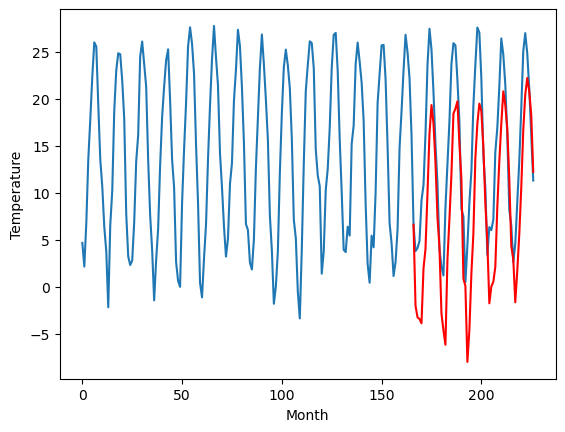

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -1.84  -1.342751
1                 1    3.52   2.758533
2                 2   -1.48  -1.076428
3                 3    4.05   1.880683
4                 4    8.11   5.733450
5                 5    7.80   4.824225
6                 6    3.88   3.503097
7                 7    0.92   0.038805
8                 8    0.44  -0.696483
9                 9    4.68   0.715628
10               10   -1.56  -2.007216


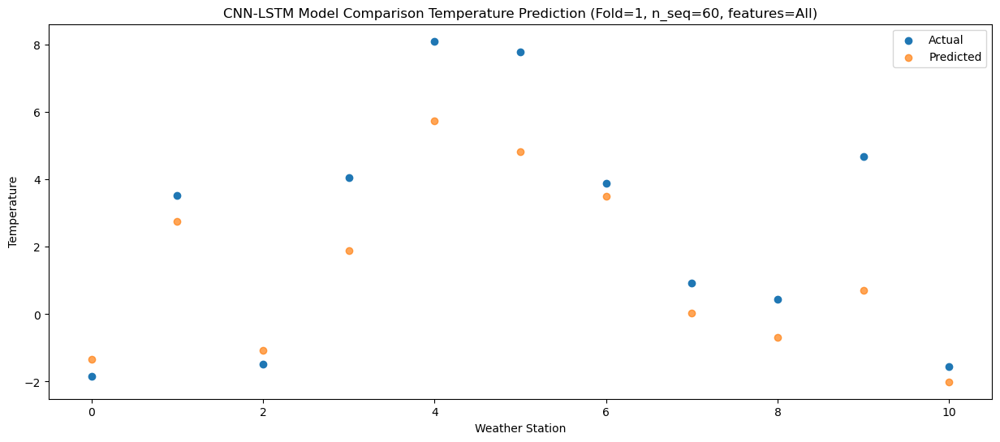

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -1.31  -1.568893
1                 1    2.61   2.380782
2                 2   -1.05  -1.388308
3                 3    2.63   1.381970
4                 4    6.22   5.231073
5                 5    5.77   3.947176
6                 6    3.15   3.123068
7                 7    0.30  -0.847950
8                 8   -1.41  -1.940013
9                 9    3.32  -0.724831
10               10   -4.37  -3.240808


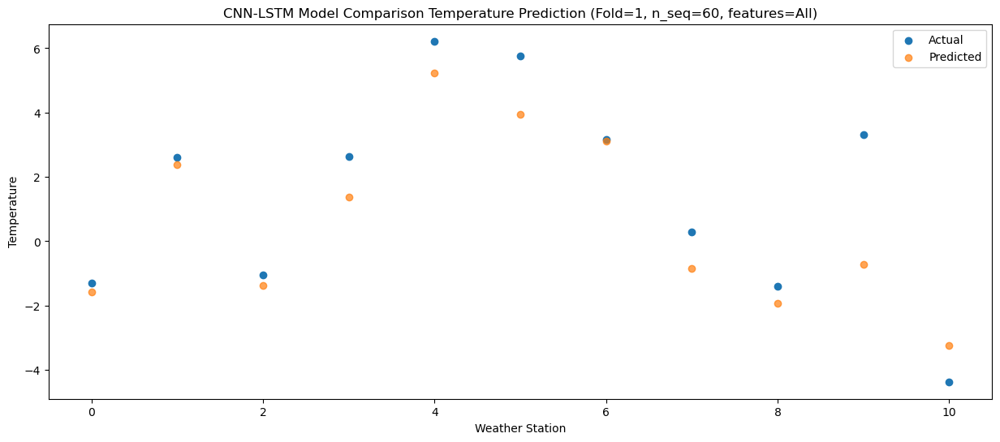

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -1.42  -1.617837
1                 1    1.50   2.245201
2                 2   -1.58  -1.498356
3                 3    3.38   1.253062
4                 4    7.03   5.066017
5                 5    5.11   3.788945
6                 6    2.34   2.993701
7                 7   -0.55  -1.326129
8                 8   -1.23  -2.545037
9                 9    2.87  -1.283397
10               10   -4.03  -3.426716


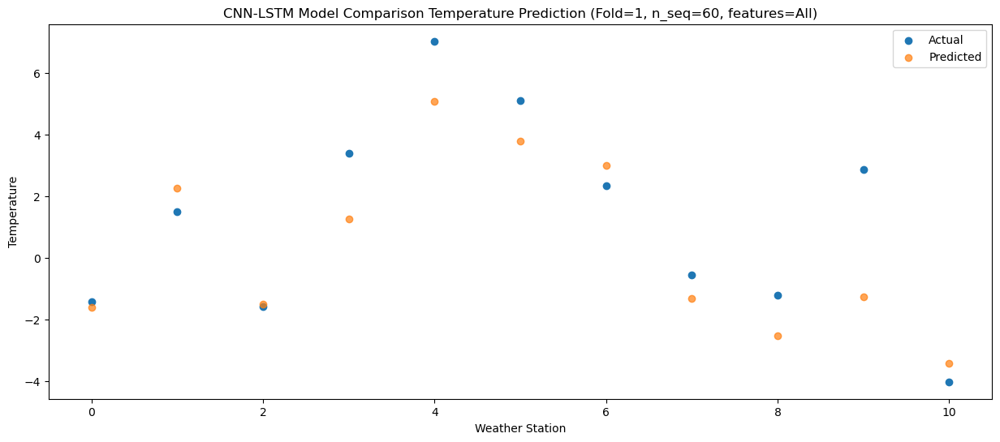

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -1.56  -1.305223
1                 1    1.59   2.349731
2                 2   -1.30  -1.349299
3                 3    2.85   1.324000
4                 4    6.65   5.095913
5                 5    4.59   3.821933
6                 6    2.41   3.104672
7                 7    0.13  -1.606905
8                 8   -1.74  -2.847685
9                 9    1.63  -1.538187
10               10   -3.29  -3.881519


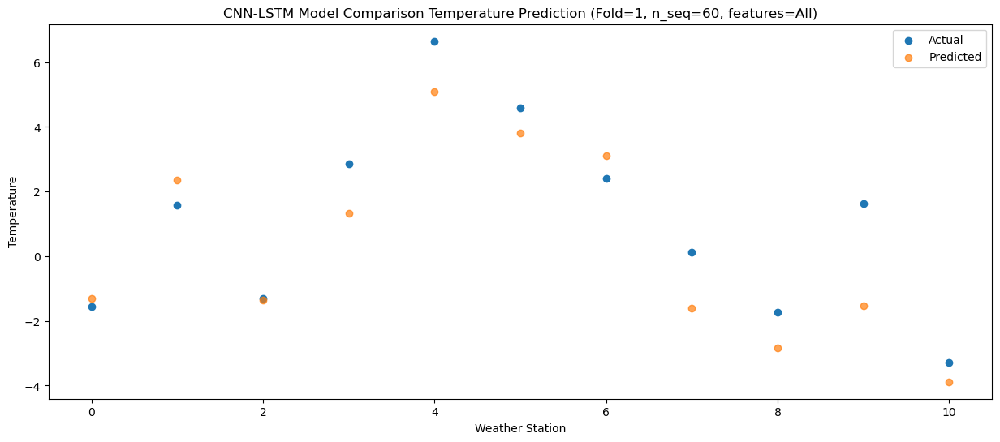

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.50   3.940836
1                 1    7.59   8.078101
2                 2    5.80   4.312658
3                 3   10.49   7.291931
4                 4   14.69  11.192363
5                 5   11.94   9.603750
6                 6    8.08   8.800303
7                 7    7.05   5.169441
8                 8    6.09   4.181223
9                 9    9.59   5.167578
10               10    1.03   1.947735


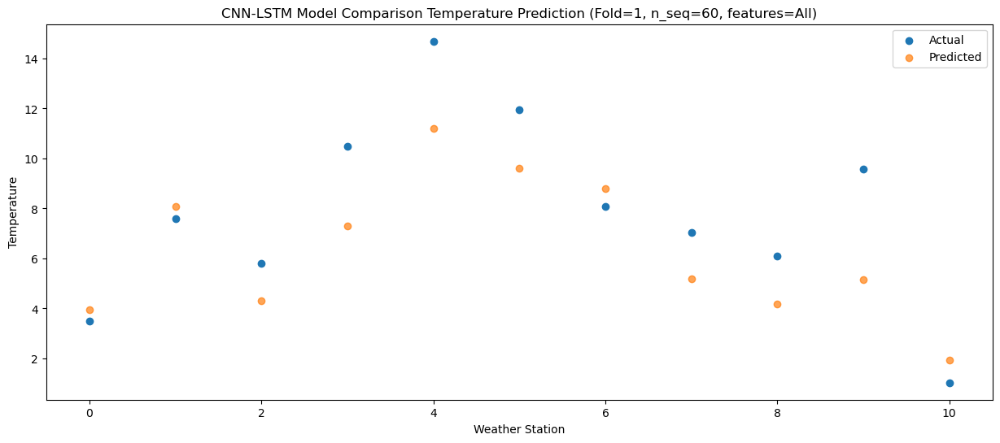

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    4.99   5.001266
1                 1    8.81   9.279610
2                 2    4.83   5.430298
3                 3   10.37   8.585584
4                 4   14.43  12.499169
5                 5   14.73  11.376504
6                 6    9.71  10.004632
7                 7    8.19   6.967392
8                 8    7.47   6.343533
9                 9   11.90   7.550349
10               10    2.66   4.043310


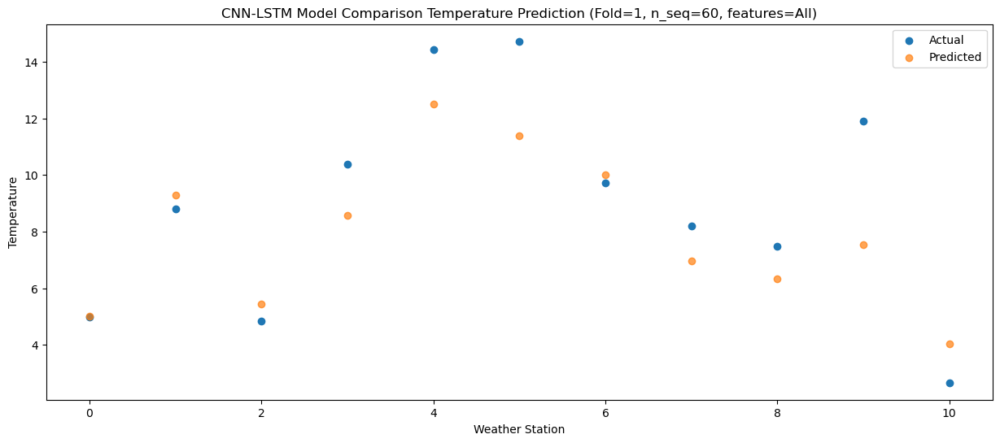

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    8.07   8.462141
1                 1   12.16  13.278752
2                 2    8.98   9.268901
3                 3   14.12  12.631933
4                 4   18.23  16.622111
5                 5   19.92  15.934999
6                 6   12.49  13.997347
7                 7   12.69  12.191032
8                 8   13.58  11.979998
9                 9   18.43  13.344876
10               10    8.12   9.967562


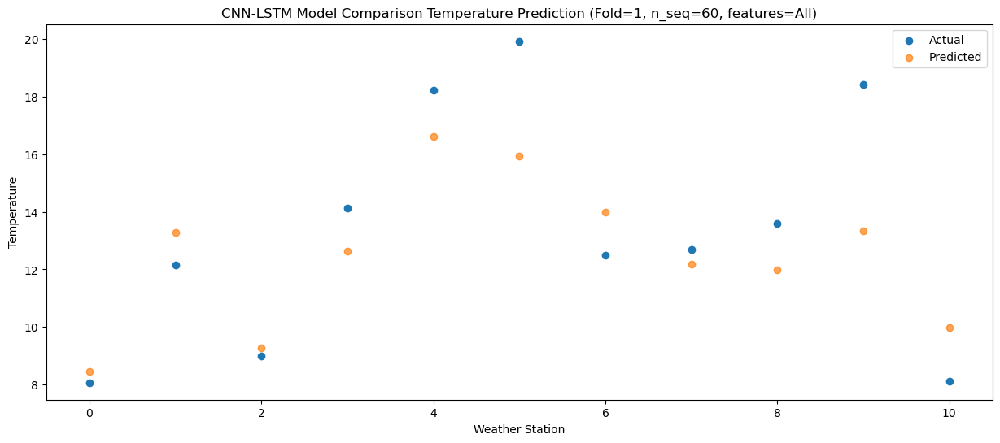

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   11.07  12.210305
1                 1   16.51  17.787426
2                 2   13.21  13.592244
3                 3   16.90  17.284570
4                 4   21.26  21.426680
5                 5   22.64  20.912138
6                 6   17.16  18.480904
7                 7   18.25  18.427055
8                 8   18.69  18.669597
9                 9   24.81  19.923995
10               10   15.44  16.279076


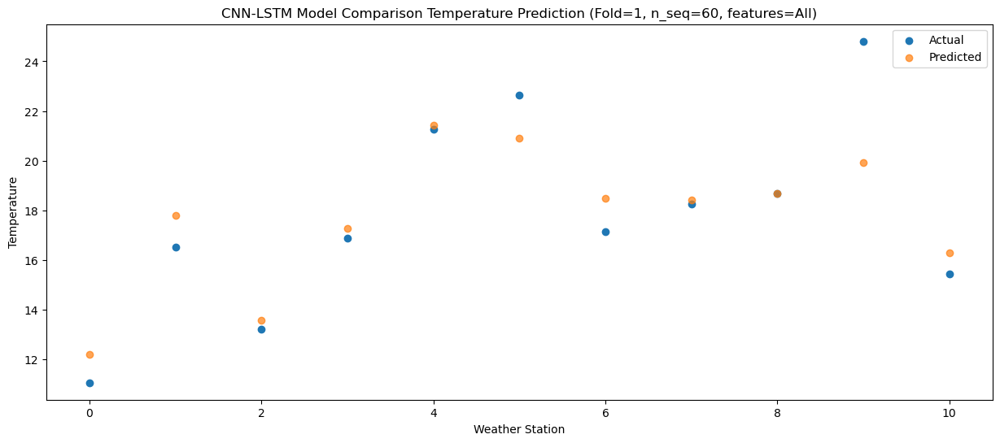

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   14.02  14.291834
1                 1   19.88  19.942871
2                 2   14.68  15.705311
3                 3   18.55  19.231055
4                 4   23.30  23.354999
5                 5   25.34  23.070527
6                 6   20.34  20.647357
7                 7   20.79  20.564840
8                 8   21.23  20.716363
9                 9   26.39  22.143738
10               10   19.31  19.354857


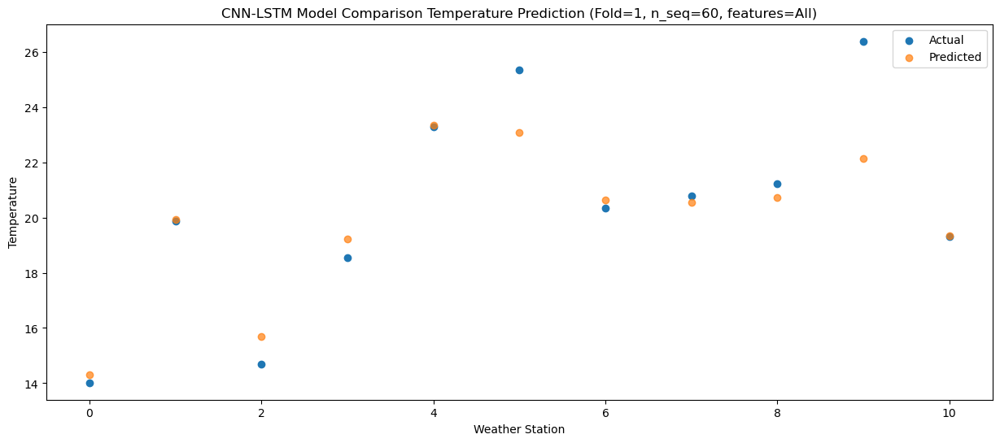

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   13.18  13.569184
1                 1   18.47  18.893150
2                 2   14.67  14.723220
3                 3   18.79  18.296475
4                 4   23.54  22.359739
5                 5   25.19  22.137107
6                 6   18.71  19.605187
7                 7   18.77  19.005424
8                 8   20.30  19.217469
9                 9   25.16  20.749393
10               10   17.12  17.412343


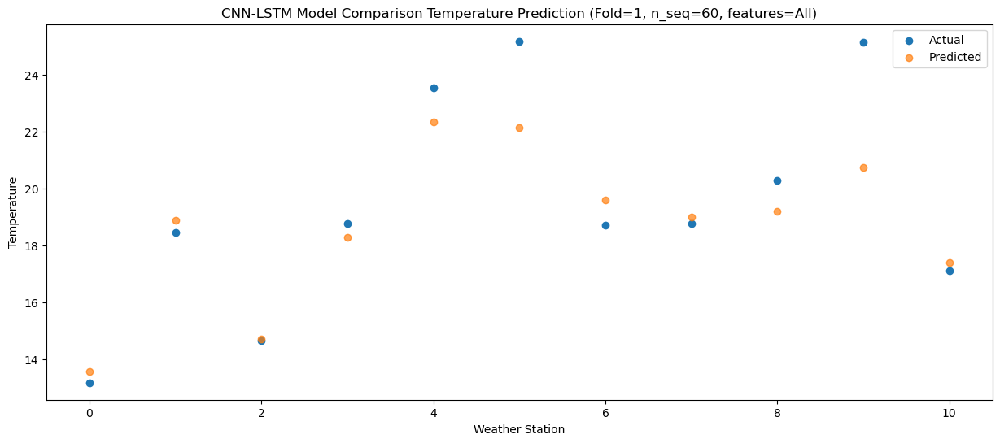

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   10.56  10.972712
1                 1   14.93  15.860671
2                 2   11.87  11.808492
3                 3   15.38  15.070971
4                 4   19.96  19.061230
5                 5   17.66  18.543759
6                 6   15.29  16.586727
7                 7   15.47  14.793853
8                 8   13.65  14.494049
9                 9   18.41  15.962402
10               10   12.59  13.229592


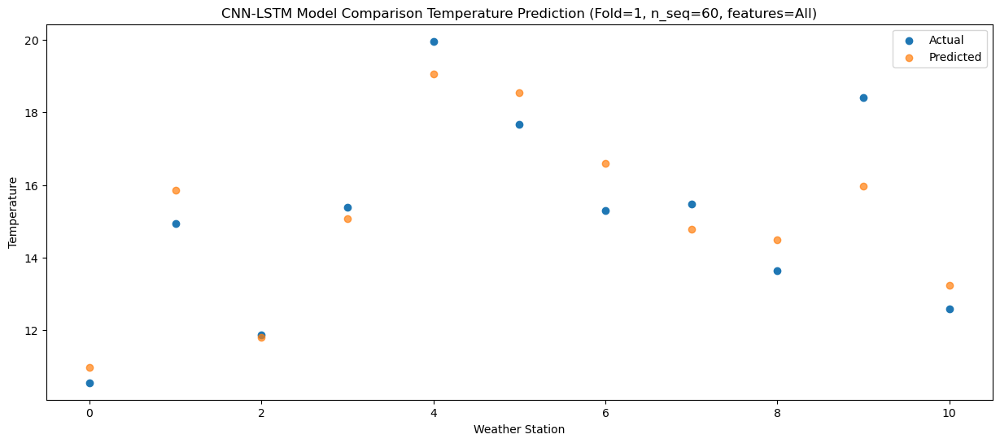

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    7.63   7.445139
1                 1   11.21  11.628268
2                 2    7.52   7.759658
3                 3   10.84  10.363401
4                 4   15.02  14.215890
5                 5   14.82  13.324017
6                 6   11.80  12.382979
7                 7    8.70   8.549330
8                 8    7.47   7.391545
9                 9   11.81   8.864319
10               10    7.05   7.431439


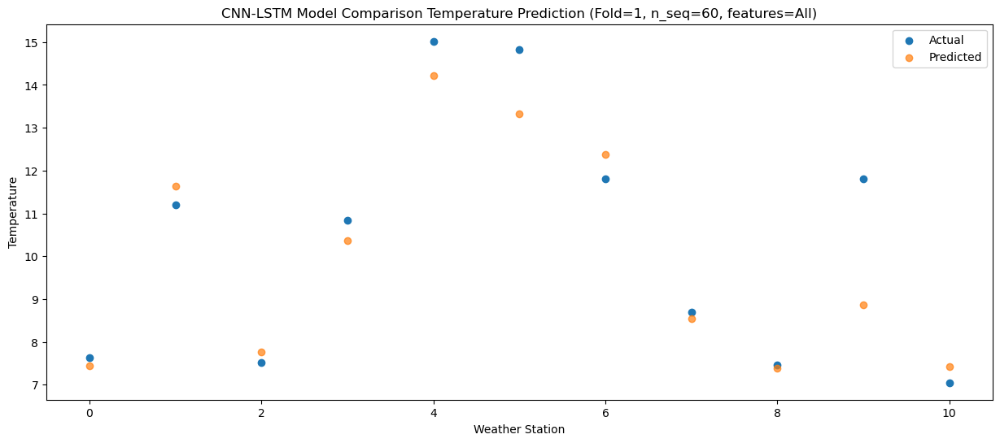

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    3.73   3.661302
1                 1    7.11   8.194811
2                 2    2.72   4.271533
3                 3    7.94   7.080907
4                 4   11.92  11.029474
5                 5   11.10   9.961770
6                 6    7.65   8.927723
7                 7    5.03   5.946975
8                 8    4.59   5.008995
9                 9    8.63   6.283016
10               10    2.85   4.217050


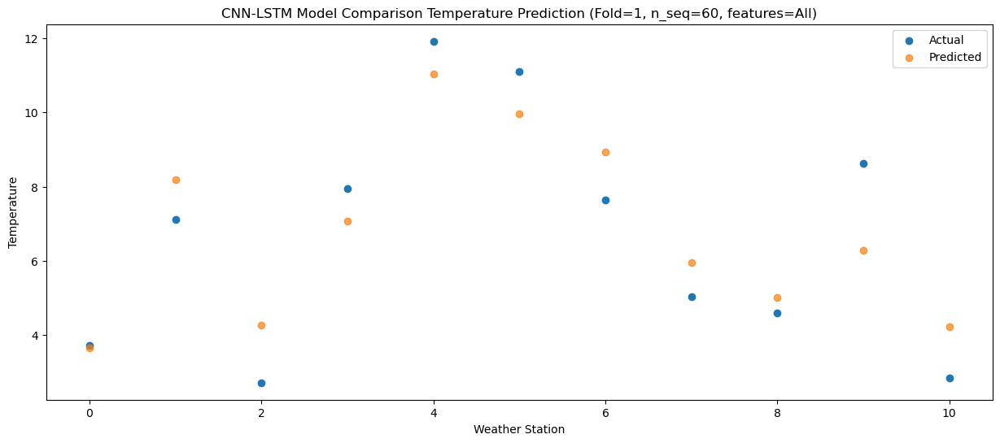

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -4.11  -3.073964
1                 1    0.22   1.279766
2                 2   -4.34  -2.626583
3                 3    1.76   0.264358
4                 4    5.56   4.150566
5                 5    4.35   3.378900
6                 6    0.44   2.019558
7                 7   -1.57  -1.173680
8                 8   -2.09  -1.941590
9                 9    1.36  -0.454506
10               10   -4.16  -2.832698


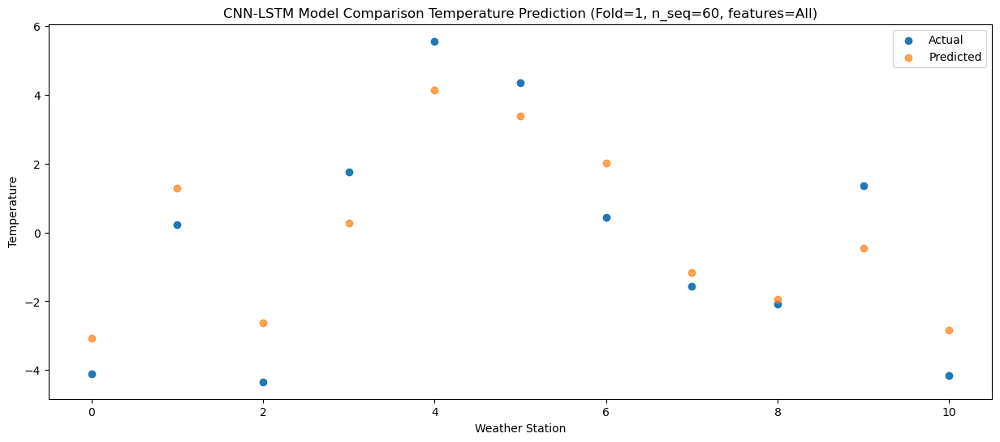

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -3.69  -3.241403
1                 1    0.02   0.730531
2                 2   -3.92  -3.076795
3                 3    1.66  -0.198761
4                 4    5.55   3.619226
5                 5    2.84   2.769543
6                 6    0.24   1.475749
7                 7   -1.88  -2.411807
8                 8   -2.44  -3.201214
9                 9    1.47  -1.676387
10               10   -6.00  -4.627779


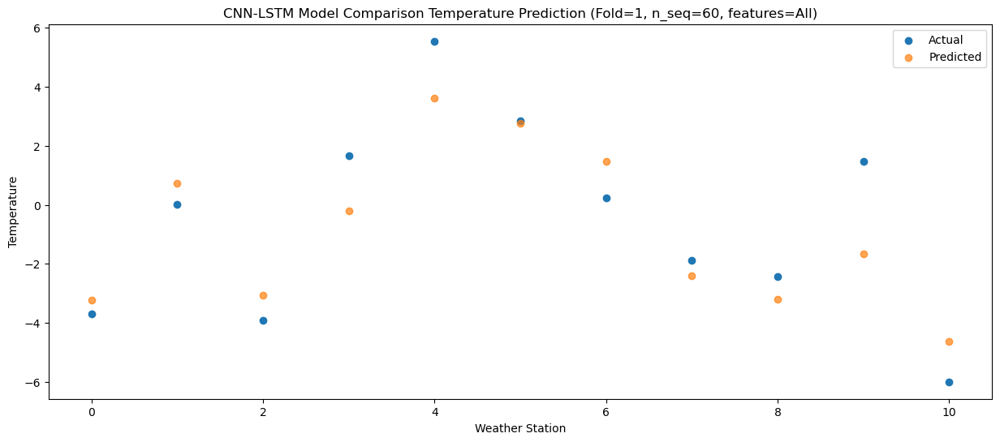

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -3.47  -2.456963
1                 1    0.68   0.598651
2                 2   -3.43  -2.997890
3                 3    0.07  -0.987849
4                 4    3.85   2.619242
5                 5    3.22   1.548352
6                 6    1.02   1.390371
7                 7   -4.88  -5.132731
8                 8   -7.22  -7.003665
9                 9   -2.90  -5.303716
10               10   -6.96  -6.165378


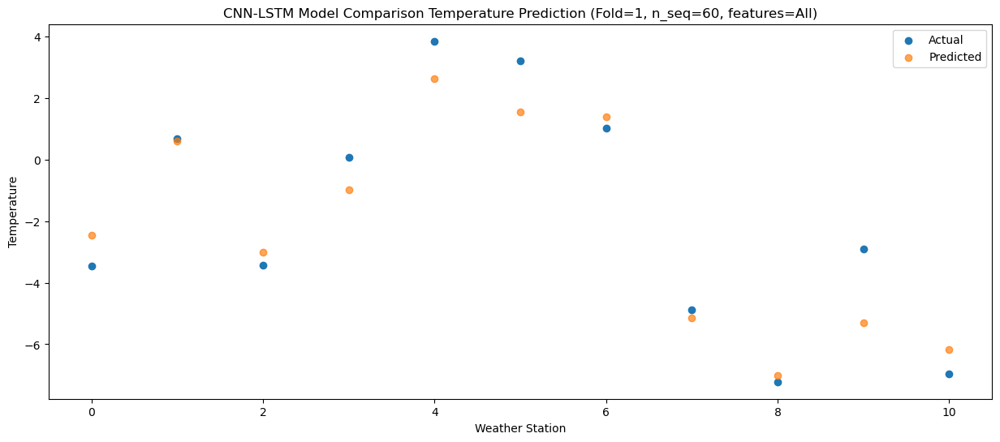

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    1.51   3.429939
1                 1    7.45   7.923376
2                 2    3.63   4.039141
3                 3    7.44   7.146239
4                 4   11.46  11.112909
5                 5   10.56   9.876189
6                 6    7.30   8.638878
7                 7    6.44   5.790742
8                 8    5.34   5.089200
9                 9    7.81   6.229949
10               10    0.26   2.884349


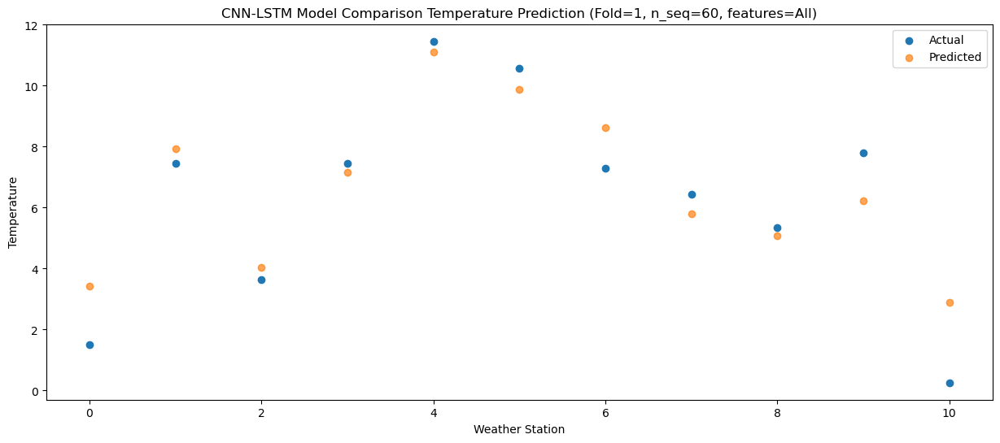

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    4.32   6.198386
1                 1    9.59  10.842866
2                 2    5.03   6.867993
3                 3    9.78   9.875905
4                 4   13.76  13.831539
5                 5   12.83  13.054746
6                 6    9.87  11.568598
7                 7    8.15   9.029832
8                 8    7.14   8.384288
9                 9   11.57   9.796383
10               10    4.91   7.232788


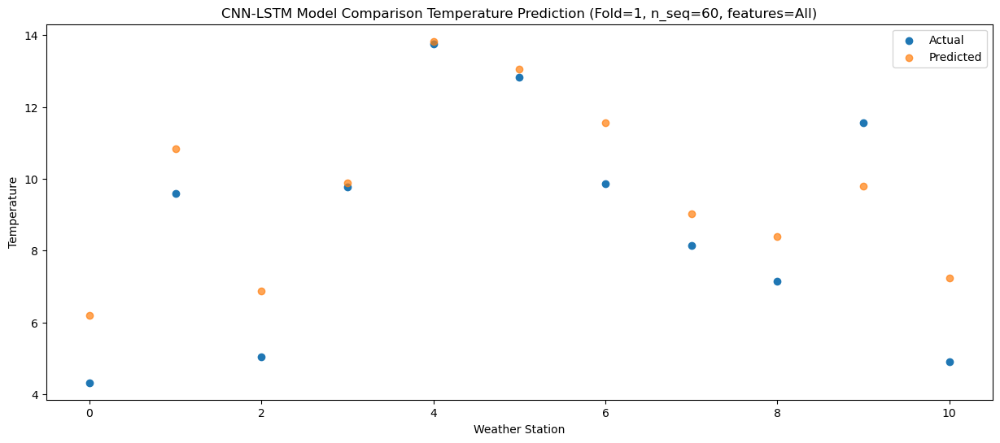

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    7.93  10.180410
1                 1   13.32  14.999727
2                 2    9.15  10.969175
3                 3   13.67  14.028422
4                 4   17.88  18.010171
5                 5   18.42  17.372893
6                 6   13.64  15.723158
7                 7   12.81  13.616630
8                 8   11.95  13.154765
9                 9   16.12  14.623440
10               10    9.45  11.965031


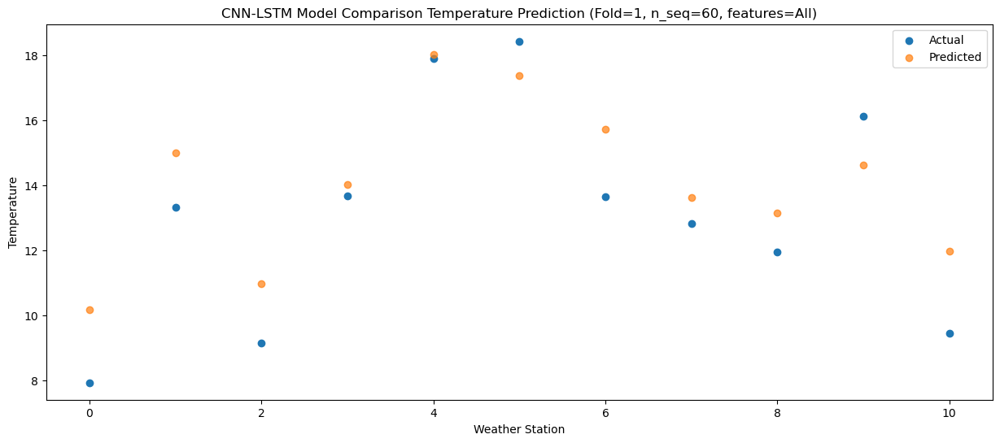

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   11.42  14.109467
1                 1   17.46  19.585081
2                 2   13.03  15.368446
3                 3   17.56  18.922876
4                 4   21.35  23.011492
5                 5   22.69  22.853172
6                 6   17.65  20.290330
7                 7   18.89  19.935174
8                 8   17.98  20.153376
9                 9   23.23  21.708734
10               10   15.54  18.442885


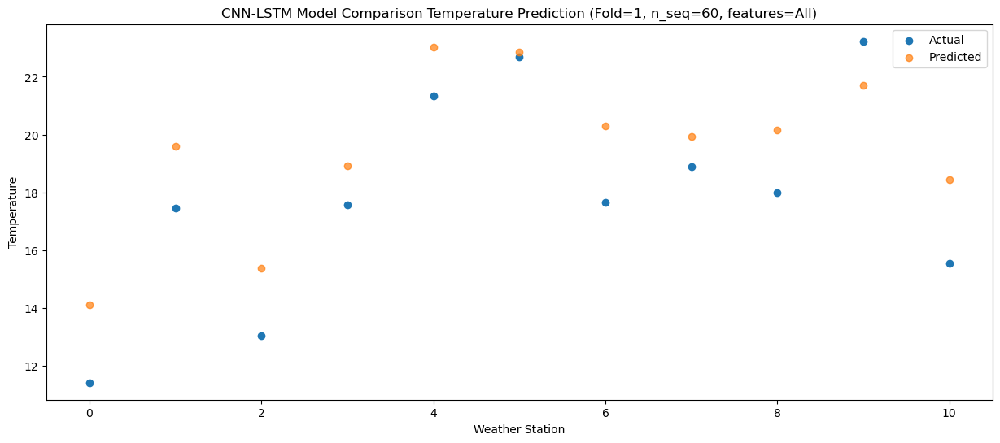

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   12.62  15.130394
1                 1   18.84  20.517420
2                 2   13.80  16.329303
3                 3   17.44  19.941242
4                 4   21.44  24.011940
5                 5   22.03  23.860206
6                 6   19.01  21.221322
7                 7   19.88  20.722062
8                 8   19.49  21.004665
9                 9   23.90  22.595811
10               10   17.77  18.979453


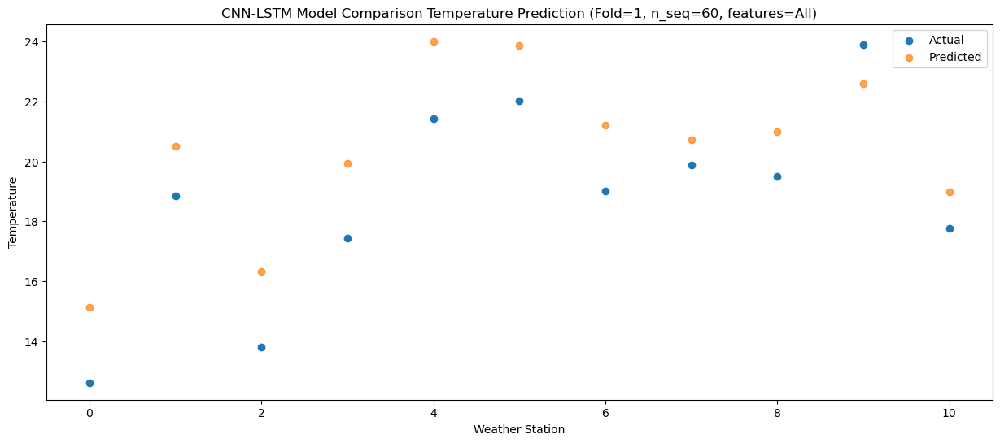

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   12.73  15.624166
1                 1   19.11  21.074867
2                 2   14.46  16.884870
3                 3   18.41  20.327423
4                 4   22.41  24.422927
5                 5   21.44  24.069625
6                 6   19.27  21.780883
7                 7   21.10  21.124298
8                 8   19.88  21.093837
9                 9   23.75  22.568232
10               10   17.55  19.749602


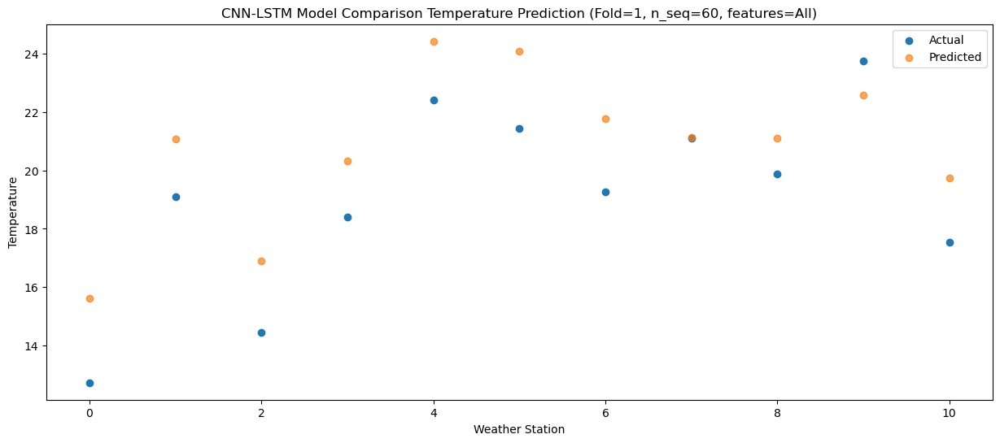

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   10.08  12.220577
1                 1   15.37  17.476734
2                 2   11.44  13.352930
3                 3   15.40  16.854369
4                 4   18.83  20.919404
5                 5   21.08  20.416482
6                 6   15.94  18.181939
7                 7   17.39  17.156983
8                 8   17.37  17.107295
9                 9   21.80  18.540688
10               10   13.85  15.216719


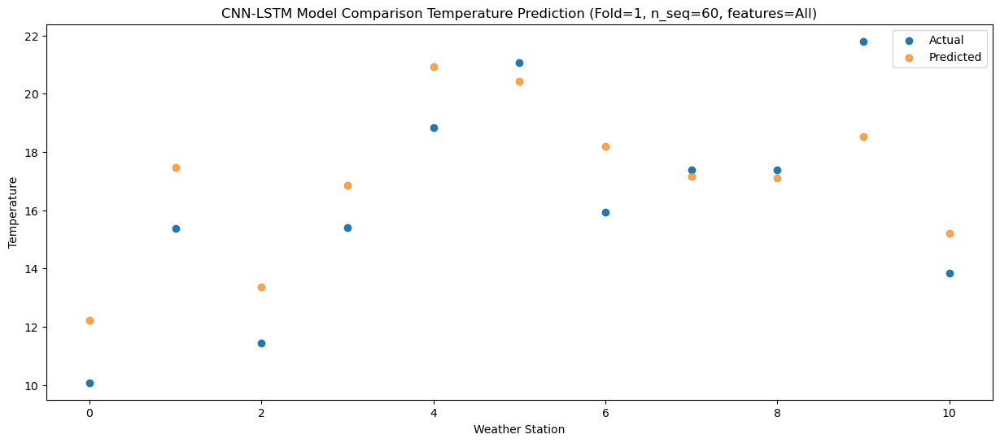

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    6.38   9.164939
1                 1   11.59  14.185303
2                 2    7.66  10.136617
3                 3   12.71  13.121290
4                 4   15.79  17.135568
5                 5   16.76  16.285100
6                 6   11.99  14.903885
7                 7   12.19  12.859552
8                 8   11.12  12.099307
9                 9   14.36  13.440872
10               10    9.43  11.500120


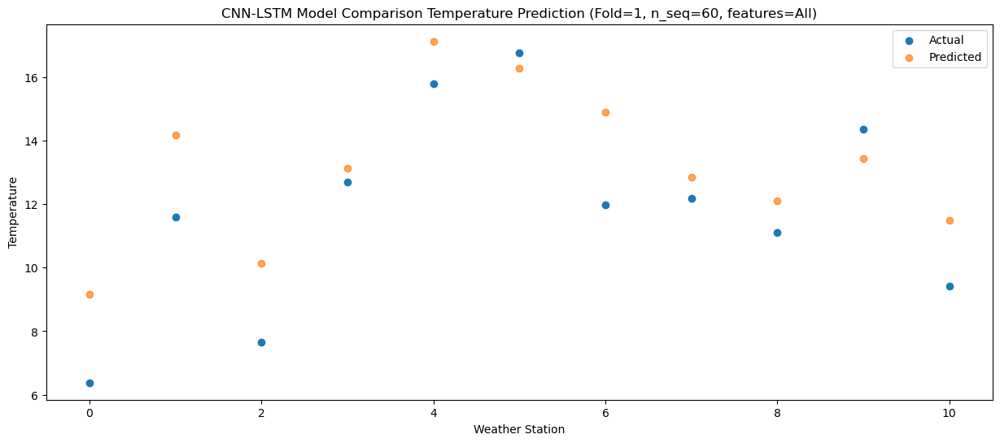

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -1.83   0.179282
1                 1    3.93   4.692184
2                 2   -0.08   0.737069
3                 3    5.55   3.947003
4                 4    8.24   7.846182
5                 5   10.29   7.340265
6                 6    4.39   5.426335
7                 7    2.89   2.740754
8                 8    3.37   2.316492
9                 9    8.11   3.942715
10               10    0.11   0.858821


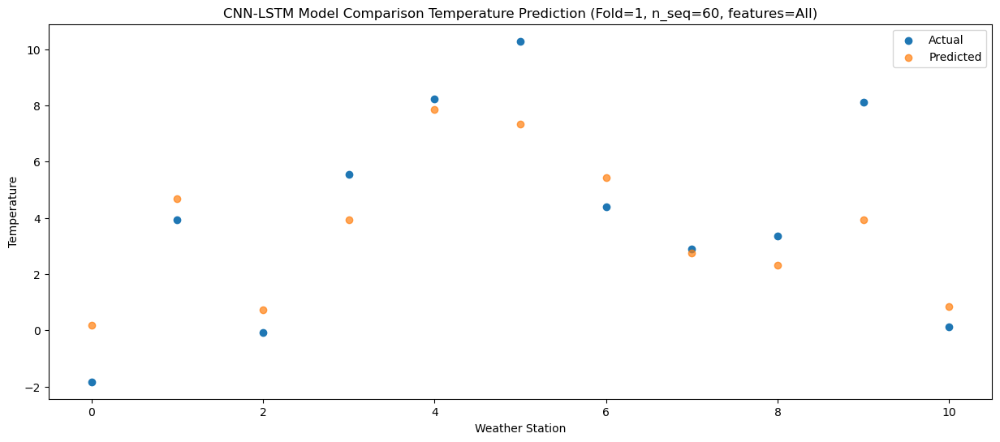

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    0.52   1.947938
1                 1    5.56   6.197004
2                 2    2.52   2.422636
3                 3    8.92   5.306046
4                 4   12.12   9.221001
5                 5   10.55   7.488805
6                 6    5.91   6.917806
7                 7    5.30   2.892396
8                 8    2.56   1.455991
9                 9    6.50   2.428257
10               10   -0.66   0.092492


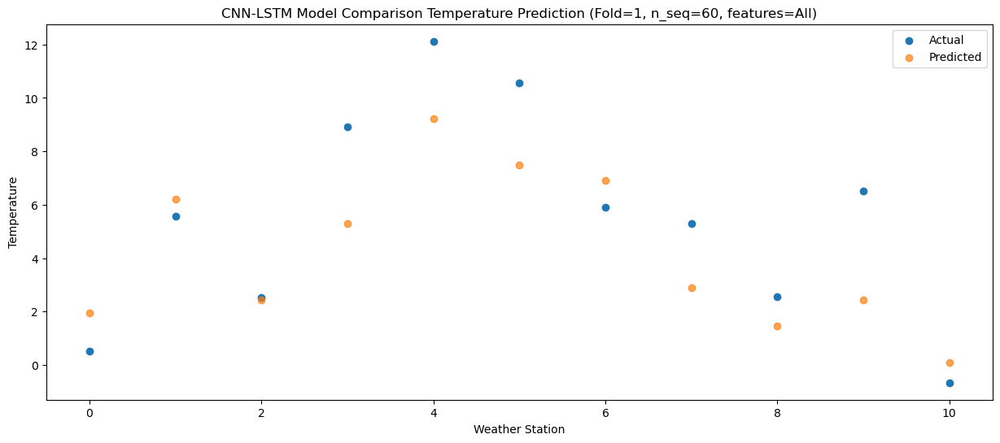

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -5.64  -4.785784
1                 1   -1.17  -1.154732
2                 2   -4.37  -4.843162
3                 3    0.87  -1.925802
4                 4    3.64   1.822704
5                 5    3.23   0.717757
6                 6   -0.48  -0.406742
7                 7   -3.53  -5.274023
8                 8   -5.06  -6.361872
9                 9   -0.42  -4.889824
10               10   -7.68  -7.991955


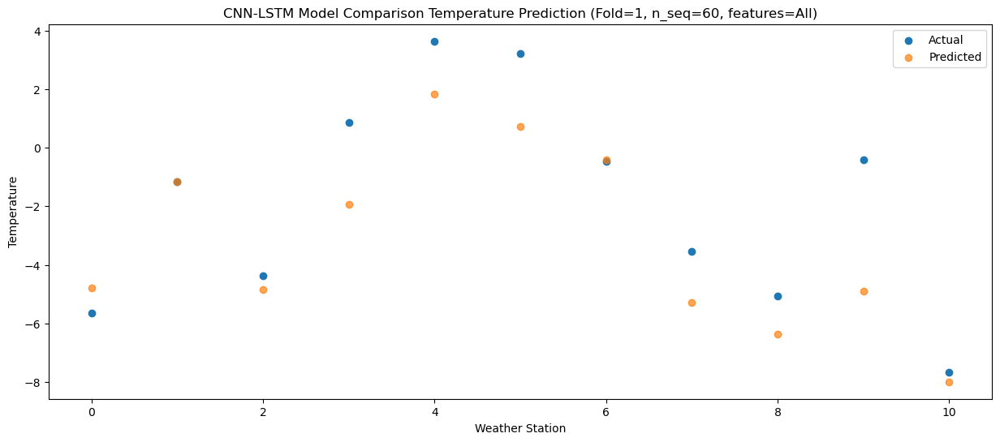

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.80  -2.020418
1                 1    3.06   1.623297
2                 2   -1.02  -2.073692
3                 3    0.40   0.358055
4                 4    3.33   4.097157
5                 5    3.12   2.867420
6                 6    3.33   2.383526
7                 7   -1.48  -2.948431
8                 8   -4.08  -4.576334
9                 9   -0.36  -3.114178
10               10   -3.78  -4.601067


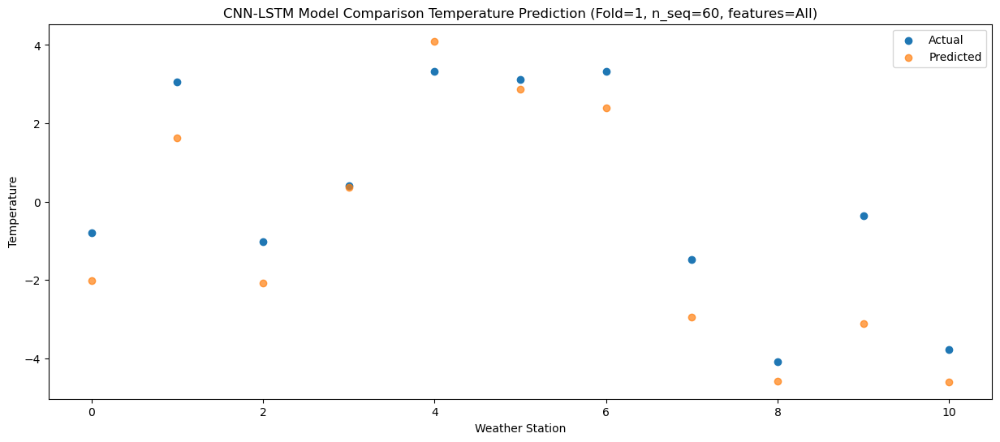

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    2.59   2.566694
1                 1    6.63   6.757602
2                 2    2.98   2.936584
3                 3    6.24   5.808990
4                 4    9.11   9.668996
5                 5   10.07   8.531734
6                 6    7.17   7.492251
7                 7    4.47   3.601153
8                 8    3.17   2.499121
9                 9    6.57   3.831636
10               10    0.78   1.419582


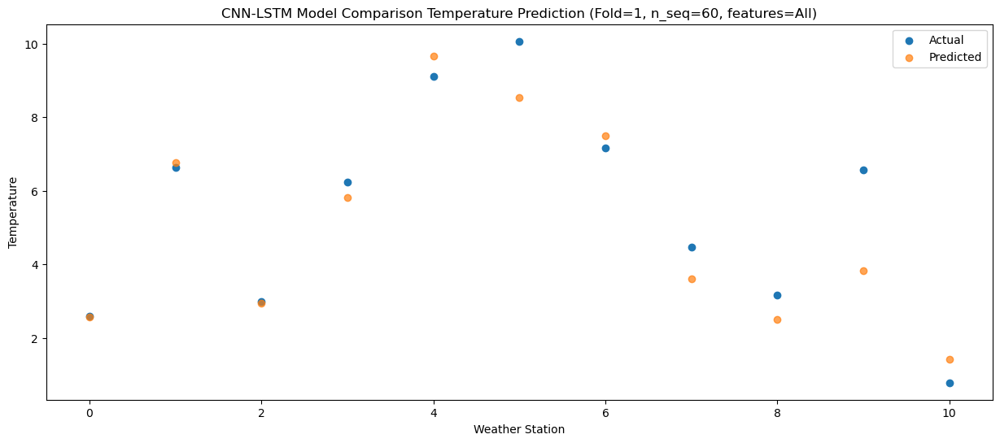

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    4.58   6.317535
1                 1    9.63  10.742535
2                 2    6.57   6.882912
3                 3   12.24   9.949978
4                 4   15.38  13.866886
5                 5   16.98  12.635347
6                 6    9.93  11.466354
7                 7    9.66   8.060234
8                 8   10.28   7.085931
9                 9   13.05   8.298689
10               10    4.13   5.675453


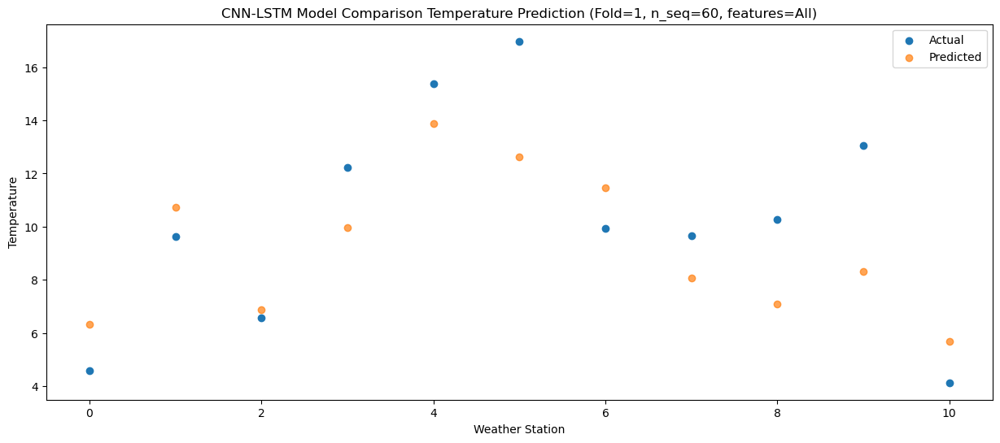

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    9.83  11.432767
1                 1   15.51  16.570154
2                 2   11.93  12.512504
3                 3   16.67  15.674836
4                 4   20.00  19.723901
5                 5   22.38  18.734674
6                 6   15.85  17.280133
7                 7   15.13  15.365979
8                 8   15.64  14.662994
9                 9   18.50  15.861044
10               10   11.11  13.729694


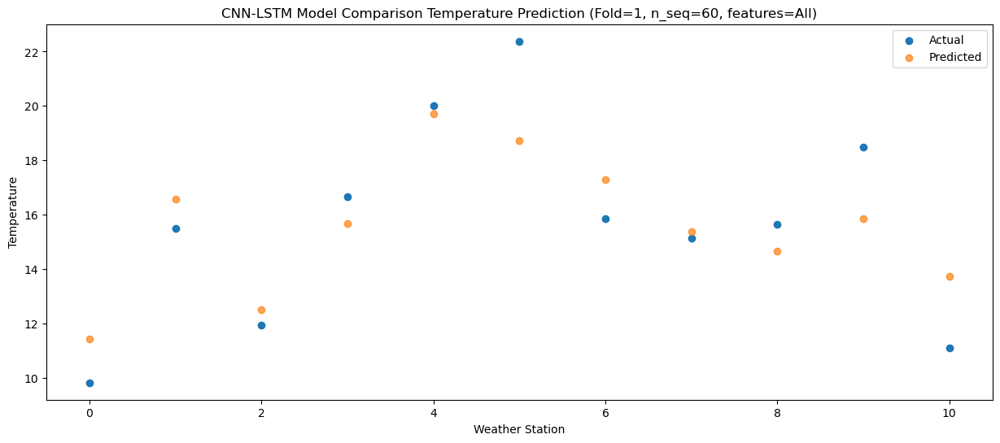

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   12.33  14.499944
1                 1   19.48  19.867912
2                 2   14.90  15.741868
3                 3   19.67  19.271831
4                 4   23.37  23.372851
5                 5   24.44  22.627527
6                 6   19.43  20.564171
7                 7   19.19  19.542751
8                 8   19.93  19.368262
9                 9   23.07  20.607781
10               10   15.50  17.394619


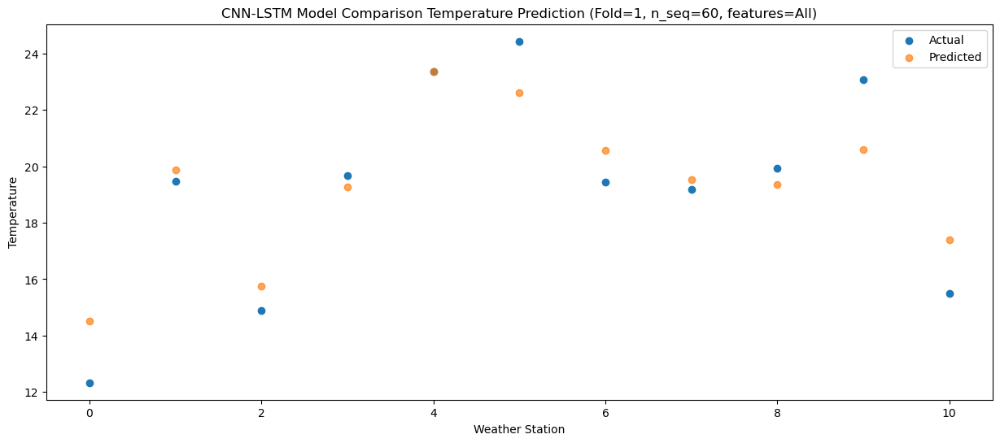

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   13.23  15.413249
1                 1   19.98  21.063134
2                 2   15.61  16.859126
3                 3   20.61  20.646034
4                 4   24.46  24.782742
5                 5   25.36  24.322180
6                 6   20.17  21.752806
7                 7   23.32  21.522893
8                 8   24.08  21.746875
9                 9   26.67  23.065058
10               10   19.44  19.506793


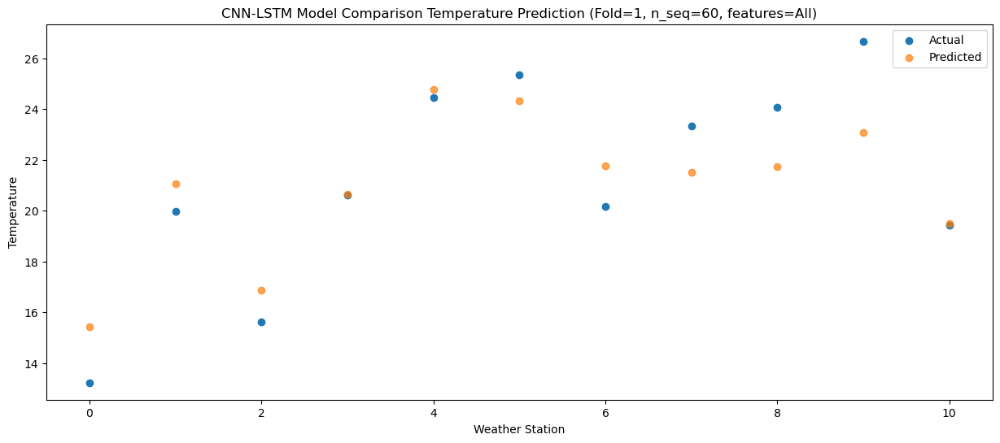

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   12.43  14.519532
1                 1   18.52  19.971325
2                 2   14.00  15.772308
3                 3   18.97  19.338258
4                 4   22.45  23.404967
5                 5   22.51  23.227613
6                 6   18.67  20.679256
7                 7   20.45  20.019590
8                 8   21.41  20.174973
9                 9   23.84  21.755287
10               10   18.90  18.700018


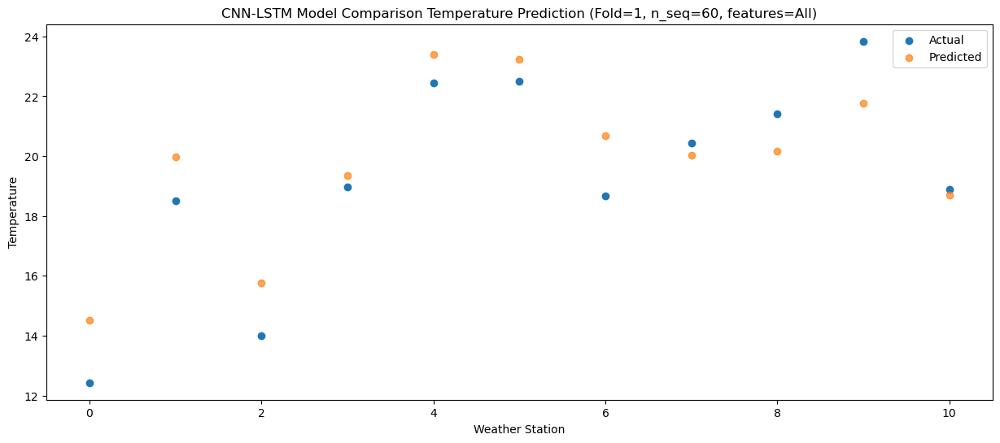

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   10.47  12.508551
1                 1   15.43  17.579149
2                 2   11.61  13.488256
3                 3   16.20  16.999327
4                 4   19.27  21.010714
5                 5   19.46  20.593936
6                 6   15.78  18.292541
7                 7   16.61  16.838905
8                 8   17.58  16.816439
9                 9   21.43  18.336253
10               10   13.99  14.927630


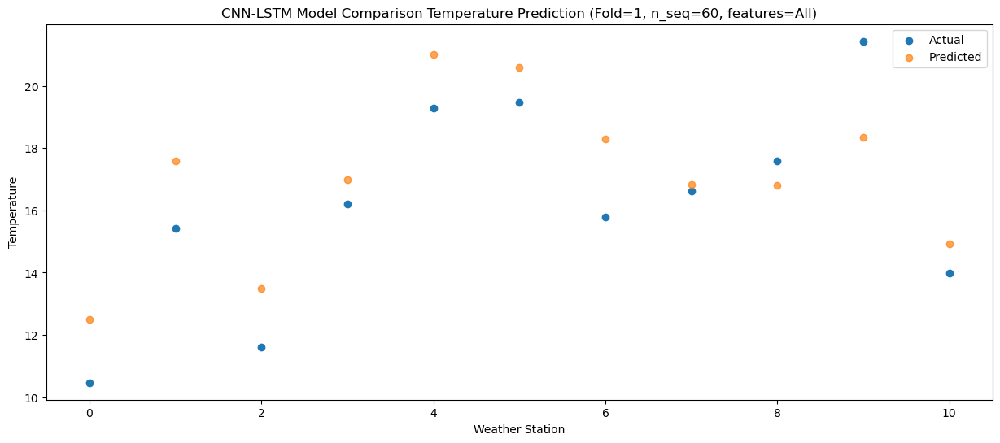

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    3.92   7.184386
1                 1    9.09  12.013631
2                 2    4.92   7.982752
3                 3   10.64  11.288813
4                 4   13.88  15.245347
5                 5   13.38  14.726532
6                 6    9.44  12.737930
7                 7    9.94  10.576781
8                 8    9.35  10.250081
9                 9   12.89  11.801596
10               10    5.89   8.912552


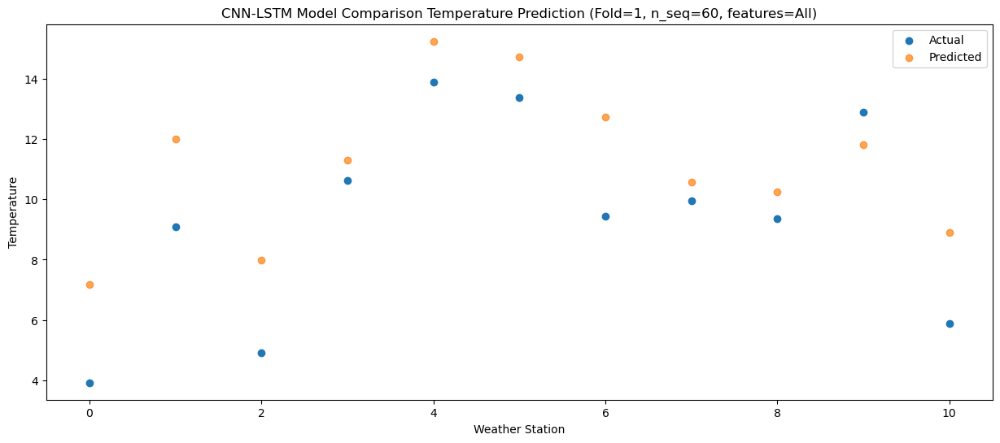

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    2.72   3.889283
1                 1    6.09   8.337470
2                 2    1.60   4.429469
3                 3    5.59   6.748726
4                 4    8.88  10.630869
5                 5    6.42   9.452411
6                 6    6.55   9.089867
7                 7    3.34   5.078880
8                 8    1.50   3.472222
9                 9    3.90   4.854191
10               10    2.38   4.744644


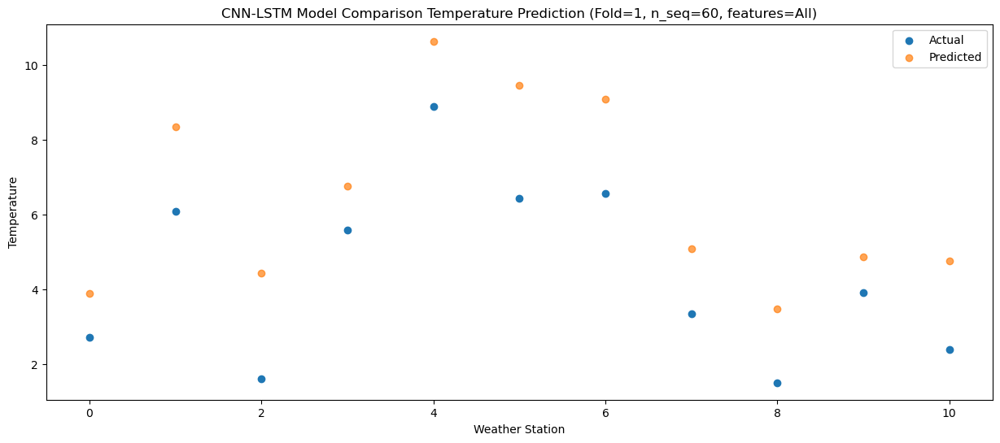

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -3.04  -0.416046
1                 1    0.28   3.564724
2                 2   -1.56  -0.210380
3                 3    3.50   2.254584
4                 4    6.86   6.058018
5                 5    5.30   4.731606
6                 6    0.54   4.319954
7                 7   -0.40  -0.557877
8                 8   -2.13  -2.266784
9                 9    1.55  -0.919963
10               10   -4.77  -1.753524


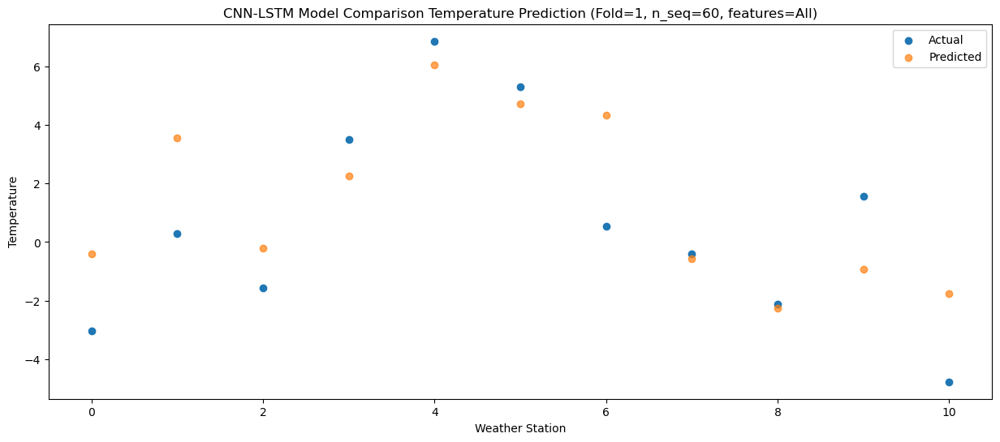

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -0.93   1.045104
1                 1    2.47   5.095666
2                 2   -0.56   1.301391
3                 3    4.21   3.752865
4                 4    7.34   7.567855
5                 5    5.76   6.255703
6                 6    2.67   5.850497
7                 7    0.79   1.090474
8                 8   -1.27  -0.582858
9                 9    1.83   0.760812
10               10   -1.81   0.027315


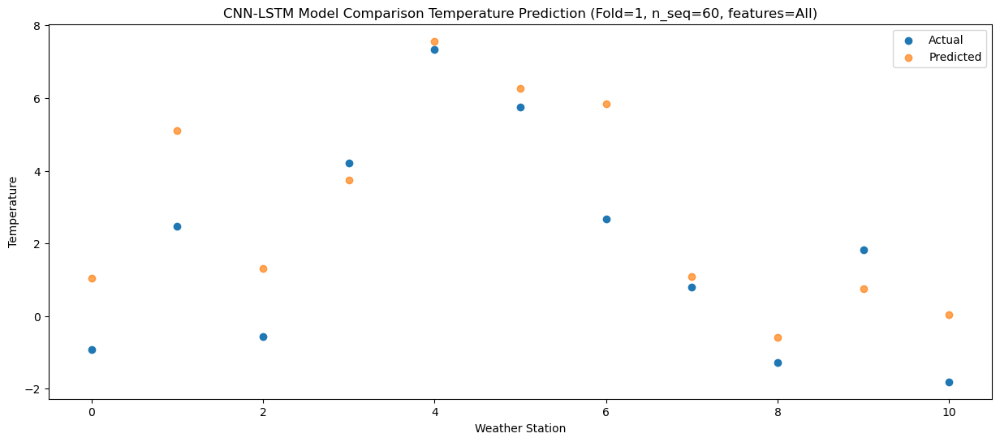

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.98   2.868643
1                 1    5.84   6.810981
2                 2    2.03   3.093711
3                 3    5.21   5.552499
4                 4    8.52   9.377004
5                 5    5.90   7.640134
6                 6    6.26   7.553678
7                 7    2.29   2.501518
8                 8   -0.90   0.726431
9                 9    2.98   1.844814
10               10   -2.13   0.537914


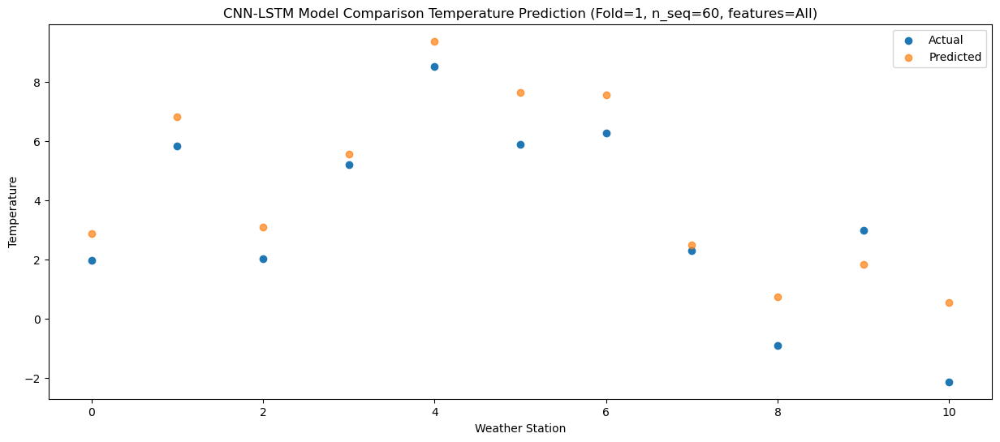

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    2.62   4.471369
1                 1    6.61   8.441173
2                 2    3.46   4.708667
3                 3    9.04   7.404587
4                 4   12.34  11.240319
5                 5   10.96   9.617273
6                 6    6.93   9.181218
7                 7    5.12   4.415198
8                 8    3.53   2.906078
9                 9    6.71   4.061258
10               10   -1.01   2.124727


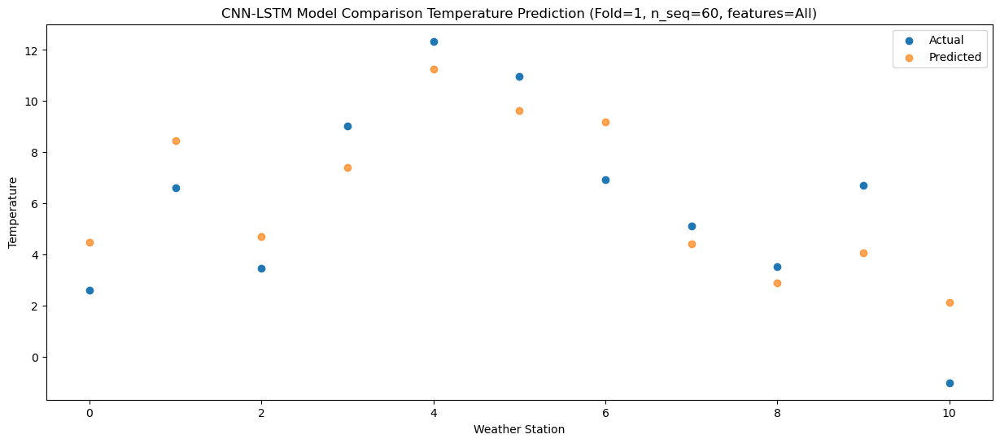

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    6.12   7.444474
1                 1    9.88  12.068206
2                 2    6.15   8.117831
3                 3    9.88  10.929910
4                 4   13.30  14.847401
5                 5   14.12  13.898317
6                 6   10.19  12.805762
7                 7    9.52   9.622363
8                 8    7.86   8.647565
9                 9   12.06  10.079873
10               10    6.21   8.534561


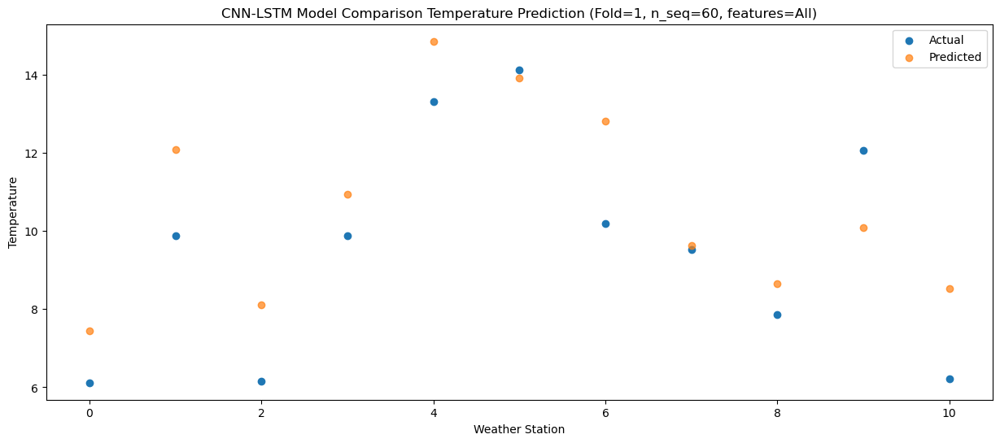

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    7.62  11.006920
1                 1   13.16  16.190565
2                 2    9.39  12.106583
3                 3   14.47  15.633042
4                 4   17.94  19.667714
5                 5   18.73  19.041281
6                 6   13.19  16.894077
7                 7   14.87  15.511101
8                 8   13.55  15.503590
9                 9   17.17  16.943170
10               10    8.77  13.350864


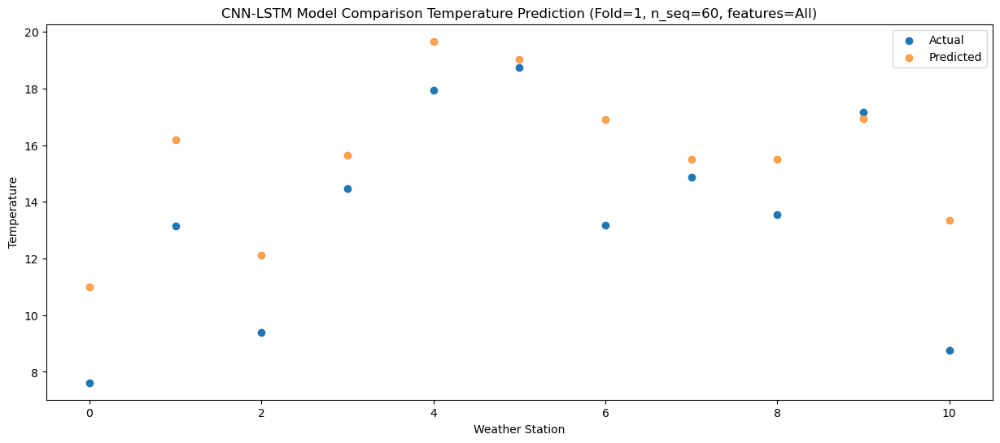

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   11.24  14.136389
1                 1   16.35  19.573265
2                 2   13.14  15.430289
3                 3   18.62  19.045511
4                 4   22.83  23.136049
5                 5   25.42  22.496482
6                 6   16.47  20.271198
7                 7   18.68  19.409255
8                 8   18.48  19.471061
9                 9   20.40  20.842086
10               10   13.14  17.376501


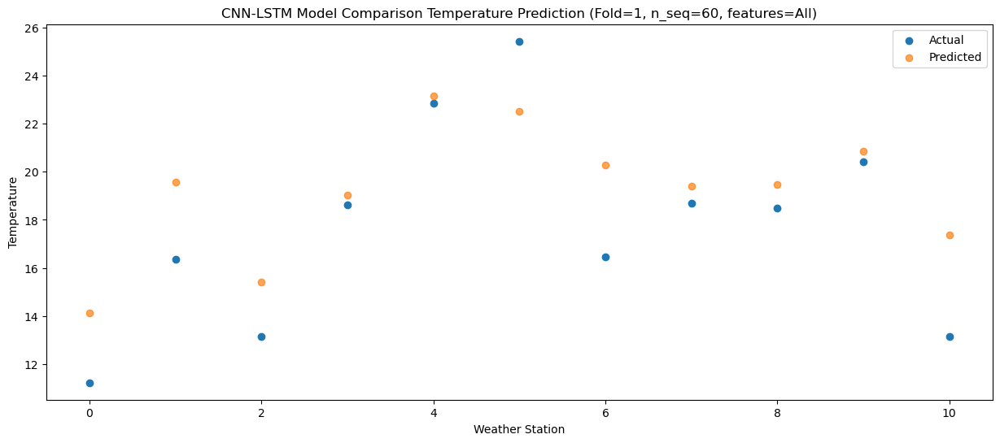

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   14.47  17.302506
1                 1   19.95  22.545429
2                 2   15.51  18.414479
3                 3   20.34  21.782747
4                 4   24.78  25.791094
5                 5   26.52  25.440831
6                 6   19.92  23.266621
7                 7   20.98  21.745002
8                 8   21.36  21.566847
9                 9   25.02  23.200432
10               10   18.28  20.808627


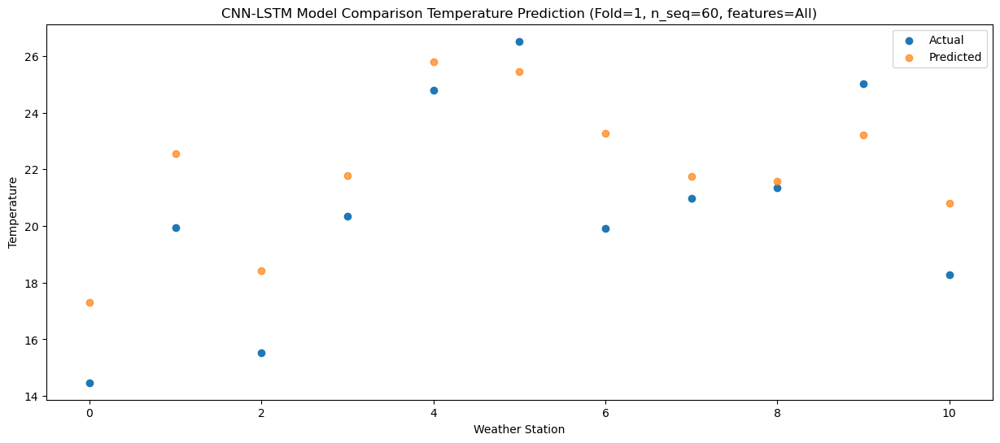

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   14.26  17.144128
1                 1   19.41  22.289806
2                 2   15.95  18.220365
3                 3   22.31  21.822501
4                 4   26.21  25.835964
5                 5   25.71  25.233079
6                 6   19.50  22.997152
7                 7   21.48  21.454690
8                 8   23.17  21.455257
9                 9   25.42  22.932195
10               10   16.54  19.343260


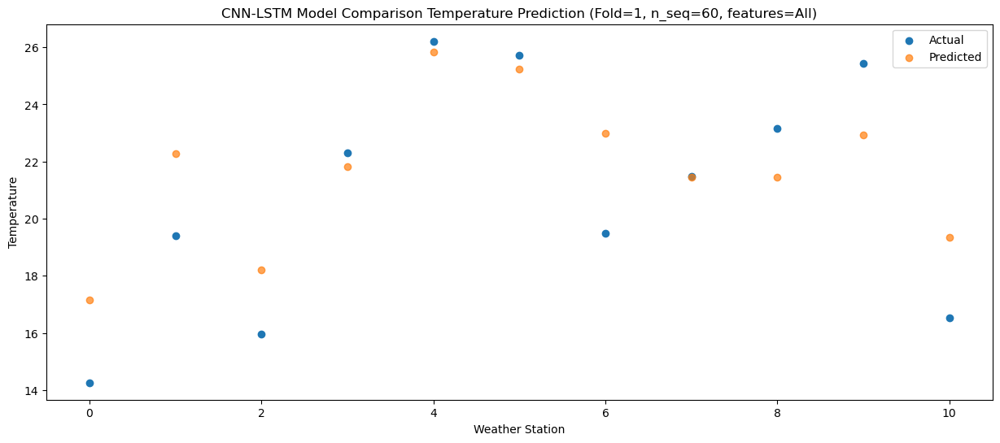

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   10.57  14.197790
1                 1   15.90  19.364443
2                 2   12.99  15.277846
3                 3   19.23  18.691232
4                 4   22.36  22.698581
5                 5   23.43  22.120506
6                 6   16.33  20.078720
7                 7   17.86  18.453093
8                 8   18.53  18.333580
9                 9   21.90  19.849924
10               10   13.35  16.829031


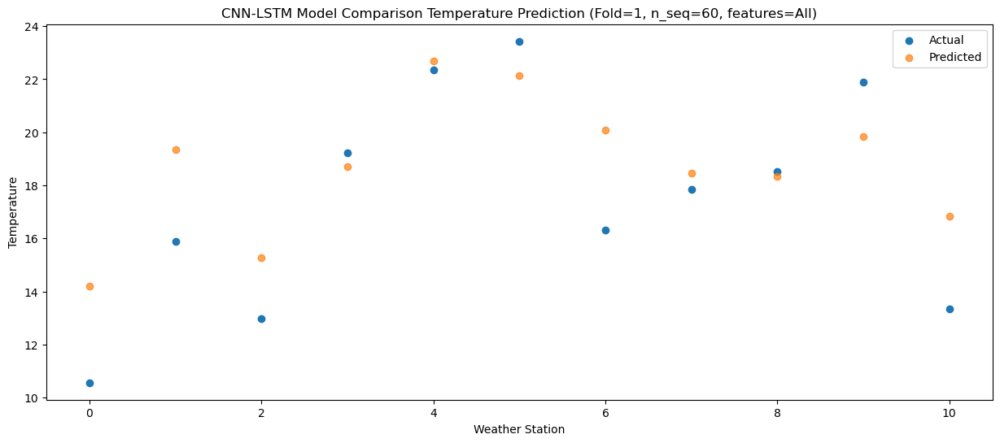

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    5.69   9.513875
1                 1   10.89  14.260163
2                 2    6.95  10.251646
3                 3   11.97  13.127067
4                 4   14.96  17.033660
5                 5   15.83  16.403400
6                 6   11.32  15.003742
7                 7   11.55  12.065027
8                 8    9.95  11.275157
9                 9   13.80  12.908555
10               10    8.00  11.463259


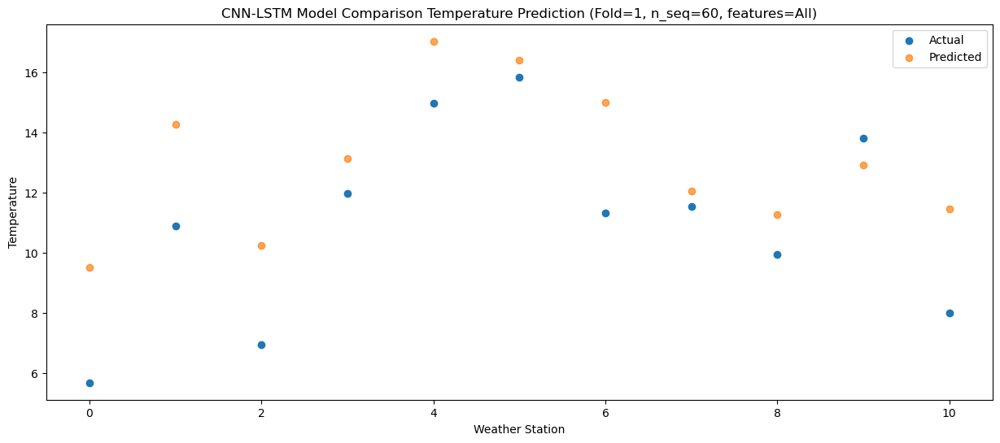

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    0.54   3.882457
1                 1    5.27   8.366759
2                 2    0.39   4.444486
3                 3    5.69   7.301106
4                 4    8.76  11.171489
5                 5    9.17  10.366749
6                 6    5.63   9.108461
7                 7    4.15   5.662615
8                 8    2.83   4.824726
9                 9    7.05   6.407136
10               10    0.06   4.348709


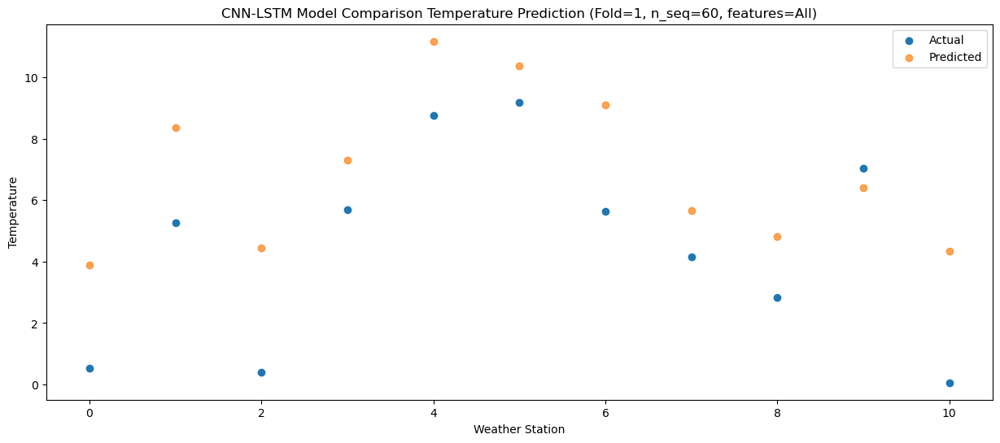

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -1.49   1.529856
1                 1    2.13   6.066935
2                 2   -2.39   2.102526
3                 3    3.29   4.705660
4                 4    6.86   8.556705
5                 5    6.81   7.943661
6                 6    2.89   6.821269
7                 7    1.23   3.283718
8                 8   -0.02   2.280061
9                 9    3.22   4.000226
10               10   -1.63   2.963540


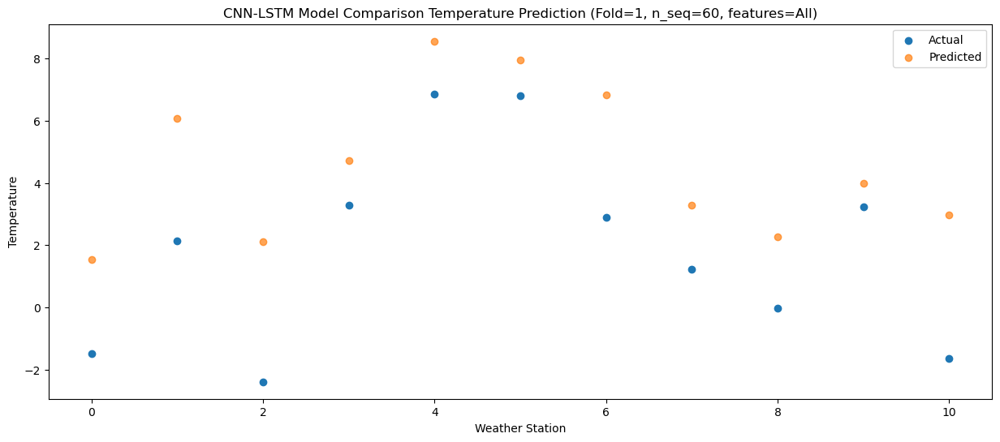

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -2.81  -0.873285
1                 1   -1.15   2.845926
2                 2   -5.47  -0.937129
3                 3   -0.13   1.061253
4                 4    3.01   4.728965
5                 5    3.20   4.044439
6                 6   -0.11   3.637694
7                 7   -4.70  -1.994436
8                 8   -5.85  -3.669258
9                 9   -1.95  -1.715563
10               10   -5.53  -1.643576


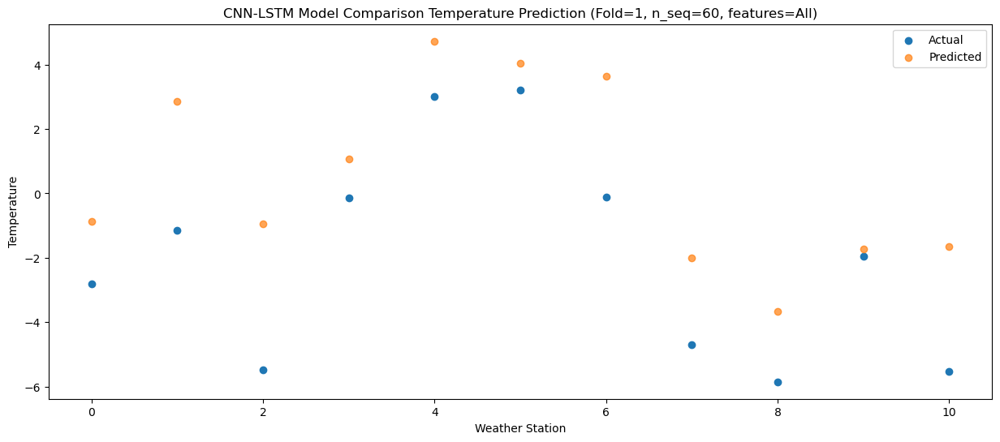

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -1.43   2.274624
1                 1    3.93   6.702209
2                 2   -0.13   2.826143
3                 3    6.18   5.830915
4                 4    9.38   9.710949
5                 5    9.32   8.702008
6                 6    4.10   7.432524
7                 7    4.30   3.895773
8                 8    2.10   3.100818
9                 9    5.76   4.540626
10               10   -3.58   1.713893


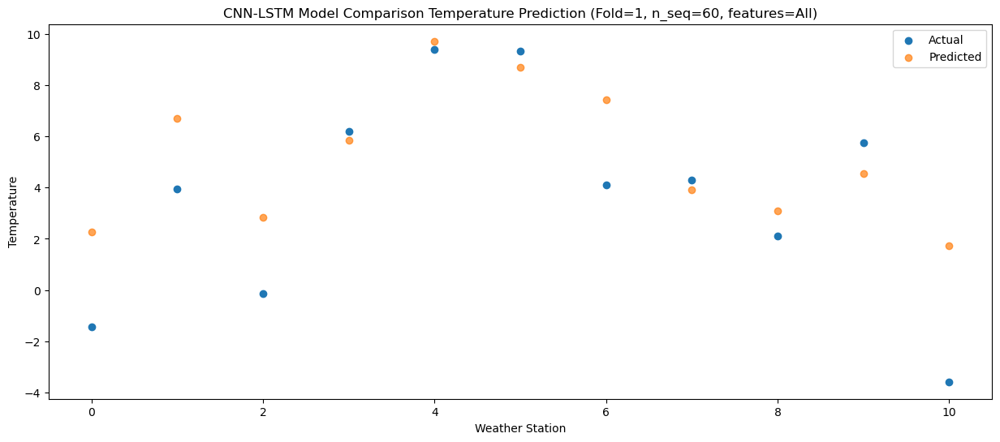

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    3.42   6.023972
1                 1    7.15  10.426319
2                 2    2.97   6.559475
3                 3    8.69   9.300400
4                 4   12.12  13.182051
5                 5   11.67  12.033342
6                 6    7.76  11.164032
7                 7    7.02   7.296473
8                 8    5.34   6.150769
9                 9    8.59   7.533391
10               10    0.82   5.555581


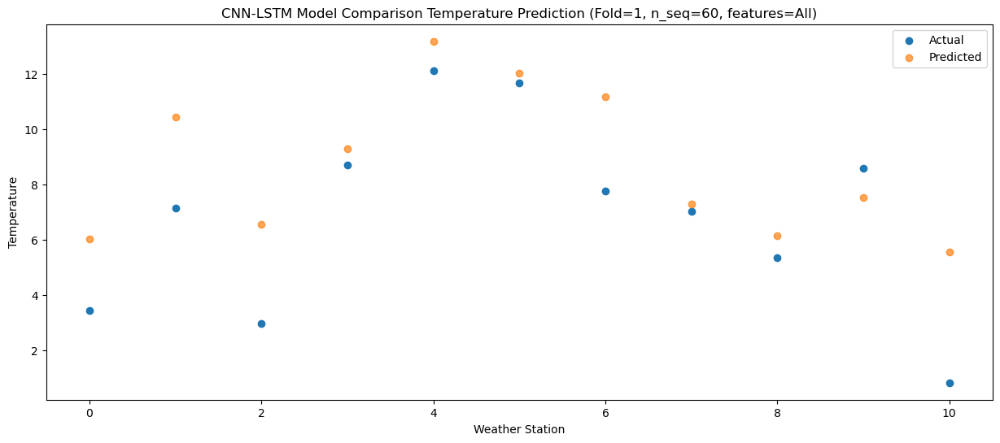

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    5.82   9.590154
1                 1   10.82  14.409881
2                 2    6.31  10.430629
3                 3   12.17  13.425712
4                 4   15.68  17.387383
5                 5   16.47  16.432290
6                 6   11.23  15.134825
7                 7   11.06  12.315259
8                 8   10.02  11.546168
9                 9   13.66  12.951764
10               10    5.21  10.560286


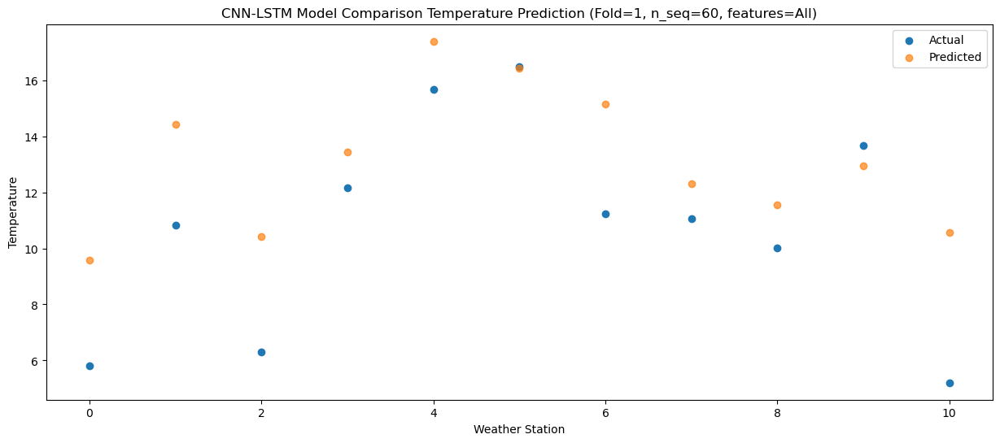

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   10.49  14.371492
1                 1   15.39  19.438260
2                 2   11.92  15.384854
3                 3   15.87  18.258753
4                 4   19.38  22.260583
5                 5   22.09  21.407771
6                 6   15.47  20.164530
7                 7   16.60  17.737932
8                 8   14.78  16.912990
9                 9   17.80  18.348560
10               10   10.80  16.655668


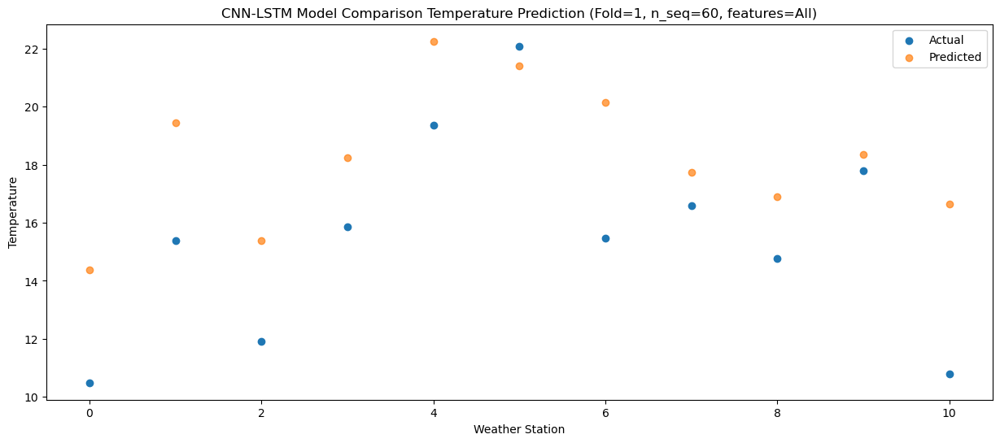

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   13.36  17.054469
1                 1   19.15  22.371103
2                 2   15.03  18.232170
3                 3   18.50  21.373042
4                 4   22.27  25.401789
5                 5   24.95  24.943315
6                 6   19.40  23.092595
7                 7   19.67  21.404262
8                 8   20.48  20.996322
9                 9   24.21  22.596156
10               10   16.91  20.456729


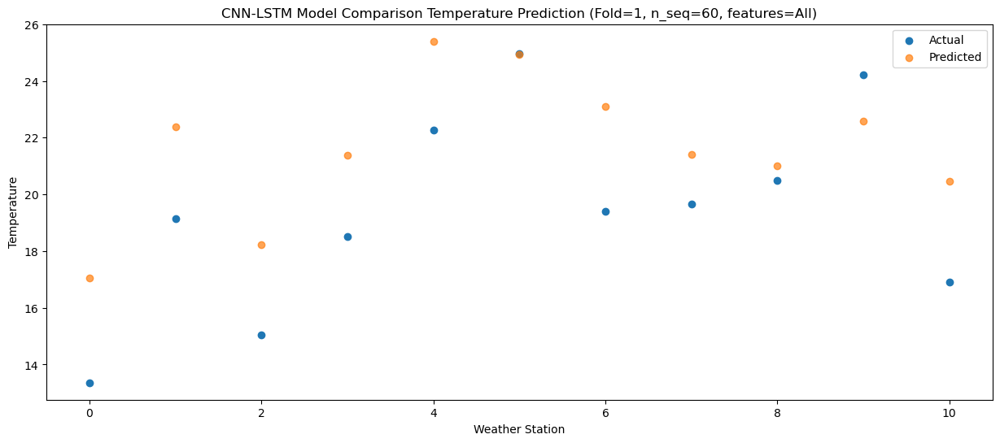

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   14.32  18.053437
1                 1   20.08  23.352642
2                 2   15.05  19.175524
3                 3   17.89  22.323767
4                 4   22.08  26.303407
5                 5   23.95  26.301754
6                 6   20.43  24.086673
7                 7   20.31  22.455990
8                 8   21.33  22.245343
9                 9   24.94  24.142840
10               10   18.84  22.243051


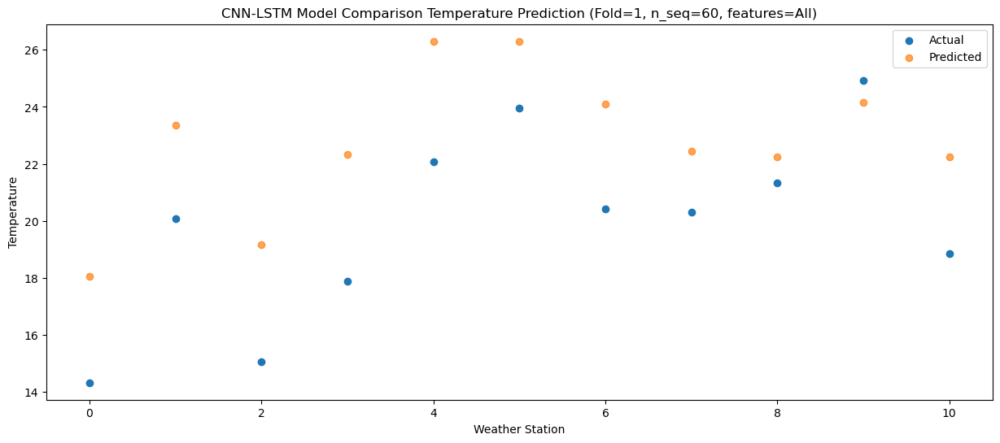

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   12.97  17.714911
1                 1   19.80  22.991467
2                 2   15.36  18.860477
3                 3   19.02  22.210095
4                 4   23.40  26.217438
5                 5   25.55  25.902447
6                 6   20.10  23.709639
7                 7   20.72  22.122116
8                 8   23.44  21.982528
9                 9   25.74  23.669542
10               10   16.69  20.844835


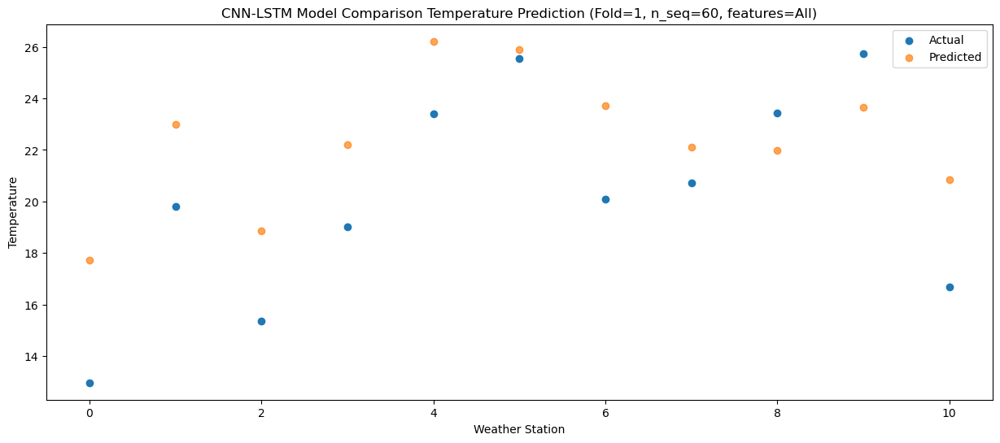

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   10.53  15.046888
1                 1   16.08  20.242878
2                 2   13.05  16.105785
3                 3   16.42  19.309024
4                 4   20.11  23.290578
5                 5   19.84  23.099387
6                 6   16.80  20.972334
7                 7   18.85  19.175942
8                 8   17.47  18.964629
9                 9   21.18  20.775030
10               10   12.96  18.319919


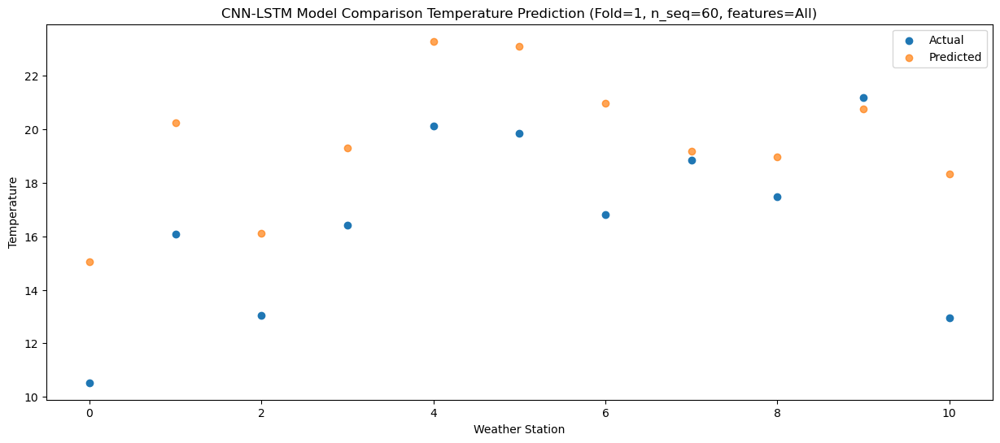

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    5.65  10.410138
1                 1   11.63  15.347417
2                 2    8.05  11.305433
3                 3   13.73  14.562587
4                 4   16.96  18.519199
5                 5   18.69  18.002443
6                 6   12.00  16.076664
7                 7   13.38  13.707851
8                 8   13.61  13.316885
9                 9   16.33  14.939885
10               10    8.09  12.240237


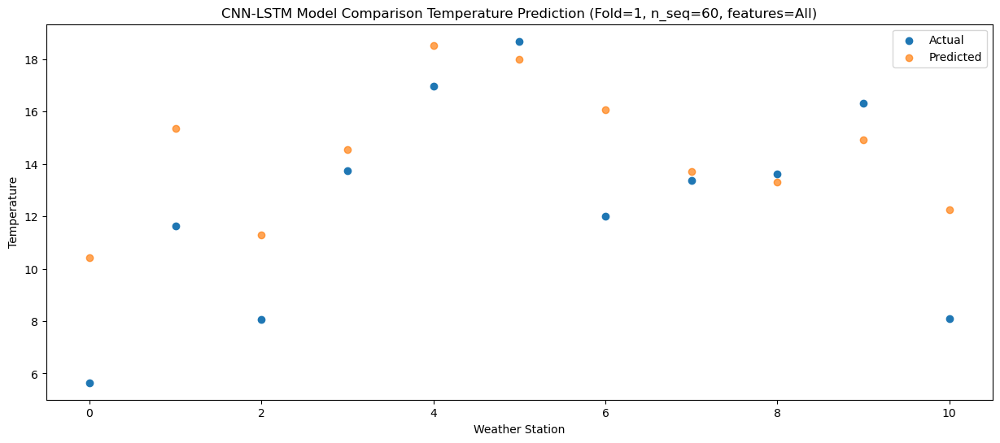

f, t:
[[-1.840e+00  3.520e+00 -1.480e+00  4.050e+00  8.110e+00  7.800e+00
   3.880e+00  9.200e-01  4.400e-01  4.680e+00 -1.560e+00]
 [-1.310e+00  2.610e+00 -1.050e+00  2.630e+00  6.220e+00  5.770e+00
   3.150e+00  3.000e-01 -1.410e+00  3.320e+00 -4.370e+00]
 [-1.420e+00  1.500e+00 -1.580e+00  3.380e+00  7.030e+00  5.110e+00
   2.340e+00 -5.500e-01 -1.230e+00  2.870e+00 -4.030e+00]
 [-1.560e+00  1.590e+00 -1.300e+00  2.850e+00  6.650e+00  4.590e+00
   2.410e+00  1.300e-01 -1.740e+00  1.630e+00 -3.290e+00]
 [ 3.500e+00  7.590e+00  5.800e+00  1.049e+01  1.469e+01  1.194e+01
   8.080e+00  7.050e+00  6.090e+00  9.590e+00  1.030e+00]
 [ 4.990e+00  8.810e+00  4.830e+00  1.037e+01  1.443e+01  1.473e+01
   9.710e+00  8.190e+00  7.470e+00  1.190e+01  2.660e+00]
 [ 8.070e+00  1.216e+01  8.980e+00  1.412e+01  1.823e+01  1.992e+01
   1.249e+01  1.269e+01  1.358e+01  1.843e+01  8.120e+00]
 [ 1.107e+01  1.651e+01  1.321e+01  1.690e+01  2.126e+01  2.264e+01
   1.716e+01  1.825e+01  1.869e+01  2.481e+0

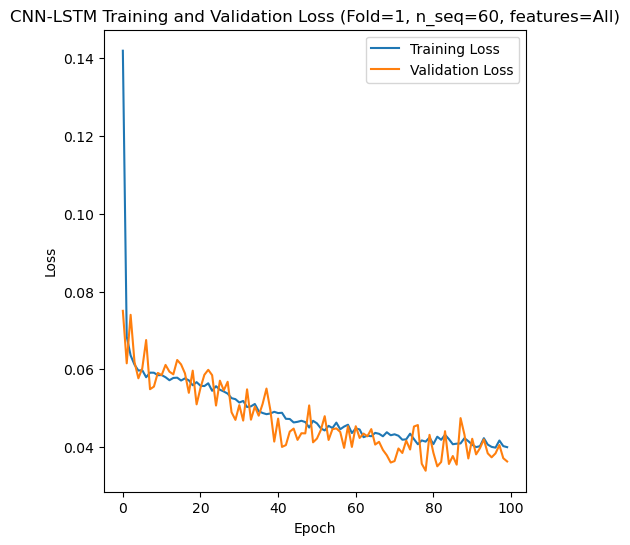

[[ 8.61  4.71 12.22 ... 22.49 18.22 13.52]
 [ 6.28  3.18  8.73 ... 22.36 17.39  7.52]
 [17.82 16.52 20.35 ... 28.79 25.32 22.93]
 ...
 [ 6.77  9.55 12.16 ... 24.55 20.29 10.24]
 [12.04 12.81 10.78 ... 23.32 20.33 13.93]
 [ 8.57  6.56 11.36 ... 21.36 16.14 12.65]]
Epoch 1/100
84/84 [==============================] - 25s 141ms/step - loss: 0.1443 - accuracy: 0.2381 - mae: 0.1254 - rmse: 0.1443 - mape: inf - pearson: 0.6222 - val_loss: 0.0627 - val_accuracy: 0.6000 - val_mae: 0.0484 - val_rmse: 0.0627 - val_mape: 12.0296 - val_pearson: 0.8443
Epoch 2/100
84/84 [==============================] - 5s 64ms/step - loss: 0.0694 - accuracy: 0.4881 - mae: 0.0553 - rmse: 0.0694 - mape: inf - pearson: 0.8030 - val_loss: 0.0441 - val_accuracy: 0.6000 - val_mae: 0.0356 - val_rmse: 0.0441 - val_mape: 7.9137 - val_pearson: 0.9251
Epoch 3/100
84/84 [==============================] - 9s 102ms/step - loss: 0.0575 - accuracy: 0.5952 - mae: 0.0456 - rmse: 0.0575 - mape: inf - pearson: 0.8520 - val_loss: 0.0

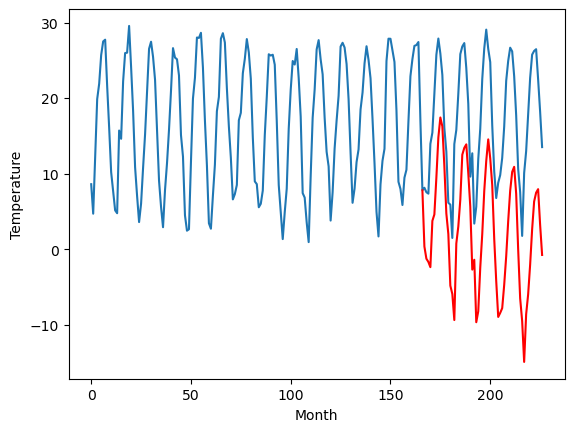

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.41		2.30		-1.11
1.13		-0.04		-1.17
0.89		-0.60		-1.49
0.16		-1.07		-1.23
8.17		4.73		-3.44
10.40		6.55		-3.85
17.20		12.12		-5.08
24.40		17.70		-6.70
24.43		20.22		-4.21
23.10		19.54		-3.56
16.97		13.59		-3.38
9.98		5.98		-4.00
6.86		2.79		-4.07
0.23		-3.10		-3.33
0.15		-3.90		-4.05
-3.89		-8.37		-4.48
6.30		2.10		-4.20
10.06		4.82		-5.24
15.24		8.66		-6.58
22.49		15.81		-6.68
23.18		17.06		-6.12
23.94		16.46		-7.48
21.70		12.64		-9.06
13.44		6.57		-6.87
6.73		-0.33		-7.06
4.34		-1.73		-6.07
-0.35		-8.16		-7.81
-0.36		-7.76		-7.40
6.62		-1.31		-7.93
13.30		3.04		-10.26
19.10		8.75		-10.35
22.90		13.72		-9.18
26.14		17.37		-8.77
23.83		15.19		-8.64
21.07		11.39		-9.68
12.69		3.77		-8.92
2.70		-4.72		-7.42
-0.01		-8.99		-8.98
-0.26		-8.51		-8.25
1.34		-8.48		-9.82
5.41		-4.78		-10.19
11.27		-0.00		-11.27
16.76		6.26		-10.50
19.37		9.86		-9.51
23.47		12.59		-10.88
23.96		13.29		-10.67
21.09		9

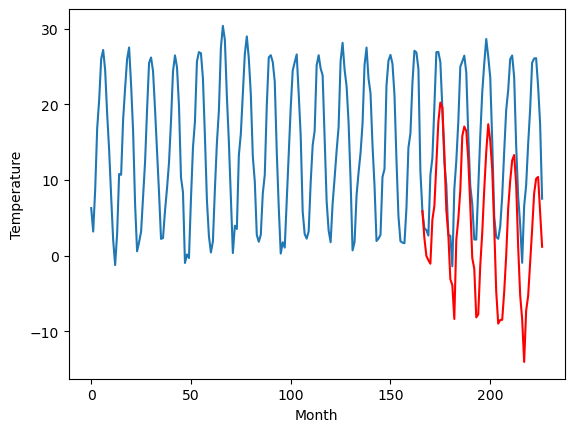

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-0.10		-1.24		-1.14
-1.22		-2.35		-1.13
-2.37		-1.87		0.50
-1.33		-1.48		-0.15
2.29		1.22		-1.07
3.68		1.64		-2.04
4.99		3.35		-1.64
7.58		5.00		-2.58
8.22		7.51		-0.71
7.91		8.06		0.15
6.65		5.64		-1.01
5.38		3.52		-1.86
1.96		-1.39		-3.35
-5.03		-6.86		-1.83
-4.37		-6.16		-1.79
-1.64		-4.04		-2.40
0.17		-3.42		-3.59
1.98		-1.60		-3.58
5.56		0.58		-4.98
6.78		3.25		-3.53
7.57		4.67		-2.90
7.62		4.95		-2.67
6.34		2.01		-4.33
5.20		-0.66		-5.86
-1.65		-5.98		-4.33
-0.75		-3.73		-2.98
-5.01		-7.74		-2.73
-2.68		-5.57		-2.89
0.79		-3.69		-4.48
2.60		-1.67		-4.27
5.36		0.42		-4.94
7.17		2.96		-4.21
7.35		4.77		-2.58
6.78		3.75		-3.03
5.37		1.91		-3.46
2.74		-3.49		-6.23
0.98		-5.93		-6.91
-3.12		-9.05		-5.93
-3.32		-8.24		-4.92
-0.26		-7.30		-7.04
0.76		-5.33		-6.09
3.30		-4.91		-8.21
4.28		-3.49		-7.77
6.69		-1.05		-7.74
8.60		2.96		-5.64
8.78		3.56		-5.22
6.83		-0.13		-6.96
3.25		-4.38		-7.63
-

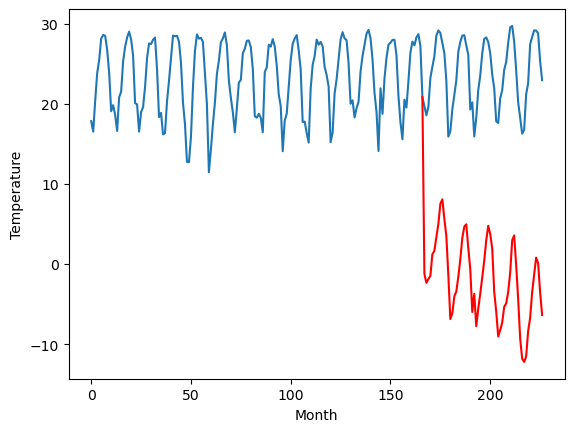

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
9.24		9.05		-0.19
6.18		6.96		0.78
6.45		6.75		0.30
6.60		6.37		-0.23
10.15		10.13		-0.02
11.38		11.91		0.53
17.27		16.73		-0.54
23.33		21.81		-1.52
27.61		25.30		-2.31
25.76		24.13		-1.63
21.18		19.75		-1.43
15.96		14.28		-1.68
12.00		10.39		-1.61
5.17		4.22		-0.95
2.09		2.87		0.78
2.11		1.71		-0.40
6.22		7.74		1.52
10.72		11.38		0.66
15.98		14.84		-1.14
21.55		20.80		-0.75
23.55		21.80		-1.75
24.61		22.14		-2.47
21.44		17.75		-3.69
17.61		13.93		-3.68
9.53		5.83		-3.70
7.61		5.24		-2.37
1.46		-1.09		-2.55
3.78		1.65		-2.13
7.64		5.99		-1.65
12.08		8.78		-3.30
17.42		14.75		-2.67
21.66		18.42		-3.24
26.28		21.29		-4.99
26.20		20.23		-5.97
21.16		16.50		-4.66
15.72		9.75		-5.97
11.92		5.79		-6.13
5.75		0.09		-5.66
7.04		1.27		-5.77
5.16		1.13		-4.03
7.60		3.00		-4.60
13.32		8.03		-5.29
16.95		11.36		-5.59
20.74		14.72		-6.02
26.31		18.74		-7.57
24.30		17.89		-6.41
21.88		14.77		-7.11
16.86		9

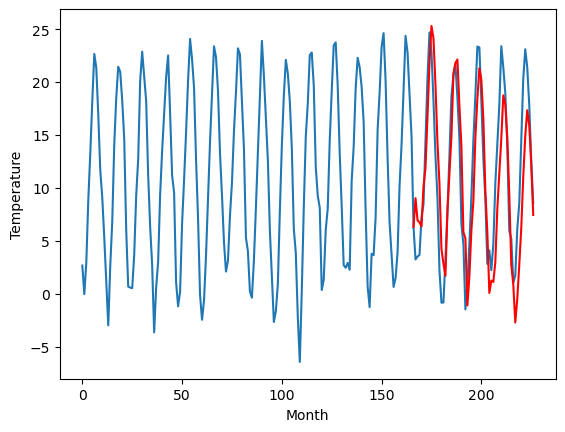

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.25		-5.10		1.15
-5.90		-6.18		-0.28
-5.56		-6.05		-0.49
-4.92		-6.18		-1.26
1.77		-1.48		-3.25
1.24		-1.24		-2.48
4.21		1.65		-2.56
7.25		4.73		-2.52
7.99		7.11		-0.88
8.36		6.99		-1.37
6.01		3.33		-2.68
2.32		-0.47		-2.79
-1.80		-4.22		-2.42
-8.10		-10.44		-2.34
-7.75		-10.36		-2.61
-8.49		-10.86		-2.37
-1.16		-5.54		-4.38
-0.29		-4.00		-3.71
4.18		-1.29		-5.47
7.66		2.50		-5.16
8.25		3.71		-4.54
8.42		4.19		-4.23
5.88		1.06		-4.82
3.14		-2.29		-5.43
-5.13		-8.90		-3.77
-1.72		-6.21		-4.49
-9.45		-12.49		-3.04
-6.31		-10.90		-4.59
-2.55		-7.18		-4.63
1.25		-3.74		-4.99
6.41		-0.41		-6.82
9.00		2.71		-6.29
8.83		4.90		-3.93
8.01		2.84		-5.17
6.04		0.46		-5.58
-0.15		-5.66		-5.51
-3.22		-9.53		-6.31
-5.73		-12.96		-7.23
-4.56		-12.42		-7.86
-2.43		-11.37		-8.94
-0.60		-8.64		-8.04
1.32		-7.41		-8.73
5.35		-4.54		-9.89
9.00		-1.25		-10.25
10.44		1.77		-8.67
11.74		2.83		-8.91
7.31		-0.91		-8

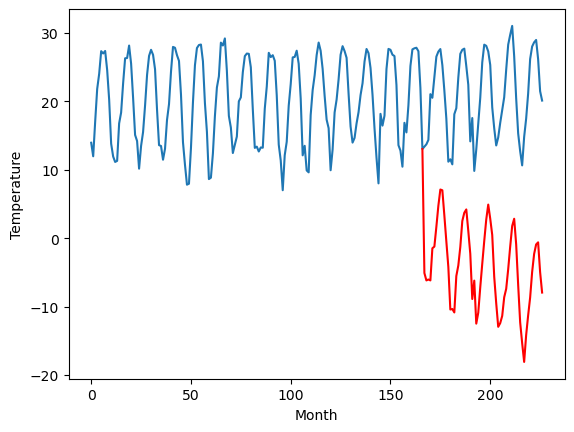

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
7.27		6.88		-0.39
5.84		5.45		-0.39
6.21		5.47		-0.74
5.45		5.07		-0.38
13.54		10.61		-2.93
13.51		11.18		-2.33
17.35		15.04		-2.31
20.96		18.83		-2.13
22.66		21.16		-1.50
22.96		20.96		-2.00
18.56		16.28		-2.28
14.09		11.11		-2.98
11.41		7.69		-3.72
5.30		1.54		-3.76
4.71		1.41		-3.30
2.36		-0.82		-3.18
10.74		7.04		-3.70
12.86		8.64		-4.22
16.90		11.73		-5.17
21.45		16.53		-4.92
21.53		17.68		-3.85
22.64		17.94		-4.70
19.90		14.71		-5.19
16.60		10.34		-6.26
8.96		3.72		-5.24
12.20		5.73		-6.47
3.77		-1.10		-4.87
3.39		-0.42		-3.81
9.51		4.54		-4.97
15.66		8.77		-6.89
20.26		12.60		-7.66
23.98		16.42		-7.56
25.34		19.19		-6.15
22.62		16.63		-5.99
19.96		13.89		-6.07
14.39		7.26		-7.13
8.51		1.34		-7.17
6.28		-1.72		-8.00
7.04		-1.39		-8.43
8.23		-0.62		-8.85
12.03		2.87		-9.16
12.95		4.70		-8.25
18.03		8.95		-9.08
22.95		12.52		-10.43
25.11		15.27		-9.84
26.81		16.66		-10.15
22.33		12.69		-9

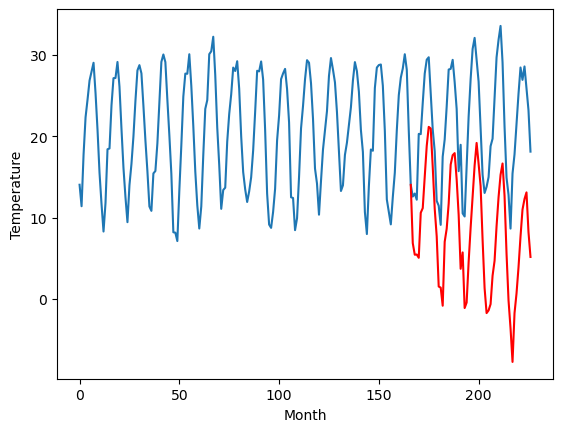

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.65		6.83		0.18
4.84		5.26		0.42
5.19		5.01		-0.18
4.63		4.41		-0.22
12.28		10.66		-1.62
12.59		11.39		-1.20
17.49		15.94		-1.55
22.23		20.62		-1.61
23.41		22.95		-0.46
23.64		22.33		-1.31
17.70		17.04		-0.66
12.22		10.85		-1.37
9.73		7.93		-1.80
3.27		1.46		-1.81
2.57		0.90		-1.67
-0.54		-2.59		-2.05
9.83		7.32		-2.51
11.53		9.09		-2.44
15.61		12.50		-3.11
21.17		18.11		-3.06
22.06		19.16		-2.90
22.62		19.39		-3.23
20.35		15.94		-4.41
15.84		11.13		-4.71
7.87		3.82		-4.05
10.16		5.36		-4.80
1.68		-2.31		-3.99
1.51		-1.68		-3.19
8.09		4.11		-3.98
14.36		8.76		-5.60
19.38		13.50		-5.88
24.09		17.63		-6.46
26.88		20.62		-6.26
24.07		17.84		-6.23
20.24		14.67		-5.57
13.86		7.62		-6.24
7.19		1.03		-6.16
4.57		-2.61		-7.18
5.45		-2.29		-7.74
5.64		-1.59		-7.23
10.29		2.05		-8.24
12.11		4.83		-7.28
17.85		9.81		-8.04
22.00		13.69		-8.31
24.56		16.08		-8.48
26.90		17.39		-9.51
22.12		13.49		-8.63
1

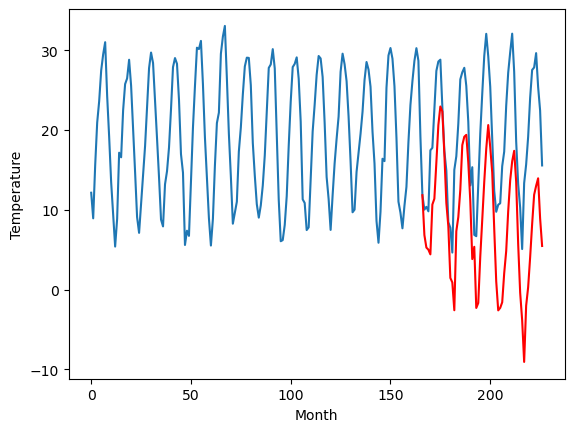

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.03		6.29		0.26
1.50		4.06		2.56
2.75		4.29		1.54
3.56		4.40		0.84
8.06		7.61		-0.45
13.04		9.46		-3.58
19.33		13.39		-5.94
22.85		16.56		-6.29
24.95		19.39		-5.56
25.39		19.82		-5.57
19.14		15.51		-3.63
13.54		10.51		-3.03
7.98		5.61		-2.37
0.33		0.90		0.57
0.87		1.15		0.28
3.79		0.48		-3.31
6.89		4.56		-2.33
13.55		7.34		-6.21
18.56		10.39		-8.17
23.55		15.62		-7.93
22.35		17.19		-5.16
21.83		16.54		-5.29
19.65		13.07		-6.58
13.09		8.06		-5.03
7.69		3.14		-4.55
4.34		2.17		-2.17
1.34		-1.47		-2.81
2.31		-0.70		-3.01
7.37		3.39		-3.98
14.56		6.15		-8.41
19.26		9.58		-9.68
23.12		13.77		-9.35
24.26		16.99		-7.27
21.24		15.82		-5.42
19.51		12.97		-6.54
11.30		6.53		-4.77
4.41		-0.20		-4.61
2.24		-3.14		-5.38
1.53		-2.41		-3.94
2.74		-2.53		-5.27
7.44		0.47		-6.97
13.08		3.25		-9.83
17.73		7.39		-10.34
22.39		9.93		-12.46
27.14		14.16		-12.98
24.14		14.61		-9.53
21.48		10.55		-10.93
14.74		4.5

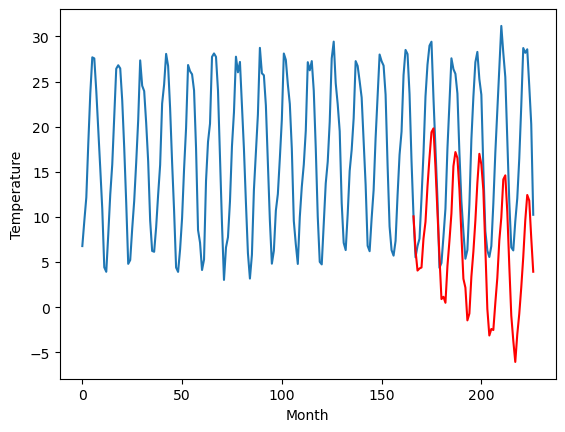

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.17		2.08		-0.09
-1.37		-0.61		0.76
-0.83		-0.03		0.80
1.28		0.52		-0.76
1.35		1.82		0.47
4.56		4.43		-0.13
8.61		7.88		-0.73
9.90		9.97		0.07
12.31		13.05		0.74
14.71		14.23		-0.48
13.11		10.52		-2.59
9.87		6.22		-3.65
3.15		0.05		-3.10
1.10		-3.45		-4.55
1.04		-2.55		-3.59
0.12		-1.54		-1.66
-0.28		-1.17		-0.89
3.58		2.18		-1.40
5.80		4.99		-0.81
10.04		9.97		-0.07
13.02		11.85		-1.17
12.62		10.58		-2.04
10.84		7.14		-3.70
5.86		1.86		-4.00
4.60		-1.32		-5.92
-1.91		-3.97		-2.06
0.50		-4.94		-5.44
1.37		-4.29		-5.66
3.16		-1.26		-4.42
5.28		0.31		-4.97
6.24		2.69		-3.55
11.16		6.96		-4.20
11.97		10.39		-1.58
14.01		10.20		-3.81
13.60		7.57		-6.03
7.33		1.57		-5.76
1.10		-5.62		-6.72
-1.60		-7.83		-6.23
-1.94		-6.90		-4.96
-2.26		-7.57		-5.31
-1.25		-4.85		-3.60
2.59		-2.24		-4.83
3.80		1.49		-2.31
5.76		3.14		-2.62
12.68		8.53		-4.15
12.31		8.61		-3.70
8.81		4.30		-4.51
7.22		-0.62		-7.84


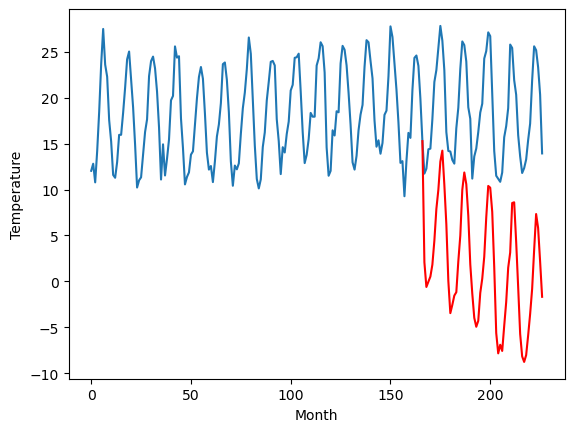

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.04		3.33		1.29
1.63		1.92		0.29
1.34		1.85		0.51
2.38		1.60		-0.78
7.61		6.02		-1.59
8.91		6.78		-2.13
11.51		10.51		-1.00
16.80		14.63		-2.17
19.79		17.55		-2.24
18.79		16.76		-2.03
14.76		12.85		-1.91
10.84		8.42		-2.42
6.23		4.76		-1.47
-0.77		-1.69		-0.92
-1.18		-2.40		-1.22
-0.68		-3.16		-2.48
6.20		2.69		-3.51
8.99		5.14		-3.85
13.01		8.18		-4.83
17.30		12.86		-4.44
18.87		13.94		-4.93
18.96		14.51		-4.45
14.85		10.74		-4.11
11.57		7.43		-4.14
2.66		-0.29		-2.95
4.58		1.28		-3.30
-1.90		-5.44		-3.54
2.12		-3.01		-5.13
6.23		0.98		-5.25
9.52		4.17		-5.35
14.37		8.94		-5.43
18.13		12.18		-5.95
19.57		14.52		-5.05
18.19		12.87		-5.32
14.88		9.82		-5.06
7.57		3.40		-4.17
5.45		0.06		-5.39
-1.08		-4.77		-3.69
2.12		-3.90		-6.02
5.14		-3.23		-8.37
5.59		-1.08		-6.67
9.11		1.97		-7.14
11.89		4.80		-7.09
15.55		8.25		-7.30
19.14		11.57		-7.57
18.59		11.66		-6.93
14.63		8.33		-6.30
9.34		2.71

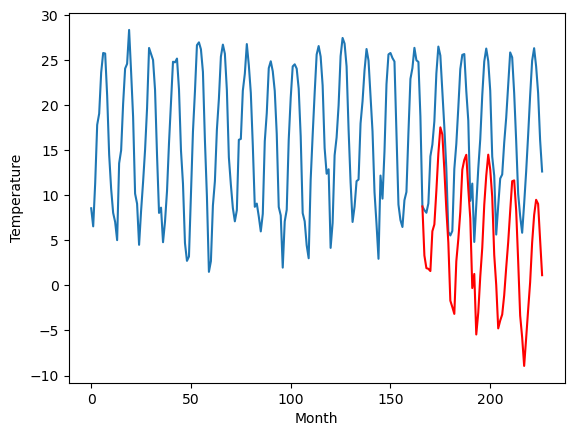

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-1.92		-0.29		1.63
-1.32		-1.84		-0.52
-1.76		-2.05		-0.29
-1.96		-2.46		-0.50
4.08		2.30		-1.78
4.51		3.23		-1.28
8.55		7.50		-1.05
13.92		12.22		-1.70
17.21		15.25		-1.96
15.95		14.17		-1.78
12.00		9.86		-2.14
7.34		4.78		-2.56
2.29		1.37		-0.92
-4.77		-5.23		-0.46
-4.44		-6.27		-1.83
-3.09		-7.76		-4.67
3.12		-0.70		-3.82
5.09		1.97		-3.12
10.00		5.23		-4.77
15.41		10.48		-4.93
16.72		11.47		-5.25
16.80		12.04		-4.76
12.31		8.09		-4.22
8.55		4.51		-4.04
-1.67		-3.68		-2.01
0.43		-2.47		-2.90
-6.44		-9.72		-3.28
-1.85		-7.31		-5.46
2.70		-2.79		-5.49
5.86		0.66		-5.20
12.10		6.06		-6.04
15.75		9.52		-6.23
17.10		12.05		-5.05
15.85		10.28		-5.57
11.70		6.93		-4.77
4.42		0.23		-4.19
1.97		-3.52		-5.49
-3.49		-8.69		-5.20
-1.57		-7.82		-6.25
1.22		-7.28		-8.50
1.75		-5.06		-6.81
6.64		-1.32		-7.96
9.99		1.95		-8.04
12.90		5.59		-7.31
16.45		8.82		-7.63
15.74		8.77		-6.97
12.96		5.50		-7.46
6.

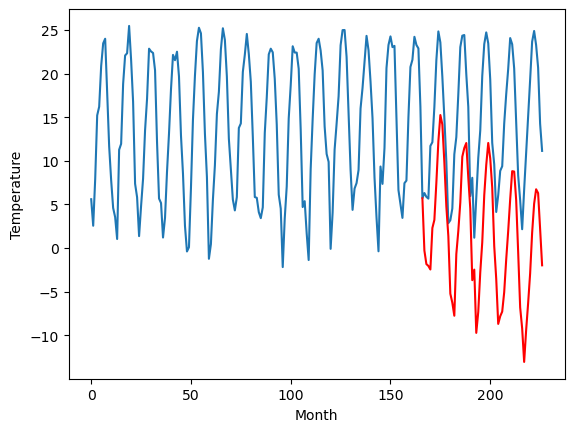

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -0.65   0.368973
1                 1    3.41   2.298262
2                 2   -0.10  -1.237182
3                 3    9.24   9.047053
4                 4   -6.25  -5.100224
5                 5    7.27   6.875984
6                 6    6.65   6.833360
7                 7    6.03   6.289601
8                 8    2.17   2.080928
9                 9    2.04   3.325644
10               10   -1.92  -0.288039


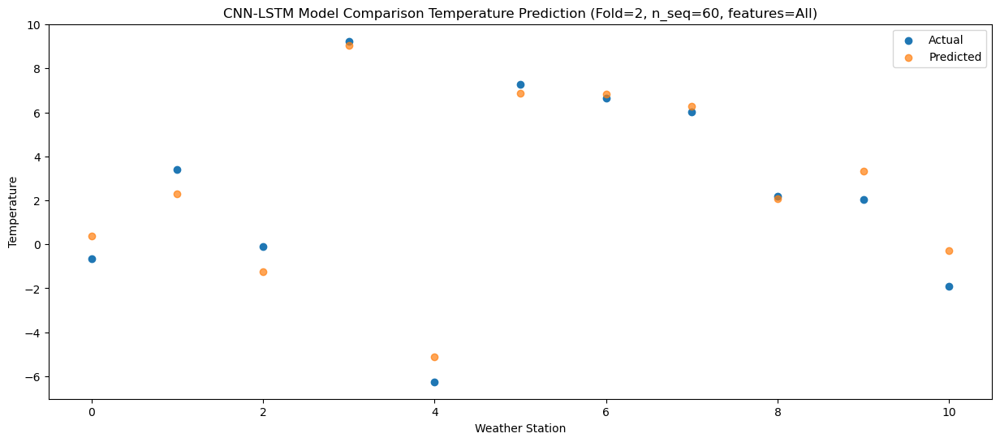

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -0.31  -1.244474
1                 1    1.13  -0.041897
2                 2   -1.22  -2.353885
3                 3    6.18   6.963047
4                 4   -5.90  -6.183595
5                 5    5.84   5.450699
6                 6    4.84   5.263414
7                 7    1.50   4.057388
8                 8   -1.37  -0.606425
9                 9    1.63   1.924811
10               10   -1.32  -1.836393


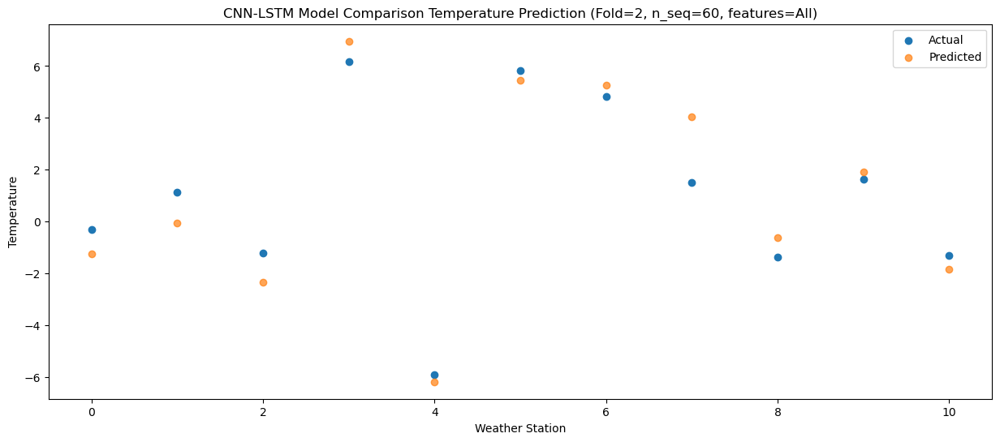

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -0.90  -1.672566
1                 1    0.89  -0.603037
2                 2   -2.37  -1.869763
3                 3    6.45   6.750084
4                 4   -5.56  -6.045944
5                 5    6.21   5.473005
6                 6    5.19   5.006311
7                 7    2.75   4.289586
8                 8   -0.83  -0.034864
9                 9    1.34   1.847458
10               10   -1.76  -2.048031


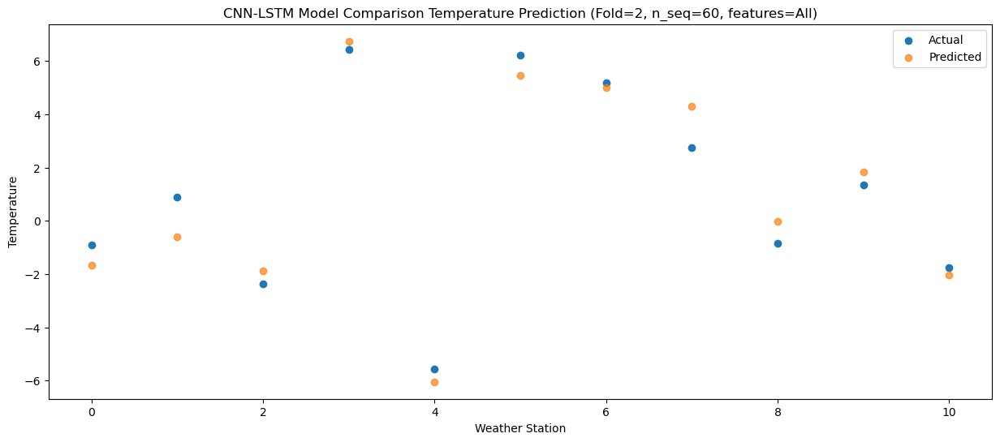

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -1.09  -2.365106
1                 1    0.16  -1.069943
2                 2   -1.33  -1.481488
3                 3    6.60   6.374337
4                 4   -4.92  -6.177838
5                 5    5.45   5.071099
6                 6    4.63   4.413607
7                 7    3.56   4.396762
8                 8    1.28   0.522810
9                 9    2.38   1.597541
10               10   -1.96  -2.455577


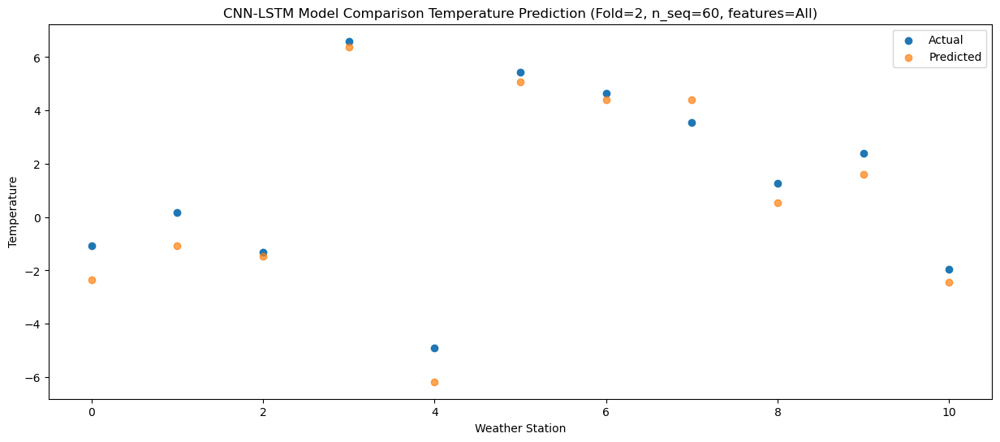

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    5.50   3.758501
1                 1    8.17   4.730447
2                 2    2.29   1.221610
3                 3   10.15  10.127271
4                 4    1.77  -1.481097
5                 5   13.54  10.608393
6                 6   12.28  10.660278
7                 7    8.06   7.608537
8                 8    1.35   1.821588
9                 9    7.61   6.020396
10               10    4.08   2.302598


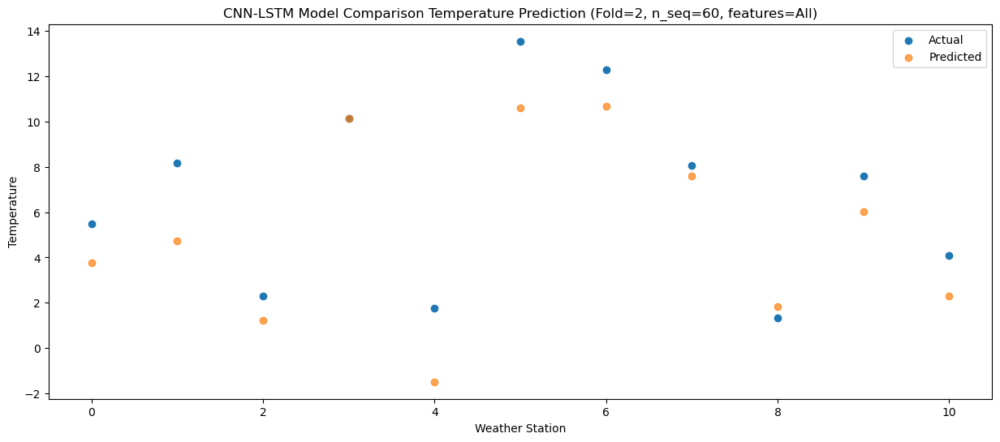

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    6.98   4.607242
1                 1   10.40   6.545221
2                 2    3.68   1.640217
3                 3   11.38  11.911280
4                 4    1.24  -1.238131
5                 5   13.51  11.176541
6                 6   12.59  11.385796
7                 7   13.04   9.456919
8                 8    4.56   4.433378
9                 9    8.91   6.775786
10               10    4.51   3.226389


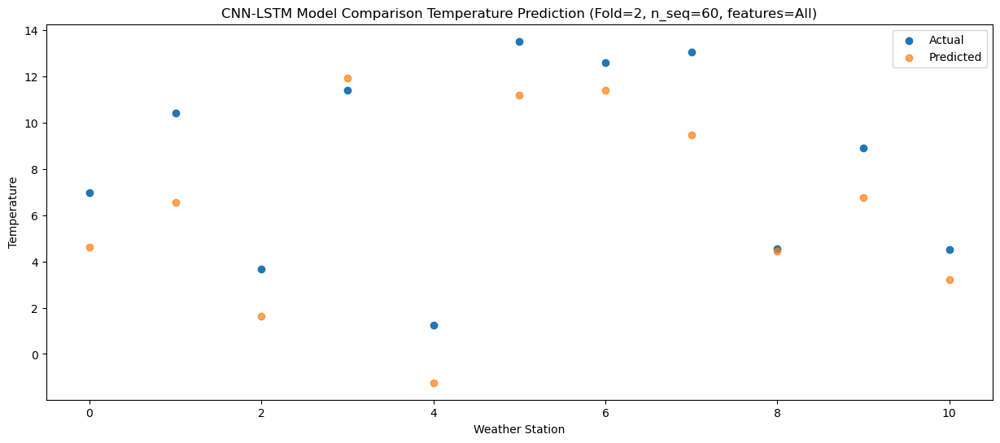

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0   12.27   9.470109
1                 1   17.20  12.122525
2                 2    4.99   3.351945
3                 3   17.27  16.734354
4                 4    4.21   1.654951
5                 5   17.35  15.044612
6                 6   17.49  15.943877
7                 7   19.33  13.385469
8                 8    8.61   7.880294
9                 9   11.51  10.509584
10               10    8.55   7.502390


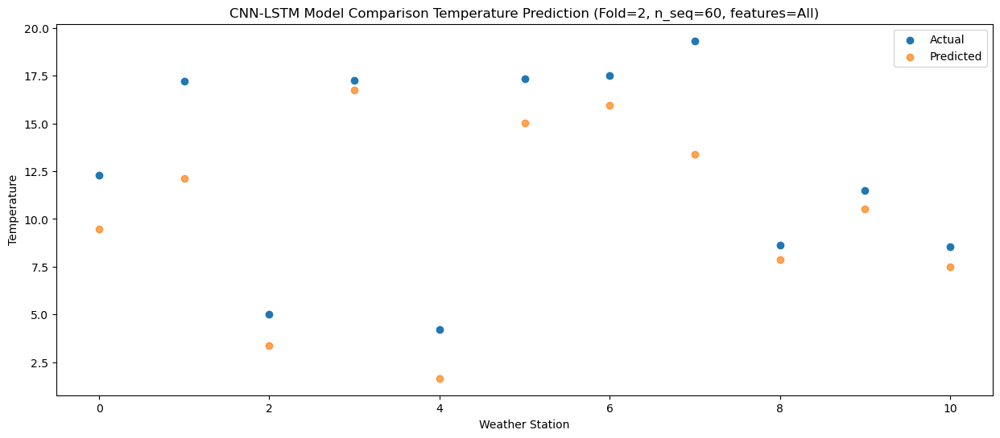

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   17.27  14.802050
1                 1   24.40  17.695668
2                 2    7.58   4.996900
3                 3   23.33  21.812657
4                 4    7.25   4.727717
5                 5   20.96  18.825466
6                 6   22.23  20.623794
7                 7   22.85  16.555845
8                 8    9.90   9.970872
9                 9   16.80  14.633932
10               10   13.92  12.221766


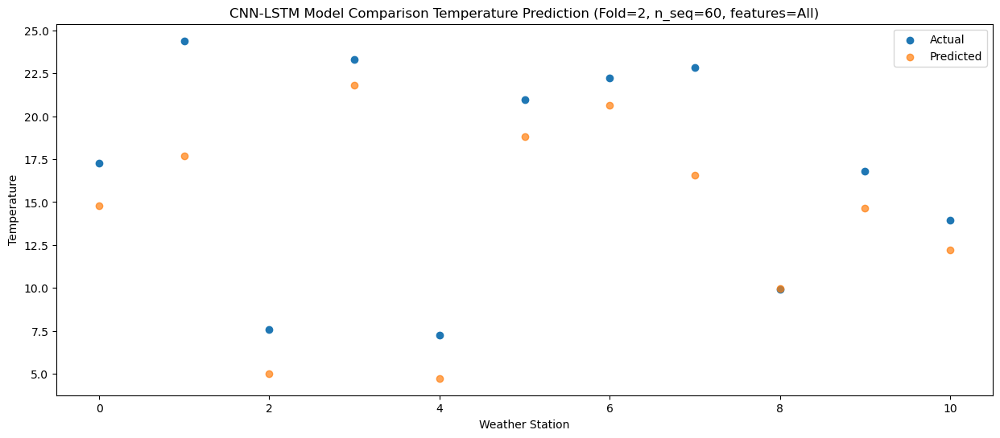

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   19.43  17.434404
1                 1   24.43  20.219473
2                 2    8.22   7.512315
3                 3   27.61  25.303831
4                 4    7.99   7.105128
5                 5   22.66  21.162242
6                 6   23.41  22.951477
7                 7   24.95  19.387922
8                 8   12.31  13.047637
9                 9   19.79  17.552298
10               10   17.21  15.250787


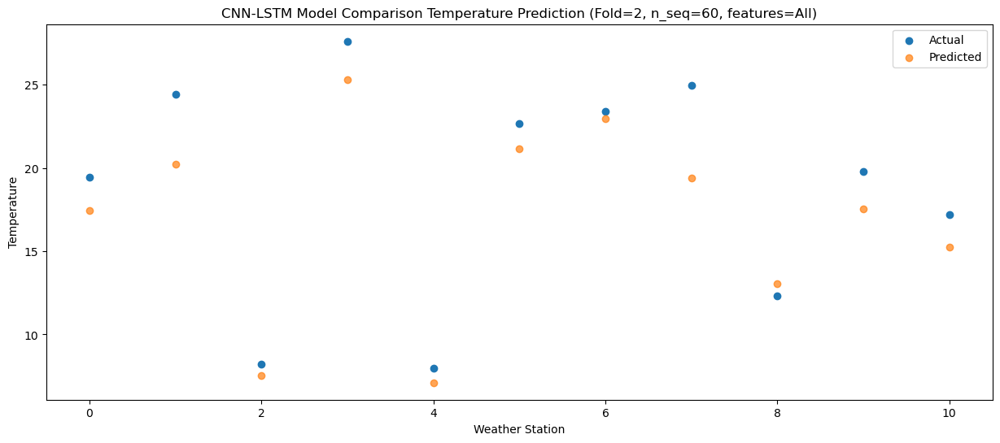

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   17.45  16.258206
1                 1   23.10  19.537893
2                 2    7.91   8.064423
3                 3   25.76  24.131573
4                 4    8.36   6.991317
5                 5   22.96  20.960565
6                 6   23.64  22.327270
7                 7   25.39  19.815364
8                 8   14.71  14.232467
9                 9   18.79  16.762216
10               10   15.95  14.168729


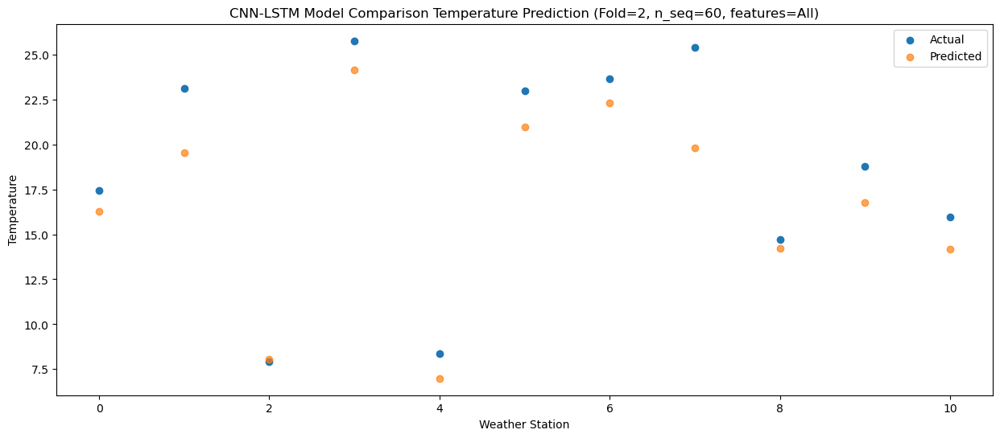

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   14.61  11.049559
1                 1   16.97  13.592810
2                 2    6.65   5.636624
3                 3   21.18  19.753810
4                 4    6.01   3.331817
5                 5   18.56  16.280841
6                 6   17.70  17.037167
7                 7   19.14  15.510675
8                 8   13.11  10.520499
9                 9   14.76  12.854948
10               10   12.00   9.856963


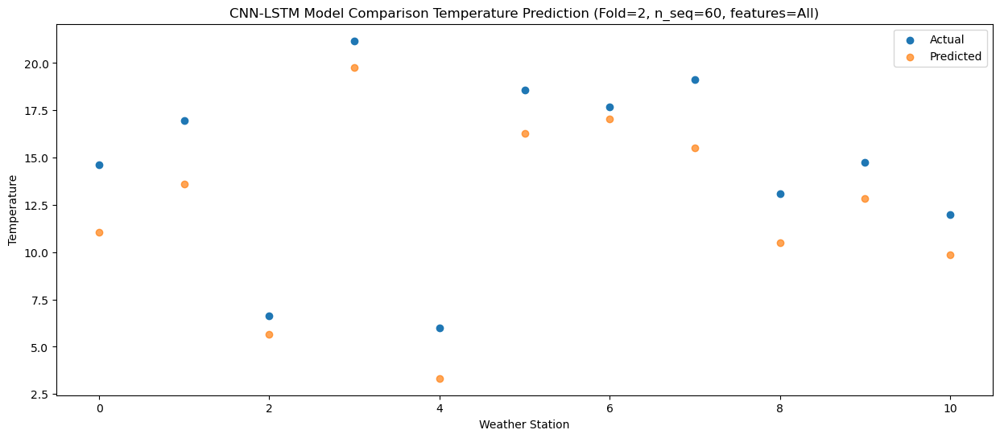

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    7.60   4.739086
1                 1    9.98   5.983739
2                 2    5.38   3.518001
3                 3   15.96  14.280066
4                 4    2.32  -0.474203
5                 5   14.09  11.105488
6                 6   12.22  10.853818
7                 7   13.54  10.511283
8                 8    9.87   6.222032
9                 9   10.84   8.417969
10               10    7.34   4.776208


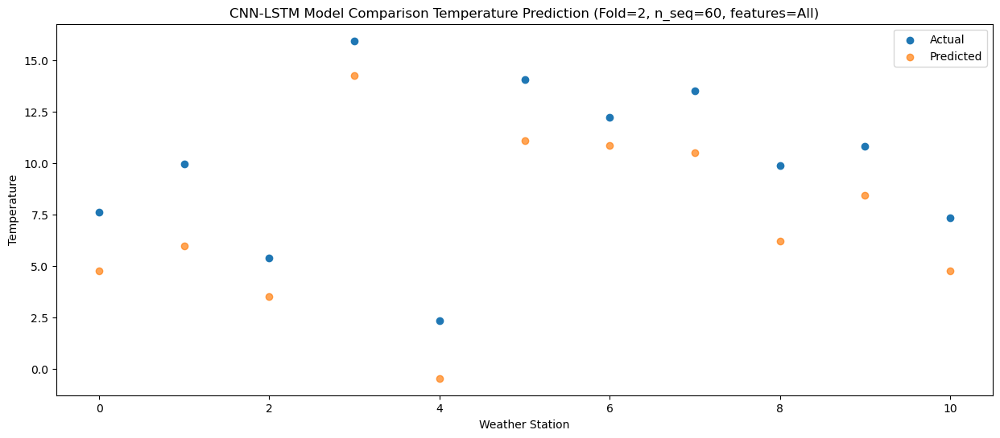

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    4.47   2.018549
1                 1    6.86   2.787971
2                 2    1.96  -1.391272
3                 3   12.00  10.394631
4                 4   -1.80  -4.217264
5                 5   11.41   7.694489
6                 6    9.73   7.926404
7                 7    7.98   5.612397
8                 8    3.15   0.045131
9                 9    6.23   4.761396
10               10    2.29   1.371343


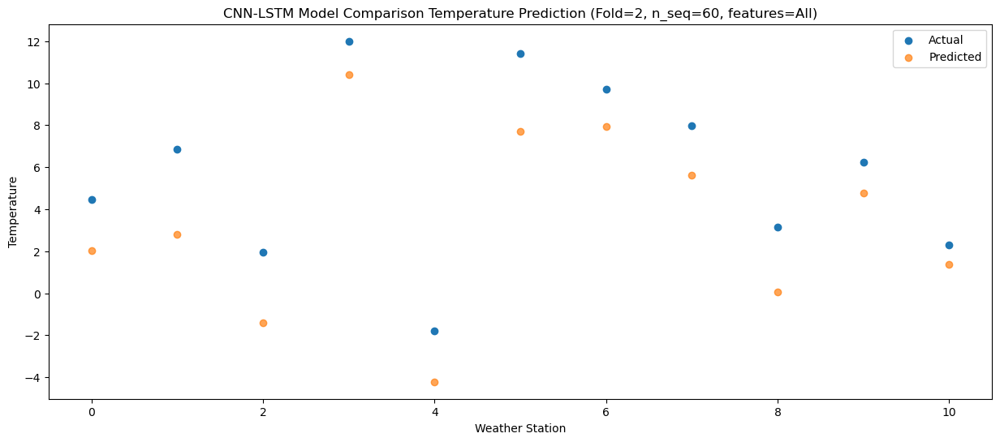

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -2.29  -4.816938
1                 1    0.23  -3.102453
2                 2   -5.03  -6.859630
3                 3    5.17   4.224533
4                 4   -8.10 -10.435324
5                 5    5.30   1.541005
6                 6    3.27   1.461285
7                 7    0.33   0.896835
8                 8    1.10  -3.453608
9                 9   -0.77  -1.686630
10               10   -4.77  -5.232020


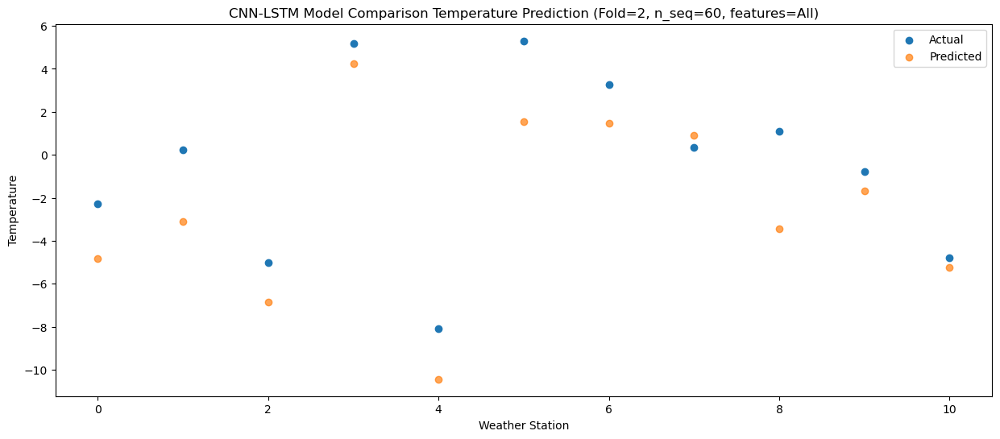

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -2.55  -5.907464
1                 1    0.15  -3.899086
2                 2   -4.37  -6.155461
3                 3    2.09   2.867693
4                 4   -7.75 -10.356362
5                 5    4.71   1.405363
6                 6    2.57   0.895701
7                 7    0.87   1.149331
8                 8    1.04  -2.552688
9                 9   -1.18  -2.397157
10               10   -4.44  -6.267320


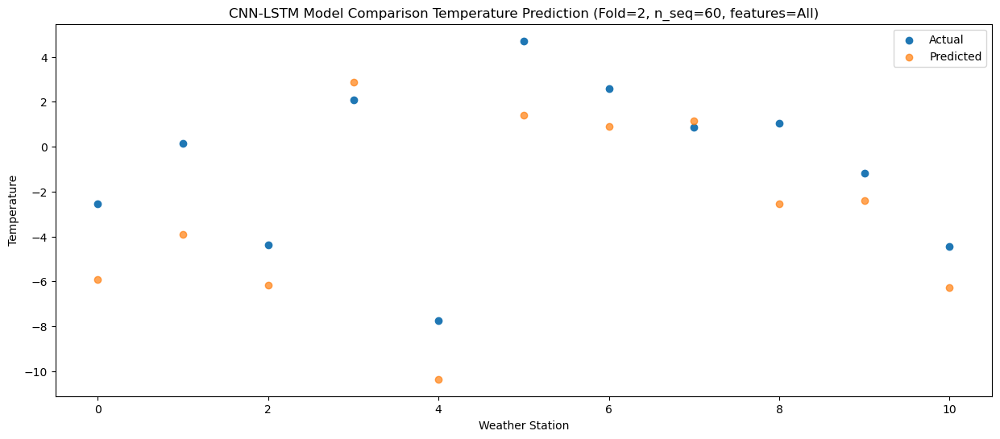

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -6.95  -9.359561
1                 1   -3.89  -8.372410
2                 2   -1.64  -4.038746
3                 3    2.11   1.709917
4                 4   -8.49 -10.862240
5                 5    2.36  -0.818745
6                 6   -0.54  -2.591653
7                 7    3.79   0.484998
8                 8    0.12  -1.544118
9                 9   -0.68  -3.156429
10               10   -3.09  -7.757425


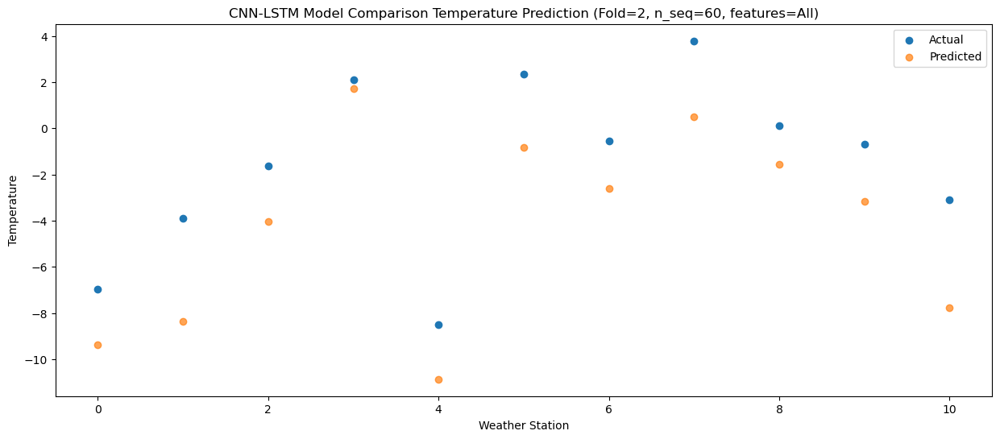

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    5.47   0.766447
1                 1    6.30   2.097389
2                 2    0.17  -3.417489
3                 3    6.22   7.739370
4                 4   -1.16  -5.539160
5                 5   10.74   7.037812
6                 6    9.83   7.316784
7                 7    6.89   4.561133
8                 8   -0.28  -1.173488
9                 9    6.20   2.692677
10               10    3.12  -0.696620


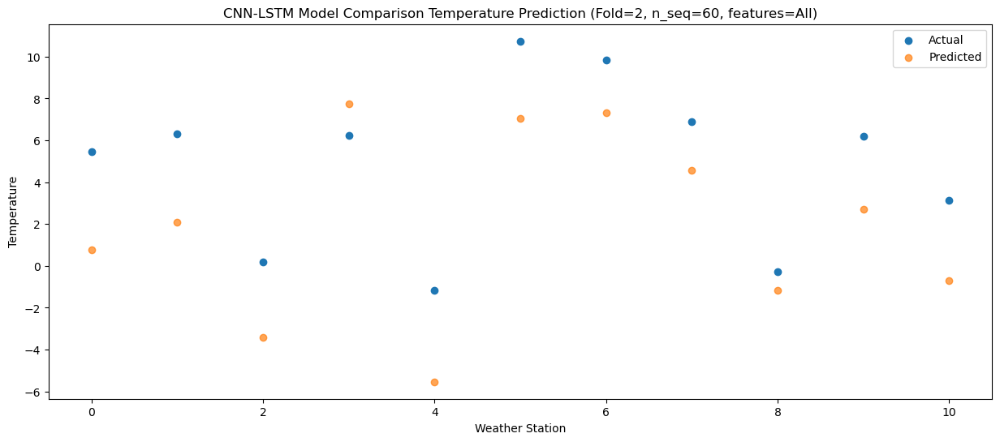

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    7.34   3.021664
1                 1   10.06   4.818390
2                 2    1.98  -1.602330
3                 3   10.72  11.375287
4                 4   -0.29  -4.001604
5                 5   12.86   8.637954
6                 6   11.53   9.093988
7                 7   13.55   7.336339
8                 8    3.58   2.177786
9                 9    8.99   5.138568
10               10    5.09   1.965849


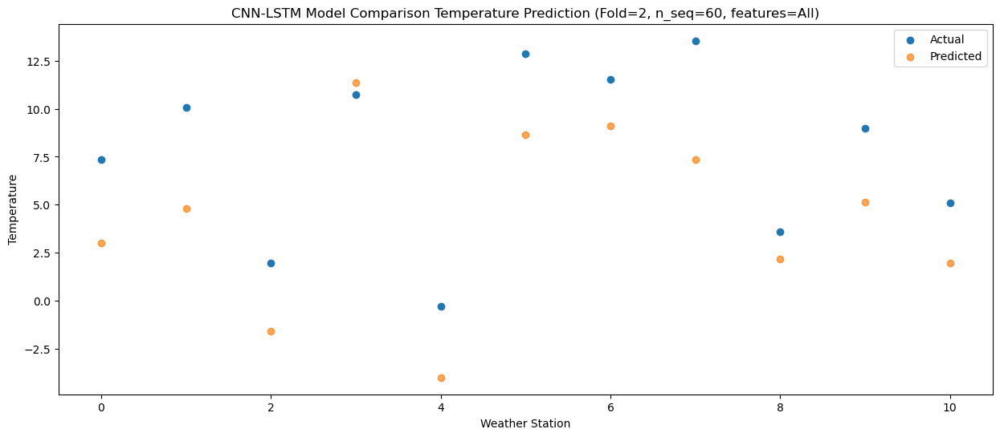

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0   12.12   6.564974
1                 1   15.24   8.664987
2                 2    5.56   0.584038
3                 3   15.98  14.844518
4                 4    4.18  -1.285808
5                 5   16.90  11.734344
6                 6   15.61  12.498897
7                 7   18.56  10.390649
8                 8    5.80   4.993066
9                 9   13.01   8.177453
10               10   10.00   5.229830


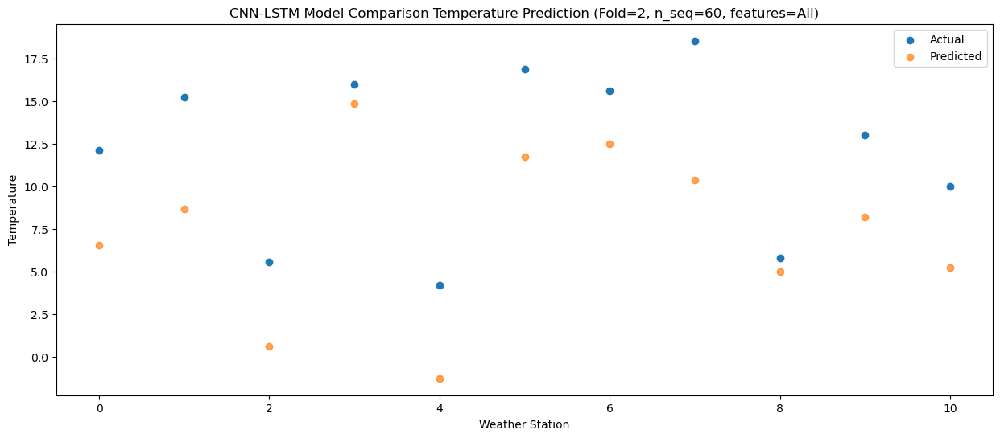

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   17.37  12.512374
1                 1   22.49  15.813703
2                 2    6.78   3.247196
3                 3   21.55  20.802543
4                 4    7.66   2.497688
5                 5   21.45  16.527538
6                 6   21.17  18.109942
7                 7   23.55  15.624679
8                 8   10.04   9.970223
9                 9   17.30  12.859713
10               10   15.41  10.476054


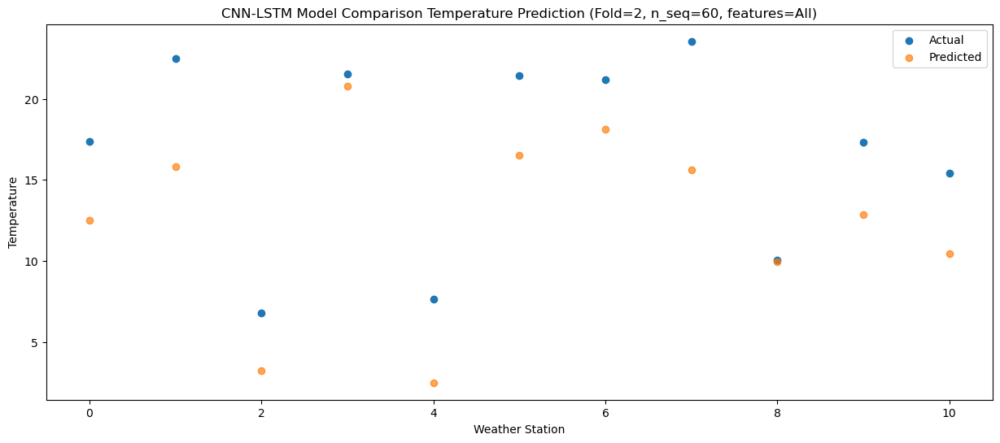

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   18.38  13.418982
1                 1   23.18  17.057344
2                 2    7.57   4.674181
3                 3   23.55  21.803893
4                 4    8.25   3.707430
5                 5   21.53  17.682123
6                 6   22.06  19.160527
7                 7   22.35  17.190204
8                 8   13.02  11.854692
9                 9   18.87  13.937239
10               10   16.72  11.471475


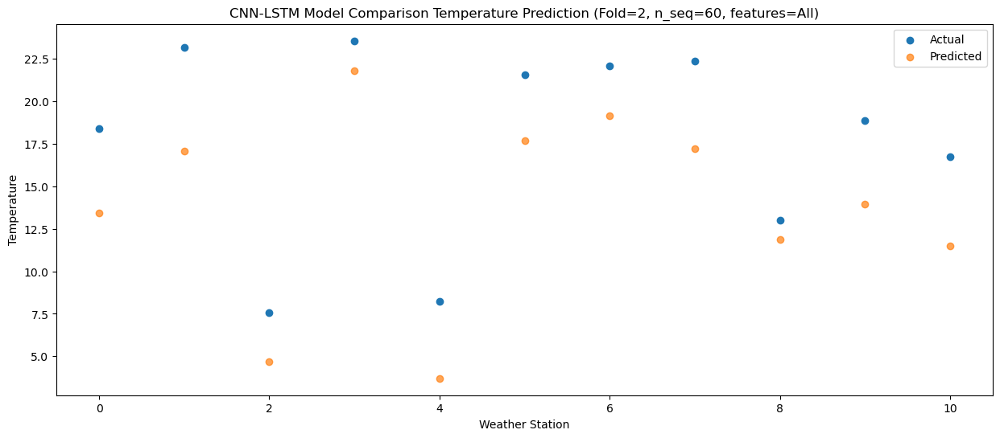

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   18.83  13.881216
1                 1   23.94  16.460548
2                 2    7.62   4.953879
3                 3   24.61  22.135727
4                 4    8.42   4.192306
5                 5   22.64  17.937916
6                 6   22.62  19.394576
7                 7   21.83  16.535099
8                 8   12.62  10.582559
9                 9   18.96  14.505851
10               10   16.80  12.043632


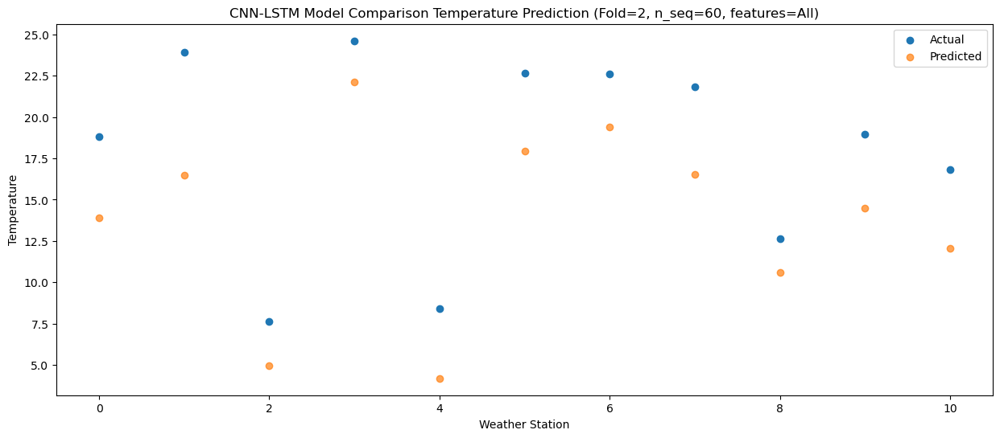

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   15.53  10.068397
1                 1   21.70  12.641041
2                 2    6.34   2.007962
3                 3   21.44  17.751717
4                 4    5.88   1.059546
5                 5   19.90  14.706021
6                 6   20.35  15.943207
7                 7   19.65  13.066961
8                 8   10.84   7.144591
9                 9   14.85  10.742217
10               10   12.31   8.086557


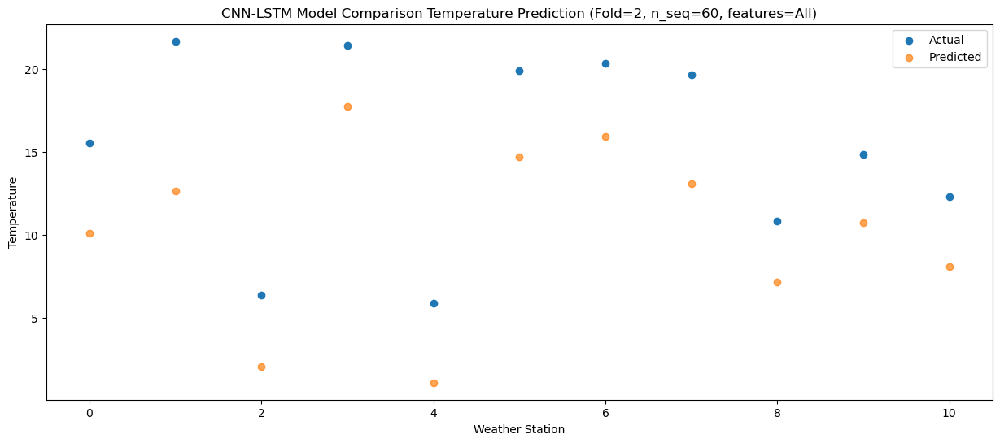

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0   10.78   5.643107
1                 1   13.44   6.565245
2                 2    5.20  -0.664607
3                 3   17.61  13.927856
4                 4    3.14  -2.293130
5                 5   16.60  10.341135
6                 6   15.84  11.134828
7                 7   13.09   8.063692
8                 8    5.86   1.858257
9                 9   11.57   7.427683
10               10    8.55   4.511405


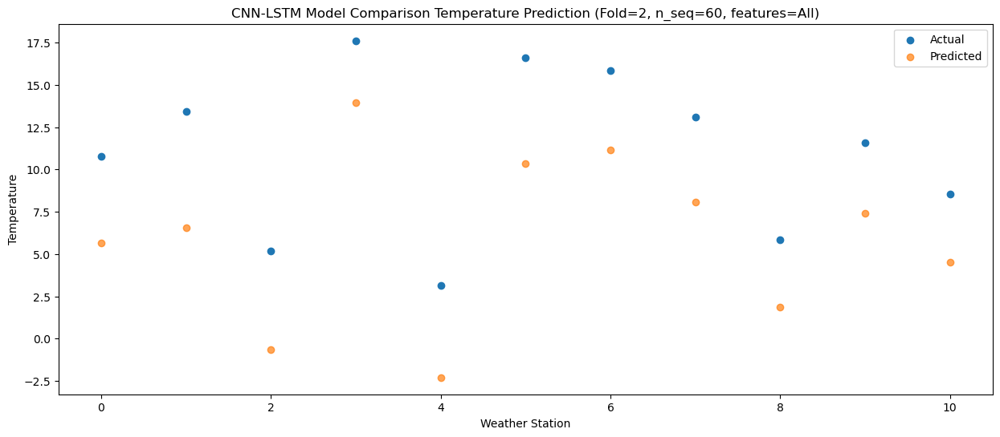

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.16  -2.685103
1                 1    6.73  -0.331468
2                 2   -1.65  -5.981033
3                 3    9.53   5.830185
4                 4   -5.13  -8.897301
5                 5    8.96   3.718967
6                 6    7.87   3.823686
7                 7    7.69   3.143708
8                 8    4.60  -1.322149
9                 9    2.66  -0.288058
10               10   -1.67  -3.679274


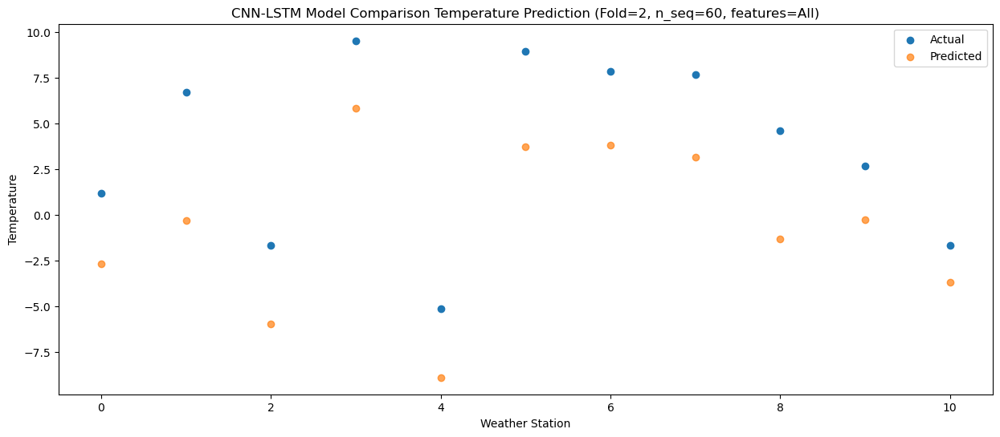

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    4.25  -1.384469
1                 1    4.34  -1.727015
2                 2   -0.75  -3.727628
3                 3    7.61   5.240942
4                 4   -1.72  -6.210764
5                 5   12.20   5.732742
6                 6   10.16   5.361927
7                 7    4.34   2.167604
8                 8   -1.91  -3.965196
9                 9    4.58   1.278315
10               10    0.43  -2.470370


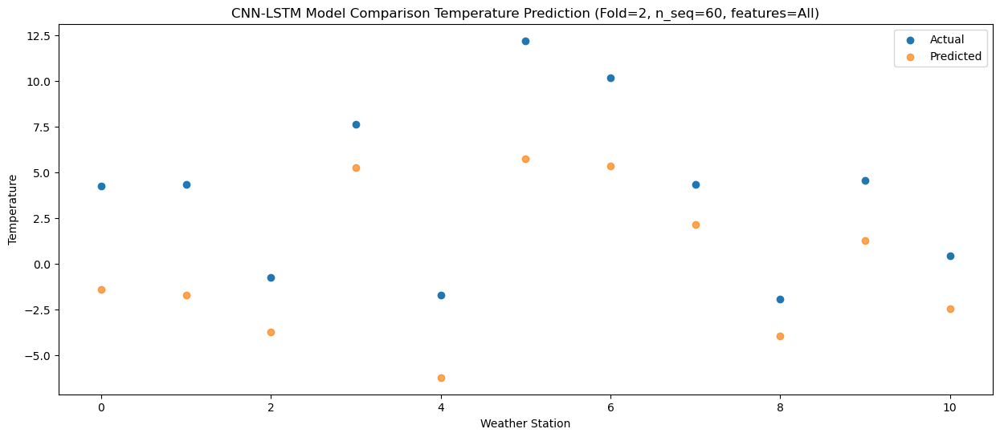

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -5.05  -9.647932
1                 1   -0.35  -8.162482
2                 2   -5.01  -7.741641
3                 3    1.46  -1.093112
4                 4   -9.45 -12.493316
5                 5    3.77  -1.103839
6                 6    1.68  -2.305326
7                 7    1.34  -1.465342
8                 8    0.50  -4.939603
9                 9   -1.90  -5.443689
10               10   -6.44  -9.723399


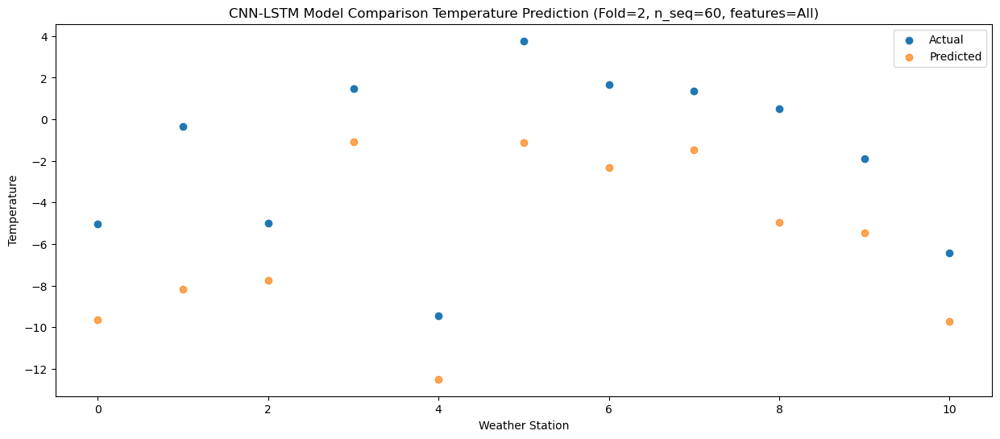

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -2.81  -8.190445
1                 1   -0.36  -7.764669
2                 2   -2.68  -5.570907
3                 3    3.78   1.647964
4                 4   -6.31 -10.898216
5                 5    3.39  -0.424944
6                 6    1.51  -1.678563
7                 7    2.31  -0.704087
8                 8    1.37  -4.290932
9                 9    2.12  -3.011486
10               10   -1.85  -7.313045


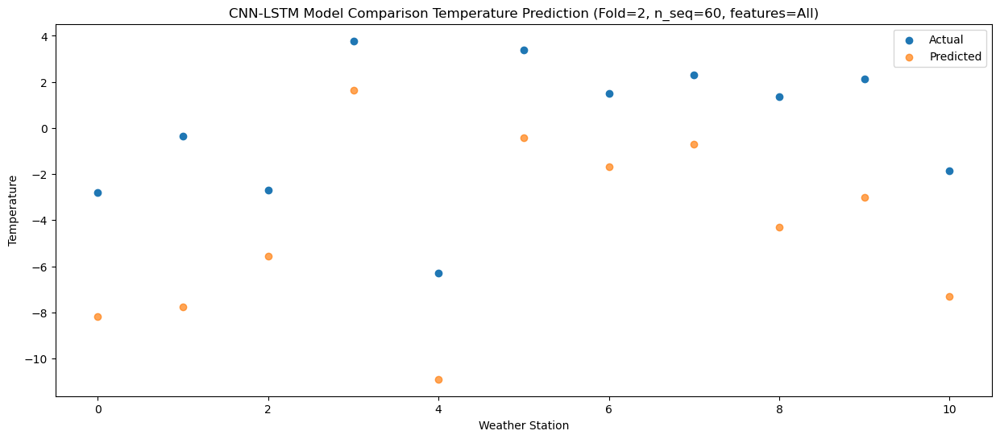

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    3.48  -2.420944
1                 1    6.62  -1.305093
2                 2    0.79  -3.691991
3                 3    7.64   5.991284
4                 4   -2.55  -7.183675
5                 5    9.51   4.544363
6                 6    8.09   4.108921
7                 7    7.37   3.388140
8                 8    3.16  -1.259055
9                 9    6.23   0.978103
10               10    2.70  -2.788382


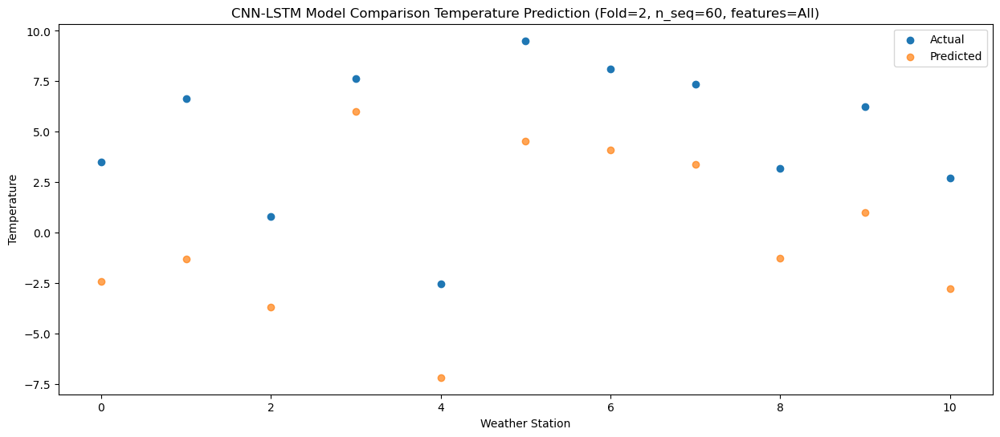

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    7.51   2.021196
1                 1   13.30   3.044082
2                 2    2.60  -1.669865
3                 3   12.08   8.779525
4                 4    1.25  -3.744906
5                 5   15.66   8.768149
6                 6   14.36   8.762698
7                 7   14.56   6.154660
8                 8    5.28   0.305541
9                 9    9.52   4.174663
10               10    5.86   0.660554


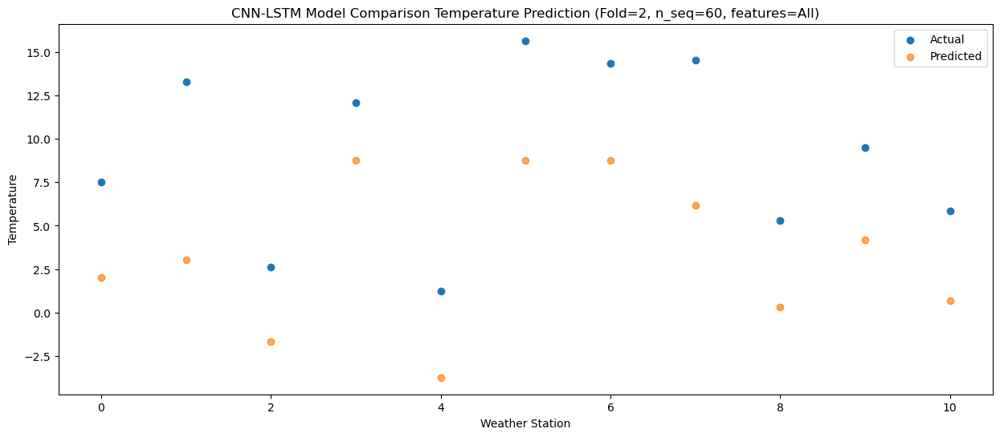

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   14.06   7.704868
1                 1   19.10   8.754032
2                 2    5.36   0.418877
3                 3   17.42  14.753954
4                 4    6.41  -0.408140
5                 5   20.26  12.595640
6                 6   19.38  13.501049
7                 7   19.26   9.583977
8                 8    6.24   2.689003
9                 9   14.37   8.942916
10               10   12.10   6.059545


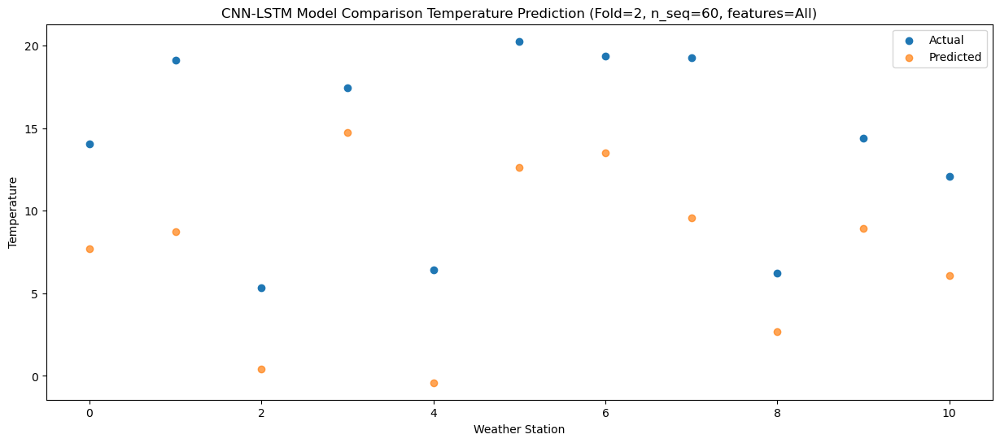

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   18.11  11.683618
1                 1   22.90  13.724983
2                 2    7.17   2.956735
3                 3   21.66  18.422114
4                 4    9.00   2.713300
5                 5   23.98  16.417705
6                 6   24.09  17.633349
7                 7   23.12  13.769804
8                 8   11.16   6.958474
9                 9   18.13  12.175678
10               10   15.75   9.522627


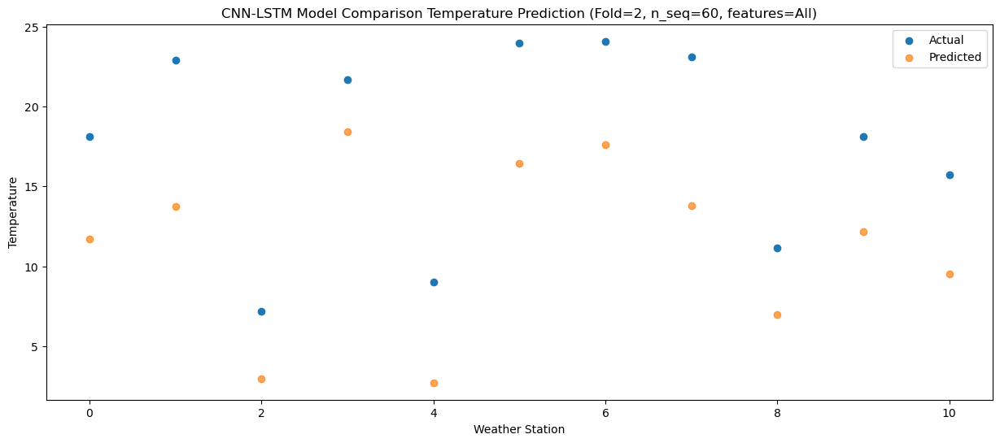

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   20.61  14.539676
1                 1   26.14  17.365834
2                 2    7.35   4.768372
3                 3   26.28  21.292949
4                 4    8.83   4.898960
5                 5   25.34  19.188034
6                 6   26.88  20.622858
7                 7   24.26  16.994559
8                 8   11.97  10.391246
9                 9   19.57  14.519893
10               10   17.10  12.048856


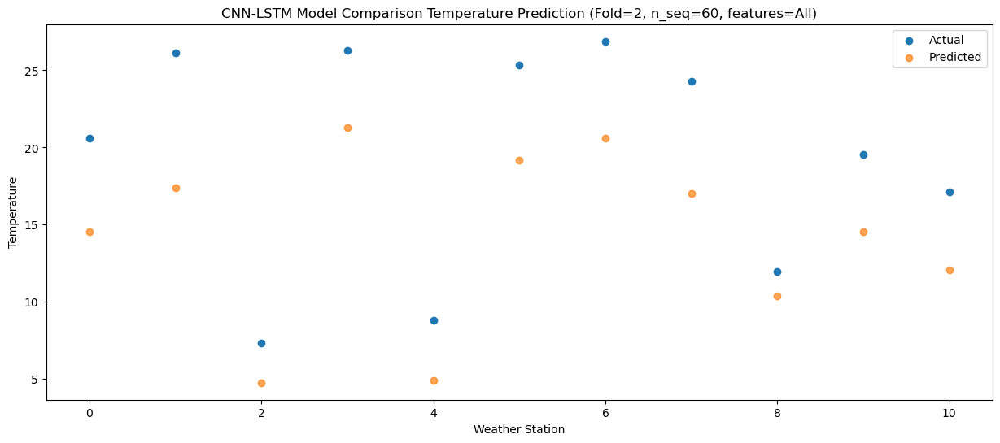

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   18.06  12.017444
1                 1   23.83  15.185765
2                 2    6.78   3.749447
3                 3   26.20  20.230255
4                 4    8.01   2.837861
5                 5   22.62  16.629074
6                 6   24.07  17.837995
7                 7   21.24  15.820982
8                 8   14.01  10.200369
9                 9   18.19  12.868033
10               10   15.85  10.282819


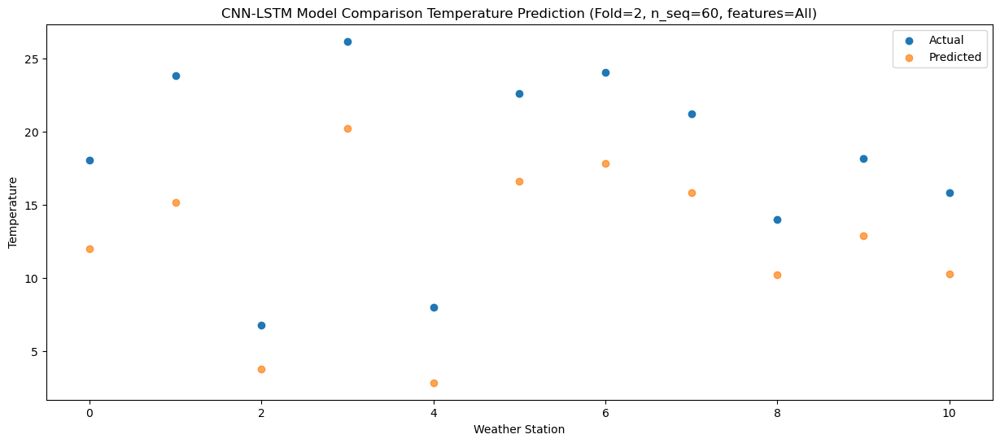

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   16.31   8.513553
1                 1   21.07  11.387825
2                 2    5.37   1.912590
3                 3   21.16  16.495943
4                 4    6.04   0.460613
5                 5   19.96  13.885245
6                 6   20.24  14.666877
7                 7   19.51  12.974774
8                 8   13.60   7.569947
9                 9   14.88   9.822801
10               10   11.70   6.930375


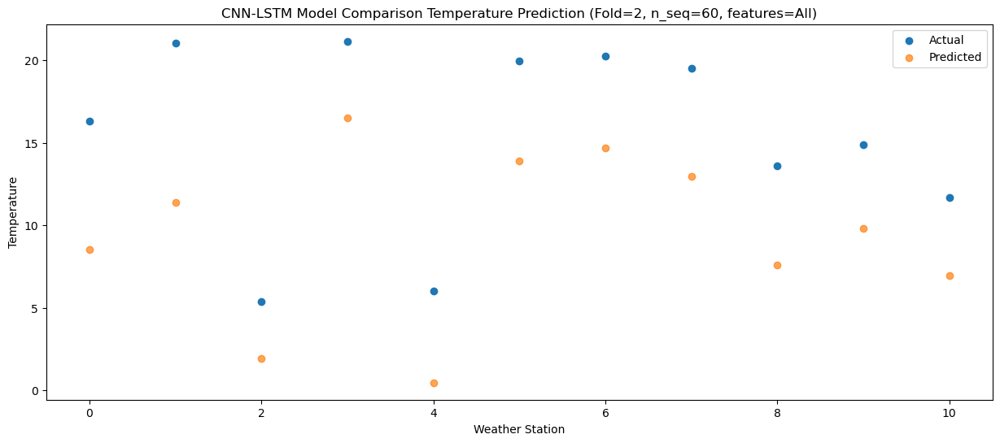

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    7.97   1.375418
1                 1   12.69   3.770678
2                 2    2.74  -3.489829
3                 3   15.72   9.746819
4                 4   -0.15  -5.658058
5                 5   14.39   7.262698
6                 6   13.86   7.620773
7                 7   11.30   6.534459
8                 8    7.33   1.567780
9                 9    7.57   3.397801
10               10    4.42   0.234346


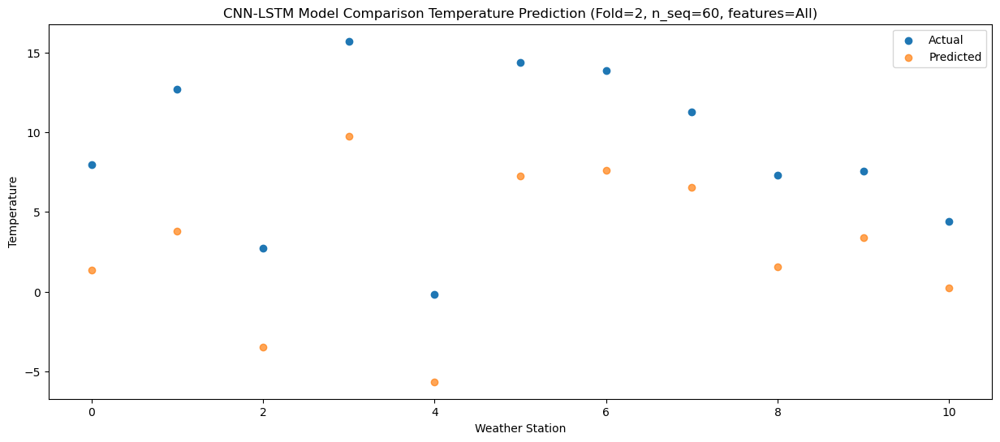

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.84  -4.206227
1                 1    2.70  -4.715682
2                 2    0.98  -5.927278
3                 3   11.92   5.785175
4                 4   -3.22  -9.526737
5                 5    8.51   1.344729
6                 6    7.19   1.030068
7                 7    4.41  -0.201428
8                 8    1.10  -5.616980
9                 9    5.45   0.061738
10               10    1.97  -3.524322


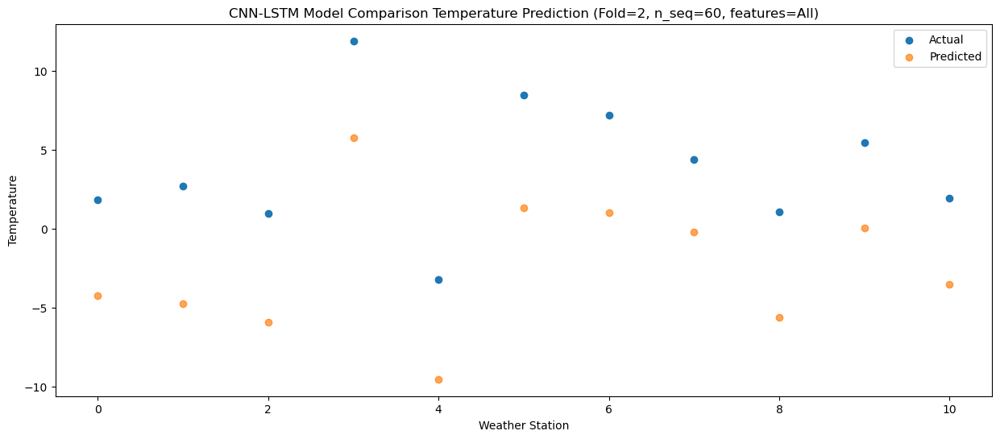

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -1.67  -8.949854
1                 1   -0.01  -8.987678
2                 2   -3.12  -9.045248
3                 3    5.75   0.094145
4                 4   -5.73 -12.960194
5                 5    6.28  -1.724760
6                 6    4.57  -2.608212
7                 7    2.24  -3.141905
8                 8   -1.60  -7.832548
9                 9   -1.08  -4.766912
10               10   -3.49  -8.692711


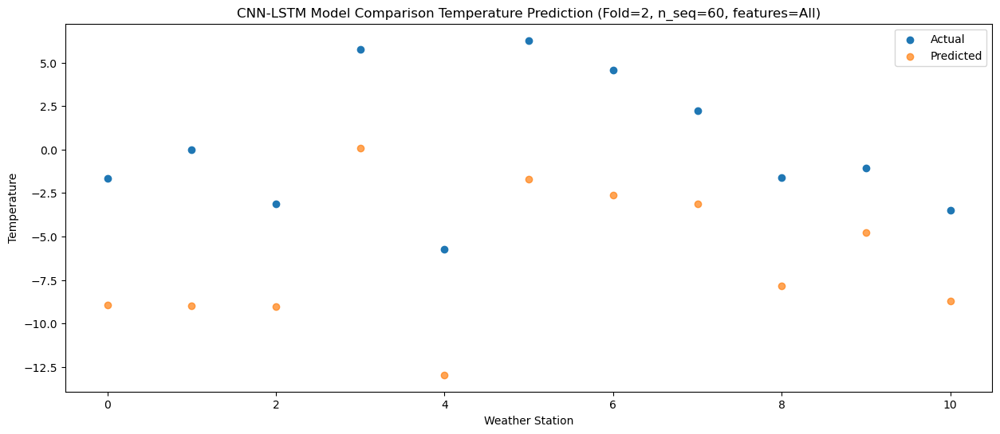

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.35  -8.414080
1                 1   -0.26  -8.505716
2                 2   -3.32  -8.236073
3                 3    7.04   1.266855
4                 4   -4.56 -12.424733
5                 5    7.04  -1.393012
6                 6    5.45  -2.293036
7                 7    1.53  -2.413809
8                 8   -1.94  -6.896240
9                 9    2.12  -3.898586
10               10   -1.57  -7.819959


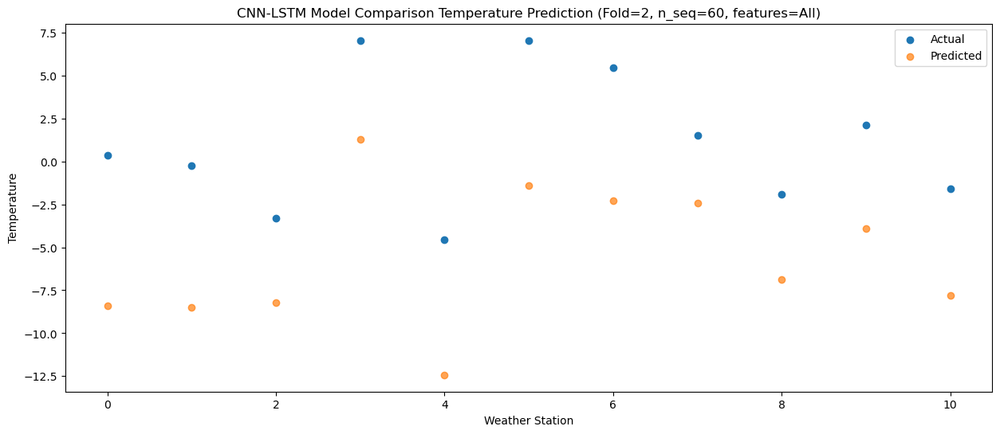

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.37  -7.784795
1                 1    1.34  -8.476484
2                 2   -0.26  -7.304786
3                 3    5.16   1.126409
4                 4   -2.43 -11.368059
5                 5    8.23  -0.622430
6                 6    5.64  -1.592243
7                 7    2.74  -2.530804
8                 8   -2.26  -7.572021
9                 9    5.14  -3.226777
10               10    1.22  -7.284944


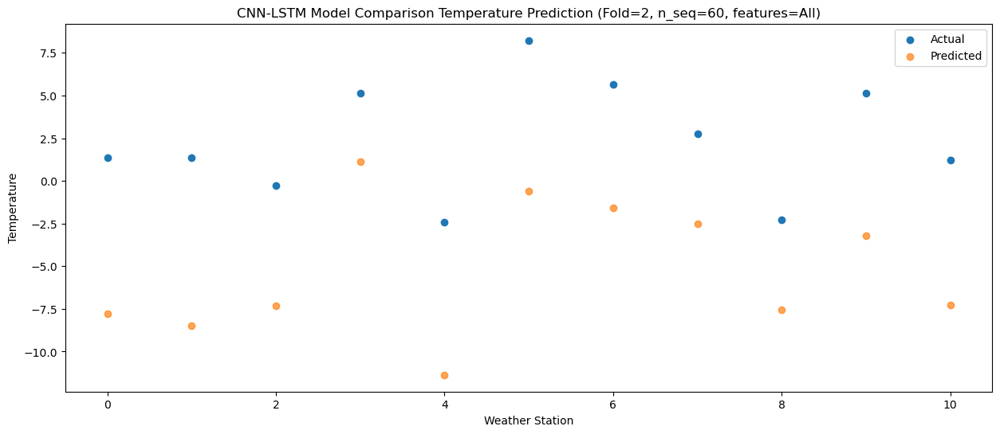

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    3.64  -4.701761
1                 1    5.41  -4.776134
2                 2    0.76  -5.330135
3                 3    7.60   3.003165
4                 4   -0.60  -8.644313
5                 5   12.03   2.874721
6                 6   10.29   2.049823
7                 7    7.44   0.470333
8                 8   -1.25  -4.849164
9                 9    5.59  -1.080744
10               10    1.75  -5.055209


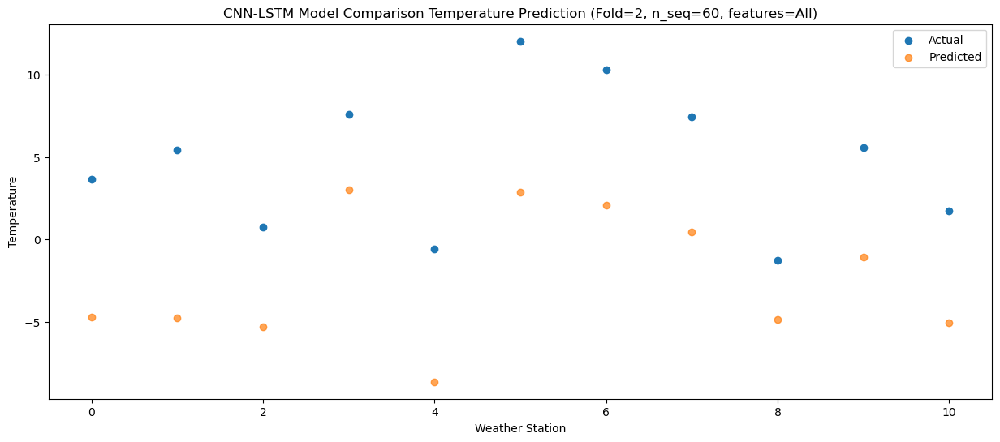

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    7.79  -0.925550
1                 1   11.27  -0.001597
2                 2    3.30  -4.911595
3                 3   13.32   8.032099
4                 4    1.32  -7.409157
5                 5   12.95   4.702418
6                 6   12.11   4.825946
7                 7   13.08   3.249081
8                 8    2.59  -2.241648
9                 9    9.11   1.966969
10               10    6.64  -1.324360


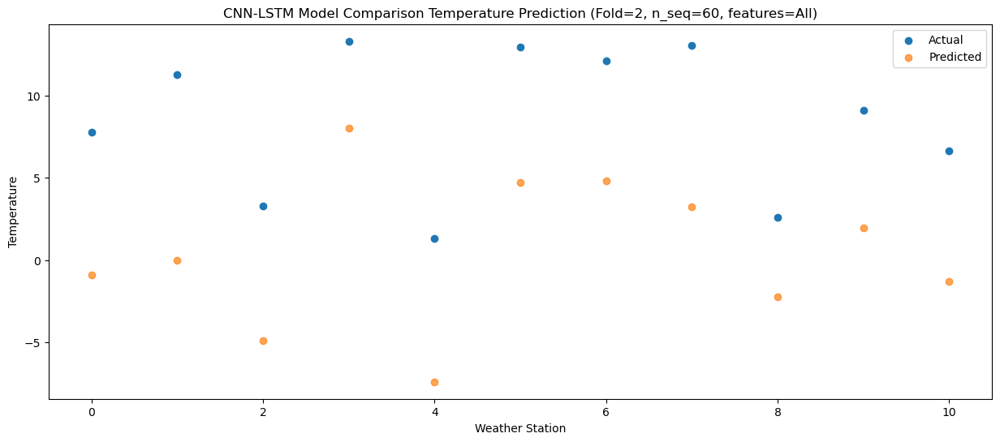

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   13.84   3.715237
1                 1   16.76   6.260355
2                 2    4.28  -3.491303
3                 3   16.95  11.359969
4                 4    5.35  -4.544004
5                 5   18.03   8.951525
6                 6   17.85   9.811912
7                 7   17.73   7.394973
8                 8    3.80   1.489247
9                 9   11.89   4.795235
10               10    9.99   1.945484


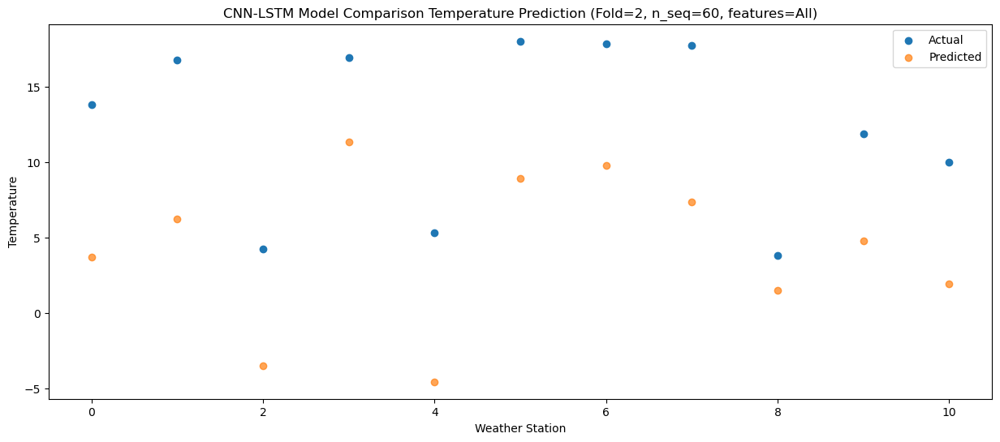

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   16.47   7.763986
1                 1   19.37   9.862497
2                 2    6.69  -1.052209
3                 3   20.74  14.723220
4                 4    9.00  -1.246862
5                 5   22.95  12.518624
6                 6   22.00  13.691046
7                 7   22.39   9.931450
8                 8    5.76   3.144719
9                 9   15.55   8.246899
10               10   12.90   5.594757


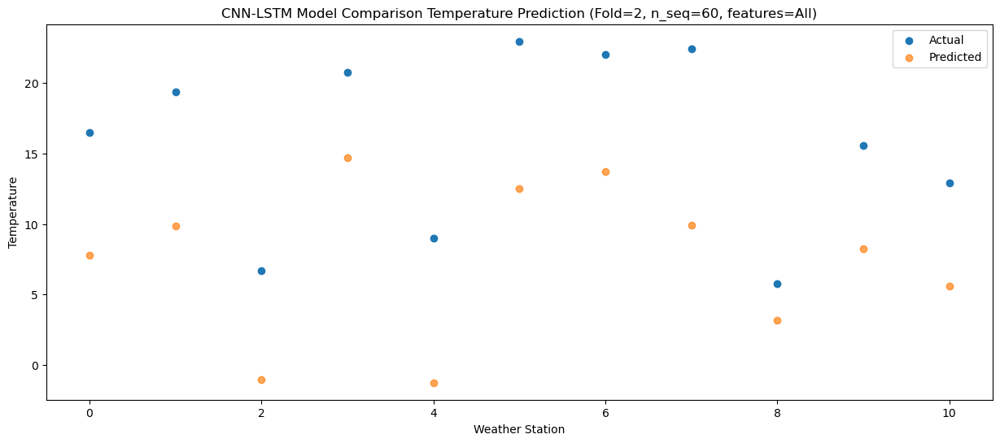

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   18.22  10.239335
1                 1   23.47  12.591219
2                 2    8.60   2.962727
3                 3   26.31  18.743431
4                 4   10.44   1.772772
5                 5   25.11  15.265110
6                 6   24.56  16.084686
7                 7   27.14  14.160257
8                 8   12.68   8.533709
9                 9   19.14  11.573905
10               10   16.45   8.818311


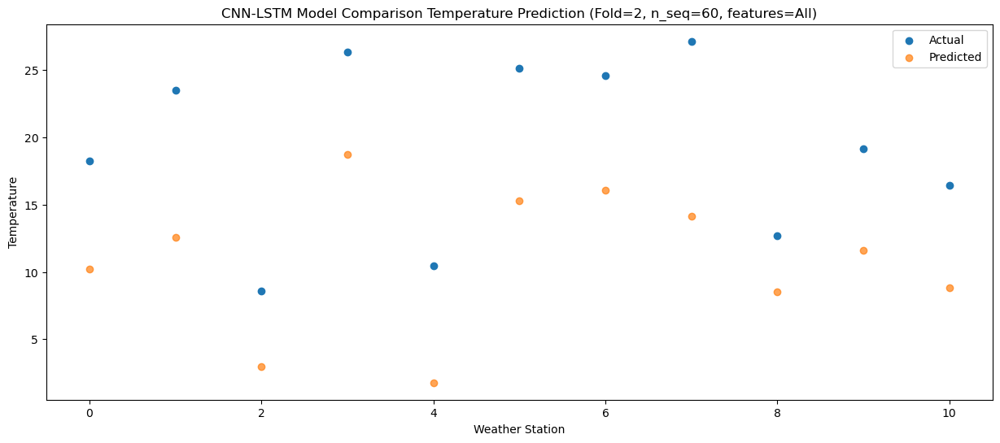

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   17.73  10.911242
1                 1   23.96  13.292914
2                 2    8.78   3.561975
3                 3   24.30  17.887690
4                 4   11.74   2.833217
5                 5   26.81  16.661699
6                 6   26.90  17.392914
7                 7   24.14  14.608769
8                 8   12.31   8.612240
9                 9   18.59  11.661356
10               10   15.74   8.772671


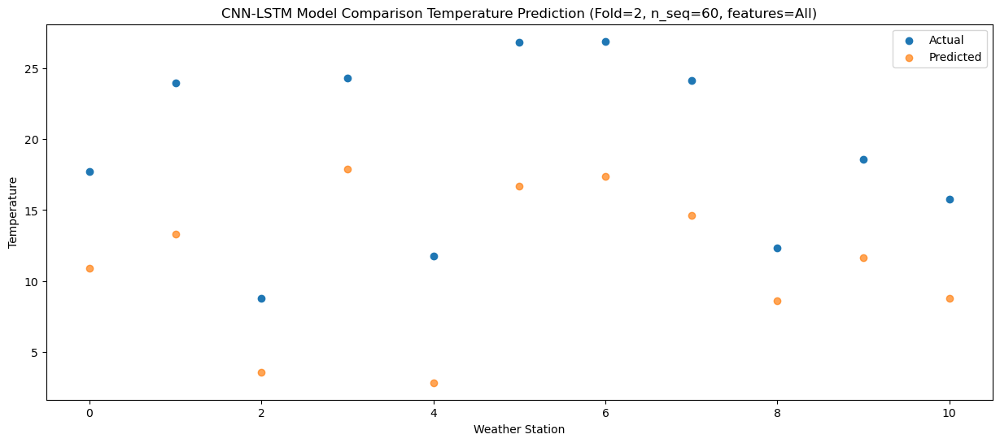

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   14.44   7.359714
1                 1   21.09   9.384022
2                 2    6.83  -0.131067
3                 3   21.88  14.767126
4                 4    7.31  -0.912245
5                 5   22.33  12.689022
6                 6   22.12  13.494754
7                 7   21.48  10.547957
8                 8    8.81   4.297737
9                 9   14.63   8.328004
10               10   12.96   5.496715


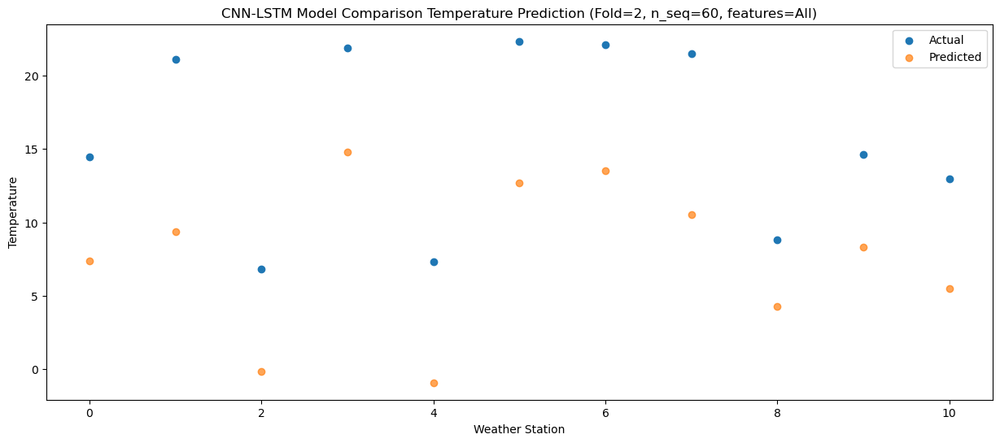

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    9.28  -0.019753
1                 1   12.05   1.180575
2                 2    3.25  -4.376915
3                 3   16.86   9.369256
4                 4    1.15  -6.839022
5                 5   14.44   5.575717
6                 6   13.40   5.720728
7                 7   14.74   4.580758
8                 8    7.22  -0.620310
9                 9    9.34   2.714071
10               10    6.91  -0.466463


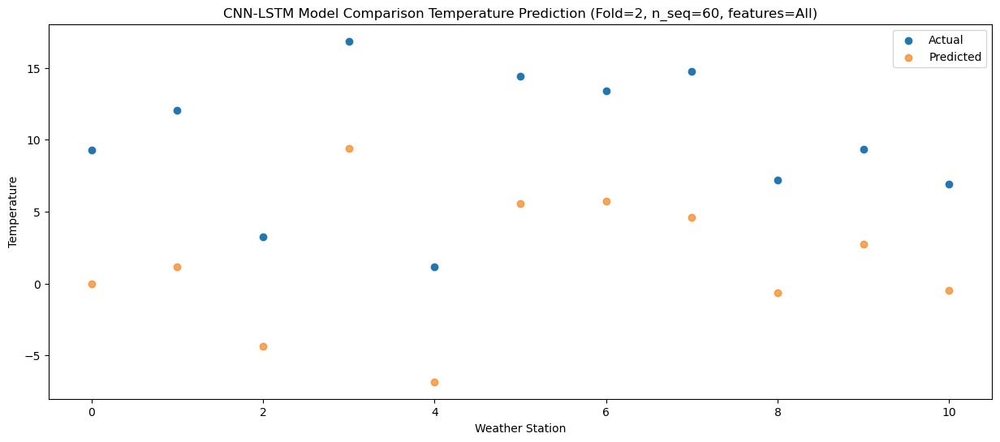

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    2.17  -6.500279
1                 1    5.33  -5.219382
2                 2   -0.73  -9.286020
3                 3    8.88   2.761816
4                 4   -3.96 -12.311660
5                 5    8.16  -0.174304
6                 6    8.06  -0.390560
7                 7    7.63  -0.932038
8                 8    2.83  -5.724787
9                 9    3.44  -3.343916
10               10    0.70  -6.806650


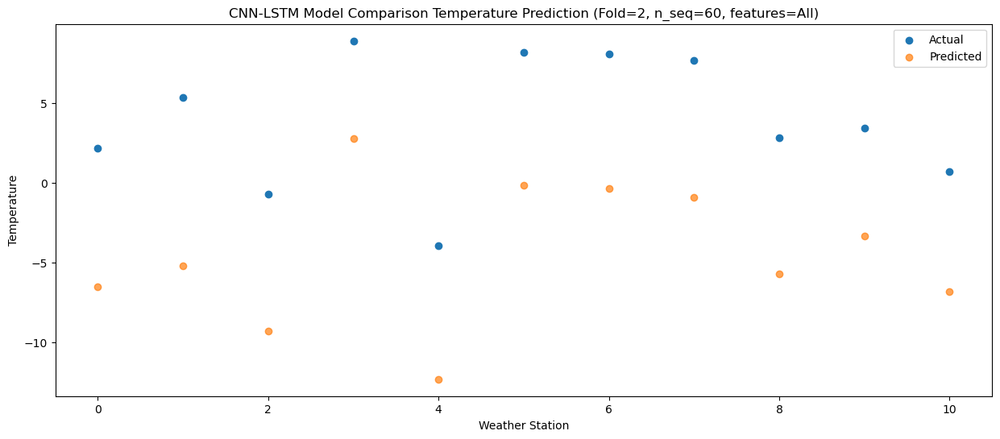

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.89  -9.489480
1                 1    1.66  -8.405672
2                 2   -2.66 -11.803419
3                 3    8.14   0.891432
4                 4   -6.56 -15.334126
5                 5    6.05  -3.582363
6                 6    5.08  -3.839620
7                 7    2.59  -3.699020
8                 8    0.50  -8.161356
9                 9    0.97  -5.766739
10               10   -2.15  -9.203119


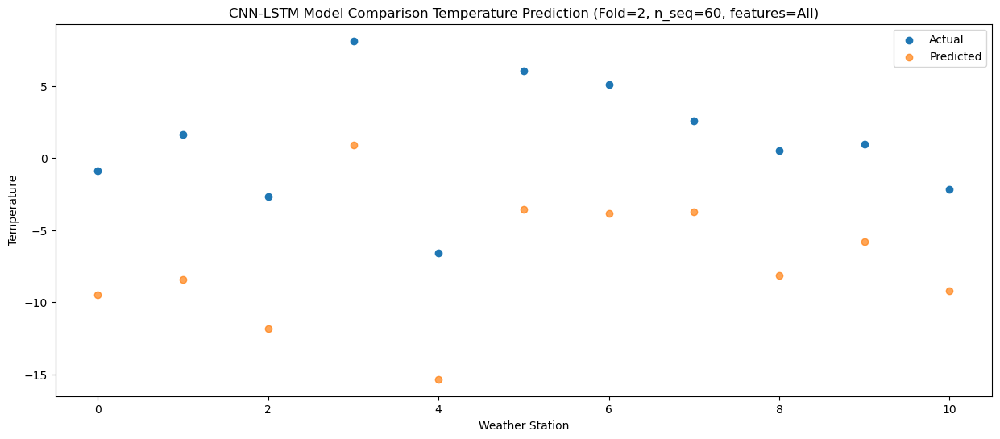

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -6.68 -14.900318
1                 1   -3.43 -14.045933
2                 2   -4.66 -12.210355
3                 3    3.97  -2.699661
4                 4   -8.64 -18.091154
5                 5    1.90  -7.725810
6                 6   -0.10  -9.069086
7                 7    2.26  -6.068340
8                 8   -1.30  -8.765838
9                 9   -0.88  -8.934391
10               10   -5.47 -13.053270


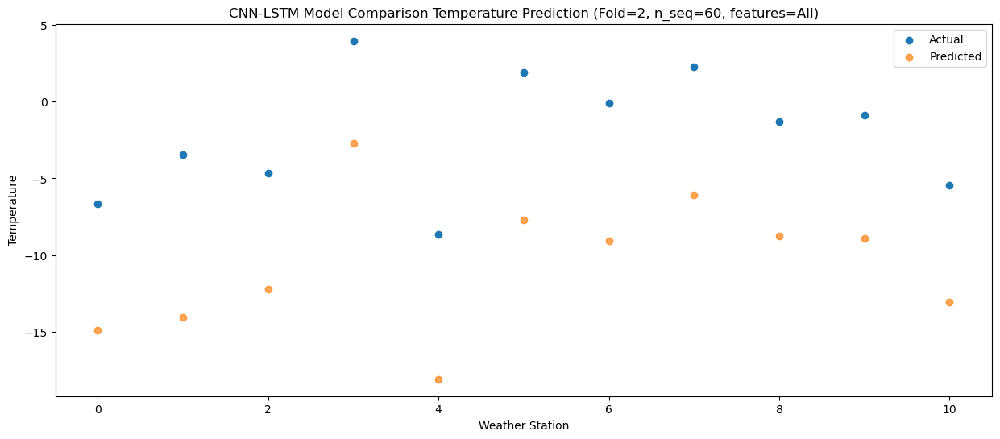

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    1.64  -8.599421
1                 1    4.05  -7.278703
2                 2   -4.18 -11.527764
3                 3    4.65  -0.461948
4                 4   -4.48 -14.177696
5                 5    8.66  -1.728345
6                 6    8.16  -2.019941
7                 7    5.47  -3.015469
8                 8   -0.77  -8.027707
9                 9    2.34  -5.866562
10               10   -0.93  -9.408370


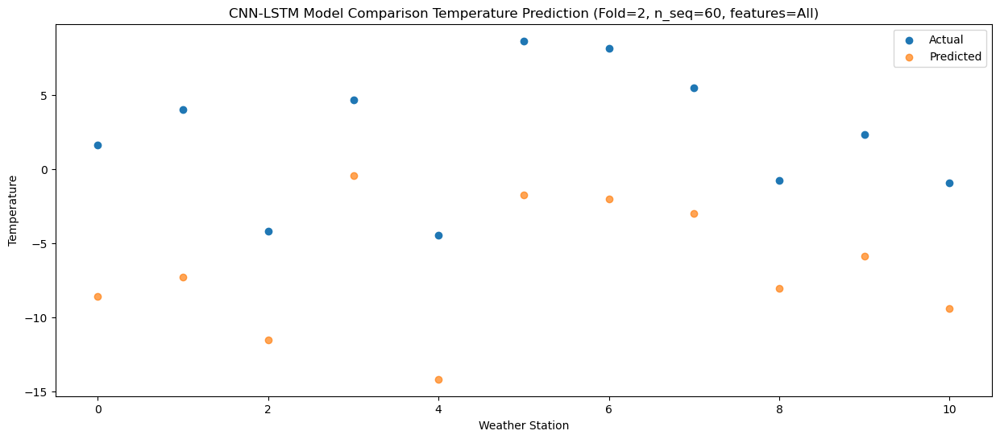

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    4.53  -5.968627
1                 1    6.82  -5.327380
2                 2    0.24  -8.370783
3                 3    9.05   2.725335
4                 4   -1.81 -11.292199
5                 5   11.03   0.684291
6                 6   10.51   0.290416
7                 7    8.04  -0.734217
8                 8    0.17  -5.882871
9                 9    5.90  -2.703967
10               10    3.24  -6.303858


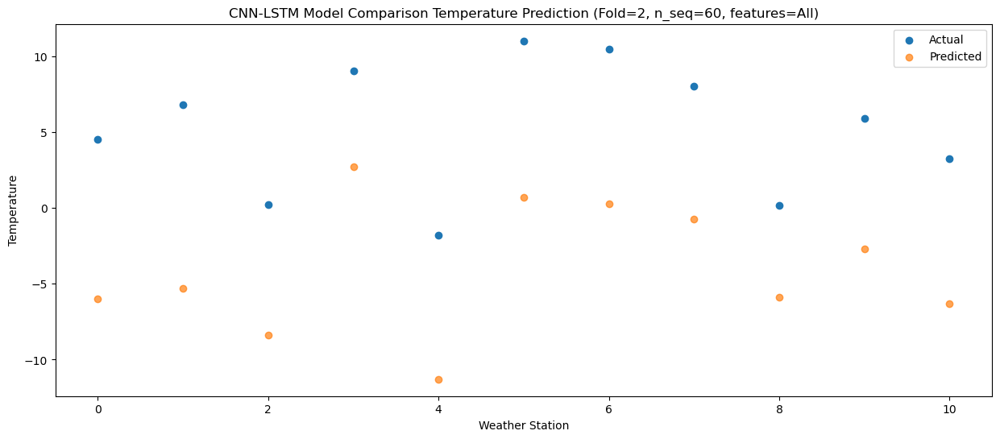

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    9.29  -2.028048
1                 1   12.23  -0.932642
2                 2    1.63  -6.723682
3                 3   11.48   6.218324
4                 4    1.85  -8.685628
5                 5   14.77   3.902038
6                 6   13.96   4.042498
7                 7   12.45   2.195109
8                 8    2.28  -3.542953
9                 9    9.96   0.351474
10               10    7.22  -2.903686


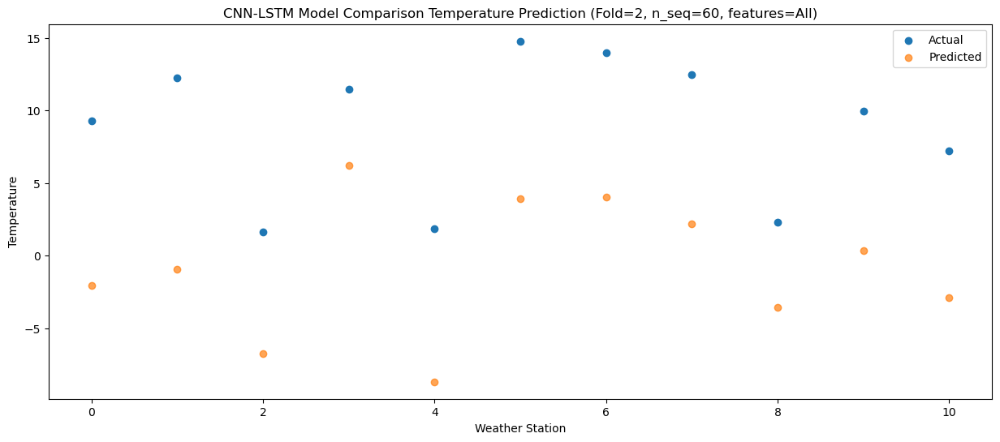

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   14.22   2.641823
1                 1   16.84   3.453621
2                 2    6.48  -3.533827
3                 3   17.27  11.051109
4                 4    6.90  -4.964364
5                 5   18.47   7.671144
6                 6   18.85   8.196212
7                 7   18.27   5.563496
8                 8    4.08  -0.818929
9                 9   14.34   4.738523
10               10   11.68   1.743427


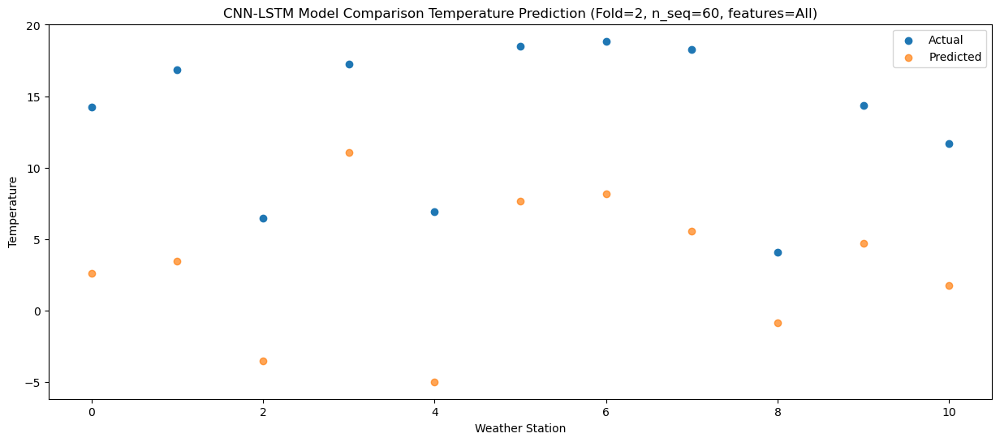

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   17.30   6.320919
1                 1   23.01   8.202520
2                 2    7.39  -1.344183
3                 3   23.24  14.904860
4                 4    8.73  -2.311055
5                 5   21.70  10.999253
6                 6   22.35  11.881933
7                 7   24.69   9.585159
8                 8    8.76   3.390764
9                 9   18.22   7.805724
10               10   16.03   5.078329


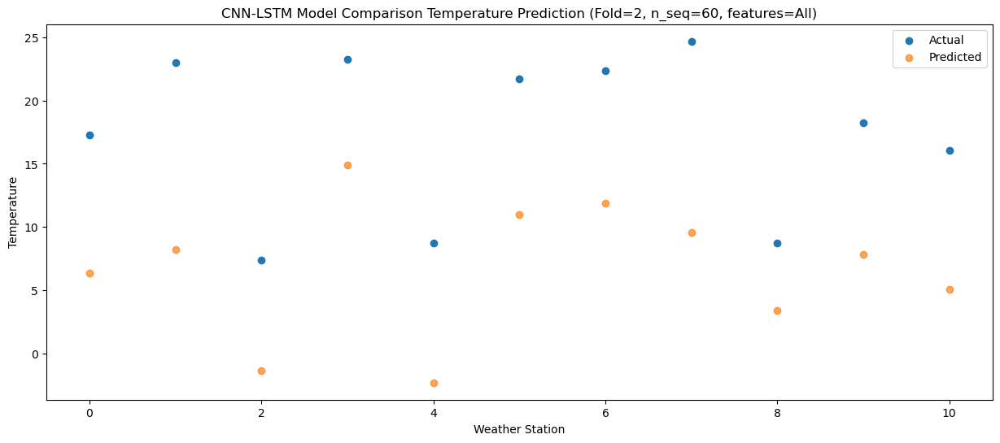

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   17.79   7.487409
1                 1   23.56  10.163885
2                 2    8.23   0.805253
3                 3   26.02  17.341250
4                 4    9.34  -0.927447
5                 5   20.18  12.295410
6                 6   22.66  12.999851
7                 7   24.16  12.434803
8                 8   12.49   7.332915
9                 9   19.61   9.509184
10               10   17.26   6.741061


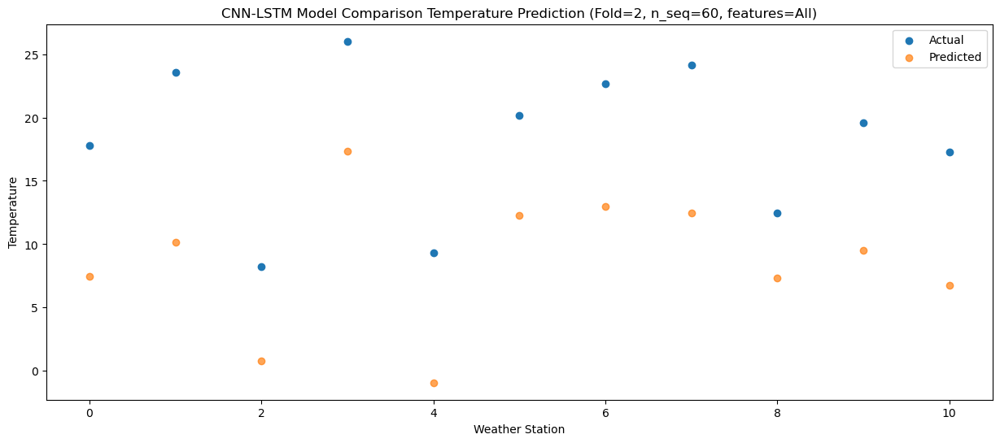

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   18.02   7.954805
1                 1   23.61  10.398166
2                 2    8.19   0.127536
3                 3   24.31  15.931332
4                 4    9.69  -0.615978
5                 5   21.83  13.112091
6                 6   24.46  13.945263
7                 7   24.55  11.816252
8                 8   12.07   5.811895
9                 9   17.59   9.049989
10               10   15.64   6.298416


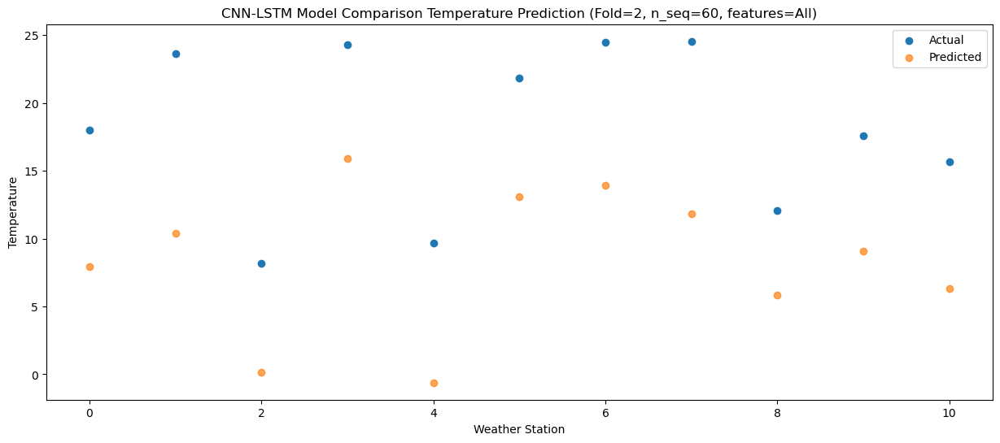

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   14.04   3.258256
1                 1   19.88   5.743583
2                 2    7.87  -3.518096
3                 3   20.79  12.244369
4                 4    6.89  -4.970125
5                 5   19.10   8.225117
6                 6   20.23   8.931352
7                 7   20.52   7.687730
8                 8   10.22   2.160447
9                 9   14.63   5.049355
10               10   13.05   2.206089


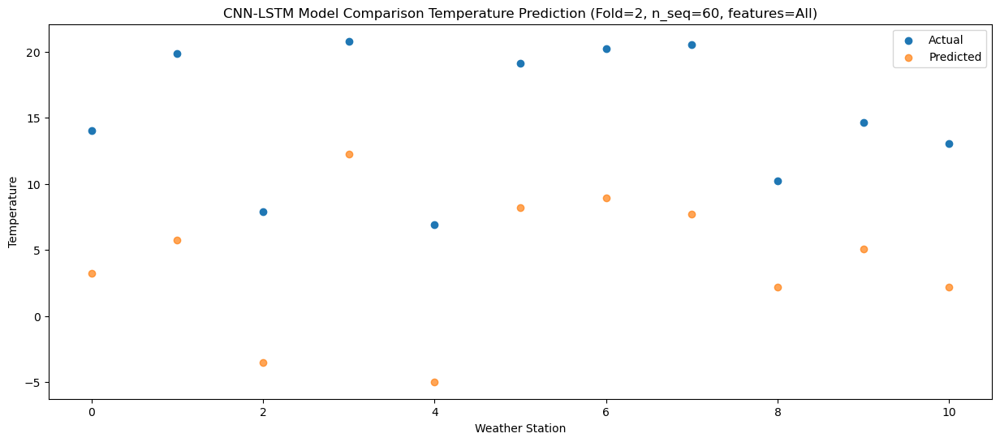

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    9.77  -0.749042
1                 1   14.91   1.169335
2                 2    4.40  -6.352892
3                 3   15.53   7.456728
4                 4    2.20  -7.955793
5                 5   16.45   5.176623
6                 6   17.26   5.464384
7                 7   16.26   3.926785
8                 8    7.23  -1.677445
9                 9    9.41   1.138864
10               10    6.63  -1.978472


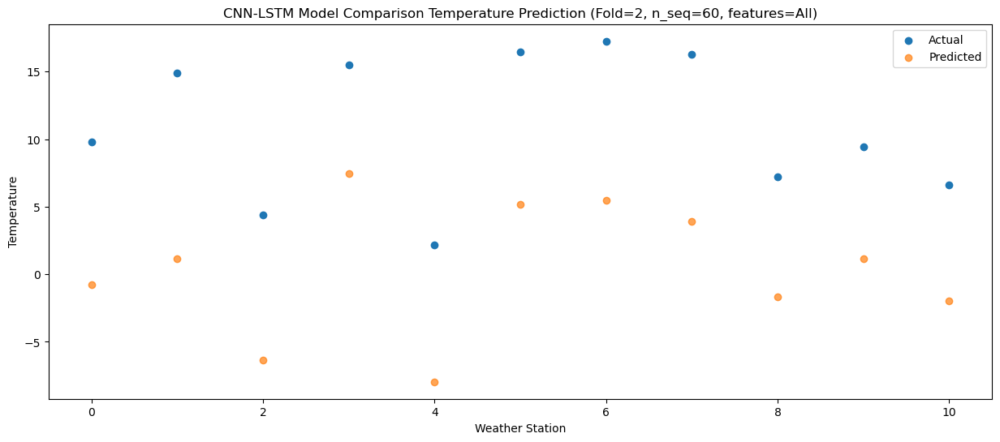

f, t:
[[-6.500e-01  3.410e+00 -1.000e-01  9.240e+00 -6.250e+00  7.270e+00
   6.650e+00  6.030e+00  2.170e+00  2.040e+00 -1.920e+00]
 [-3.100e-01  1.130e+00 -1.220e+00  6.180e+00 -5.900e+00  5.840e+00
   4.840e+00  1.500e+00 -1.370e+00  1.630e+00 -1.320e+00]
 [-9.000e-01  8.900e-01 -2.370e+00  6.450e+00 -5.560e+00  6.210e+00
   5.190e+00  2.750e+00 -8.300e-01  1.340e+00 -1.760e+00]
 [-1.090e+00  1.600e-01 -1.330e+00  6.600e+00 -4.920e+00  5.450e+00
   4.630e+00  3.560e+00  1.280e+00  2.380e+00 -1.960e+00]
 [ 5.500e+00  8.170e+00  2.290e+00  1.015e+01  1.770e+00  1.354e+01
   1.228e+01  8.060e+00  1.350e+00  7.610e+00  4.080e+00]
 [ 6.980e+00  1.040e+01  3.680e+00  1.138e+01  1.240e+00  1.351e+01
   1.259e+01  1.304e+01  4.560e+00  8.910e+00  4.510e+00]
 [ 1.227e+01  1.720e+01  4.990e+00  1.727e+01  4.210e+00  1.735e+01
   1.749e+01  1.933e+01  8.610e+00  1.151e+01  8.550e+00]
 [ 1.727e+01  2.440e+01  7.580e+00  2.333e+01  7.250e+00  2.096e+01
   2.223e+01  2.285e+01  9.900e+00  1.680e+0

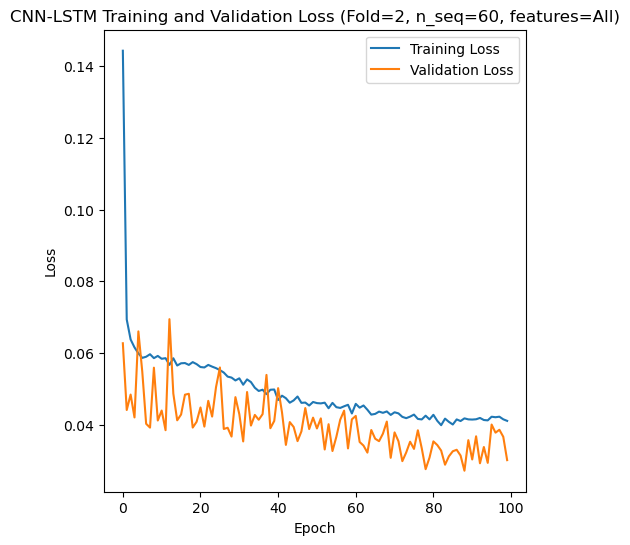

[[ 8.9   6.89 11.3  ... 22.19 16.88 13.54]
 [ 7.02  3.15 10.24 ... 22.31 18.92 11.32]
 [ 7.65  9.7   9.44 ... 25.68 20.65 11.46]
 ...
 [ 9.57 11.93 12.22 ... 30.9  25.01 12.37]
 [ 9.04  9.3   8.59 ... 17.72 17.26 10.73]
 [ 3.2   0.4   3.78 ... 18.92 14.39 10.04]]
Epoch 1/100
84/84 [==============================] - 35s 175ms/step - loss: 0.1351 - accuracy: 0.3214 - mae: 0.1165 - rmse: 0.1351 - mape: 25.4944 - pearson: 0.6485 - val_loss: 0.0751 - val_accuracy: 0.1000 - val_mae: 0.0597 - val_rmse: 0.0751 - val_mape: 12.9024 - val_pearson: 0.7762
Epoch 2/100
84/84 [==============================] - 10s 113ms/step - loss: 0.0665 - accuracy: 0.5000 - mae: 0.0527 - rmse: 0.0665 - mape: 12.4090 - pearson: 0.8281 - val_loss: 0.0730 - val_accuracy: 0.5000 - val_mae: 0.0573 - val_rmse: 0.0730 - val_mape: 12.9162 - val_pearson: 0.7833
Epoch 3/100
84/84 [==============================] - 9s 112ms/step - loss: 0.0609 - accuracy: 0.5357 - mae: 0.0487 - rmse: 0.0609 - mape: 11.4556 - pearson: 0.8499 

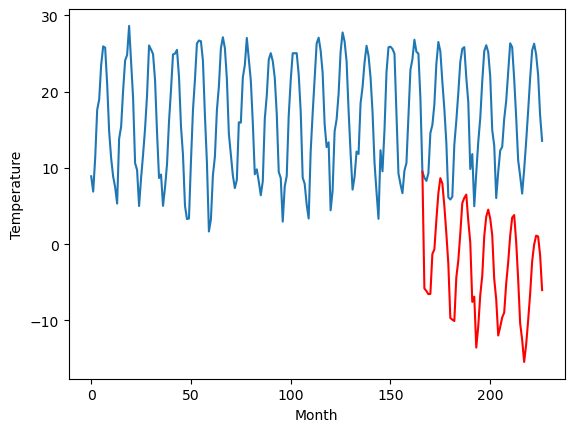

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.22		0.83		-1.39
0.87		0.13		-0.74
0.03		-0.60		-0.63
0.18		-0.89		-1.07
7.67		6.26		-1.41
8.59		7.17		-1.42
12.99		12.02		-0.97
20.09		16.86		-3.23
21.95		18.15		-3.80
20.09		17.14		-2.95
16.42		12.81		-3.61
9.31		7.28		-2.03
6.49		4.12		-2.37
-0.06		-3.11		-3.05
-1.21		-3.41		-2.20
-4.93		-6.71		-1.78
7.04		3.56		-3.48
8.90		5.26		-3.64
13.12		9.23		-3.89
19.83		14.58		-5.25
21.14		15.36		-5.78
21.71		15.73		-5.98
18.98		12.61		-6.37
12.38		8.08		-4.30
4.67		0.26		-4.41
5.98		0.73		-5.25
-2.85		-7.28		-4.43
-1.63		-5.99		-4.36
5.15		0.11		-5.04
10.00		4.49		-5.51
15.43		10.09		-5.34
20.58		13.76		-6.82
24.62		15.45		-9.17
21.54		12.99		-8.55
17.68		10.57		-7.11
11.13		3.94		-7.19
3.90		-1.98		-5.88
-0.15		-5.90		-5.75
0.55		-5.01		-5.56
2.51		-4.08		-6.59
5.11		-1.96		-7.07
10.16		2.21		-7.95
15.47		7.31		-8.16
19.80		11.45		-8.35
22.06		13.05		-9.01
22.24		14.29		-7.95
18.19		10.35		-7.84

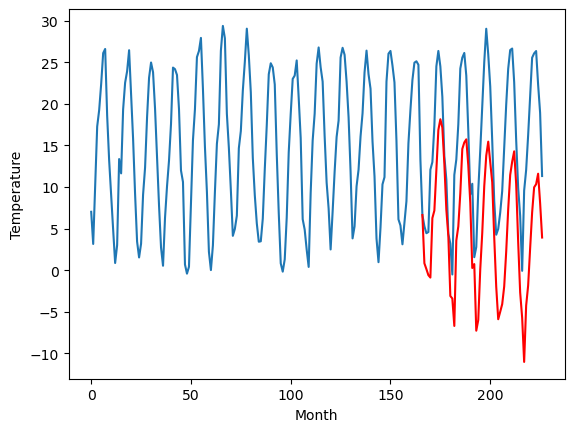

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.71		2.77		0.06
0.18		0.67		0.49
-1.04		1.19		2.23
1.38		1.39		0.01
3.17		4.99		1.82
7.83		7.09		-0.74
13.02		11.03		-1.99
16.37		12.89		-3.48
19.15		14.88		-4.27
19.68		16.12		-3.56
15.35		12.12		-3.23
9.86		8.23		-1.63
1.21		3.21		2.00
-1.99		-1.90		0.09
-0.73		-0.75		-0.02
1.57		-0.04		-1.61
2.72		1.91		-0.81
8.45		5.02		-3.43
13.25		8.57		-4.68
18.10		13.50		-4.60
21.23		14.60		-6.63
19.03		13.50		-5.53
15.72		10.52		-5.20
7.06		5.62		-1.44
2.72		2.14		-0.58
-1.20		-1.47		-0.27
-1.53		-3.40		-1.87
0.17		-2.87		-3.04
4.88		0.75		-4.13
7.95		2.97		-4.98
12.19		5.76		-6.43
17.58		9.14		-8.44
20.15		11.94		-8.21
20.33		11.49		-8.84
17.51		9.50		-8.01
10.33		3.79		-6.54
-0.40		-2.92		-2.52
-1.36		-5.51		-4.15
0.03		-4.95		-4.98
-0.82		-4.92		-4.10
2.05		-2.80		-4.85
7.68		0.46		-7.22
12.12		4.73		-7.39
14.92		6.98		-7.94
20.58		10.90		-9.68
18.89		11.61		-7.28
15.12		7.41		-7.71
9.81		1.74		-

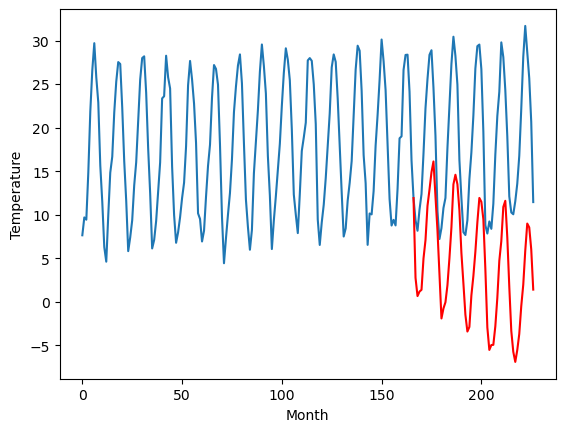

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.86		-1.93		0.93
-2.85		-2.62		0.23
-3.40		-3.21		0.19
-3.75		-3.55		0.20
3.16		2.22		-0.94
3.80		3.23		-0.57
8.37		8.28		-0.09
14.19		13.32		-0.87
17.99		15.55		-2.44
15.57		14.07		-1.50
11.51		10.36		-1.15
6.09		5.46		-0.63
2.17		1.77		-0.40
-5.03		-5.54		-0.51
-6.49		-6.52		-0.03
-7.81		-8.17		-0.36
2.40		-0.28		-2.68
4.75		2.43		-2.32
8.82		6.40		-2.42
14.74		11.66		-3.08
15.73		12.29		-3.44
16.25		12.95		-3.30
12.12		9.21		-2.91
8.54		5.80		-2.74
-1.12		-2.93		-1.81
0.37		-3.01		-3.38
-8.58		-10.79		-2.21
-4.06		-7.82		-3.76
1.69		-2.84		-4.53
4.70		0.40		-4.30
11.48		6.83		-4.65
14.96		9.94		-5.02
16.51		11.45		-5.06
15.44		10.00		-5.44
11.46		7.06		-4.40
4.19		0.80		-3.39
1.07		-2.74		-3.81
-4.20		-8.22		-4.02
-2.45		-6.98		-4.53
-0.11		-6.45		-6.34
0.13		-5.59		-5.72
6.37		-0.26		-6.63
9.06		3.28		-5.78
12.80		7.30		-5.50
16.42		9.82		-6.60
15.31		9.65		-5.66
12.58		6.32		-6.26
7.14

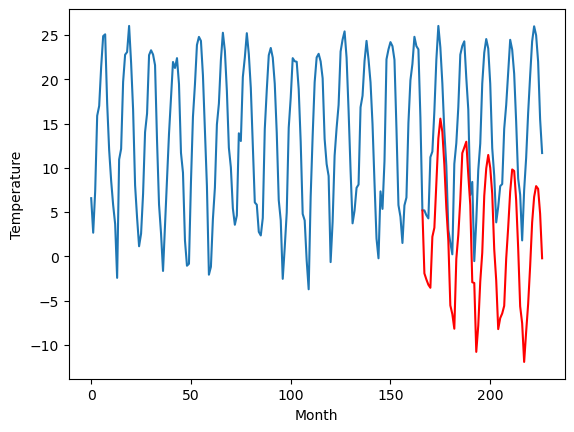

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.31		-2.57		-5.88
0.05		-3.22		-3.27
-2.82		-4.26		-1.44
-1.67		-4.63		-2.96
5.74		2.22		-3.52
8.77		3.46		-5.31
14.84		8.99		-5.85
21.89		14.84		-7.05
23.35		16.54		-6.81
20.79		14.86		-5.93
16.72		10.60		-6.12
8.99		4.54		-4.45
6.17		1.53		-4.64
-1.00		-6.01		-5.01
-2.47		-6.99		-4.52
-6.34		-10.55		-4.21
6.74		0.25		-6.49
10.03		2.62		-7.41
14.60		6.87		-7.73
22.08		12.85		-9.23
22.08		13.34		-8.74
22.20		13.95		-8.25
18.84		10.30		-8.54
13.42		6.07		-7.35
3.68		-2.81		-6.49
3.32		-3.23		-6.55
-6.15		-11.72		-5.57
-3.63		-9.43		-5.80
4.83		-3.25		-8.08
8.96		0.74		-8.22
16.53		7.69		-8.84
21.98		11.45		-10.53
23.10		13.02		-10.08
21.28		11.07		-10.21
16.96		8.09		-8.87
9.69		1.28		-8.41
3.80		-3.76		-7.56
-2.17		-9.27		-7.10
-0.45		-8.16		-7.71
6.07		-7.50		-13.57
3.11		-5.90		-9.01
10.32		-0.17		-10.49
16.32		4.71		-11.61
20.42		9.07		-11.35
22.12		10.74		-11.38
20.83		11.16		-9.67
17.47

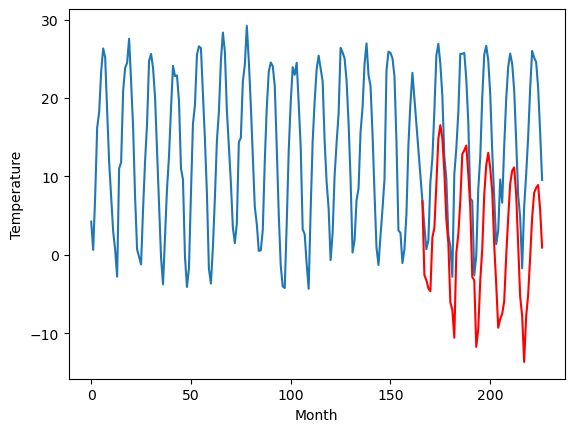

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-5.82		-5.35		0.47
-5.61		-5.96		-0.35
-7.03		-6.85		0.18
-7.44		-7.27		0.17
-0.58		-0.79		-0.21
1.69		0.30		-1.39
7.10		5.68		-1.42
14.09		11.34		-2.75
15.98		13.29		-2.69
13.47		11.54		-1.93
9.84		7.53		-2.31
3.84		1.92		-1.92
-0.10		-1.34		-1.24
-7.71		-8.87		-1.16
-9.16		-9.97		-0.81
-11.88		-12.80		-0.92
-0.55		-3.00		-2.45
2.90		-0.49		-3.39
7.18		3.65		-3.53
13.89		9.36		-4.53
14.27		9.89		-4.38
14.59		10.61		-3.98
11.33		6.89		-4.44
6.75		3.09		-3.66
-4.10		-5.98		-1.88
-3.05		-6.05		-3.00
-11.87		-14.53		-2.66
-8.68		-11.83		-3.15
-1.72		-6.11		-4.39
2.13		-2.37		-4.50
9.93		4.52		-5.41
13.87		7.96		-5.91
15.86		9.46		-6.40
14.21		7.68		-6.53
10.26		4.65		-5.61
4.22		-1.93		-6.15
-2.33		-6.19		-3.86
-7.87		-11.78		-3.91
-5.73		-10.57		-4.84
-4.01		-9.99		-5.98
-3.11		-8.78		-5.67
3.12		-3.15		-6.27
8.53		1.12		-7.41
11.99		5.43		-6.56
15.25		7.43		-7.82
13.70		7.53		-6.17
10.24		4.18

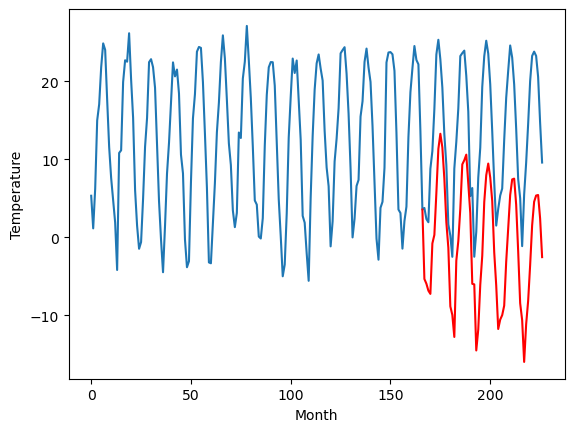

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.46		-0.25		6.21
-12.13		-1.97		10.16
-12.22		-1.88		10.34
-12.03		-1.87		10.16
-7.10		2.91		10.01
-4.12		4.67		8.79
2.99		9.09		6.10
7.20		12.15		4.95
9.19		14.00		4.81
9.94		14.42		4.48
4.44		10.18		5.74
0.70		5.57		4.87
-6.49		1.21		7.70
-12.19		-4.66		7.53
-11.92		-4.07		7.85
-11.82		-4.84		6.98
-8.85		0.13		8.98
-4.07		2.90		6.97
0.98		6.65		5.67
8.37		11.92		3.55
10.21		12.91		2.70
8.29		12.34		4.05
6.42		9.24		2.82
-1.55		4.39		5.94
-4.29		-0.63		3.66
-9.05		-3.05		6.00
-11.34		-7.11		4.23
-13.06		-6.27		6.79
-8.52		-1.73		6.79
-4.20		1.26		5.46
1.71		5.21		3.50
7.48		8.75		1.27
9.40		11.24		1.84
8.64		10.14		1.50
6.48		7.89		1.41
-1.78		1.79		3.57
-9.46		-4.75		4.71
-11.63		-7.94		3.69
-12.36		-7.24		5.12
-12.33		-7.01		5.32
-10.54		-4.88		5.66
-5.20		-1.02		4.18
2.01		3.63		1.62
6.59		6.56		-0.03
12.73		9.78		-2.95
10.14		10.59		0.45
5.99		6.54		0.55
-0.14		0.39		0.53
-6.00		-5.10	

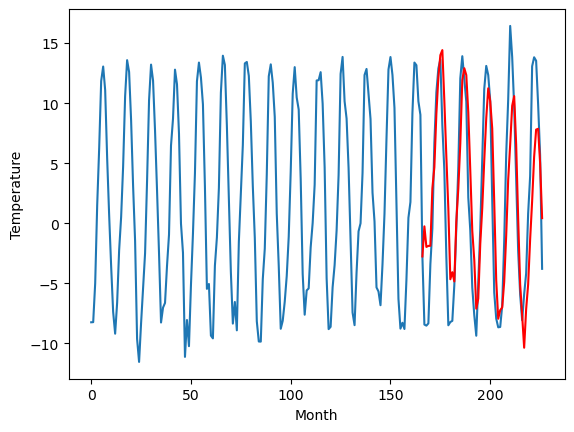

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-13.16		-12.54		0.62
-17.89		-14.68		3.21
-16.73		-14.28		2.45
-15.22		-14.16		1.06
-12.11		-10.05		2.06
-6.20		-7.90		-1.70
1.07		-3.62		-4.69
4.53		-1.24		-5.77
8.76		0.64		-8.12
8.87		1.67		-7.20
4.06		-2.67		-6.73
-2.88		-7.11		-4.23
-11.69		-11.85		-0.16
-17.38		-17.13		0.25
-16.83		-16.13		0.70
-13.98		-16.27		-2.29
-12.38		-12.95		-0.57
-4.41		-9.91		-5.50
0.02		-6.22		-6.24
7.66		-0.90		-8.56
8.74		0.19		-8.55
7.51		-0.82		-8.33
3.54		-3.80		-7.34
-6.81		-9.04		-2.23
-9.33		-12.78		-3.45
-16.60		-16.38		0.22
-16.67		-18.88		-2.21
-14.63		-18.55		-3.92
-9.92		-14.38		-4.46
-5.29		-11.70		-6.41
-0.62		-8.55		-7.93
5.86		-4.91		-10.77
8.09		-1.99		-10.08
6.50		-2.72		-9.22
4.14		-4.85		-8.99
-3.75		-10.82		-7.07
-15.17		-18.11		-2.94
-17.50		-20.74		-3.24
-18.01		-20.20		-2.19
-17.10		-20.23		-3.13
-14.27		-17.83		-3.56
-6.32		-14.24		-7.92
-0.52		-9.45		-8.93
1.98		-6.94		-8.92
10.34		-

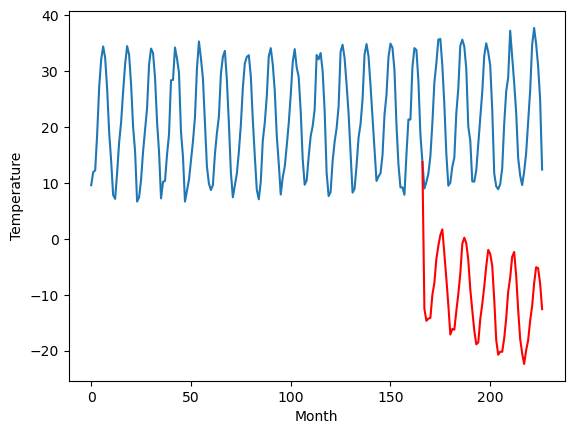

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.28		5.24		-0.04
4.03		3.42		-0.61
3.40		3.99		0.59
5.42		4.31		-1.11
4.86		7.68		2.82
8.48		9.49		1.01
10.88		12.83		1.95
13.42		14.02		0.60
12.61		15.94		3.33
14.49		17.41		2.92
13.91		13.88		-0.03
11.69		10.69		-1.00
4.53		5.52		0.99
2.48		0.45		-2.03
3.70		1.85		-1.85
4.63		3.33		-1.30
4.41		4.23		-0.18
6.60		7.07		0.47
10.89		10.38		-0.51
12.59		14.61		2.02
11.77		15.70		3.93
12.32		14.58		2.26
11.77		11.69		-0.08
9.01		7.26		-1.75
6.19		3.95		-2.24
2.49		1.03		-1.46
3.11		-0.67		-3.78
4.07		-0.04		-4.11
6.30		3.08		-3.22
7.74		4.96		-2.78
10.73		7.24		-3.49
13.88		10.26		-3.62
12.23		12.67		0.44
13.65		12.33		-1.32
13.88		10.68		-3.20
9.15		5.27		-3.88
3.42		-0.74		-4.16
2.22		-3.05		-5.27
3.89		-2.51		-6.40
2.09		-2.16		-4.25
3.55		-0.31		-3.86
7.63		2.19		-5.44
8.66		5.92		-2.74
10.56		7.97		-2.59
13.57		11.81		-1.76
14.60		12.65		-1.95
11.99		8.41		-3.58
10.53		3.09		-7.44
6.49		-1.

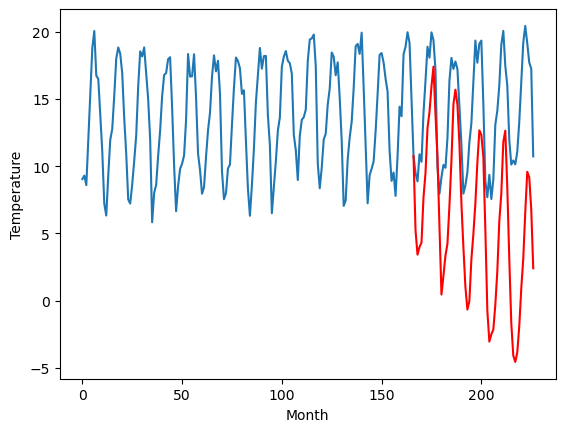

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.63		-0.55		-1.18
-2.13		-1.69		0.44
-2.10		-2.00		0.10
-1.66		-2.45		-0.79
1.92		2.40		0.48
3.36		3.77		0.41
8.92		9.14		0.22
15.90		14.25		-1.65
19.85		17.05		-2.80
18.67		15.53		-3.14
14.33		11.77		-2.56
9.01		6.94		-2.07
4.94		2.85		-2.09
-1.40		-4.20		-2.80
-4.42		-5.44		-1.02
-4.54		-6.33		-1.79
0.46		-0.02		-0.48
5.08		3.46		-1.62
9.91		7.47		-2.44
15.78		13.11		-2.67
17.92		13.75		-4.17
18.54		14.34		-4.20
15.22		10.34		-4.88
10.78		7.01		-3.77
1.86		-1.59		-3.45
0.26		-2.80		-3.06
-6.29		-9.84		-3.55
-3.53		-6.41		-2.88
0.43		-1.97		-2.40
4.72		0.83		-3.89
10.51		7.39		-3.12
14.83		10.41		-4.42
19.38		12.38		-7.00
19.30		11.46		-7.84
14.39		8.09		-6.30
8.13		1.97		-6.16
4.17		-1.25		-5.42
-2.19		-7.24		-5.05
-0.21		-5.88		-5.67
-1.94		-5.94		-4.00
0.03		-5.34		-5.37
6.08		0.73		-5.35
9.72		3.79		-5.93
13.71		7.63		-6.08
19.39		10.95		-8.44
17.14		10.06		-7.08
14.57		6.94		-7.63
9.1

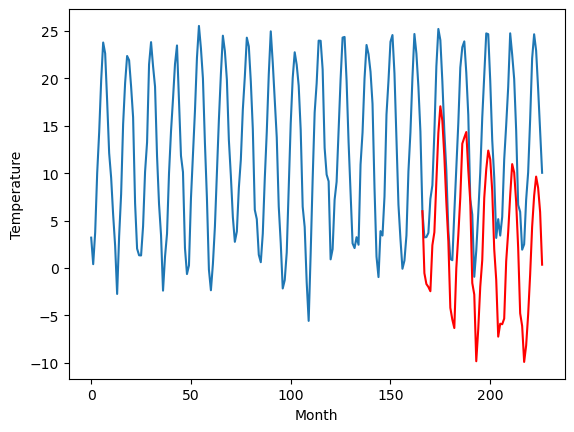

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.46		-6.69		-0.23
-9.42		-7.72		1.70
-9.01		-8.13		0.88
-8.09		-8.60		-0.51
-3.68		-3.52		0.16
-1.74		-2.23		-0.49
4.03		3.19		-0.84
10.75		8.51		-2.24
14.52		11.28		-3.24
12.65		9.60		-3.05
7.68		5.84		-1.84
2.19		0.91		-1.28
-2.09		-3.05		-0.96
-8.91		-10.26		-1.35
-10.47		-11.61		-1.14
-11.27		-12.75		-1.48
-4.08		-5.89		-1.81
0.79		-2.48		-3.27
5.05		1.55		-3.50
11.22		7.19		-4.03
12.86		7.80		-5.06
12.59		8.49		-4.10
8.33		4.47		-3.86
4.21		1.20		-3.01
-6.01		-7.74		-1.73
-6.42		-8.67		-2.25
-13.40		-16.14		-2.74
-9.59		-12.62		-3.03
-4.41		-8.02		-3.61
-0.59		-5.09		-4.50
6.19		1.70		-4.49
10.18		4.72		-5.46
13.96		6.59		-7.37
13.09		5.56		-7.53
7.86		2.17		-5.69
0.25		-4.02		-4.27
-2.87		-7.10		-4.23
-9.90		-13.24		-3.34
-7.25		-11.85		-4.60
-7.04		-11.83		-4.79
-5.48		-11.27		-5.79
2.09		-5.12		-7.21
4.56		-2.02		-6.58
8.49		1.95		-6.54
13.33		5.12		-8.21
11.36		4.24		-7.12
8.07		1

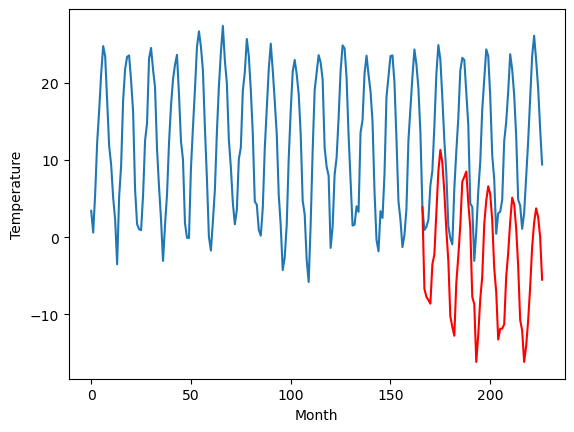

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -6.46  -5.811785
1                 1    2.22   0.826068
2                 2    2.71   2.768794
3                 3   -2.86  -1.925332
4                 4    3.31  -2.573609
5                 5   -5.82  -5.354161
6                 6   -6.46  -0.254584
7                 7  -13.16 -12.536699
8                 8    5.28   5.241418
9                 9    0.63  -0.548036
10               10   -6.46  -6.688984


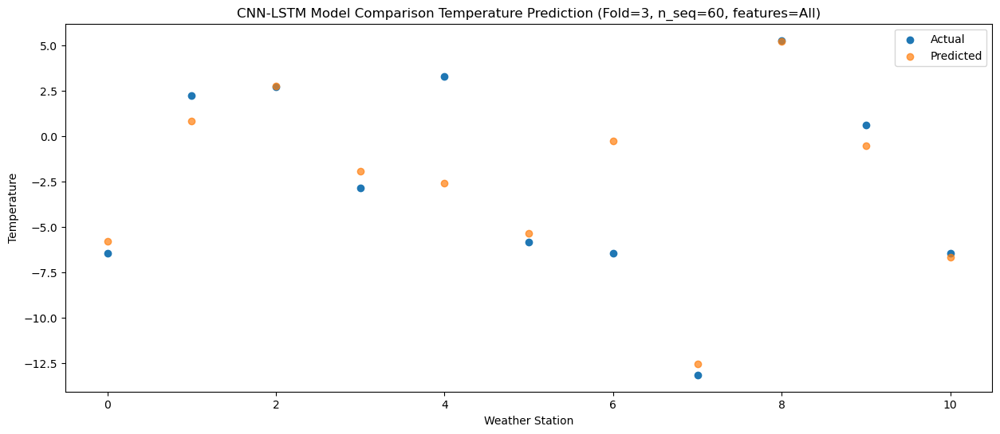

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -7.24  -6.138714
1                 1    0.87   0.131144
2                 2    0.18   0.671583
3                 3   -2.85  -2.615532
4                 4    0.05  -3.222214
5                 5   -5.61  -5.957622
6                 6  -12.13  -1.966948
7                 7  -17.89 -14.683109
8                 8    4.03   3.418700
9                 9   -2.13  -1.689773
10               10   -9.42  -7.718867


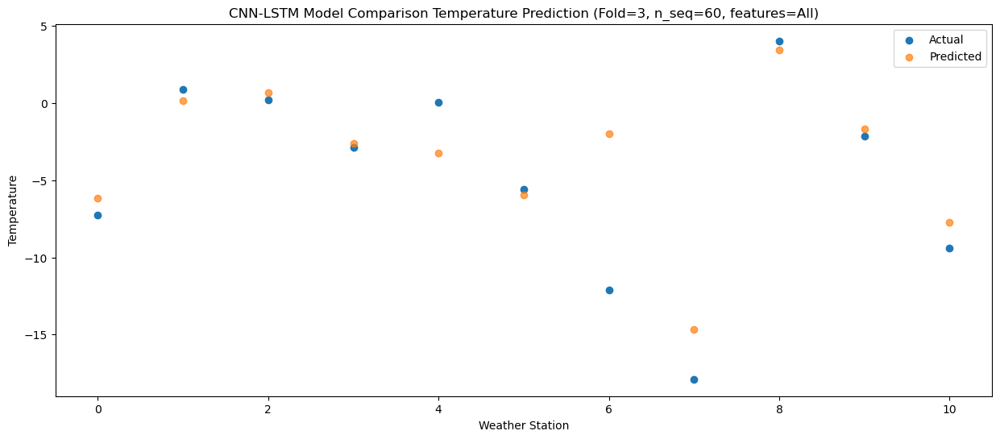

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -7.66  -6.557591
1                 1    0.03  -0.600531
2                 2   -1.04   1.191900
3                 3   -3.40  -3.206511
4                 4   -2.82  -4.262491
5                 5   -7.03  -6.851175
6                 6  -12.22  -1.879783
7                 7  -16.73 -14.280231
8                 8    3.40   3.989085
9                 9   -2.10  -2.001889
10               10   -9.01  -8.129363


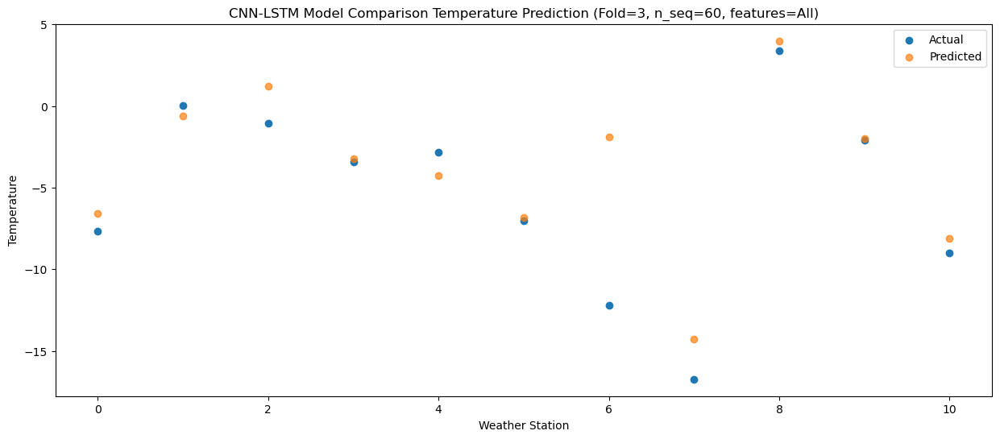

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -6.65  -6.521248
1                 1    0.18  -0.890660
2                 2    1.38   1.389298
3                 3   -3.75  -3.550838
4                 4   -1.67  -4.633390
5                 5   -7.44  -7.269705
6                 6  -12.03  -1.874309
7                 7  -15.22 -14.163973
8                 8    5.42   4.314289
9                 9   -1.66  -2.453623
10               10   -8.09  -8.604133


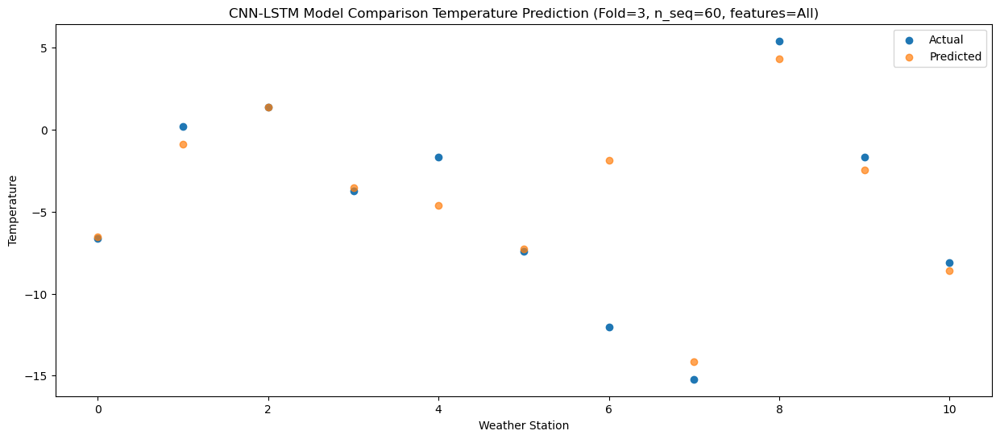

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0   -1.39  -1.290634
1                 1    7.67   6.259855
2                 2    3.17   4.985125
3                 3    3.16   2.215521
4                 4    5.74   2.223833
5                 5   -0.58  -0.789908
6                 6   -7.10   2.911189
7                 7  -12.11 -10.048707
8                 8    4.86   7.678055
9                 9    1.92   2.398748
10               10   -3.68  -3.515027


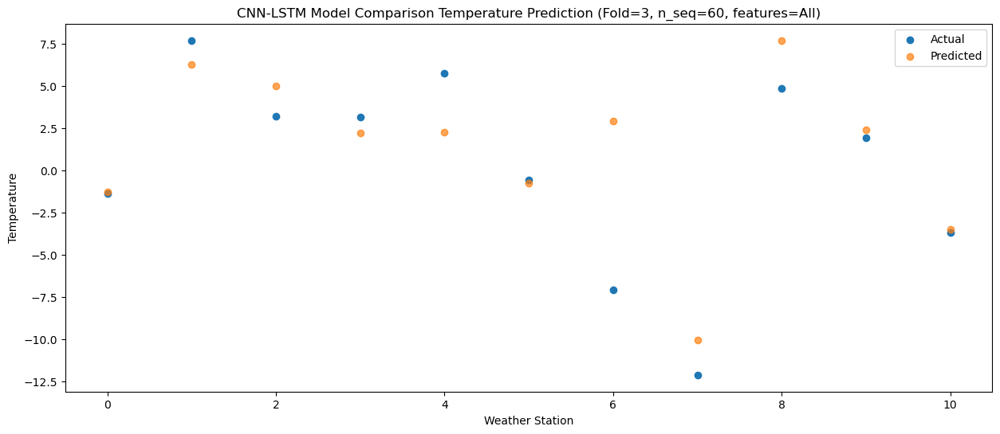

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   -0.32  -0.689295
1                 1    8.59   7.171600
2                 2    7.83   7.092054
3                 3    3.80   3.231138
4                 4    8.77   3.459600
5                 5    1.69   0.302892
6                 6   -4.12   4.673780
7                 7   -6.20  -7.896591
8                 8    8.48   9.491869
9                 9    3.36   3.770128
10               10   -1.74  -2.231585


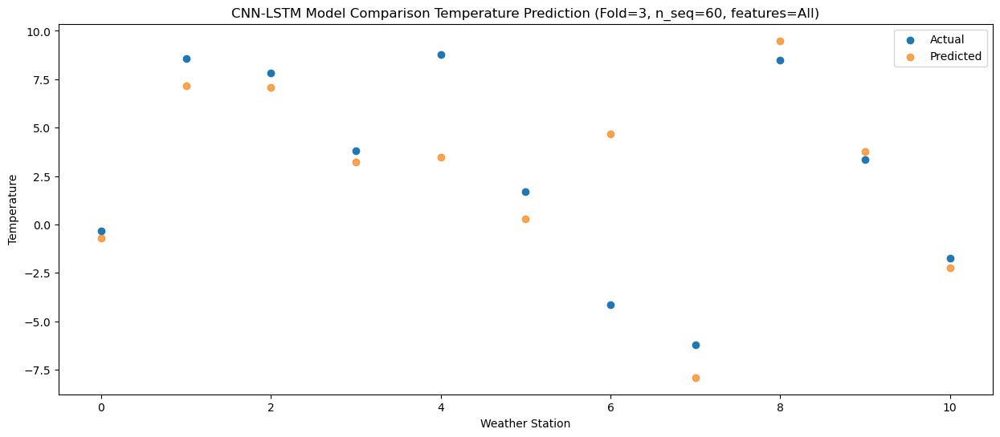

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    2.37   3.148767
1                 1   12.99  12.019119
2                 2   13.02  11.026966
3                 3    8.37   8.277126
4                 4   14.84   8.990556
5                 5    7.10   5.682887
6                 6    2.99   9.094100
7                 7    1.07  -3.615144
8                 8   10.88  12.827065
9                 9    8.92   9.136489
10               10    4.03   3.192442


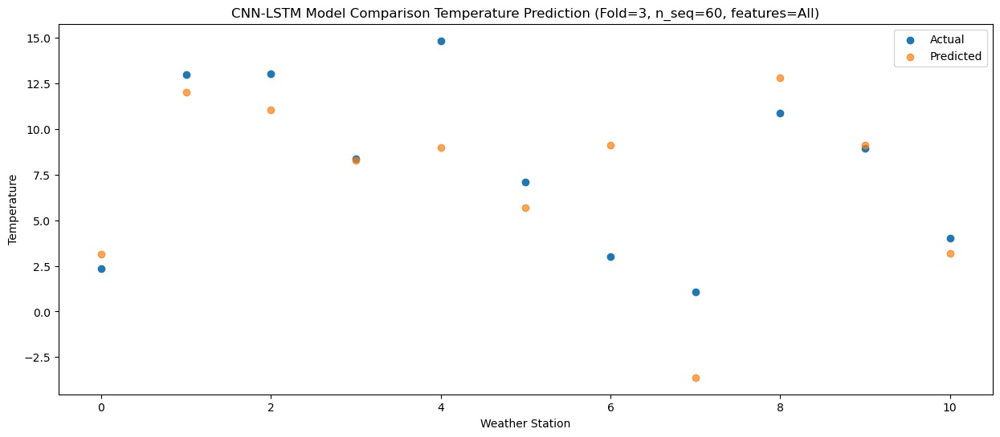

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    7.69   6.677613
1                 1   20.09  16.858867
2                 2   16.37  12.886652
3                 3   14.19  13.316822
4                 4   21.89  14.844981
5                 5   14.09  11.339610
6                 6    7.20  12.152649
7                 7    4.53  -1.242376
8                 8   13.42  14.017595
9                 9   15.90  14.245641
10               10   10.75   8.514453


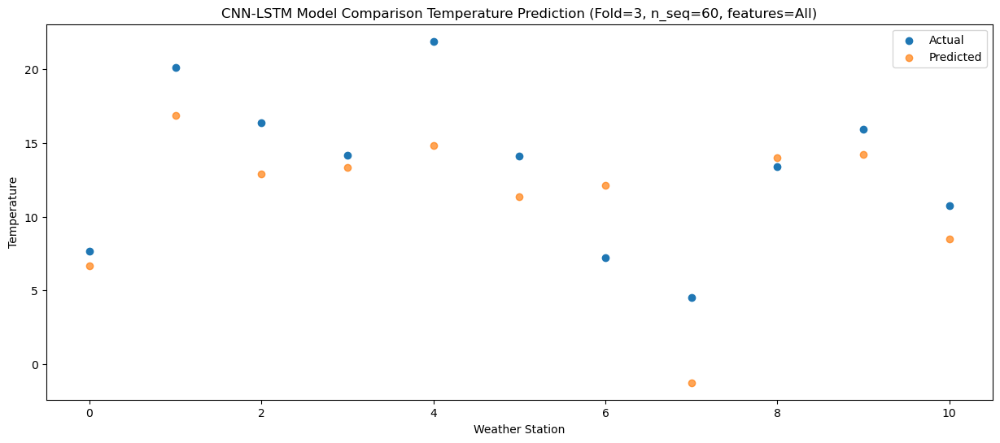

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   10.55   8.652177
1                 1   21.95  18.149224
2                 2   19.15  14.881000
3                 3   17.99  15.553845
4                 4   23.35  16.540556
5                 5   15.98  13.287011
6                 6    9.19  13.997499
7                 7    8.76   0.643089
8                 8   12.61  15.941441
9                 9   19.85  17.053110
10               10   14.52  11.283569


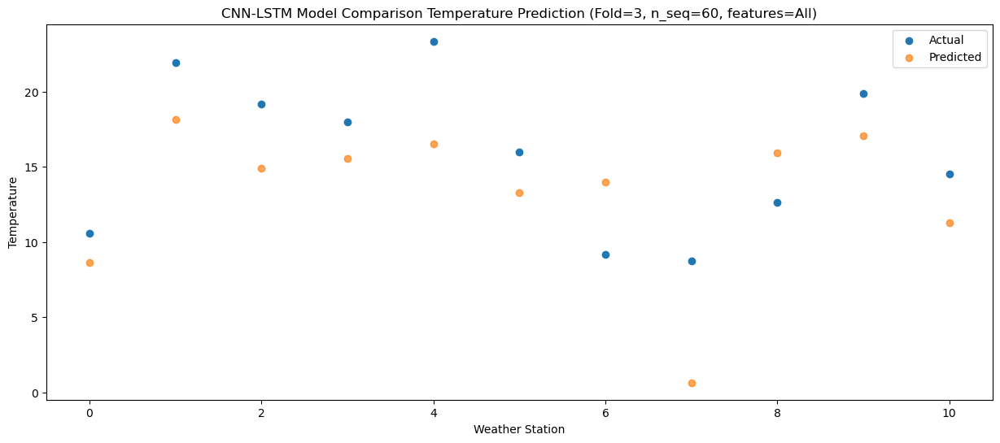

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0    9.32   7.924284
1                 1   20.09  17.143168
2                 2   19.68  16.121792
3                 3   15.57  14.071786
4                 4   20.79  14.860264
5                 5   13.47  11.535967
6                 6    9.94  14.418125
7                 7    8.87   1.674185
8                 8   14.49  17.410084
9                 9   18.67  15.533603
10               10   12.65   9.595553


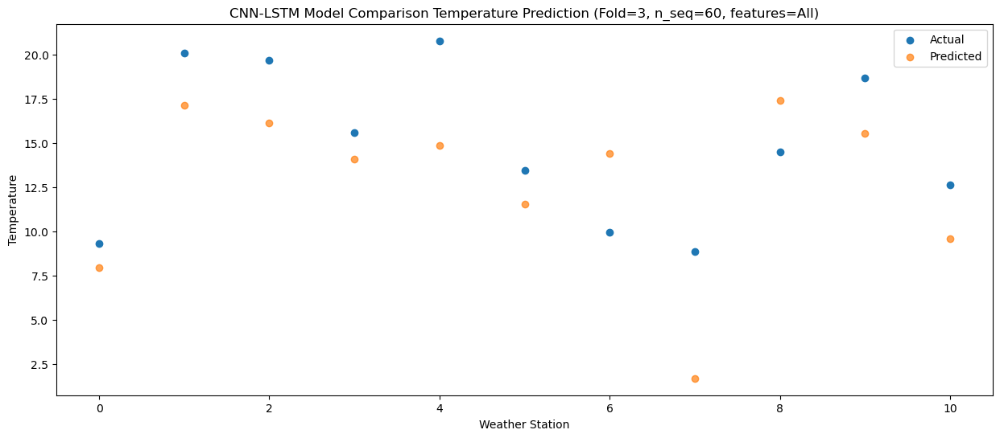

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    5.35   5.011452
1                 1   16.42  12.811830
2                 2   15.35  12.124454
3                 3   11.51  10.361399
4                 4   16.72  10.600760
5                 5    9.84   7.526588
6                 6    4.44  10.183925
7                 7    4.06  -2.667088
8                 8   13.91  13.875054
9                 9   14.33  11.772696
10               10    7.68   5.837372


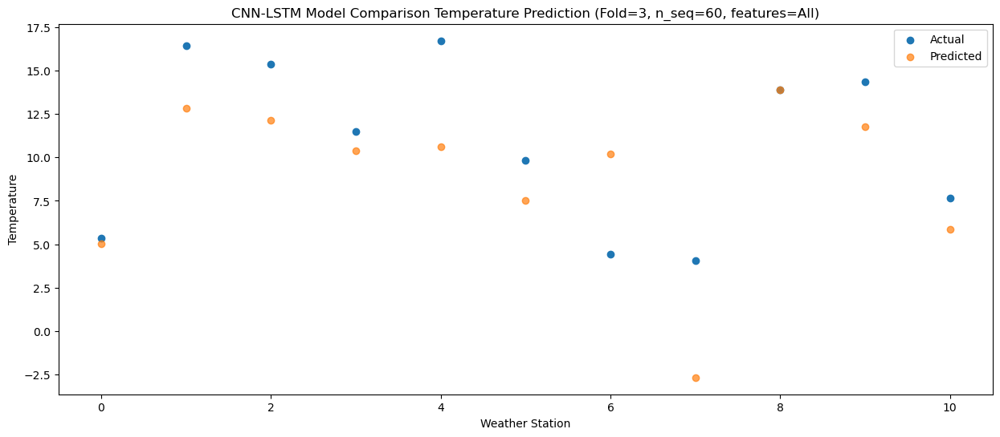

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    1.78   1.414839
1                 1    9.31   7.278478
2                 2    9.86   8.225923
3                 3    6.09   5.463336
4                 4    8.99   4.543509
5                 5    3.84   1.924885
6                 6    0.70   5.565492
7                 7   -2.88  -7.105611
8                 8   11.69  10.691655
9                 9    9.01   6.939646
10               10    2.19   0.912733


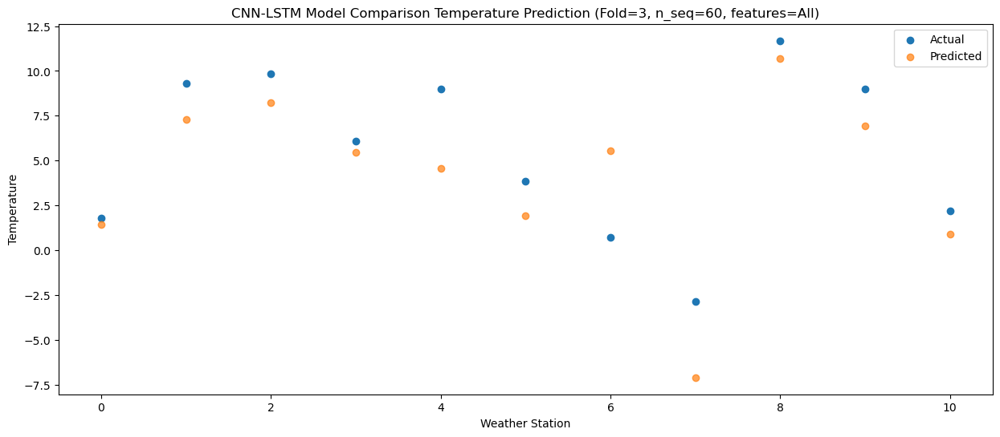

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0   -2.64  -2.585262
1                 1    6.49   4.117828
2                 2    1.21   3.213809
3                 3    2.17   1.771770
4                 4    6.17   1.532696
5                 5   -0.10  -1.341917
6                 6   -6.49   1.207363
7                 7  -11.69 -11.853233
8                 8    4.53   5.516569
9                 9    4.94   2.845878
10               10   -2.09  -3.054098


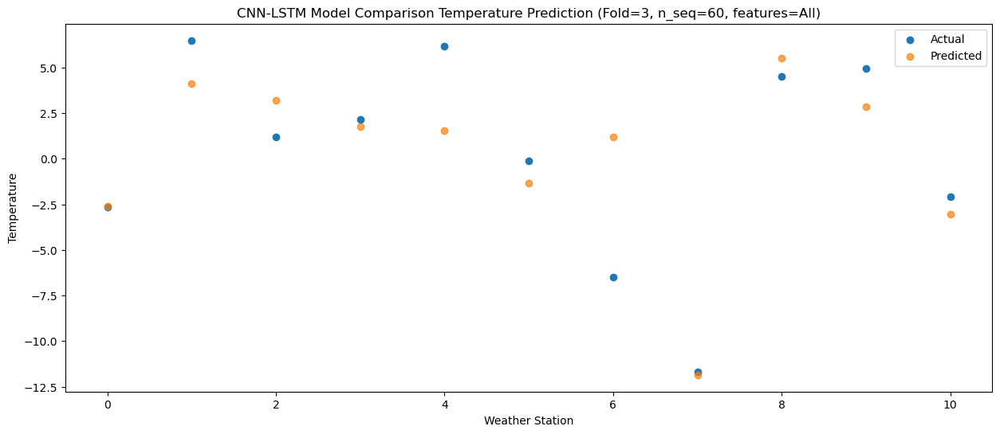

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -9.82  -9.686818
1                 1   -0.06  -3.105839
2                 2   -1.99  -1.896544
3                 3   -5.03  -5.544515
4                 4   -1.00  -6.010500
5                 5   -7.71  -8.871779
6                 6  -12.19  -4.658700
7                 7  -17.38 -17.132775
8                 8    2.48   0.450004
9                 9   -1.40  -4.199192
10               10   -8.91 -10.257232


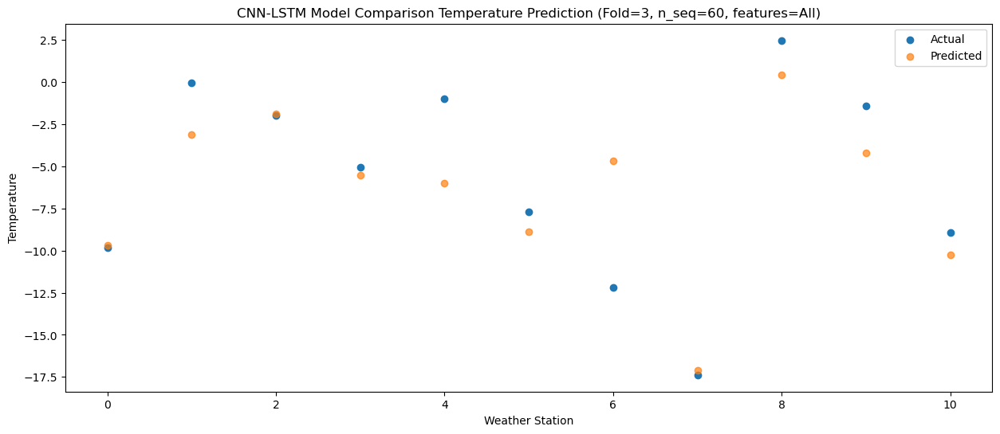

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0  -10.10  -9.897010
1                 1   -1.21  -3.406156
2                 2   -0.73  -0.748894
3                 3   -6.49  -6.518164
4                 4   -2.47  -6.990616
5                 5   -9.16  -9.968947
6                 6  -11.92  -4.069516
7                 7  -16.83 -16.132326
8                 8    3.70   1.852935
9                 9   -4.42  -5.441854
10               10  -10.47 -11.610874


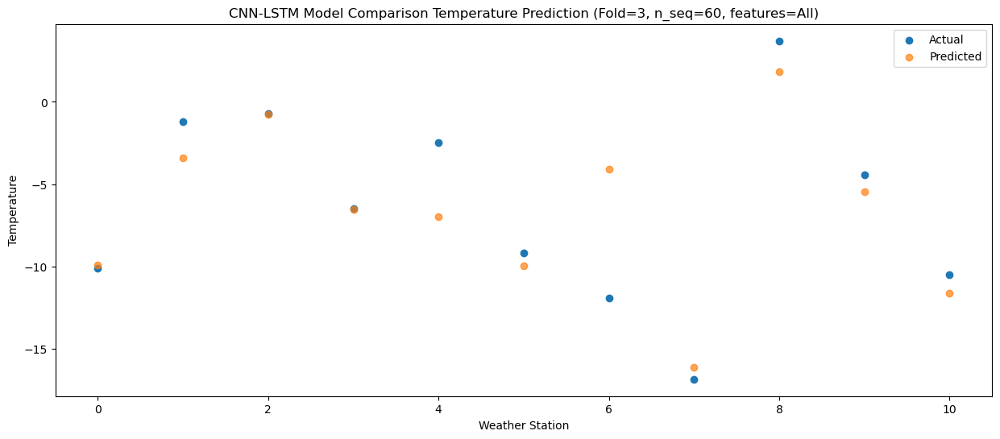

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -9.73 -10.079184
1                 1   -4.93  -6.708371
2                 2    1.57  -0.037757
3                 3   -7.81  -8.174246
4                 4   -6.34 -10.548227
5                 5  -11.88 -12.797504
6                 6  -11.82  -4.838815
7                 7  -13.98 -16.269555
8                 8    4.63   3.333499
9                 9   -4.54  -6.333774
10               10  -11.27 -12.753582


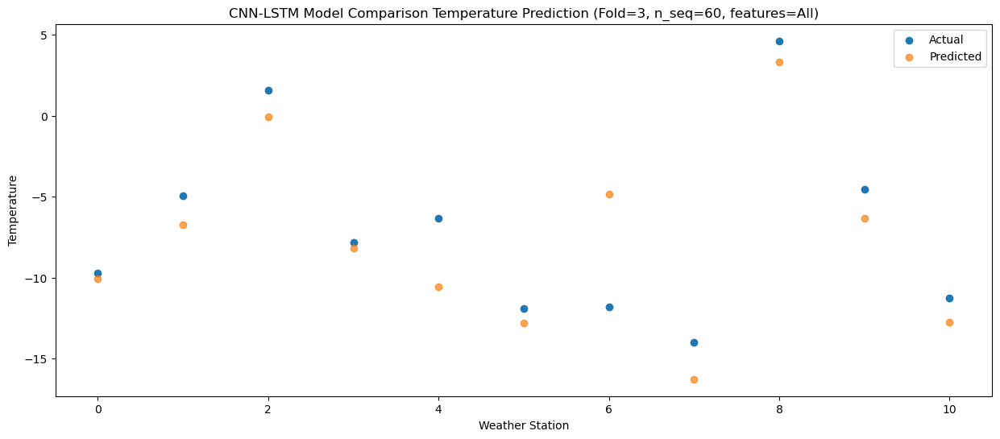

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0   -2.93  -4.354781
1                 1    7.04   3.562072
2                 2    2.72   1.912227
3                 3    2.40  -0.284009
4                 4    6.74   0.254488
5                 5   -0.55  -2.999494
6                 6   -8.85   0.128231
7                 7  -12.38 -12.950745
8                 8    4.41   4.226864
9                 9    0.46  -0.015937
10               10   -4.08  -5.886496


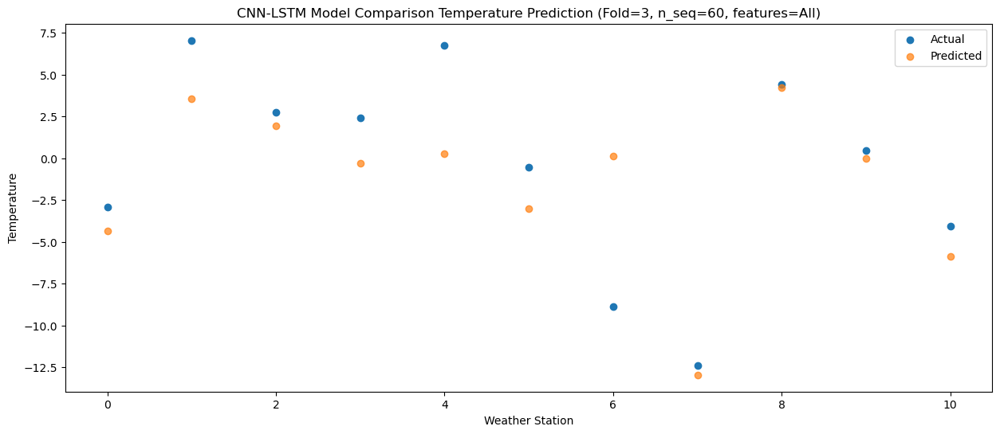

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    0.23  -2.152484
1                 1    8.90   5.261559
2                 2    8.45   5.019316
3                 3    4.75   2.432148
4                 4   10.03   2.619754
5                 5    2.90  -0.485629
6                 6   -4.07   2.902385
7                 7   -4.41  -9.908660
8                 8    6.60   7.066046
9                 9    5.08   3.463065
10               10    0.79  -2.483297


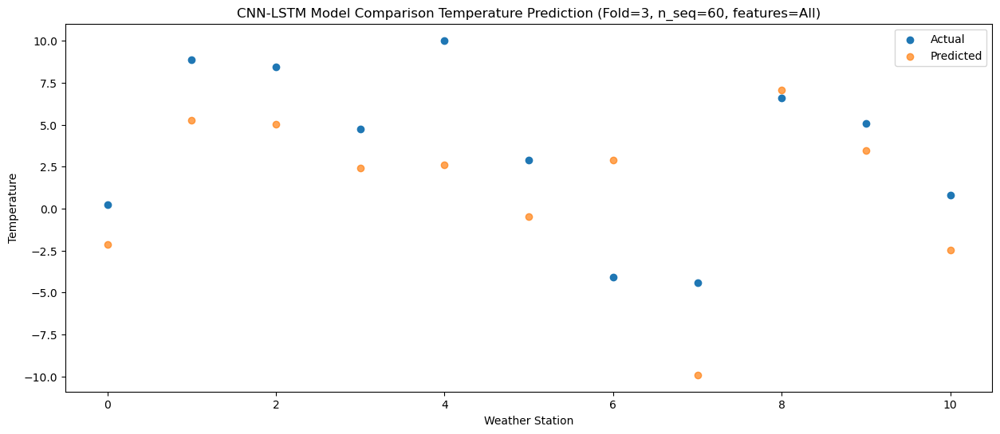

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    3.89   1.431927
1                 1   13.12   9.234231
2                 2   13.25   8.572009
3                 3    8.82   6.397995
4                 4   14.60   6.869845
5                 5    7.18   3.650589
6                 6    0.98   6.654462
7                 7    0.02  -6.222369
8                 8   10.89  10.384447
9                 9    9.91   7.472882
10               10    5.05   1.552450


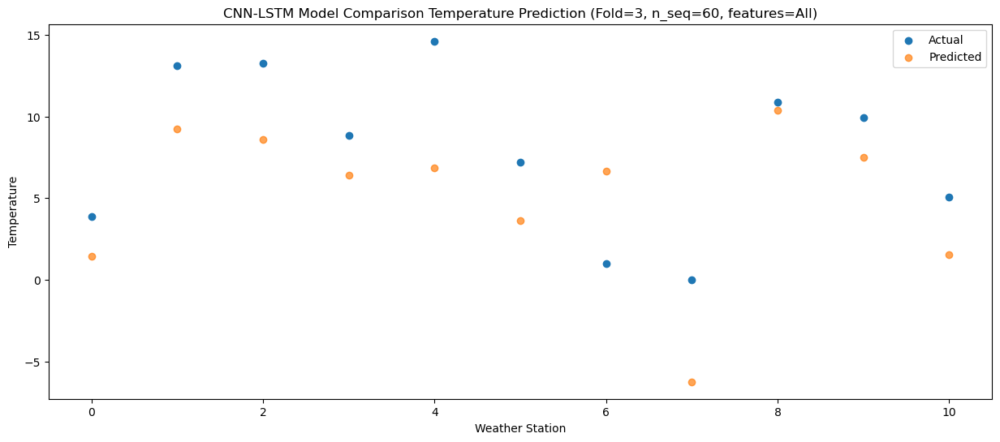

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    7.95   5.385890
1                 1   19.83  14.575765
2                 2   18.10  13.499361
3                 3   14.74  11.663160
4                 4   22.08  12.851561
5                 5   13.89   9.356447
6                 6    8.37  11.924397
7                 7    7.66  -0.903751
8                 8   12.59  14.606117
9                 9   15.78  13.110410
10               10   11.22   7.189396


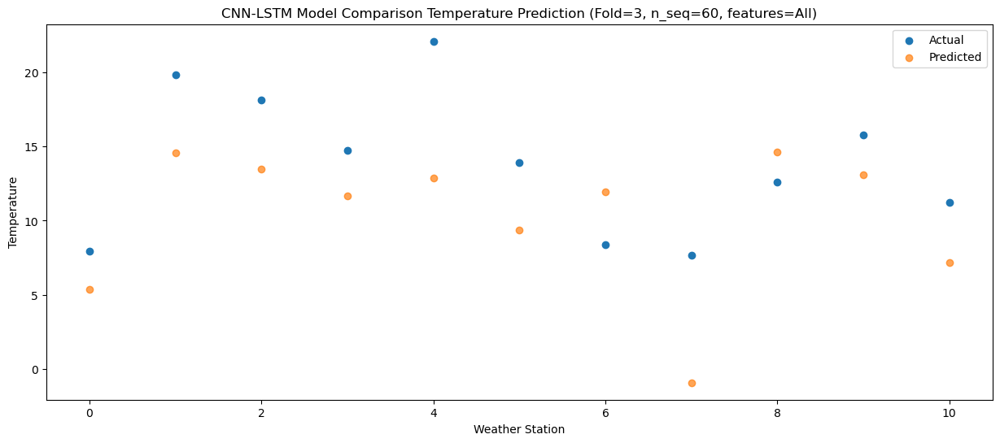

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    9.66   6.059040
1                 1   21.14  15.355696
2                 2   21.23  14.598071
3                 3   15.73  12.293641
4                 4   22.08  13.340381
5                 5   14.27   9.891780
6                 6   10.21  12.908865
7                 7    8.74   0.192791
8                 8   11.77  15.695805
9                 9   17.92  13.751034
10               10   12.86   7.798206


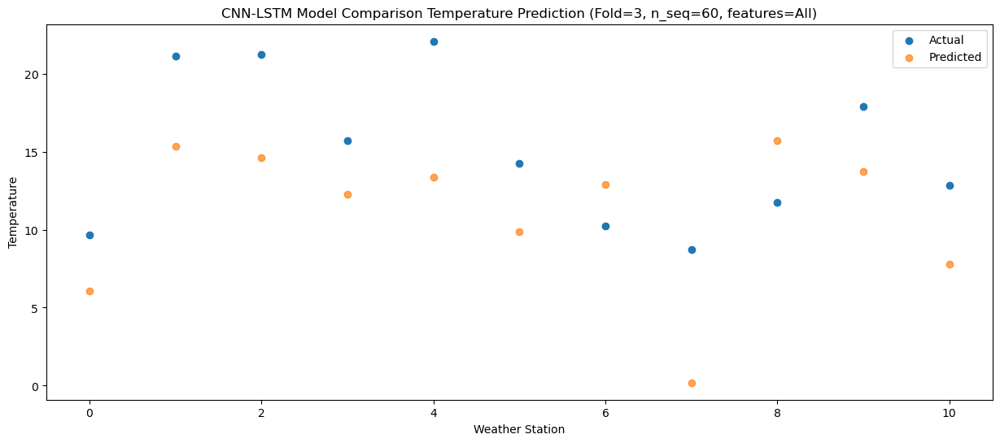

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    9.88   6.499286
1                 1   21.71  15.731115
2                 2   19.03  13.504266
3                 3   16.25  12.950438
4                 4   22.20  13.950733
5                 5   14.59  10.607450
6                 6    8.29  12.337158
7                 7    7.51  -0.824011
8                 8   12.32  14.583199
9                 9   18.54  14.337361
10               10   12.59   8.492671


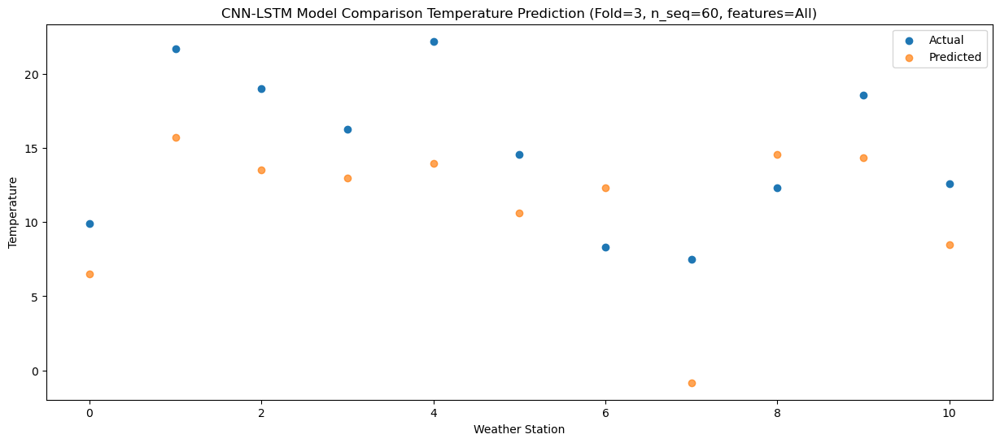

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    5.89   3.060133
1                 1   18.98  12.610394
2                 2   15.72  10.518202
3                 3   12.12   9.212745
4                 4   18.84  10.301581
5                 5   11.33   6.889363
6                 6    6.42   9.243065
7                 7    3.54  -3.801360
8                 8   11.77  11.694896
9                 9   15.22  10.340333
10               10    8.33   4.469510


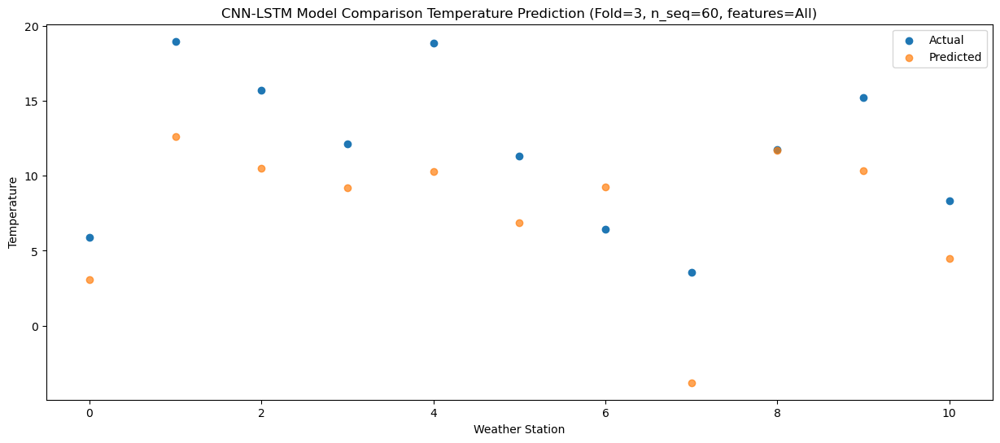

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    2.66   0.214473
1                 1   12.38   8.082365
2                 2    7.06   5.621672
3                 3    8.54   5.798282
4                 4   13.42   6.066398
5                 5    6.75   3.093438
6                 6   -1.55   4.391260
7                 7   -6.81  -9.036746
8                 8    9.01   7.260171
9                 9   10.78   7.006492
10               10    4.21   1.196053


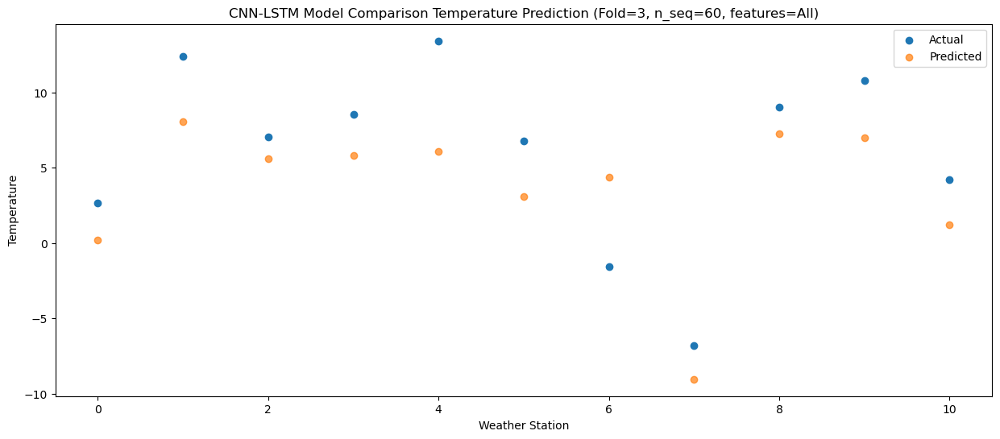

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -6.10  -7.573170
1                 1    4.67   0.259172
2                 2    2.72   2.143388
3                 3   -1.12  -2.926441
4                 4    3.68  -2.813886
5                 5   -4.10  -5.976937
6                 6   -4.29  -0.630033
7                 7   -9.33 -12.776269
8                 8    6.19   3.948032
9                 9    1.86  -1.586118
10               10   -6.01  -7.738024


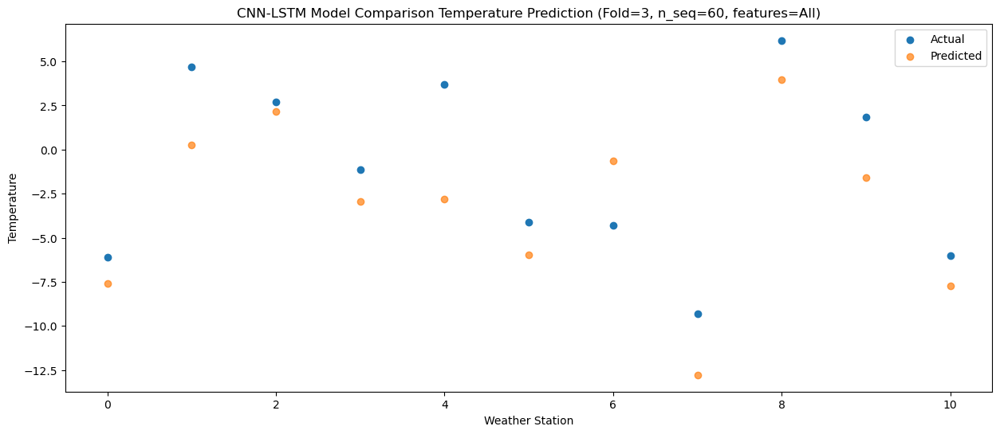

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0   -4.14  -6.884393
1                 1    5.98   0.732818
2                 2   -1.20  -1.467726
3                 3    0.37  -3.011218
4                 4    3.32  -3.229776
5                 5   -3.05  -6.046509
6                 6   -9.05  -3.046168
7                 7  -16.60 -16.383006
8                 8    2.49   1.026821
9                 9    0.26  -2.802954
10               10   -6.42  -8.665830


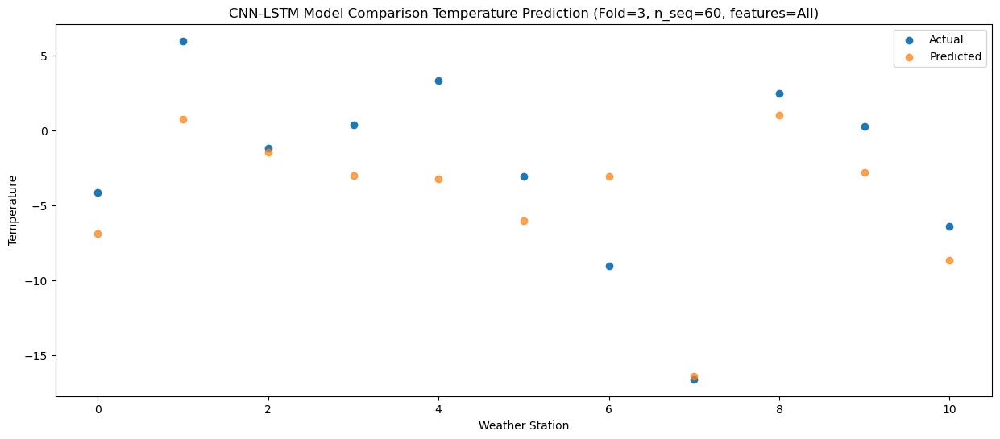

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0  -10.98 -13.559705
1                 1   -2.85  -7.277141
2                 2   -1.53  -3.399056
3                 3   -8.58 -10.790705
4                 4   -6.15 -11.715214
5                 5  -11.87 -14.531808
6                 6  -11.34  -7.109812
7                 7  -16.67 -18.884145
8                 8    3.11  -0.665539
9                 9   -6.29  -9.837807
10               10  -13.40 -16.137669


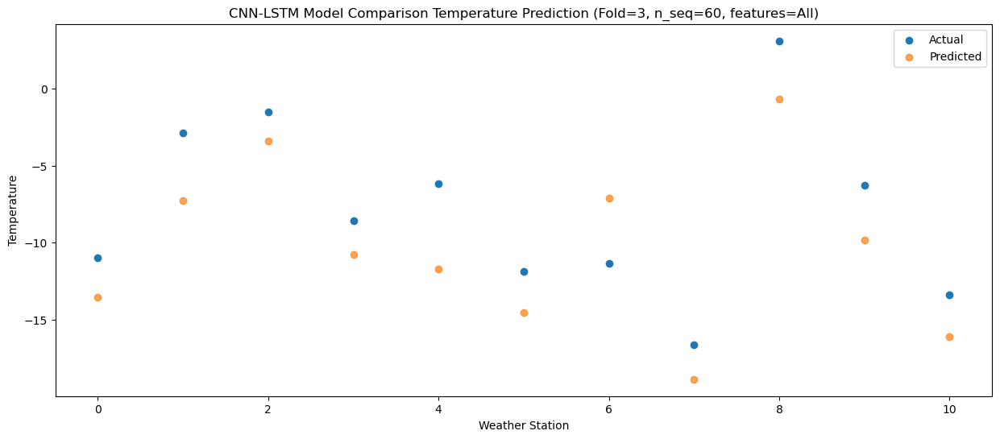

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -6.60 -10.743917
1                 1   -1.63  -5.992769
2                 2    0.17  -2.869526
3                 3   -4.06  -7.817724
4                 4   -3.63  -9.425244
5                 5   -8.68 -11.833197
6                 6  -13.06  -6.274212
7                 7  -14.63 -18.552242
8                 8    4.07  -0.039330
9                 9   -3.53  -6.414194
10               10   -9.59 -12.617512


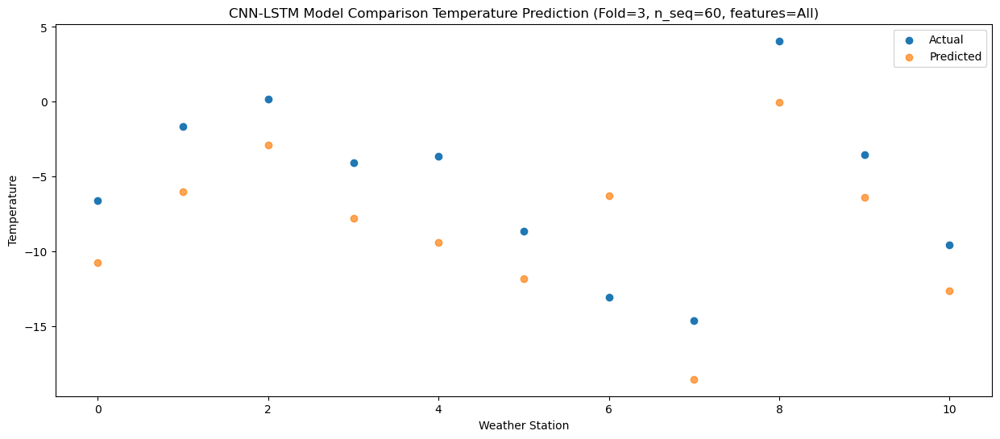

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -2.54  -6.679117
1                 1    5.15   0.108089
2                 2    4.88   0.750121
3                 3    1.69  -2.838003
4                 4    4.83  -3.251773
5                 5   -1.72  -6.111741
6                 6   -8.52  -1.730137
7                 7   -9.92 -14.378060
8                 8    6.30   3.078979
9                 9    0.43  -1.973161
10               10   -4.41  -8.015526


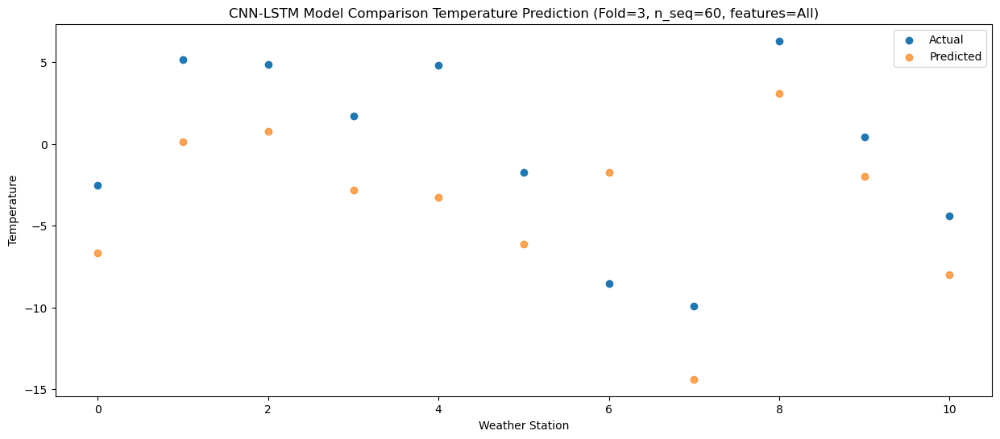

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    0.56  -4.147362
1                 1   10.00   4.485875
2                 2    7.95   2.974398
3                 3    4.70   0.404088
4                 4    8.96   0.738782
5                 5    2.13  -2.374654
6                 6   -4.20   1.264962
7                 7   -5.29 -11.700849
8                 8    7.74   4.955116
9                 9    4.72   0.831202
10               10   -0.59  -5.089317


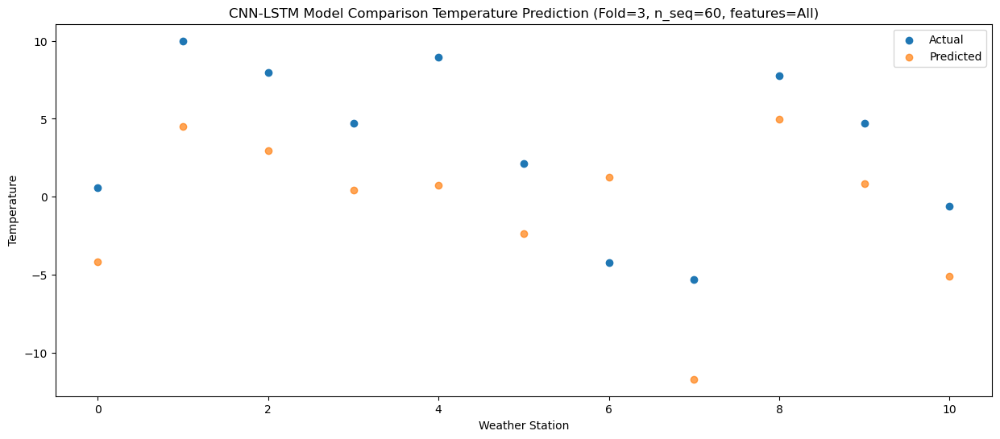

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    5.40   1.038598
1                 1   15.43  10.090379
2                 2   12.19   5.763495
3                 3   11.48   6.831567
4                 4   16.53   7.689532
5                 5    9.93   4.515014
6                 6    1.71   5.214433
7                 7   -0.62  -8.551878
8                 8   10.73   7.240724
9                 9   10.51   7.390797
10               10    6.19   1.696968


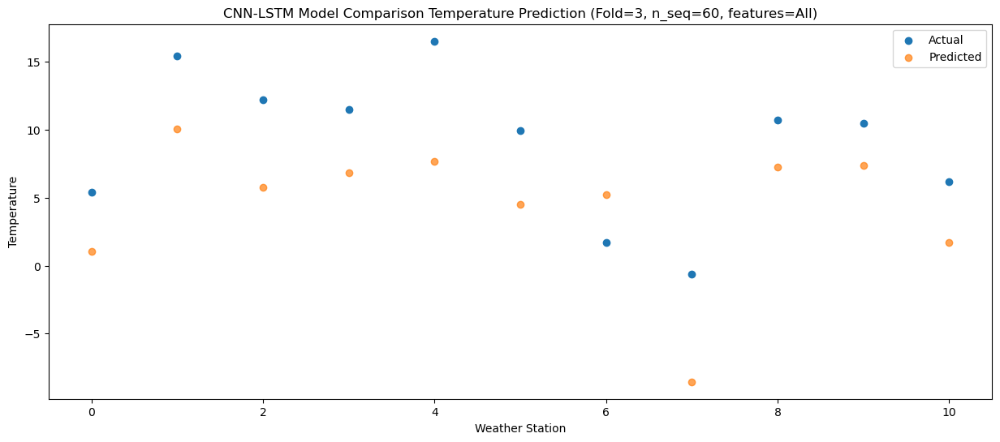

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    9.36   3.613227
1                 1   20.58  13.764836
2                 2   17.58   9.138002
3                 3   14.96   9.937199
4                 4   21.98  11.447235
5                 5   13.87   7.963940
6                 6    7.48   8.746655
7                 7    5.86  -4.911496
8                 8   13.88  10.262458
9                 9   14.83  10.405926
10               10   10.18   4.723214


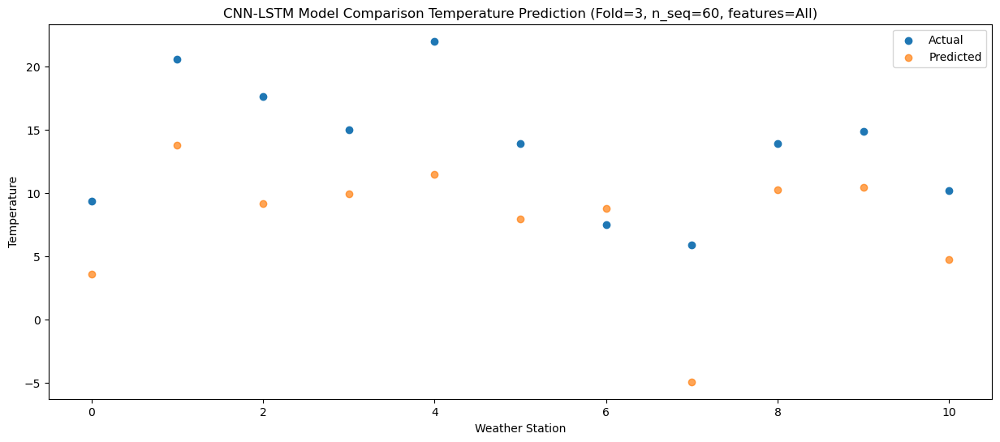

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   10.13   4.527265
1                 1   24.62  15.453920
2                 2   20.15  11.935712
3                 3   16.51  11.451741
4                 4   23.10  13.017308
5                 5   15.86   9.458036
6                 6    9.40  11.236798
7                 7    8.09  -1.986618
8                 8   12.23  12.669775
9                 9   19.38  12.383409
10               10   13.96   6.588588


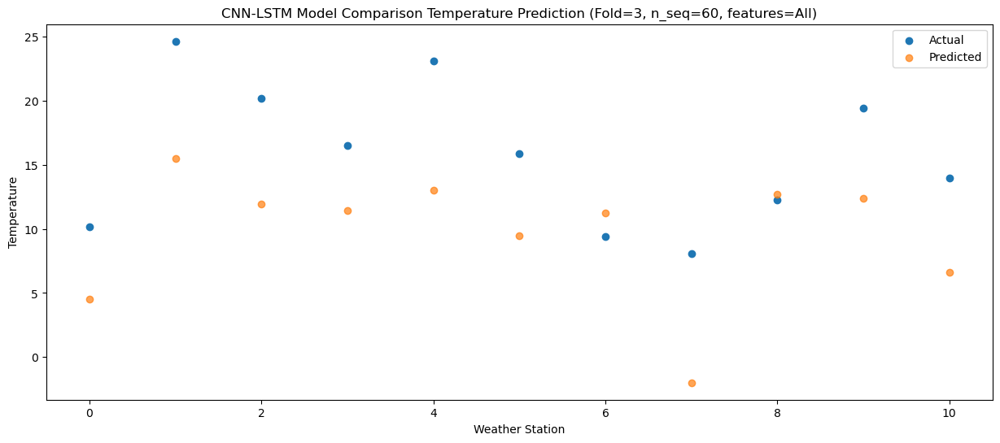

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    9.22   3.338293
1                 1   21.54  12.991433
2                 2   20.33  11.488998
3                 3   15.44  10.003874
4                 4   21.28  11.069729
5                 5   14.21   7.677335
6                 6    8.64  10.140933
7                 7    6.50  -2.720833
8                 8   13.65  12.327163
9                 9   19.30  11.464891
10               10   13.09   5.559194


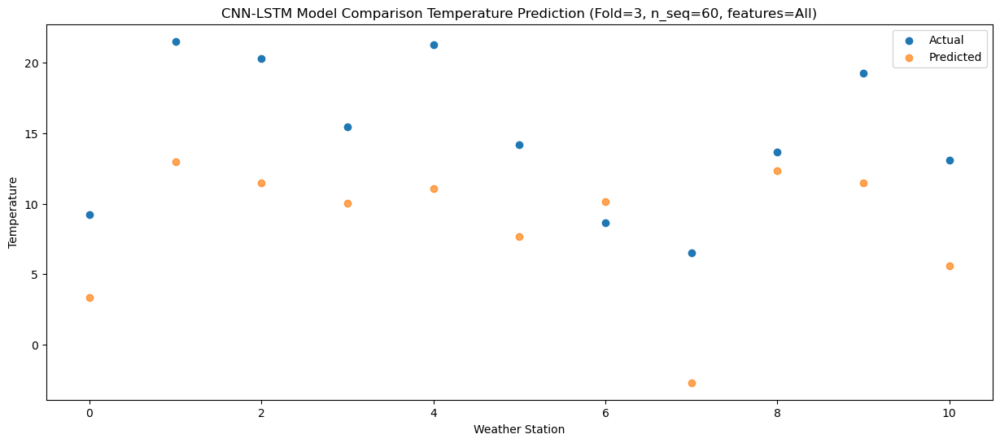

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    6.01   1.191756
1                 1   17.68  10.569874
2                 2   17.51   9.497564
3                 3   11.46   7.060048
4                 4   16.96   8.086325
5                 5   10.26   4.648533
6                 6    6.48   7.886627
7                 7    4.14  -4.846946
8                 8   13.88  10.678057
9                 9   14.39   8.094727
10               10    7.86   2.168035


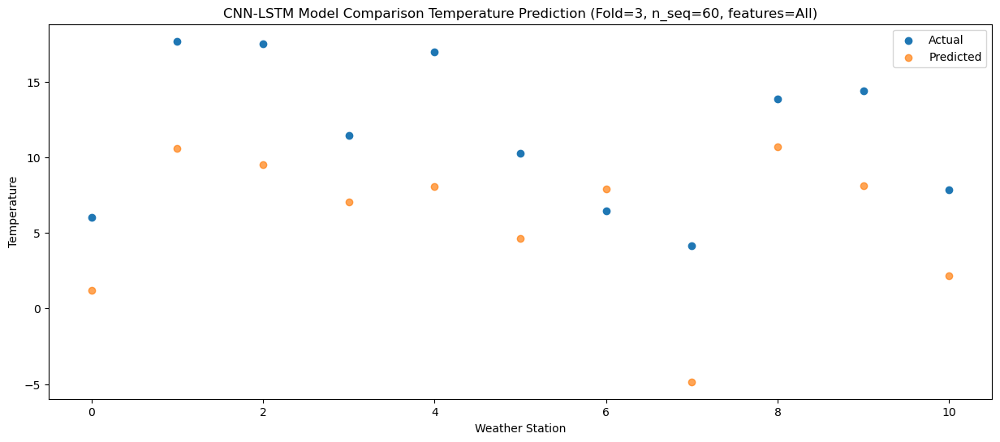

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   -1.00  -4.561412
1                 1   11.13   3.944444
2                 2   10.33   3.794845
3                 3    4.19   0.804223
4                 4    9.69   1.275332
5                 5    4.22  -1.931312
6                 6   -1.78   1.785079
7                 7   -3.75 -10.824583
8                 8    9.15   5.273022
9                 9    8.13   1.971751
10               10    0.25  -4.022061


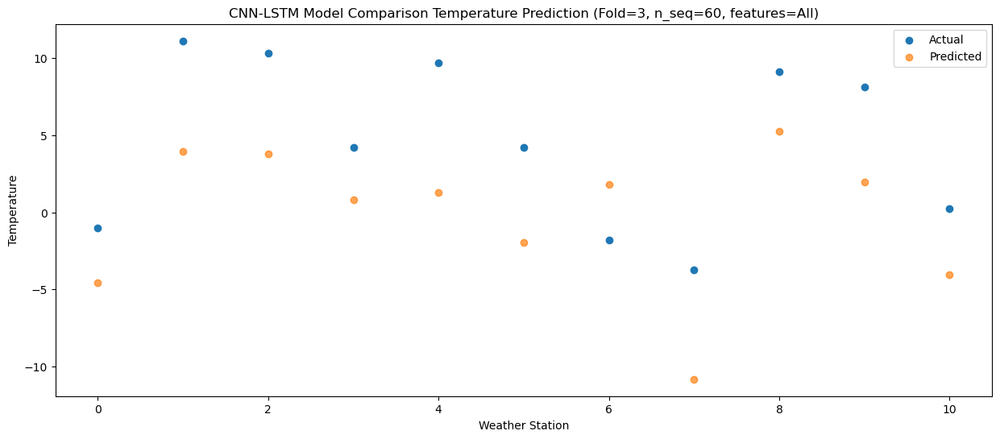

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -3.03  -7.247721
1                 1    3.90  -1.981709
2                 2   -0.40  -2.924971
3                 3    1.07  -2.735301
4                 4    3.80  -3.758163
5                 5   -2.33  -6.190114
6                 6   -9.46  -4.749366
7                 7  -15.17 -18.106862
8                 8    3.42  -0.743392
9                 9    4.17  -1.245685
10               10   -2.87  -7.103060


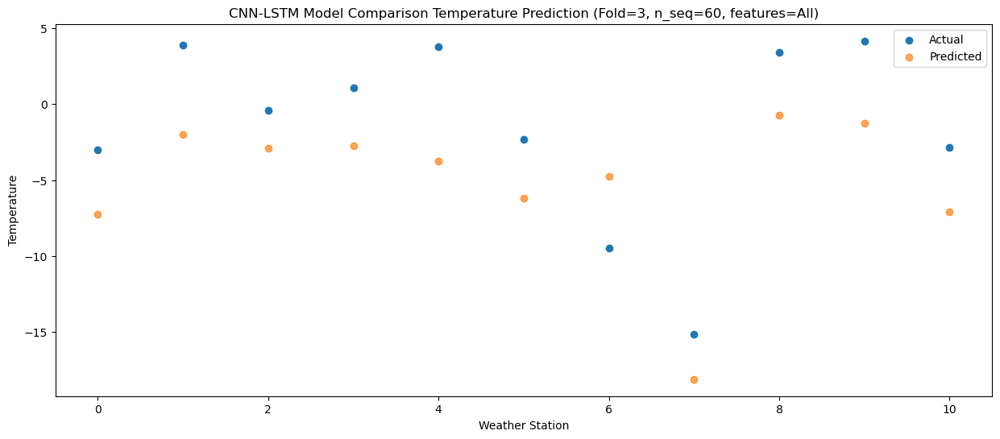

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -9.91 -11.972160
1                 1   -0.15  -5.899451
2                 2   -1.36  -5.508994
3                 3   -4.20  -8.219345
4                 4   -2.17  -9.273878
5                 5   -7.87 -11.775508
6                 6  -11.63  -7.943787
7                 7  -17.50 -20.744347
8                 8    2.22  -3.052068
9                 9   -2.19  -7.241530
10               10   -9.90 -13.237925


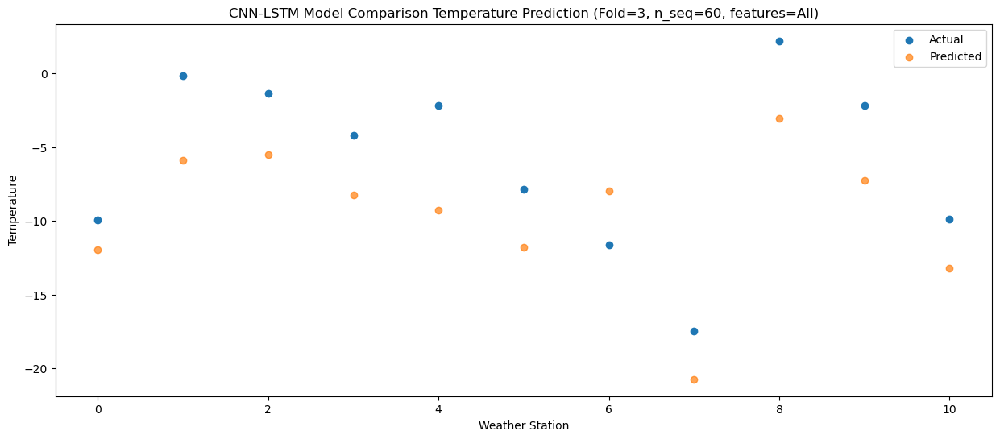

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -6.49 -10.848292
1                 1    0.55  -5.006088
2                 2    0.03  -4.948590
3                 3   -2.45  -6.977177
4                 4   -0.45  -8.157812
5                 5   -5.73 -10.572643
6                 6  -12.36  -7.235181
7                 7  -18.01 -20.196524
8                 8    3.89  -2.511576
9                 9   -0.21  -5.876517
10               10   -7.25 -11.849097


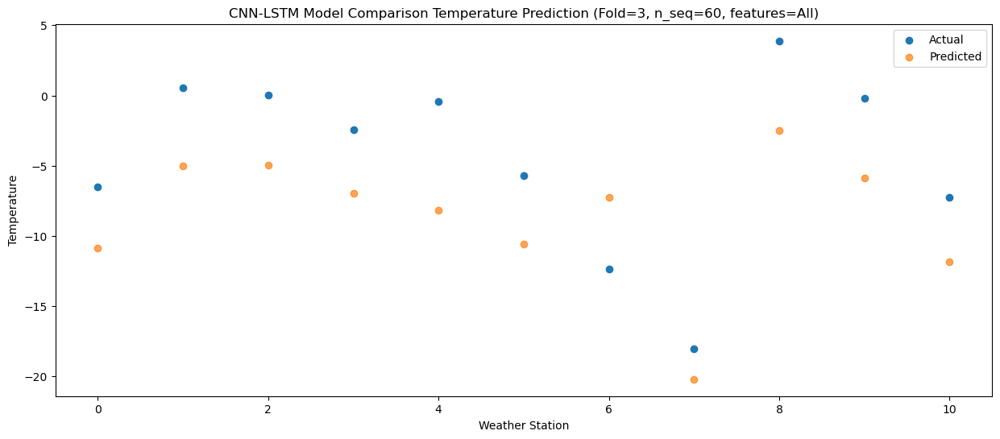

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -3.67  -9.604893
1                 1    2.51  -4.084057
2                 2   -0.82  -4.923985
3                 3   -0.11  -6.453444
4                 4    6.07  -7.501463
5                 5   -4.01  -9.993022
6                 6  -12.33  -7.006798
7                 7  -17.10 -20.226449
8                 8    2.09  -2.157868
9                 9   -1.94  -5.935060
10               10   -7.04 -11.828755


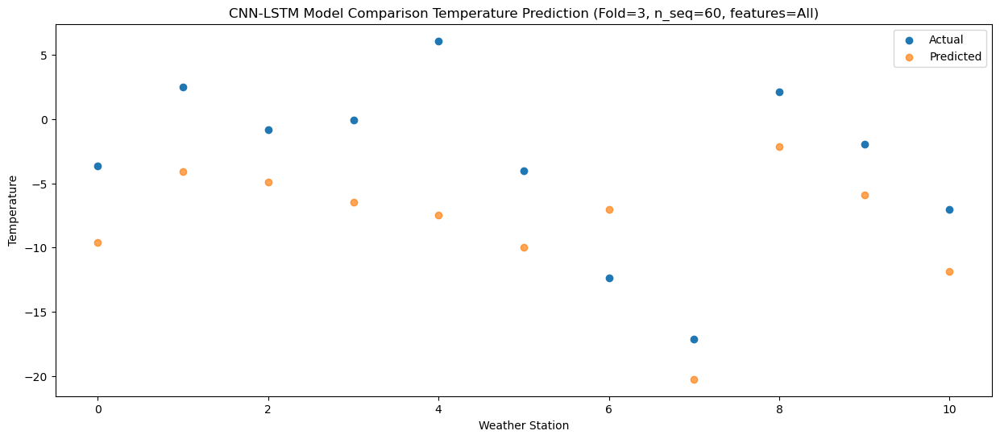

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -3.20  -8.976994
1                 1    5.11  -1.958670
2                 2    2.05  -2.800414
3                 3    0.13  -5.592465
4                 4    3.11  -5.902746
5                 5   -3.11  -8.775205
6                 6  -10.54  -4.877546
7                 7  -14.27 -17.825097
8                 8    3.55  -0.305646
9                 9    0.03  -5.339053
10               10   -5.48 -11.268054


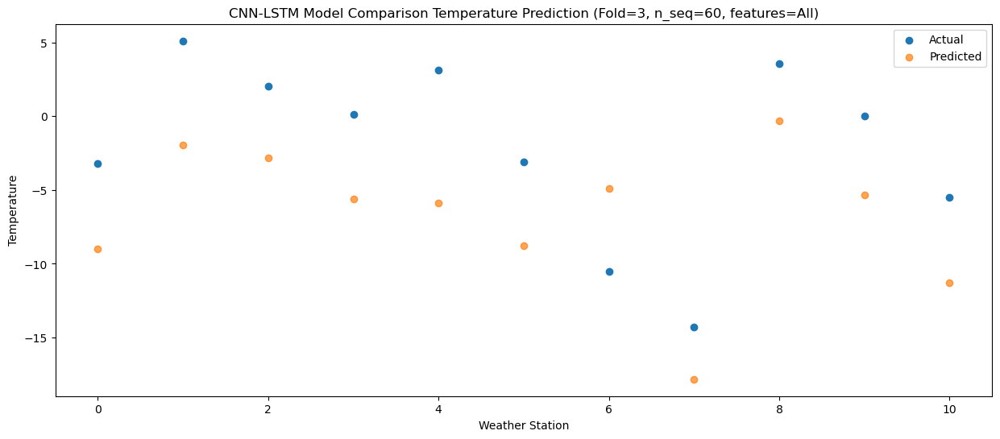

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    0.47  -5.151904
1                 1   10.16   2.209881
2                 2    7.68   0.460035
3                 3    6.37  -0.259317
4                 4   10.32  -0.172400
5                 5    3.12  -3.150095
6                 6   -5.20  -1.024022
7                 7   -6.32 -14.238753
8                 8    7.63   2.185892
9                 9    6.08   0.725773
10               10    2.09  -5.121278


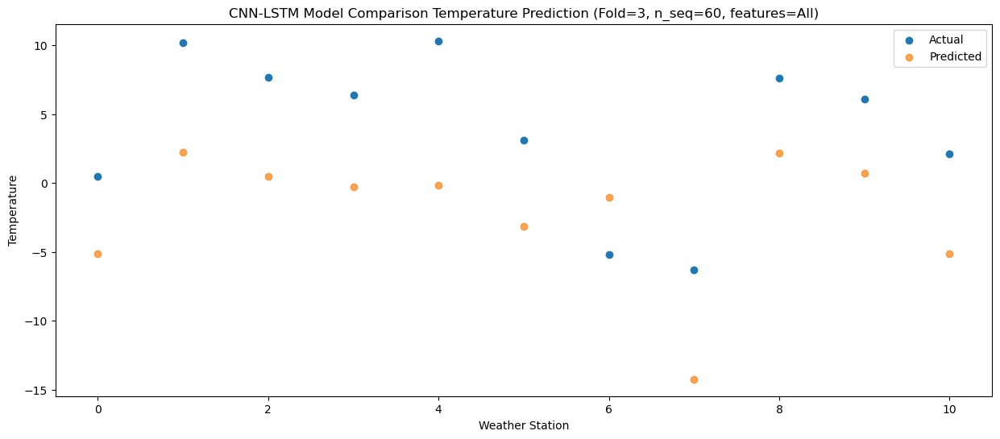

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    2.83  -2.369763
1                 1   15.47   7.313751
2                 2   12.12   4.728282
3                 3    9.06   3.280367
4                 4   16.32   4.709783
5                 5    8.53   1.122551
6                 6    2.01   3.626226
7                 7   -0.52  -9.450060
8                 8    8.66   5.917220
9                 9    9.72   3.792618
10               10    4.56  -2.018256


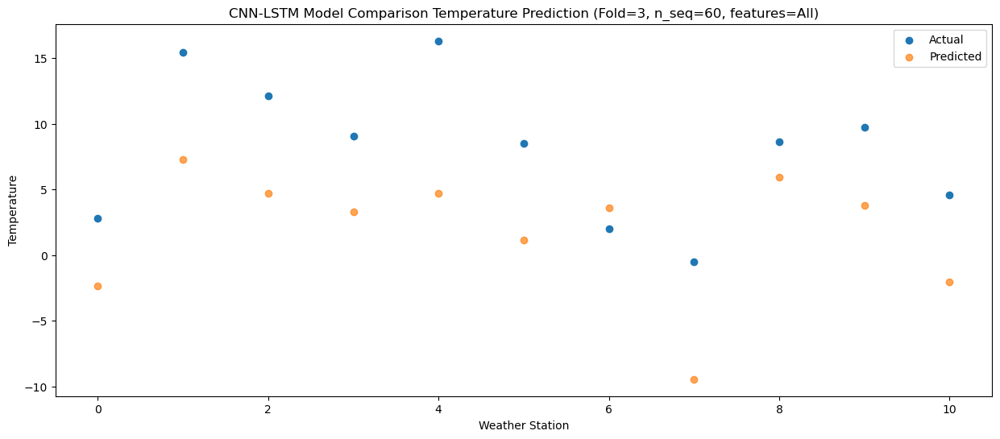

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    6.60   1.111044
1                 1   19.80  11.446012
2                 2   14.92   6.976782
3                 3   12.80   7.300846
4                 4   20.42   9.066049
5                 5   11.99   5.429368
6                 6    6.59   6.563194
7                 7    1.98  -6.942826
8                 8   10.56   7.968916
9                 9   13.71   7.631193
10               10    8.49   1.954934


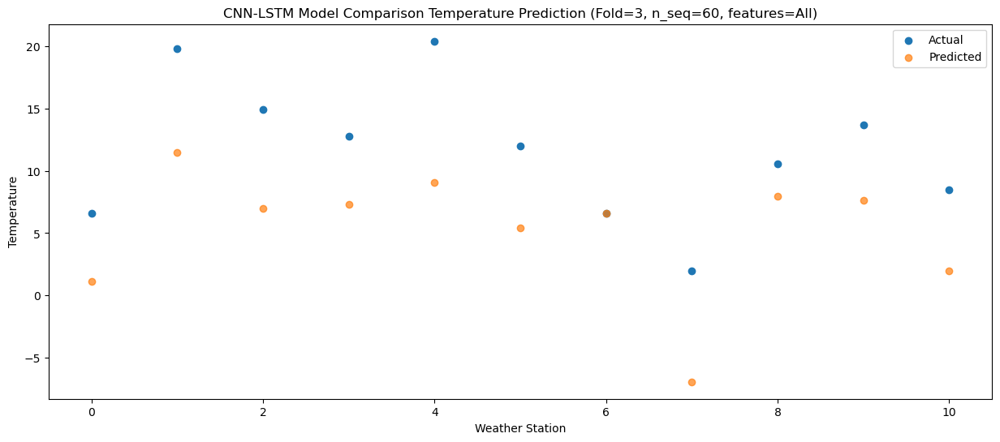

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   10.38   3.488964
1                 1   22.06  13.049017
2                 2   20.58  10.898440
3                 3   16.42   9.815085
4                 4   22.12  10.737311
5                 5   15.25   7.426671
6                 6   12.73   9.783130
7                 7   10.34  -3.217265
8                 8   13.57  11.805680
9                 9   19.39  10.954666
10               10   13.33   5.115189


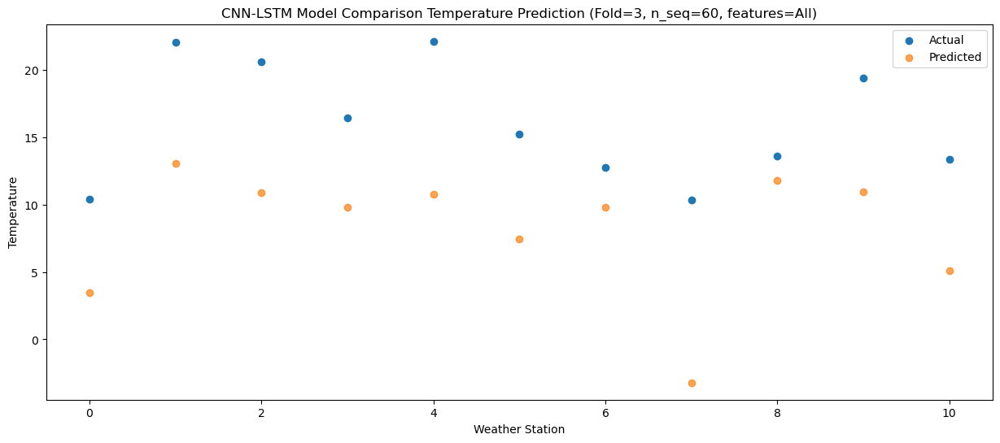

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    9.87   3.812101
1                 1   22.24  14.288477
2                 2   18.89  11.609096
3                 3   15.31   9.645390
4                 4   20.83  11.163229
5                 5   13.70   7.526993
6                 6   10.14  10.586204
7                 7    5.71  -2.364353
8                 8   14.60  12.647005
9                 9   17.14  10.064374
10               10   11.36   4.235902


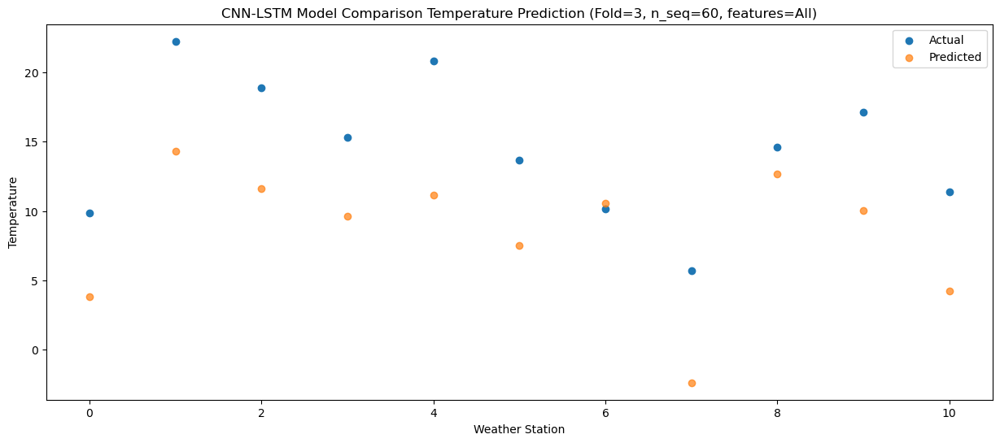

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    5.73   0.313362
1                 1   18.19  10.354705
2                 2   15.12   7.411373
3                 3   12.58   6.322433
4                 4   17.47   7.715902
5                 5   10.24   4.179033
6                 6    5.99   6.536472
7                 7    1.01  -6.588813
8                 8   11.99   8.414661
9                 9   14.57   6.940545
10               10    8.07   1.142576


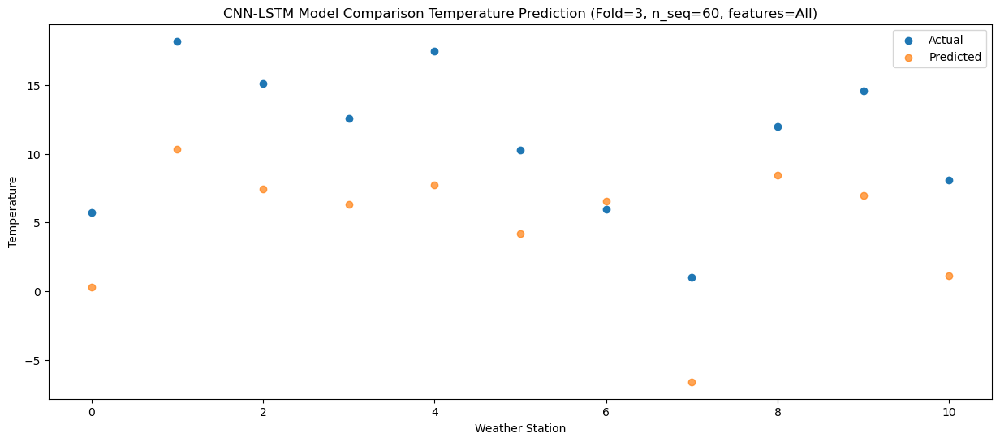

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    0.70  -4.627811
1                 1   11.25   3.405292
2                 2    9.81   1.736701
3                 3    7.14   0.941773
4                 4   11.01   1.272431
5                 5    4.59  -1.772170
6                 6   -0.14   0.389950
7                 7   -4.28 -12.711880
8                 8   10.53   3.091163
9                 9    9.14   2.115284
10               10    2.78  -3.733340


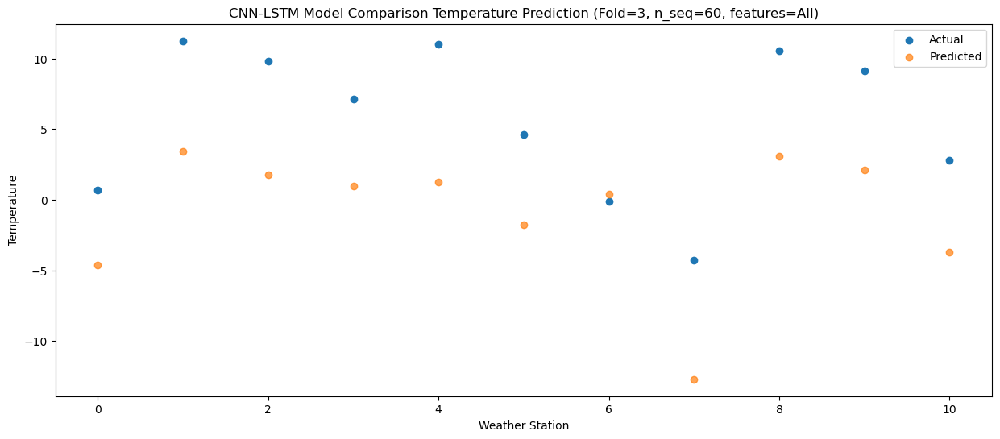

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -4.96 -10.384933
1                 1    5.47  -2.673730
2                 2    2.90  -3.323705
3                 3    0.75  -5.641645
4                 4    4.06  -5.304336
5                 5   -1.89  -8.471214
6                 6   -6.00  -5.102391
7                 7  -12.42 -17.920485
8                 8    6.49  -1.686098
9                 9    1.29  -4.779756
10               10   -5.49 -10.704278


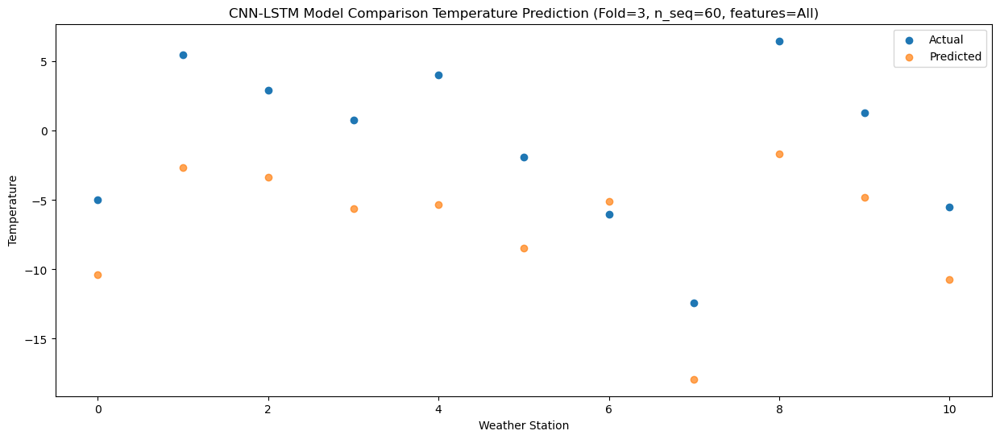

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -7.01 -12.542516
1                 1    2.12  -5.721698
2                 2    1.06  -5.720347
3                 3   -1.08  -7.564308
4                 4    1.25  -7.772292
5                 5   -4.35 -10.639987
6                 6   -9.63  -7.661485
7                 7  -15.55 -20.488394
8                 8    4.65  -4.089783
9                 9    0.56  -6.116691
10               10   -6.24 -12.075475


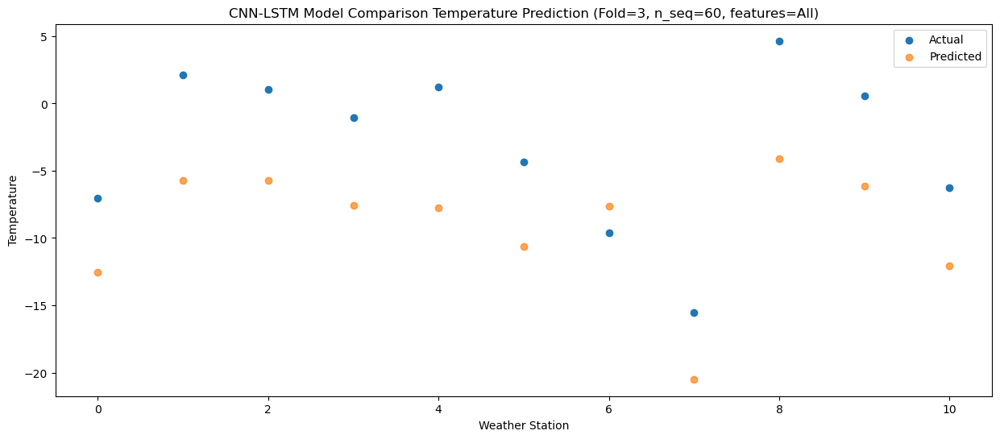

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -9.32 -15.440577
1                 1   -4.49 -11.034064
2                 2    0.85  -6.885869
3                 3   -6.24 -11.925728
4                 4   -5.25 -13.631329
5                 5  -10.51 -16.003329
6                 6  -11.77 -10.358314
7                 7  -17.27 -22.392267
8                 8    4.96  -4.565279
9                 9   -3.43  -9.908489
10               10   -9.26 -16.136235


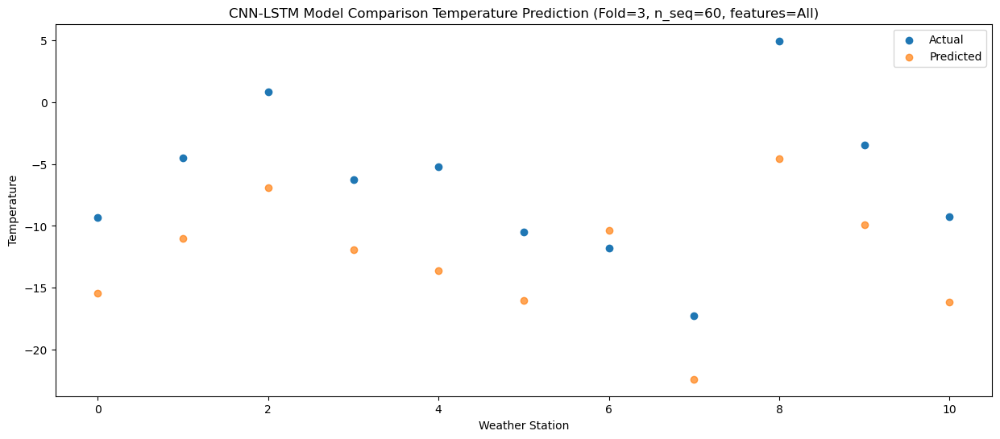

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -6.18 -13.174515
1                 1    5.16  -4.265143
2                 2    2.34  -5.519278
3                 3   -0.56  -8.533005
4                 4    2.56  -7.870579
5                 5   -3.88 -11.173144
6                 6   -9.61  -7.147896
7                 7  -14.91 -19.943223
8                 8    4.67  -3.855431
9                 9   -2.86  -8.169314
10               10   -7.22 -14.094640


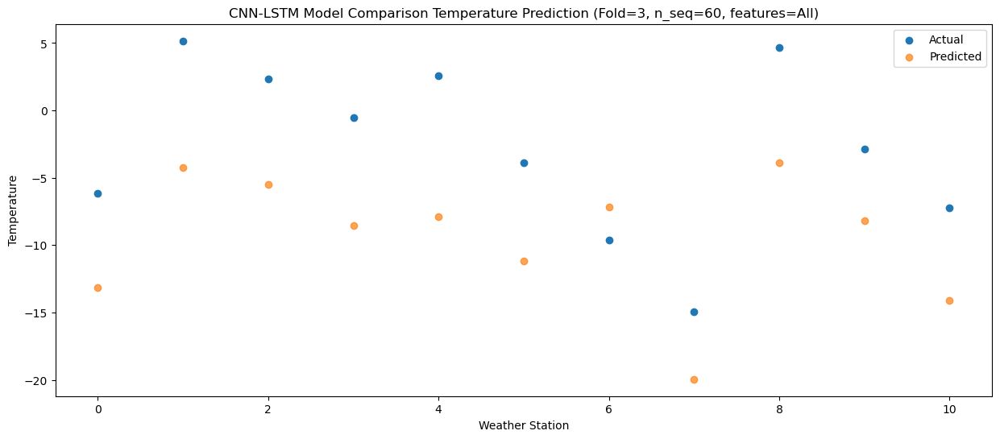

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -2.51 -10.005145
1                 1    7.64  -1.848861
2                 2    4.37  -3.671202
3                 3    3.09  -5.386313
4                 4    6.67  -5.081062
5                 5    0.19  -8.175663
6                 6   -7.87  -5.087148
7                 7  -11.55 -18.183989
8                 8    5.60  -1.906807
9                 9    1.84  -4.923049
10               10   -2.56 -10.784717


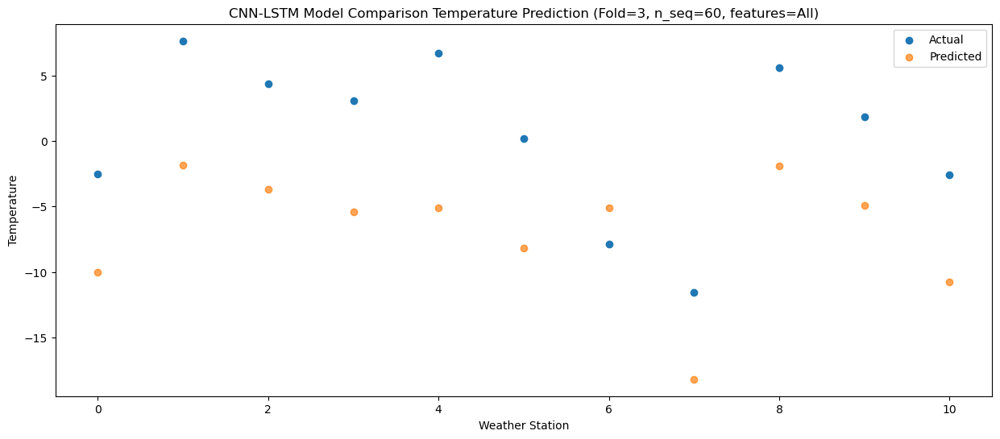

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    1.51  -6.528124
1                 1   11.81   2.621636
2                 2    7.56  -0.477354
3                 3    8.15  -1.126034
4                 4   11.42  -0.301027
5                 5    5.16  -3.575759
6                 6   -2.89  -1.341983
7                 7   -6.05 -14.668162
8                 8    7.83   0.886467
9                 9    4.71  -0.713006
10               10    2.02  -6.496951


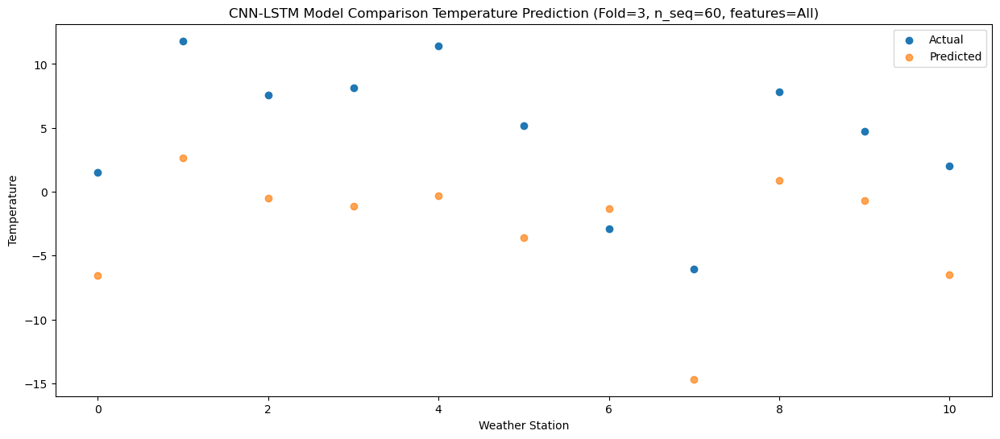

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    5.78  -2.281207
1                 1   16.58   6.935315
2                 2   12.95   1.979951
3                 3   12.34   3.816991
4                 4   17.58   4.707808
5                 5   10.68   1.522943
6                 6    0.22   1.843239
7                 7   -0.42 -12.033212
8                 8   10.80   3.111877
9                 9   10.26   4.337720
10               10    7.69  -1.307176


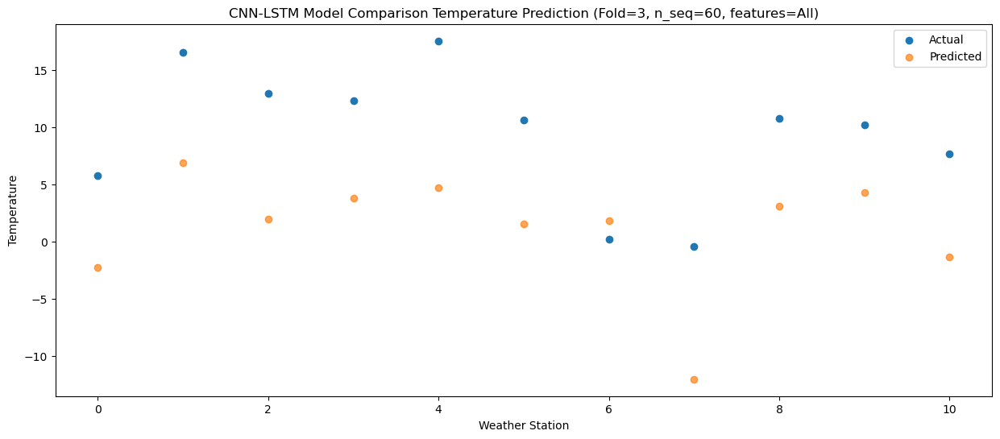

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    9.44  -0.056767
1                 1   21.14   9.964321
2                 2   18.90   5.861414
3                 3   16.24   6.711215
4                 4   22.45   7.908507
5                 5   13.91   4.558127
6                 6    9.37   5.528047
7                 7    7.76  -7.985578
8                 8   13.71   6.552374
9                 9   16.73   7.606283
10               10   13.06   1.882076


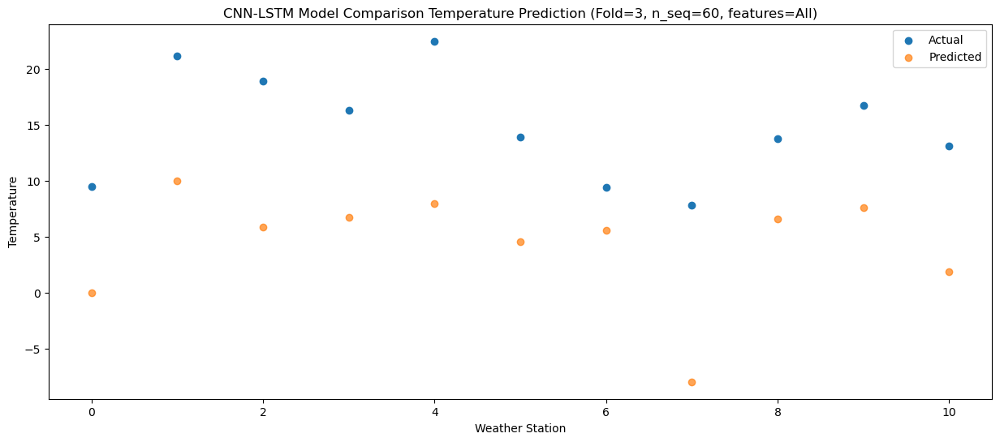

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   10.33   1.115537
1                 1   21.66  10.339894
2                 2   22.47   8.996020
3                 3   17.95   7.933272
4                 4   21.61   8.549730
5                 5   14.46   5.354907
6                 6   10.12   7.797905
7                 7   10.84  -5.094254
8                 8   14.97   9.585017
9                 9   19.29   9.637887
10               10   15.72   3.732259


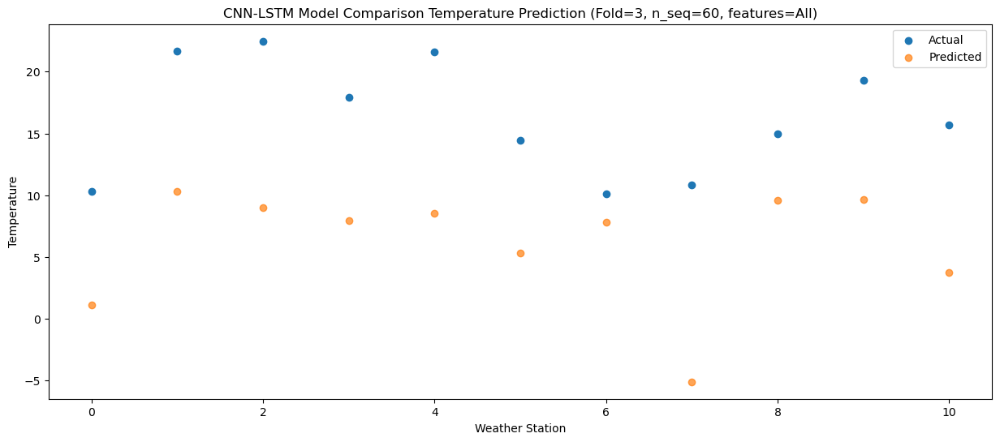

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    8.93   1.002059
1                 1   21.94  11.596358
2                 2   19.50   8.552162
3                 3   16.93   7.629028
4                 4   21.06   8.913433
5                 5   13.91   5.424461
6                 6    9.83   7.867461
7                 7    7.98  -5.250953
8                 8   13.69   9.172782
9                 9   17.57   8.460869
10               10   12.58   2.642235


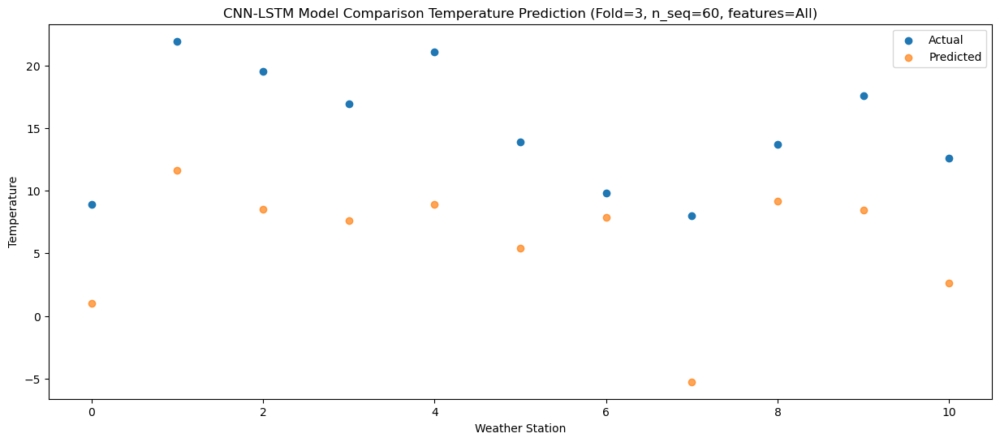

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    6.24  -1.449312
1                 1   17.90   8.073160
2                 2   16.47   6.032961
3                 3   13.96   4.822706
4                 4   17.80   5.810533
5                 5   11.22   2.414863
6                 6    6.21   5.005544
7                 7    4.03  -8.001078
8                 8   12.25   6.806967
9                 9   13.56   5.908870
10               10    8.99   0.048805


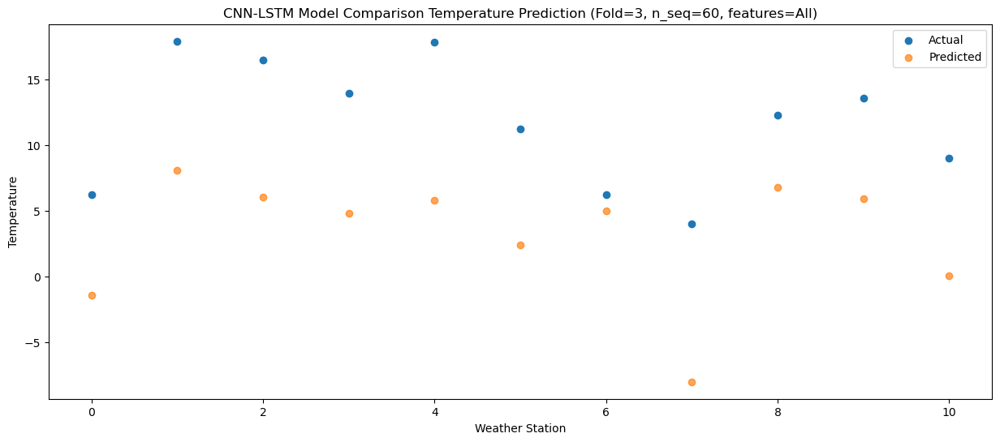

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    0.93  -6.023989
1                 1   14.51   3.924263
2                 2   11.44   1.414276
3                 3    7.46  -0.219358
4                 4   12.17   0.945145
5                 5    5.34  -2.549538
6                 6    1.98   0.430144
7                 7   -1.86 -12.599054
8                 8   11.79   2.406570
9                 9    9.03   0.347523
10               10    3.75  -5.498864


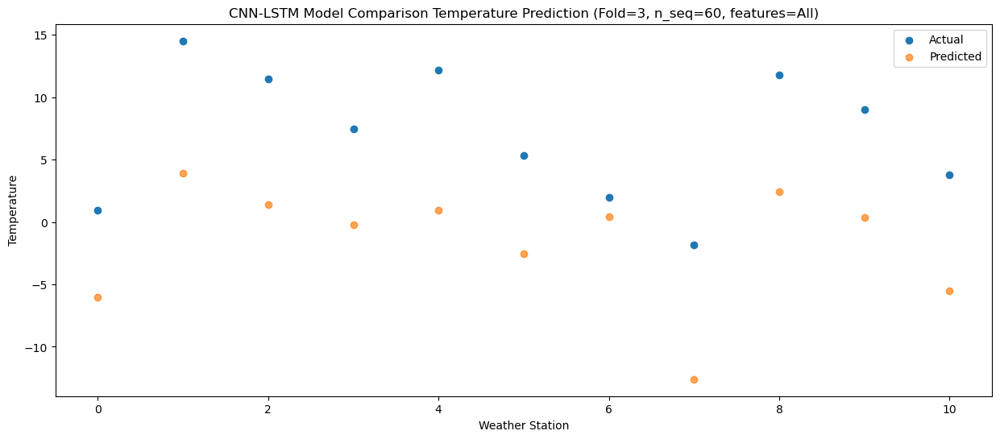

f, t:
[[-6.460e+00  2.220e+00  2.710e+00 -2.860e+00  3.310e+00 -5.820e+00
  -6.460e+00 -1.316e+01  5.280e+00  6.300e-01 -6.460e+00]
 [-7.240e+00  8.700e-01  1.800e-01 -2.850e+00  5.000e-02 -5.610e+00
  -1.213e+01 -1.789e+01  4.030e+00 -2.130e+00 -9.420e+00]
 [-7.660e+00  3.000e-02 -1.040e+00 -3.400e+00 -2.820e+00 -7.030e+00
  -1.222e+01 -1.673e+01  3.400e+00 -2.100e+00 -9.010e+00]
 [-6.650e+00  1.800e-01  1.380e+00 -3.750e+00 -1.670e+00 -7.440e+00
  -1.203e+01 -1.522e+01  5.420e+00 -1.660e+00 -8.090e+00]
 [-1.390e+00  7.670e+00  3.170e+00  3.160e+00  5.740e+00 -5.800e-01
  -7.100e+00 -1.211e+01  4.860e+00  1.920e+00 -3.680e+00]
 [-3.200e-01  8.590e+00  7.830e+00  3.800e+00  8.770e+00  1.690e+00
  -4.120e+00 -6.200e+00  8.480e+00  3.360e+00 -1.740e+00]
 [ 2.370e+00  1.299e+01  1.302e+01  8.370e+00  1.484e+01  7.100e+00
   2.990e+00  1.070e+00  1.088e+01  8.920e+00  4.030e+00]
 [ 7.690e+00  2.009e+01  1.637e+01  1.419e+01  2.189e+01  1.409e+01
   7.200e+00  4.530e+00  1.342e+01  1.590e+0

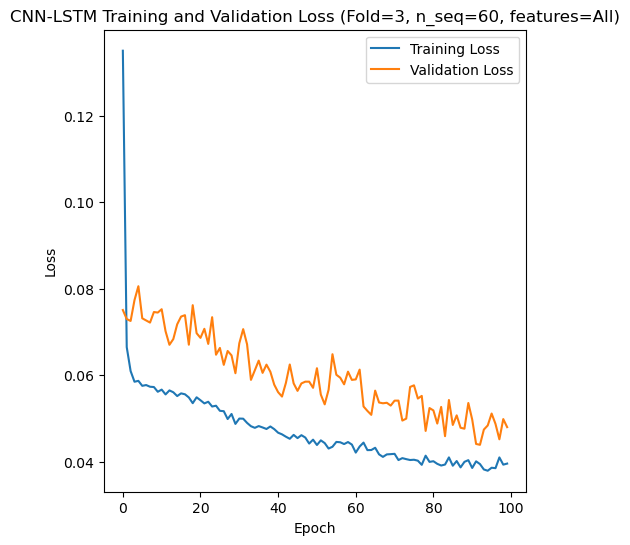

[[ 4.89  1.26  7.78 ... 22.59 18.46  9.82]
 [15.38 13.87 17.63 ... 26.66 22.89 20.2 ]
 [11.49  8.39 14.48 ... 24.97 20.83 17.82]
 ...
 [ 7.64  3.61 10.44 ... 21.3  17.62 11.34]
 [ 4.26  0.29  5.21 ... 21.47 15.54  9.34]
 [ 3.62 -0.32  6.05 ... 19.99 14.92  8.29]]
Epoch 1/100
84/84 [==============================] - 31s 146ms/step - loss: 0.1480 - accuracy: 0.2262 - mae: 0.1287 - rmse: 0.1480 - mape: inf - pearson: 0.5934 - val_loss: 0.0792 - val_accuracy: 0.0000e+00 - val_mae: 0.0632 - val_rmse: 0.0792 - val_mape: 14.7217 - val_pearson: 0.7942
Epoch 2/100
84/84 [==============================] - 7s 81ms/step - loss: 0.0677 - accuracy: 0.3810 - mae: 0.0537 - rmse: 0.0677 - mape: inf - pearson: 0.8005 - val_loss: 0.0715 - val_accuracy: 0.6000 - val_mae: 0.0565 - val_rmse: 0.0715 - val_mape: 12.6114 - val_pearson: 0.8484
Epoch 3/100
84/84 [==============================] - 7s 89ms/step - loss: 0.0615 - accuracy: 0.4524 - mae: 0.0485 - rmse: 0.0615 - mape: inf - pearson: 0.8317 - val_loss:

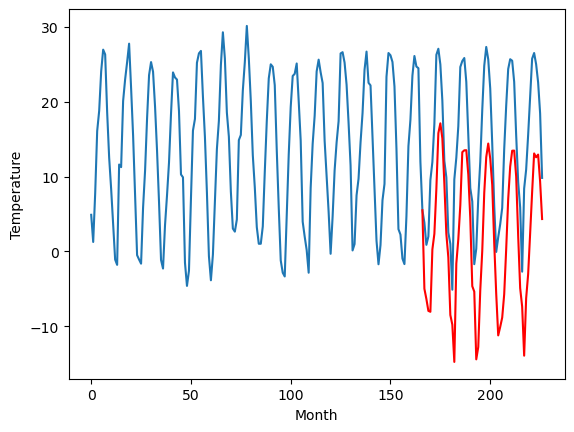

Weather Station 2:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.38		-4.94		-2.56
-2.56		-5.41		-2.85
-4.02		-6.18		-2.16
-2.47		-5.78		-3.31
1.60		0.77		-0.83
3.28		1.60		-1.68
4.68		5.13		0.45
6.44		10.01		3.57
6.76		11.56		4.80
6.61		10.27		3.66
6.03		6.26		0.23
4.53		2.99		-1.54
1.14		-1.47		-2.61
-6.61		-8.93		-2.32
-5.91		-9.51		-3.60
-2.48		-10.09		-7.61
-0.88		-2.97		-2.09
0.56		-0.41		-0.97
4.60		3.09		-1.51
6.23		7.31		1.08
6.60		7.85		1.25
6.88		8.04		1.16
5.59		5.42		-0.17
3.75		1.79		-1.96
-3.41		-6.61		-3.20
-1.61		-4.31		-2.70
-6.37		-12.44		-6.07
-2.94		-9.33		-6.39
-0.12		-4.44		-4.32
2.22		-0.53		-2.75
5.04		5.00		-0.04
6.76		8.14		1.38
7.13		8.59		1.46
7.08		7.17		0.09
5.64		4.94		-0.70
1.81		-1.46		-3.27
0.35		-4.11		-4.46
-4.50		-8.75		-4.25
-4.65		-7.56		-2.91
-1.35		-5.40		-4.05
0.37		-3.49		-3.86
3.09		-0.36		-3.45
3.87		2.91		-0.96
6.08		6.46		0.38
7.69		9.59		1.90
8.20		9.63		1.43
6.10		6.05		-0.05
2.45		0.27		-2.18
-1.26		-5.8

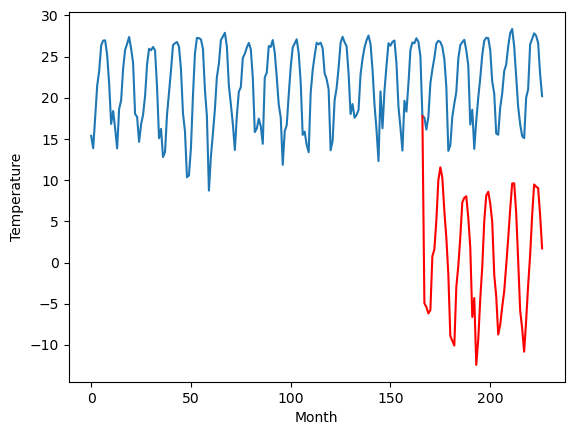

Weather Station 3:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
6.75		5.68		-1.07
6.81		5.04		-1.77
6.62		3.93		-2.69
6.88		3.95		-2.93
14.68		11.69		-2.99
13.73		12.80		-0.93
17.61		17.50		-0.11
21.70		23.53		1.83
23.27		25.05		1.78
22.44		23.26		0.82
20.34		18.43		-1.91
15.00		13.64		-1.36
11.00		9.84		-1.16
4.75		2.04		-2.71
4.78		1.02		-3.76
2.86		-1.61		-4.47
12.19		8.80		-3.39
13.26		11.59		-1.67
17.73		15.55		-2.18
21.99		20.98		-1.01
22.65		21.33		-1.32
23.30		21.66		-1.64
20.18		18.66		-1.52
16.79		14.35		-2.44
8.12		4.93		-3.19
11.63		6.70		-4.93
3.35		-2.79		-6.14
5.71		-0.25		-5.96
10.45		6.05		-4.40
14.66		10.82		-3.84
20.46		17.46		-3.00
23.75		21.11		-2.64
23.95		22.16		-1.79
22.41		20.14		-2.27
20.34		17.17		-3.17
14.21		10.13		-4.08
9.62		5.87		-3.75
7.19		0.85		-6.34
7.60		2.05		-5.55
9.54		3.88		-5.66
11.69		6.30		-5.39
13.44		10.60		-2.84
18.30		15.33		-2.97
21.89		19.46		-2.43
23.67		21.89		-1.78
25.75		21.82		-3.93
22.00		18.23		-3.7

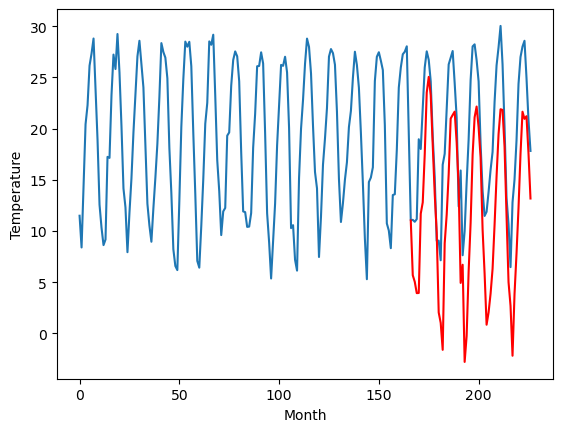

Weather Station 4:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
4.23		2.70		-1.53
2.58		1.78		-0.80
2.82		0.51		-2.31
2.49		0.52		-1.97
9.95		8.59		-1.36
10.61		10.17		-0.44
15.74		15.43		-0.31
20.70		21.79		1.09
22.56		23.10		0.54
22.31		21.47		-0.84
16.53		16.22		-0.31
10.80		10.60		-0.20
8.19		7.02		-1.17
1.91		-0.53		-2.44
0.99		-1.40		-2.39
-2.47		-5.09		-2.62
8.49		6.50		-1.99
10.18		9.42		-0.76
14.34		13.62		-0.72
20.02		19.70		-0.32
21.61		20.03		-1.58
21.98		20.16		-1.82
19.19		17.25		-1.94
14.54		12.08		-2.46
6.54		3.19		-3.35
8.54		3.94		-4.60
0.07		-5.08		-5.15
0.33		-3.32		-3.65
6.51		3.59		-2.92
12.56		8.74		-3.82
17.27		15.46		-1.81
21.82		19.67		-2.15
25.12		21.10		-4.02
22.39		18.95		-3.44
18.96		15.89		-3.07
12.09		8.52		-3.57
5.04		2.66		-2.38
2.35		-2.08		-4.43
3.34		-1.01		-4.35
3.40		0.62		-2.78
7.93		3.56		-4.37
10.53		8.29		-2.24
16.21		14.03		-2.18
20.40		18.20		-2.20
22.95		20.48		-2.47
25.50		20.65		-4.85
20.80		16.97		-3.83
12.

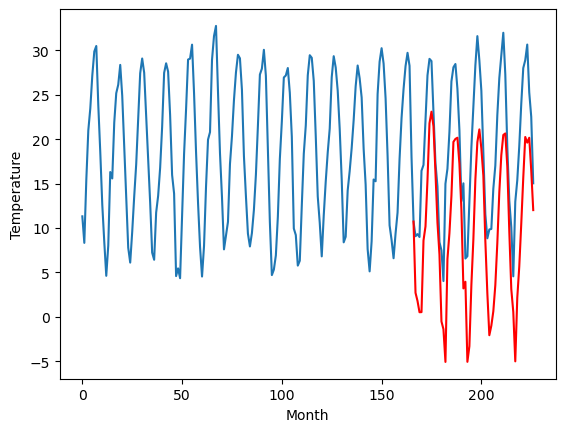

Weather Station 5:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
3.65		2.66		-0.99
1.87		1.68		-0.19
2.49		0.38		-2.11
2.11		0.39		-1.72
9.99		8.51		-1.48
10.68		10.17		-0.51
16.33		15.50		-0.83
21.04		21.94		0.90
23.48		23.21		-0.27
22.80		21.59		-1.21
16.50		16.26		-0.24
10.75		10.50		-0.25
7.99		6.96		-1.03
1.42		-0.55		-1.97
0.82		-1.41		-2.23
-3.07		-5.27		-2.20
7.85		6.50		-1.35
10.03		9.43		-0.60
13.56		13.67		0.11
20.41		19.86		-0.55
21.90		20.20		-1.70
22.27		20.29		-1.98
18.84		17.39		-1.45
13.97		12.07		-1.90
6.13		3.28		-2.85
7.87		3.82		-4.05
-1.03		-5.10		-4.07
-0.41		-3.45		-3.04
6.51		3.55		-2.96
13.20		8.74		-4.46
18.03		15.50		-2.53
22.70		19.80		-2.90
26.12		21.29		-4.83
23.28		19.14		-4.14
19.19		16.06		-3.13
12.04		8.65		-3.39
4.95		2.55		-2.40
1.98		-2.18		-4.16
2.75		-1.13		-3.88
2.98		0.48		-2.50
7.83		3.50		-4.33
10.48		8.31		-2.17
16.64		14.22		-2.42
21.75		18.39		-3.36
24.83		20.64		-4.19
26.70		20.85		-5.85
21.61		17.16		-4.45
1

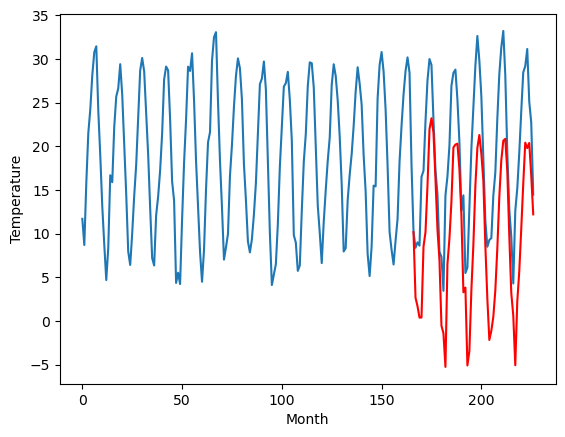

Weather Station 6:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
5.12		3.06		-2.06
3.48		1.85		-1.63
2.75		0.60		-2.15
1.99		0.62		-1.37
9.55		8.16		-1.39
12.52		10.03		-2.49
19.09		15.42		-3.67
22.42		21.73		-0.69
25.25		23.20		-2.05
24.63		21.64		-2.99
16.90		16.36		-0.54
12.94		10.74		-2.20
9.06		6.92		-2.14
2.08		-0.38		-2.46
0.98		-1.32		-2.30
-0.59		-4.71		-4.12
8.66		6.04		-2.62
10.89		9.32		-1.57
16.38		13.54		-2.84
21.34		19.79		-1.55
21.08		20.18		-0.90
21.40		20.17		-1.23
20.71		17.20		-3.51
15.01		11.89		-3.12
8.07		3.34		-4.73
8.48		3.34		-5.14
1.11		-5.00		-6.11
0.91		-3.16		-4.07
8.23		3.48		-4.75
15.74		8.41		-7.33
21.43		15.09		-6.34
23.80		19.36		-4.44
25.70		20.93		-4.77
22.40		19.08		-3.32
19.50		15.93		-3.57
12.69		8.55		-4.14
4.84		2.62		-2.22
3.24		-2.28		-5.52
3.61		-1.19		-4.80
3.78		0.17		-3.61
8.85		3.06		-5.79
13.07		8.13		-4.94
17.99		13.72		-4.27
24.47		17.79		-6.68
25.93		20.45		-5.48
26.02		20.32		-5.70
22.54		16.70		-5.84
1

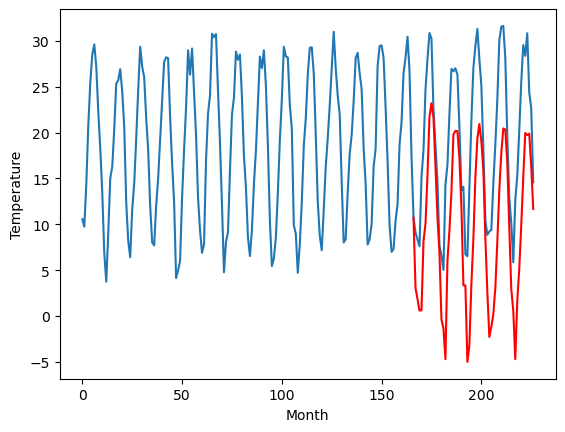

Weather Station 7:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
0.86		0.29		-0.57
0.51		-0.40		-0.91
0.34		-1.44		-1.78
0.81		-1.41		-2.22
6.42		5.85		-0.57
7.69		6.89		-0.80
10.48		11.43		0.95
15.07		17.50		2.43
18.11		19.29		1.18
16.91		17.28		0.37
13.11		12.52		-0.59
9.29		8.08		-1.21
4.98		4.11		-0.87
-2.27		-3.84		-1.57
-2.04		-5.09		-3.05
-1.37		-7.05		-5.68
5.03		2.37		-2.66
7.76		5.34		-2.42
11.21		9.22		-1.99
15.23		14.50		-0.73
16.97		14.93		-2.04
17.10		15.29		-1.81
13.13		12.16		-0.97
9.33		8.21		-1.12
1.17		-1.46		-2.63
3.08		0.30		-2.78
-2.98		-9.08		-6.10
1.30		-5.91		-7.21
4.86		-0.06		-4.92
7.52		4.32		-3.20
13.50		11.09		-2.41
16.71		14.54		-2.17
17.98		15.44		-2.54
16.46		13.72		-2.74
13.37		10.64		-2.73
6.50		3.68		-2.82
3.80		0.39		-3.41
-2.15		-5.19		-3.04
0.87		-3.84		-4.71
4.29		-2.09		-6.38
4.77		-0.13		-4.90
7.88		4.42		-3.46
10.50		8.45		-2.05
14.14		12.49		-1.65
18.01		15.31		-2.70
17.45		14.85		-2.60
13.61		11.42		-2.19
8.17		

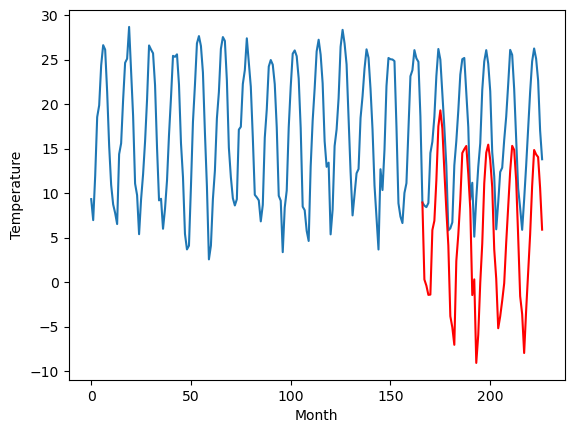

Weather Station 8:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
2.01		0.05		-1.96
1.20		-0.91		-2.11
-0.45		-2.19		-1.74
0.12		-2.24		-2.36
7.05		5.74		-1.31
8.63		7.30		-1.33
12.73		12.64		-0.09
19.08		19.31		0.23
21.62		20.80		-0.82
19.63		18.87		-0.76
16.05		13.54		-2.51
9.12		7.88		-1.24
6.57		4.33		-2.24
0.04		-3.41		-3.45
-1.63		-4.59		-2.96
-5.24		-8.25		-3.01
7.03		3.39		-3.64
8.93		6.45		-2.48
12.97		10.67		-2.30
19.27		16.88		-2.39
20.56		17.18		-3.38
21.08		17.41		-3.67
18.04		14.30		-3.74
12.27		9.34		-2.93
4.33		-0.05		-4.38
5.79		0.68		-5.11
-3.28		-8.70		-5.42
-1.22		-6.57		-5.35
5.44		0.32		-5.12
9.30		5.35		-3.95
14.97		12.48		-2.49
20.29		16.61		-3.68
23.99		18.03		-5.96
20.47		15.97		-4.50
16.88		12.69		-4.19
10.51		5.28		-5.23
3.96		-0.12		-4.08
-0.89		-5.36		-4.47
0.76		-4.17		-4.93
2.90		-2.66		-5.56
4.62		0.02		-4.60
10.24		5.16		-5.08
15.02		10.68		-4.34
19.10		14.91		-4.19
21.06		17.26		-3.80
20.87		17.14		-3.73
16.93		13.60		-3.3

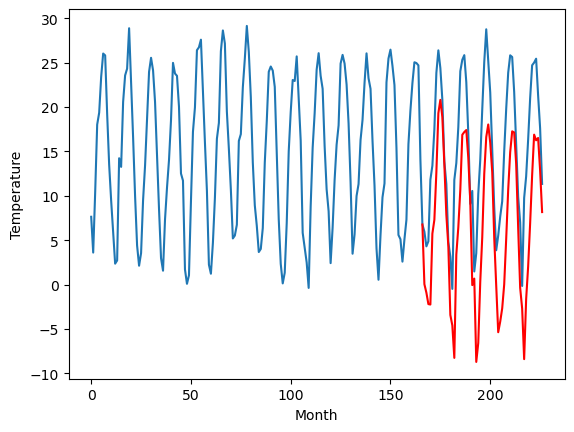

Weather Station 9:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-2.64		-2.37		0.27
-3.46		-3.43		0.03
-4.39		-4.69		-0.30
-5.22		-4.82		0.40
1.60		2.78		1.18
4.59		4.33		-0.26
10.17		9.79		-0.38
17.46		16.78		-0.68
19.50		18.66		-0.84
17.30		16.30		-1.00
13.54		10.90		-2.64
6.70		5.31		-1.39
2.86		1.67		-1.19
-4.65		-6.31		-1.66
-6.23		-7.95		-1.72
-9.59		-11.26		-1.67
2.38		-0.08		-2.46
6.03		3.32		-2.71
10.44		7.55		-2.89
17.68		13.88		-3.80
18.25		14.19		-4.06
19.11		14.53		-4.58
15.62		11.10		-4.52
10.27		6.51		-3.76
-0.59		-3.56		-2.97
-0.27		-2.95		-2.68
-9.11		-12.69		-3.58
-6.09		-9.90		-3.81
1.38		-3.22		-4.60
5.16		1.53		-3.63
13.66		9.17		-4.49
18.14		13.11		-5.03
20.08		14.54		-5.54
17.85		12.72		-5.13
13.94		9.06		-4.88
6.45		1.62		-4.83
0.66		-2.91		-3.57
-5.12		-8.95		-3.83
-3.16		-7.60		-4.44
-1.57		-6.36		-4.79
-0.30		-4.13		-3.83
6.20		1.66		-4.54
11.91		6.63		-5.28
15.79		10.91		-4.88
18.52		13.56		-4.96
17.36		12.84		-4.52
14.27		9.52	

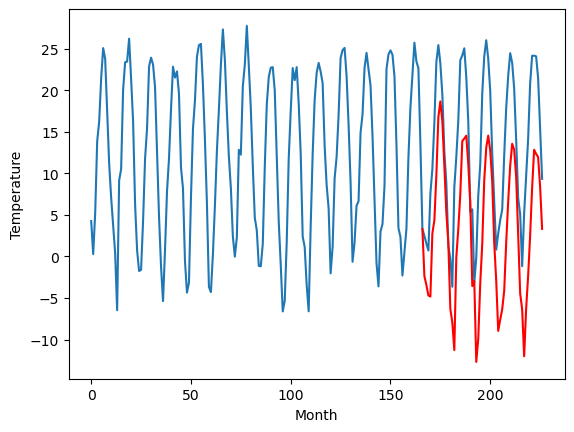

Weather Station 10:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-4.88		-5.14		-0.26
-5.20		-6.32		-1.12
-7.64		-7.79		-0.15
-7.89		-7.93		-0.04
-0.29		0.22		0.51
2.82		2.00		-0.82
8.70		7.77		-0.93
16.43		15.17		-1.26
17.64		16.73		-0.91
15.04		14.44		-0.60
11.14		8.65		-2.49
3.80		2.36		-1.44
1.16		-0.90		-2.06
-6.72		-8.87		-2.15
-8.75		-10.39		-1.64
-13.19		-14.77		-1.58
0.67		-2.18		-2.85
4.38		1.08		-3.30
9.16		5.50		-3.66
16.55		12.28		-4.27
16.26		12.53		-3.73
16.54		12.76		-3.78
13.43		9.38		-4.05
7.97		4.17		-3.80
-2.34		-5.61		-3.27
-2.59		-5.59		-3.00
-12.07		-15.24		-3.17
-9.24		-13.00		-3.76
-1.03		-5.74		-4.71
3.09		-0.66		-3.75
11.62		7.23		-4.39
16.23		11.62		-4.61
17.05		13.23		-3.82
15.75		11.25		-4.50
11.61		7.62		-3.99
4.14		-0.03		-4.17
-1.40		-5.70		-4.30
-8.13		-11.60		-3.47
-5.89		-10.35		-4.46
-4.70		-9.07		-4.37
-2.16		-6.39		-4.23
5.17		-0.39		-5.56
10.93		5.56		-5.37
15.24		9.92		-5.32
16.77		12.18		-4.59
15.51		11.87		-3.64
1

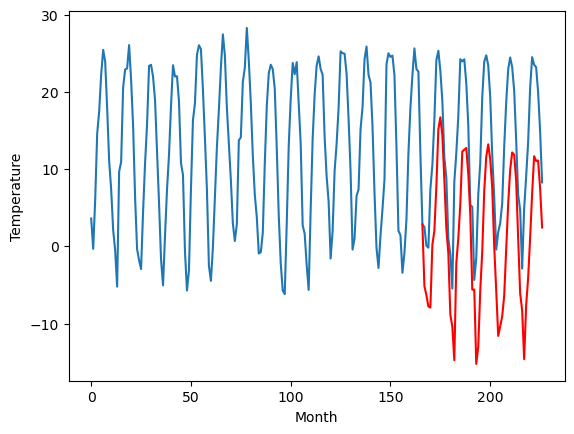

Weather Station 11:
Actual Temp	Predicted Temp	Difference
-----------	--------------	----------
-6.79		-6.75		0.04
-7.57		-7.96		-0.39
-8.77		-9.16		-0.39
-9.58		-9.31		0.27
-3.42		-2.17		1.25
-2.04		-0.55		1.49
4.70		4.99		0.29
11.19		12.01		0.82
14.63		14.19		-0.44
12.22		11.68		-0.54
8.23		6.30		-1.93
2.07		0.85		-1.22
-1.16		-2.98		-1.82
-8.72		-10.96		-2.24
-10.64		-12.85		-2.21
-12.88		-15.69		-2.81
-2.99		-5.24		-2.25
0.81		-1.49		-2.30
5.34		2.72		-2.62
12.23		9.09		-3.14
12.39		9.41		-2.98
13.59		9.77		-3.82
9.30		6.14		-3.16
5.77		1.77		-4.00
-4.63		-8.56		-3.93
-5.49		-8.18		-2.69
-14.32		-17.89		-3.57
-10.76		-14.68		-3.92
-4.79		-8.28		-3.49
-0.79		-3.75		-2.96
7.79		4.05		-3.74
11.06		7.84		-3.22
13.66		9.35		-4.31
12.59		7.78		-4.81
8.54		3.87		-4.67
1.68		-3.53		-5.21
-2.40		-7.51		-5.11
-9.11		-13.99		-4.88
-7.48		-12.53		-5.05
-7.34		-11.55		-4.21
-6.46		-9.61		-3.15
2.01		-3.43		-5.44
5.70		1.08		-4.62
10.01		5.34		-4.67
13.10		8.36		-4.74
11.77		7.17		-4.60
9.43		3.

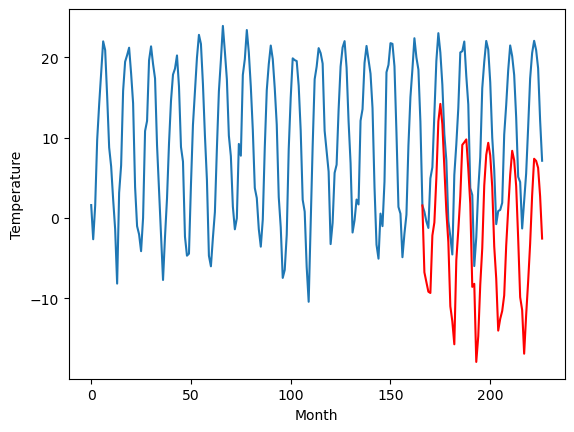

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -2.86  -4.991661
1                 1   -2.38  -4.943648
2                 2    6.75   5.679438
3                 3    4.23   2.697206
4                 4    3.65   2.657935
5                 5    5.12   3.059368
6                 6    0.86   0.285675
7                 7    2.01   0.049812
8                 8   -2.64  -2.366557
9                 9   -4.88  -5.137933
10               10   -6.79  -6.745396


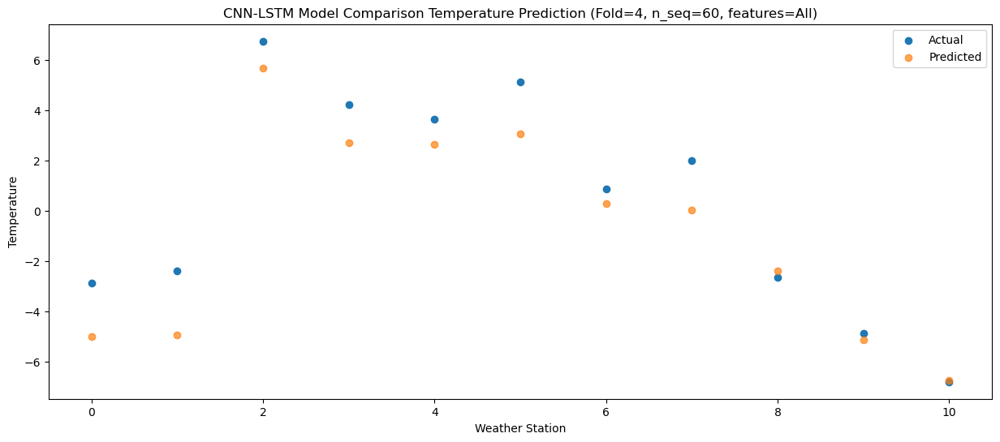

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -4.52  -6.363624
1                 1   -2.56  -5.411486
2                 2    6.81   5.038784
3                 3    2.58   1.775144
4                 4    1.87   1.681707
5                 5    3.48   1.846082
6                 6    0.51  -0.403868
7                 7    1.20  -0.907544
8                 8   -3.46  -3.432600
9                 9   -5.20  -6.315819
10               10   -7.57  -7.964374


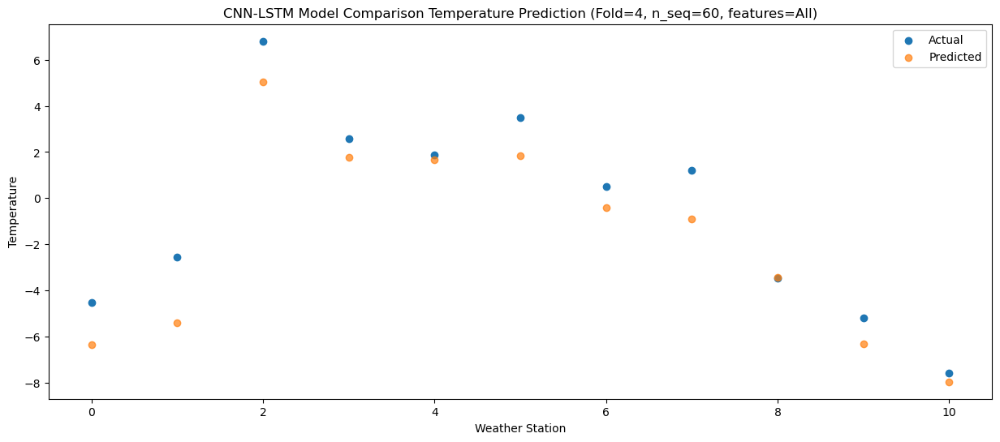

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -7.48  -7.951136
1                 1   -4.02  -6.182306
2                 2    6.62   3.930340
3                 3    2.82   0.508314
4                 4    2.49   0.378817
5                 5    2.75   0.595001
6                 6    0.34  -1.441299
7                 7   -0.45  -2.191117
8                 8   -4.39  -4.691288
9                 9   -7.64  -7.786129
10               10   -8.77  -9.160434


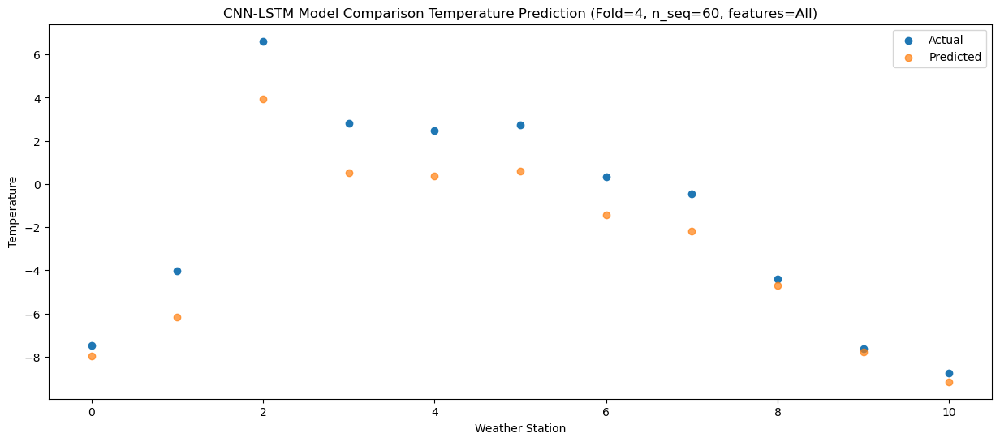

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -6.37  -8.069797
1                 1   -2.47  -5.780453
2                 2    6.88   3.945225
3                 3    2.49   0.519324
4                 4    2.11   0.388753
5                 5    1.99   0.619693
6                 6    0.81  -1.406564
7                 7    0.12  -2.241553
8                 8   -5.22  -4.821595
9                 9   -7.89  -7.934910
10               10   -9.58  -9.314320


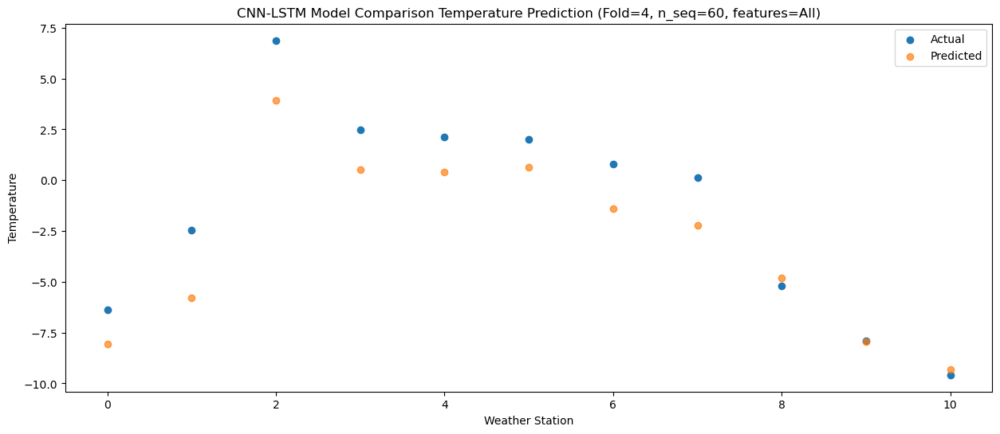

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    1.16   0.256877
1                 1    1.60   0.770078
2                 2   14.68  11.689522
3                 3    9.95   8.587821
4                 4    9.99   8.506234
5                 5    9.55   8.160285
6                 6    6.42   5.848434
7                 7    7.05   5.738182
8                 8    1.60   2.779097
9                 9   -0.29   0.215716
10               10   -3.42  -2.169518


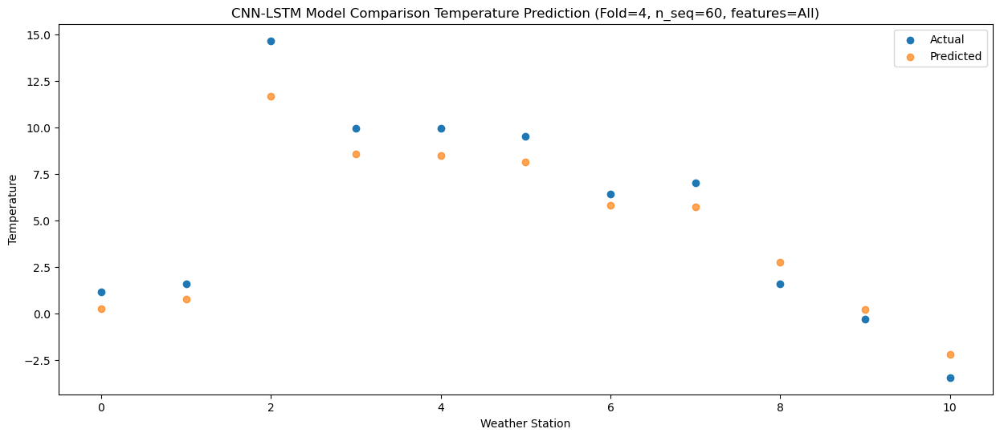

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.59   2.344099
1                 1    3.28   1.604379
2                 2   13.73  12.795374
3                 3   10.61  10.174914
4                 4   10.68  10.170033
5                 5   12.52  10.034977
6                 6    7.69   6.887601
7                 7    8.63   7.297499
8                 8    4.59   4.332692
9                 9    2.82   1.995637
10               10   -2.04  -0.551975


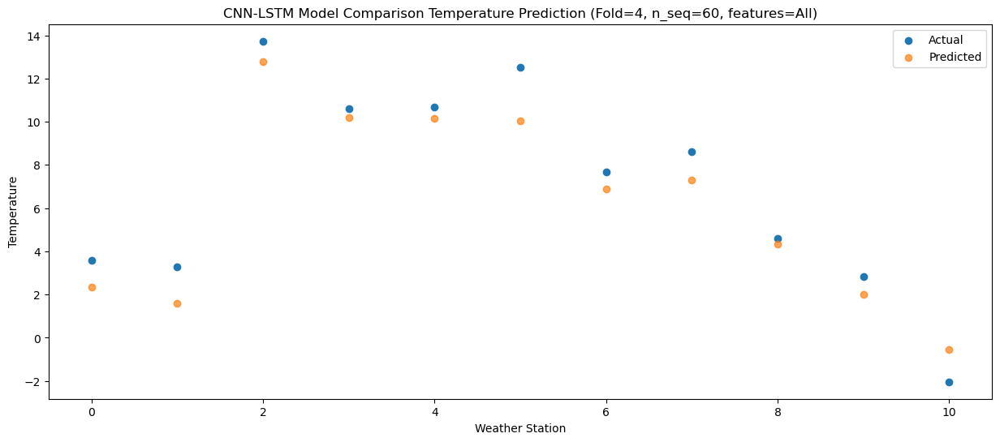

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    8.66   8.354342
1                 1    4.68   5.129303
2                 2   17.61  17.499967
3                 3   15.74  15.425980
4                 4   16.33  15.501973
5                 5   19.09  15.417415
6                 6   10.48  11.430146
7                 7   12.73  12.642636
8                 8   10.17   9.791338
9                 9    8.70   7.774713
10               10    4.70   4.990664


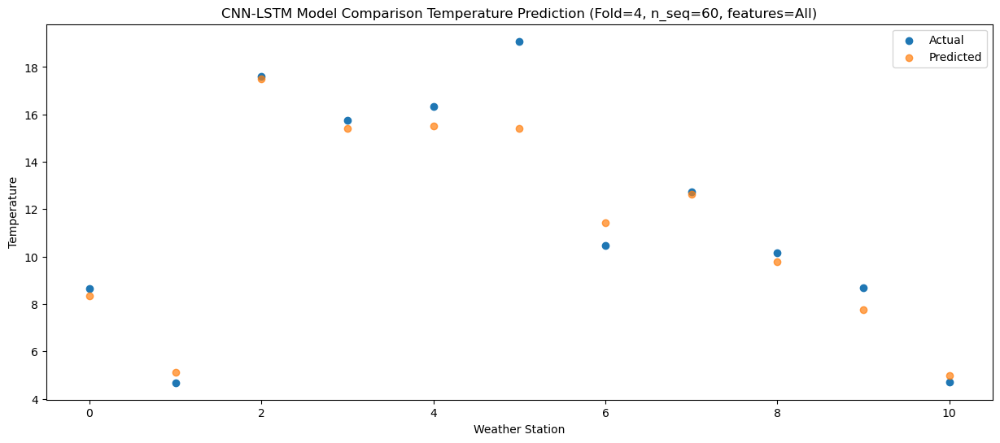

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   17.91  15.804020
1                 1    6.44  10.009412
2                 2   21.70  23.525233
3                 3   20.70  21.792686
4                 4   21.04  21.943525
5                 5   22.42  21.726785
6                 6   15.07  17.502292
7                 7   19.08  19.306212
8                 8   17.46  16.779400
9                 9   16.43  15.172515
10               10   11.19  12.009260


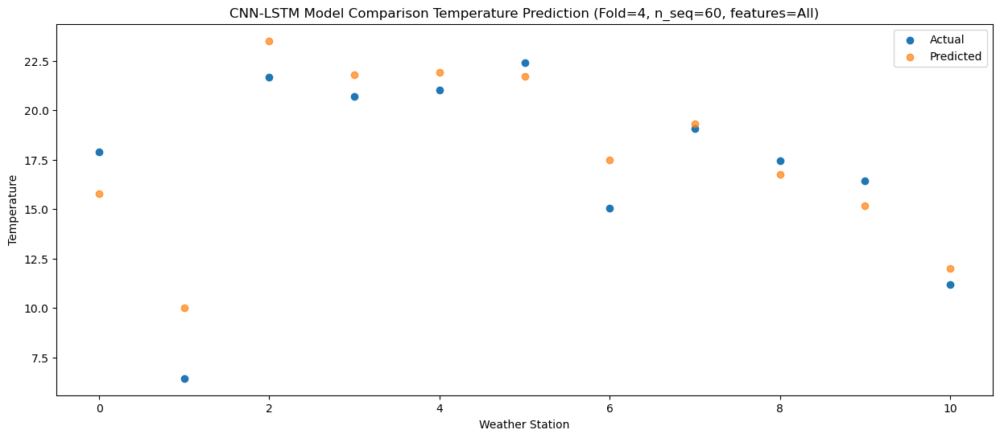

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   18.72  17.112189
1                 1    6.76  11.558792
2                 2   23.27  25.052304
3                 3   22.56  23.097758
4                 4   23.48  23.205473
5                 5   25.25  23.200256
6                 6   18.11  19.292324
7                 7   21.62  20.802455
8                 8   19.50  18.655602
9                 9   17.64  16.729568
10               10   14.63  14.187576


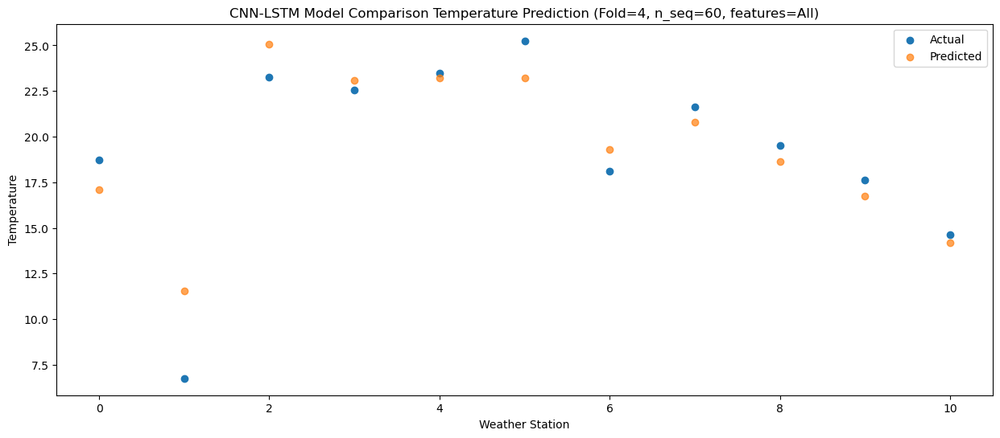

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   16.62  15.105540
1                 1    6.61  10.273300
2                 2   22.44  23.260370
3                 3   22.31  21.465894
4                 4   22.80  21.591884
5                 5   24.63  21.643377
6                 6   16.91  17.275893
7                 7   19.63  18.869516
8                 8   17.30  16.296342
9                 9   15.04  14.443746
10               10   12.22  11.684524


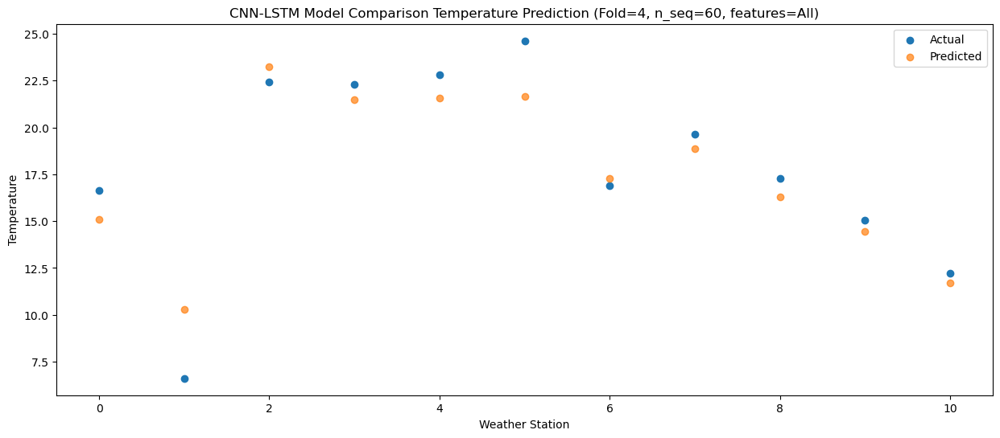

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0   11.78   9.082290
1                 1    6.03   6.261428
2                 2   20.34  18.425597
3                 3   16.53  16.217485
4                 4   16.50  16.258187
5                 5   16.90  16.363073
6                 6   13.11  12.523865
7                 7   16.05  13.536855
8                 8   13.54  10.896924
9                 9   11.14   8.645845
10               10    8.23   6.302847


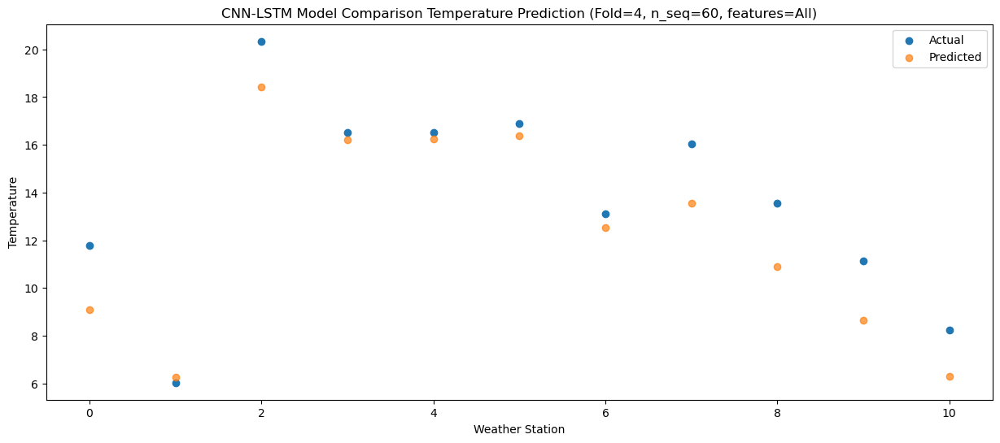

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    3.73   2.343296
1                 1    4.53   2.990107
2                 2   15.00  13.637254
3                 3   10.80  10.600069
4                 4   10.75  10.503899
5                 5   12.94  10.742662
6                 6    9.29   8.083680
7                 7    9.12   7.876513
8                 8    6.70   5.307357
9                 9    3.80   2.357161
10               10    2.07   0.853472


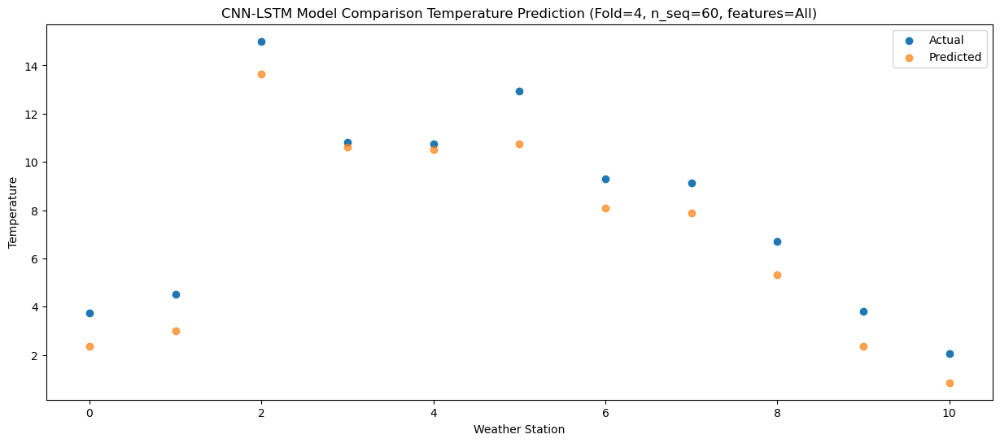

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.54  -0.809739
1                 1    1.14  -1.467310
2                 2   11.00   9.844444
3                 3    8.19   7.016588
4                 4    7.99   6.963115
5                 5    9.06   6.921634
6                 6    4.98   4.107487
7                 7    6.57   4.330119
8                 8    2.86   1.672267
9                 9    1.16  -0.904416
10               10   -1.16  -2.983863


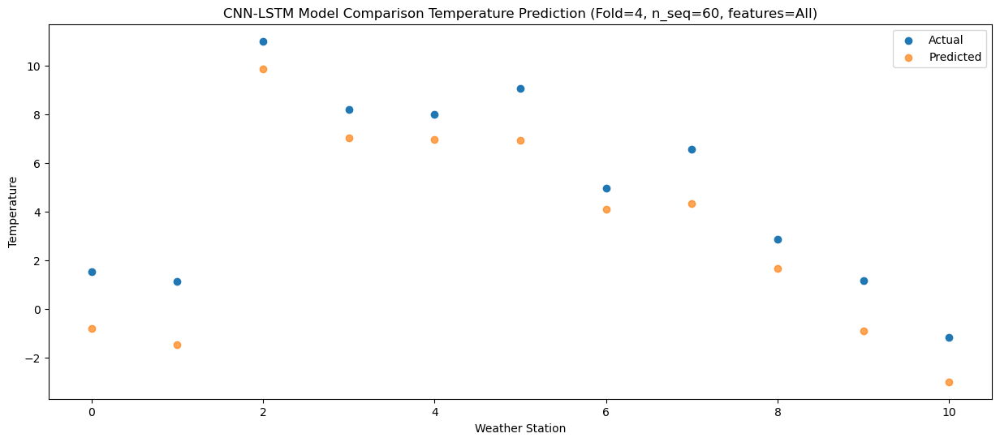

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -5.84  -8.502856
1                 1   -6.61  -8.926751
2                 2    4.75   2.042113
3                 3    1.91  -0.526410
4                 4    1.42  -0.551878
5                 5    2.08  -0.378999
6                 6   -2.27  -3.835672
7                 7    0.04  -3.413609
8                 8   -4.65  -6.308107
9                 9   -6.72  -8.867789
10               10   -8.72 -10.963658


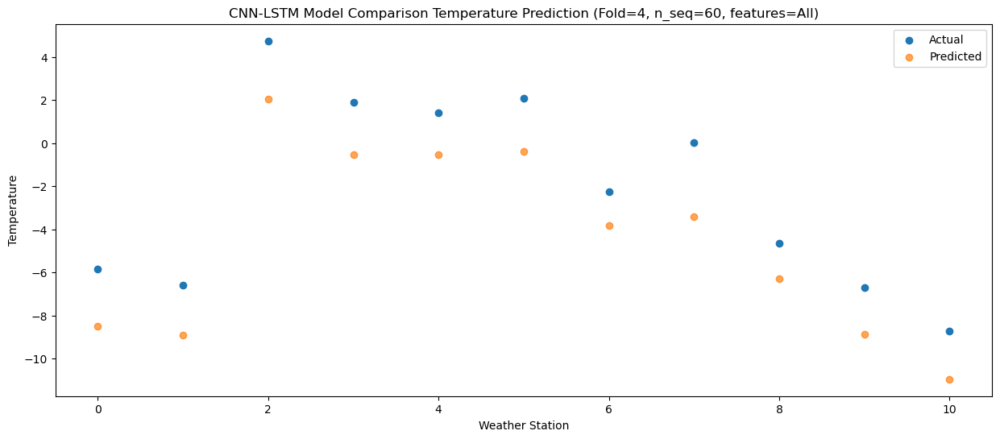

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -7.35  -9.781631
1                 1   -5.91  -9.512191
2                 2    4.78   1.024768
3                 3    0.99  -1.403365
4                 4    0.82  -1.412904
5                 5    0.98  -1.320035
6                 6   -2.04  -5.089118
7                 7   -1.63  -4.588196
8                 8   -6.23  -7.954074
9                 9   -8.75 -10.390374
10               10  -10.64 -12.846015


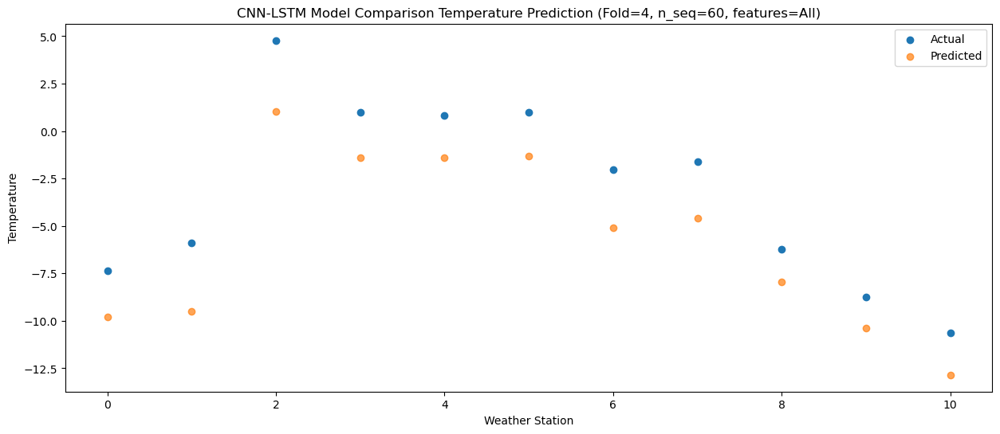

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0  -13.48 -14.769708
1                 1   -2.48 -10.089516
2                 2    2.86  -1.607705
3                 3   -2.47  -5.089331
4                 4   -3.07  -5.269178
5                 5   -0.59  -4.707798
6                 6   -1.37  -7.050091
7                 7   -5.24  -8.247952
8                 8   -9.59 -11.263468
9                 9  -13.19 -14.772362
10               10  -12.88 -15.694430


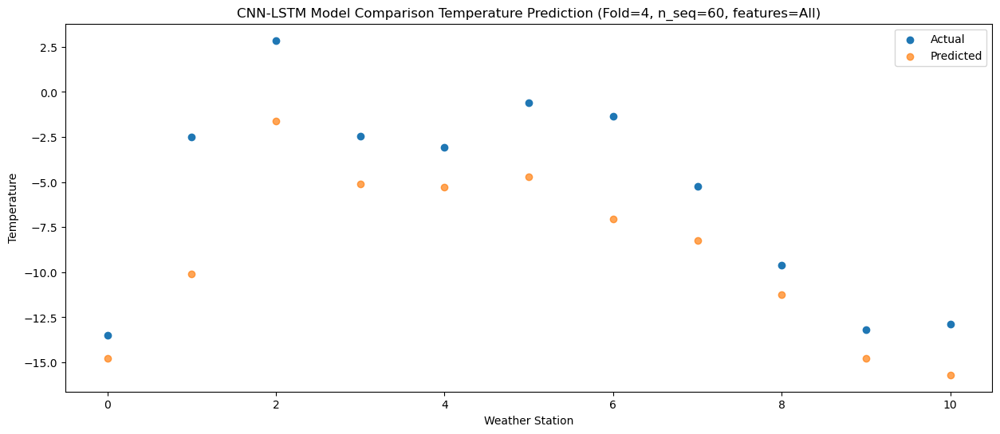

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    1.25  -1.636669
1                 1   -0.88  -2.965549
2                 2   12.19   8.796298
3                 3    8.49   6.497394
4                 4    7.85   6.495113
5                 5    8.66   6.035592
6                 6    5.03   2.369696
7                 7    7.03   3.387070
8                 8    2.38  -0.079036
9                 9    0.67  -2.181155
10               10   -2.99  -5.238196


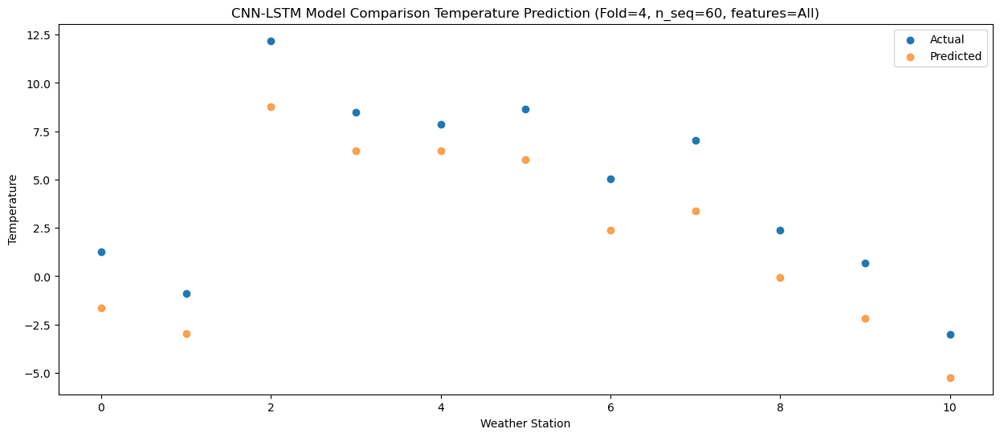

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    4.16   1.620929
1                 1    0.56  -0.408406
2                 2   13.26  11.588942
3                 3   10.18   9.418921
4                 4   10.03   9.434977
5                 5   10.89   9.317075
6                 6    7.76   5.344225
7                 7    8.93   6.448063
8                 8    6.03   3.318213
9                 9    4.38   1.077257
10               10    0.81  -1.494591


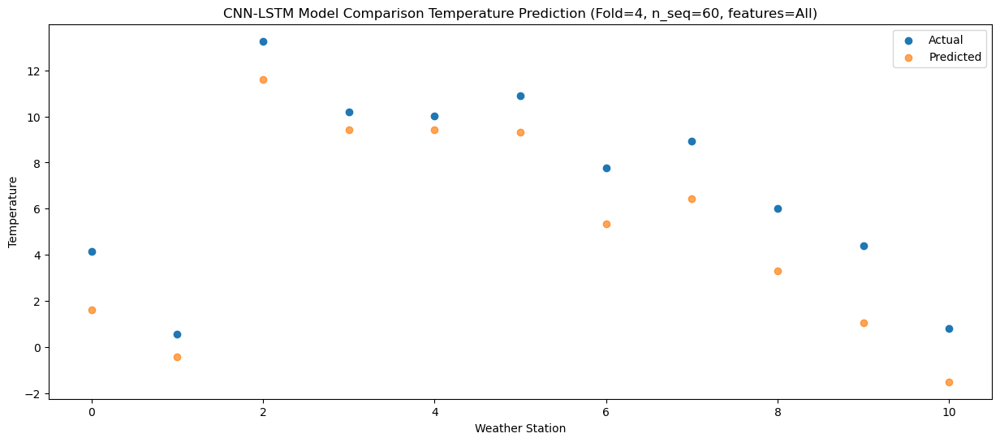

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    8.37   6.173404
1                 1    4.60   3.091123
2                 2   17.73  15.552642
3                 3   14.34  13.617596
4                 4   13.56  13.671711
5                 5   16.38  13.541149
6                 6   11.21   9.216781
7                 7   12.97  10.674835
8                 8   10.44   7.551158
9                 9    9.16   5.502635
10               10    5.34   2.721944


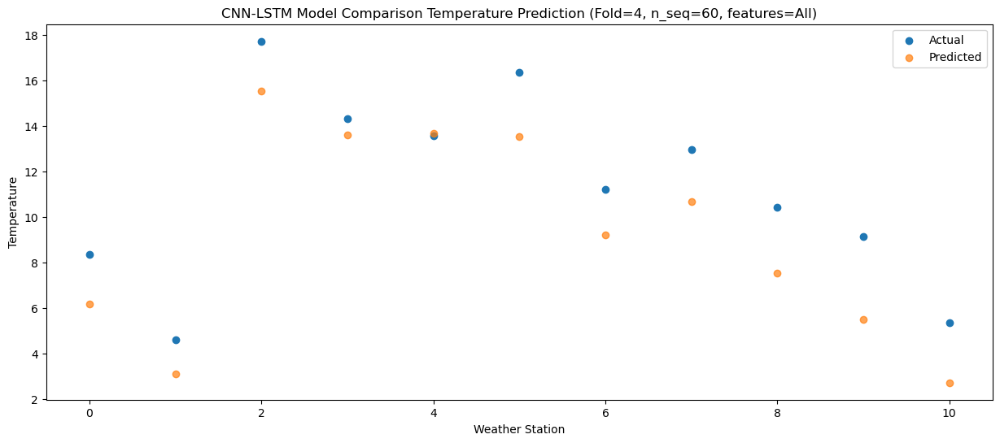

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   16.28  13.263594
1                 1    6.23   7.307435
2                 2   21.99  20.983420
3                 3   20.02  19.697548
4                 4   20.41  19.862883
5                 5   21.34  19.788322
6                 6   15.23  14.501106
7                 7   19.27  16.876032
8                 8   17.68  13.880374
9                 9   16.55  12.284673
10               10   12.23   9.094351


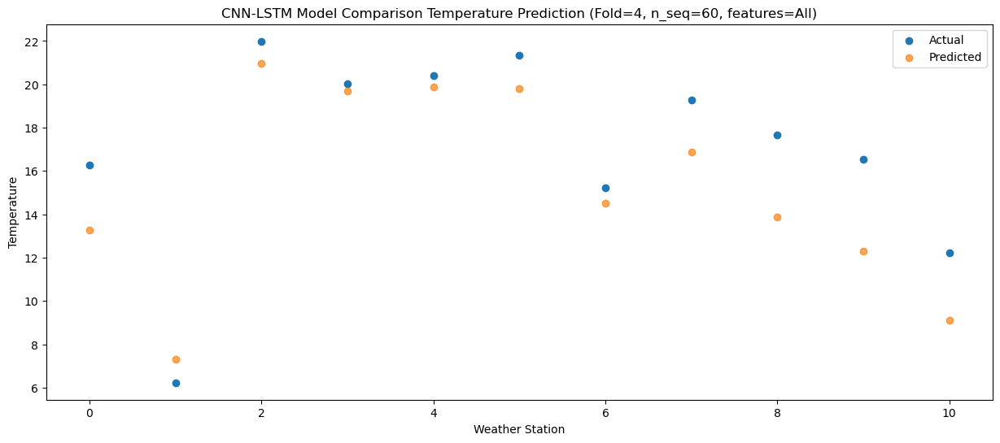

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   17.08  13.505188
1                 1    6.60   7.850683
2                 2   22.65  21.332489
3                 3   21.61  20.031055
4                 4   21.90  20.197306
5                 5   21.08  20.184020
6                 6   16.97  14.934058
7                 7   20.56  17.183006
8                 8   18.25  14.193513
9                 9   16.26  12.534335
10               10   12.39   9.410687


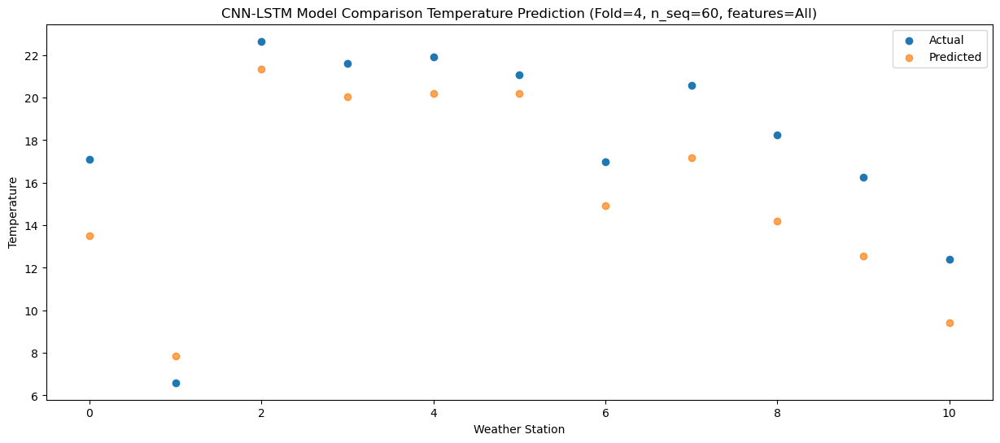

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   17.48  13.525436
1                 1    6.88   8.036172
2                 2   23.30  21.658534
3                 3   21.98  20.164523
4                 4   22.27  20.293804
5                 5   21.40  20.167911
6                 6   17.10  15.289473
7                 7   21.08  17.406719
8                 8   19.11  14.533522
9                 9   16.54  12.756553
10               10   13.59   9.772446


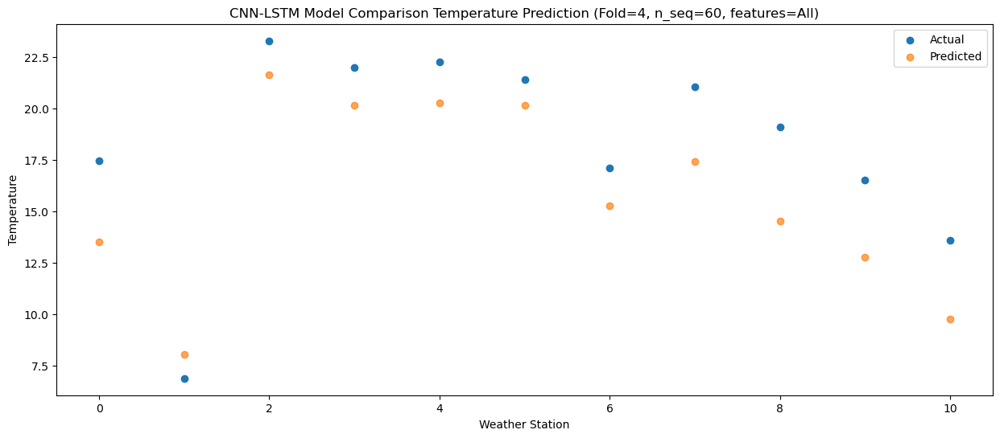

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0   14.29  10.284228
1                 1    5.59   5.419674
2                 2   20.18  18.656365
3                 3   19.19  17.254591
4                 4   18.84  17.386566
5                 5   20.71  17.200018
6                 6   13.13  12.158004
7                 7   18.04  14.297431
8                 8   15.62  11.101355
9                 9   13.43   9.379103
10               10    9.30   6.137186


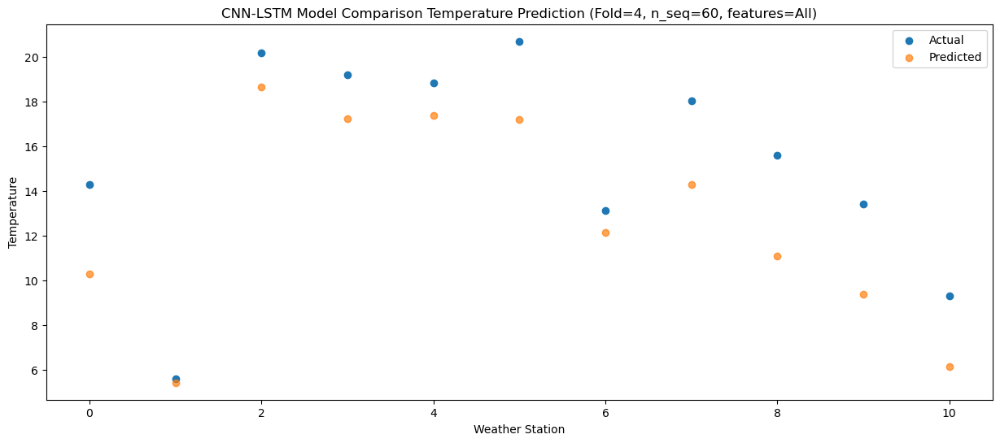

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    7.16   4.454644
1                 1    3.75   1.789732
2                 2   16.79  14.354281
3                 3   14.54  12.082514
4                 4   13.97  12.073503
5                 5   15.01  11.894093
6                 6    9.33   8.208984
7                 7   12.27   9.336923
8                 8   10.27   6.510964
9                 9    7.97   4.166416
10               10    5.77   1.770626


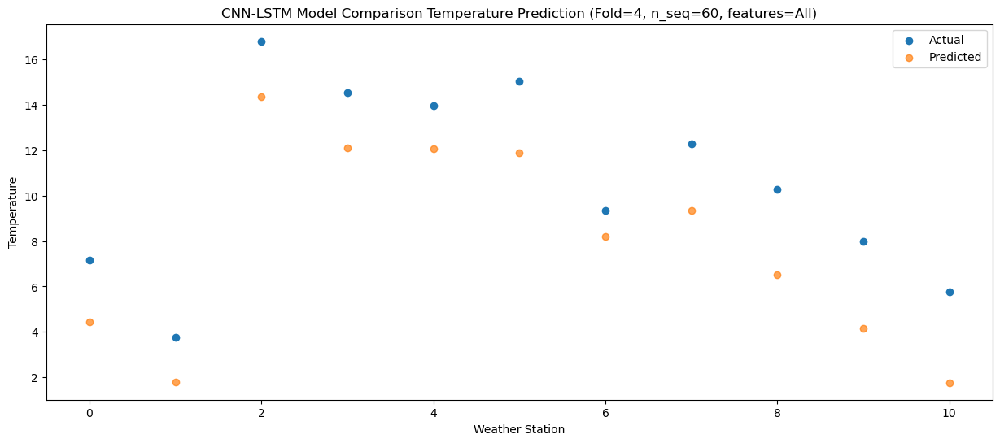

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    0.10  -4.650328
1                 1   -3.41  -6.609527
2                 2    8.12   4.928028
3                 3    6.54   3.192662
4                 4    6.13   3.277174
5                 5    8.07   3.341459
6                 6    1.17  -1.460619
7                 7    4.33  -0.052359
8                 8   -0.59  -3.563036
9                 9   -2.34  -5.605388
10               10   -4.63  -8.557233


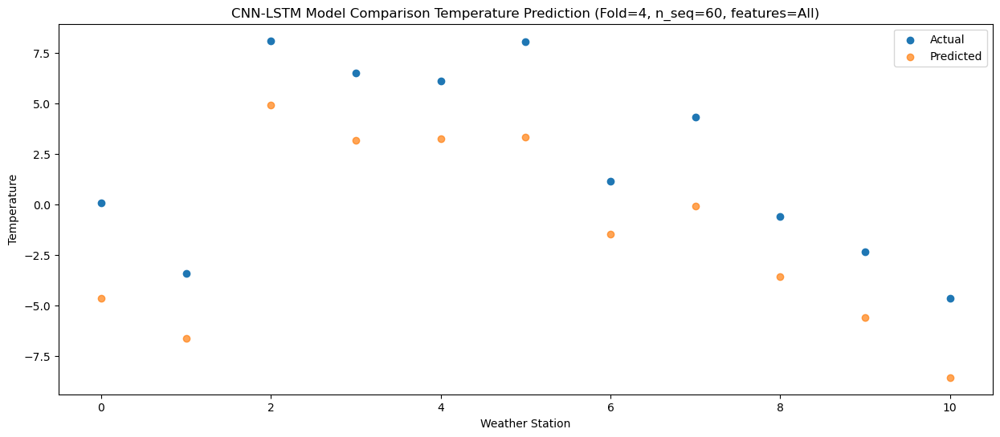

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0   -1.69  -5.375395
1                 1   -1.61  -4.310731
2                 2   11.63   6.703197
3                 3    8.54   3.939711
4                 4    7.87   3.824347
5                 5    8.48   3.336416
6                 6    3.08   0.303931
7                 7    5.79   0.679148
8                 8   -0.27  -2.948362
9                 9   -2.59  -5.591062
10               10   -5.49  -8.176563


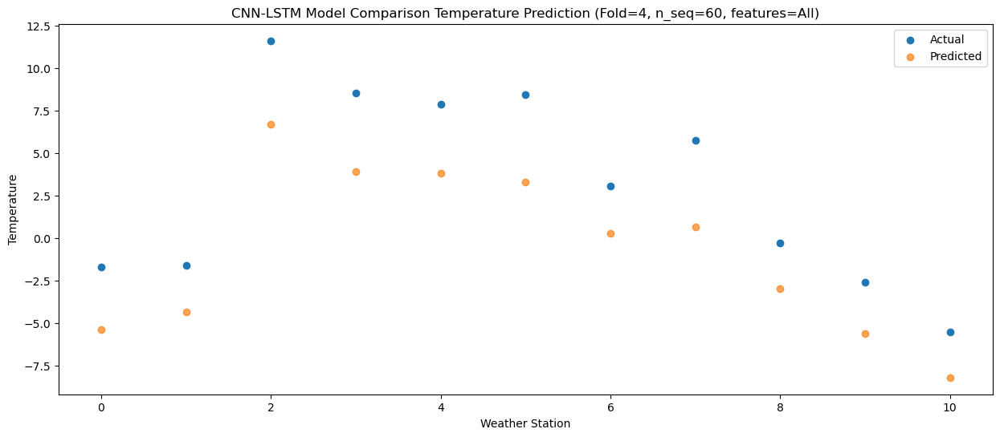

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0  -10.07 -14.425536
1                 1   -6.37 -12.435151
2                 2    3.35  -2.788662
3                 3    0.07  -5.079036
4                 4   -1.03  -5.103348
5                 5    1.11  -5.003578
6                 6   -2.98  -9.084513
7                 7   -3.28  -8.702672
8                 8   -9.11 -12.686913
9                 9  -12.07 -15.236376
10               10  -14.32 -17.885698


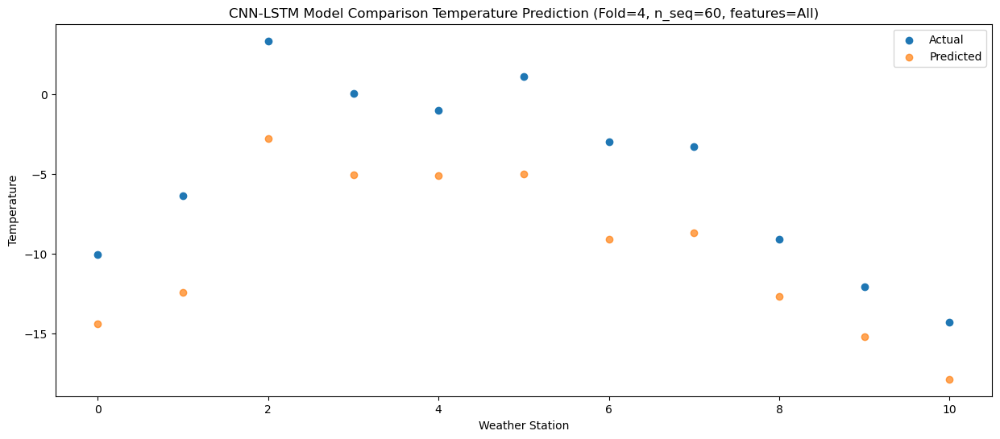

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -8.00 -12.778605
1                 1   -2.94  -9.332242
2                 2    5.71  -0.254818
3                 3    0.33  -3.320824
4                 4   -0.41  -3.446133
5                 5    0.91  -3.164756
6                 6    1.30  -5.911409
7                 7   -1.22  -6.568564
8                 8   -6.09  -9.896660
9                 9   -9.24 -13.002044
10               10  -10.76 -14.684729


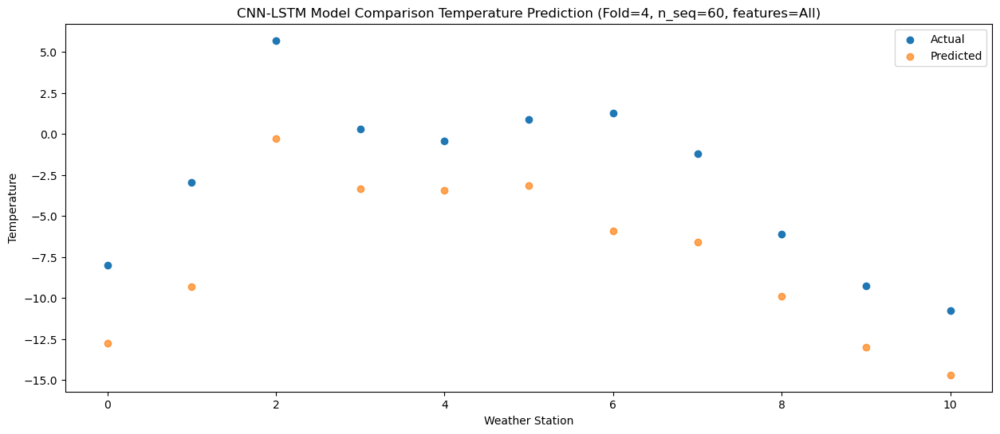

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -1.29  -5.221902
1                 1   -0.12  -4.440715
2                 2   10.45   6.046152
3                 3    6.51   3.590960
4                 4    6.51   3.549107
5                 5    8.23   3.475117
6                 6    4.86  -0.064012
7                 7    5.44   0.323704
8                 8    1.38  -3.216488
9                 9   -1.03  -5.736701
10               10   -4.79  -8.275342


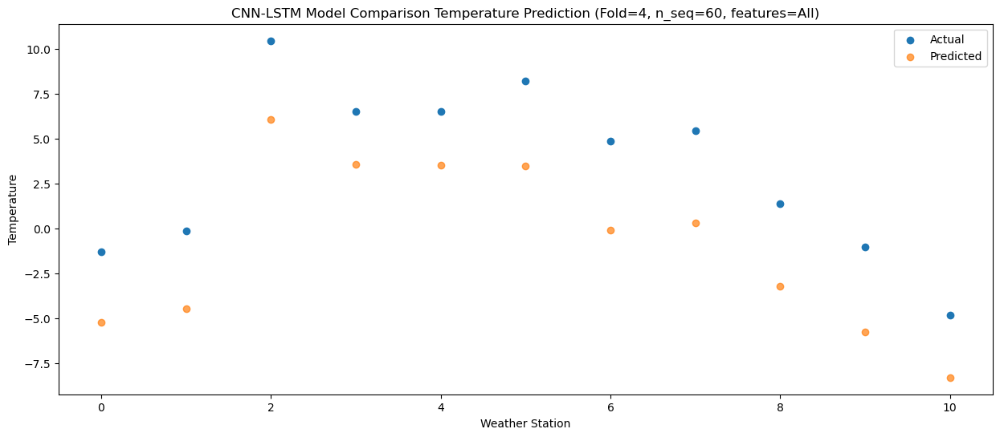

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    3.59   0.062384
1                 1    2.22  -0.525336
2                 2   14.66  10.819697
3                 3   12.56   8.737595
4                 4   13.20   8.742885
5                 5   15.74   8.408747
6                 6    7.52   4.319243
7                 7    9.30   5.345697
8                 8    5.16   1.532193
9                 9    3.09  -0.657662
10               10   -0.79  -3.753693


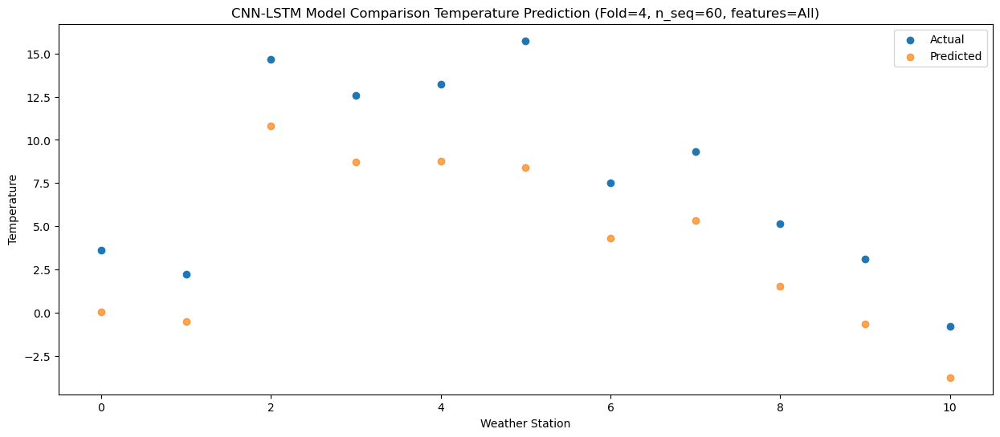

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0   10.53   7.829983
1                 1    5.04   4.997822
2                 2   20.46  17.459013
3                 3   17.27  15.459809
4                 4   18.03  15.499469
5                 5   21.43  15.087840
6                 6   13.50  11.090103
7                 7   14.97  12.481249
8                 8   13.66   9.172500
9                 9   11.62   7.229344
10               10    7.79   4.047353


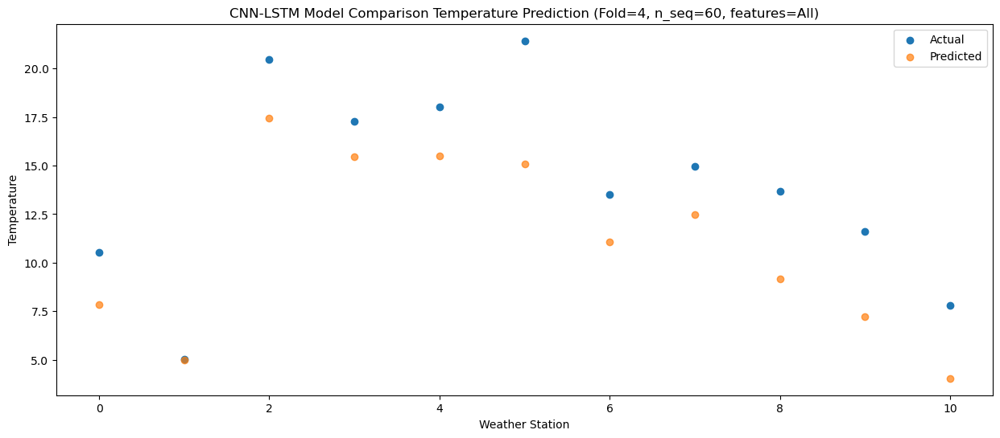

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   16.44  12.595138
1                 1    6.76   8.139015
2                 2   23.75  21.110898
3                 3   21.82  19.671399
4                 4   22.70  19.803874
5                 5   23.80  19.358094
6                 6   16.71  14.535802
7                 7   20.29  16.611683
8                 8   18.14  13.113360
9                 9   16.23  11.618171
10               10   11.06   7.843316


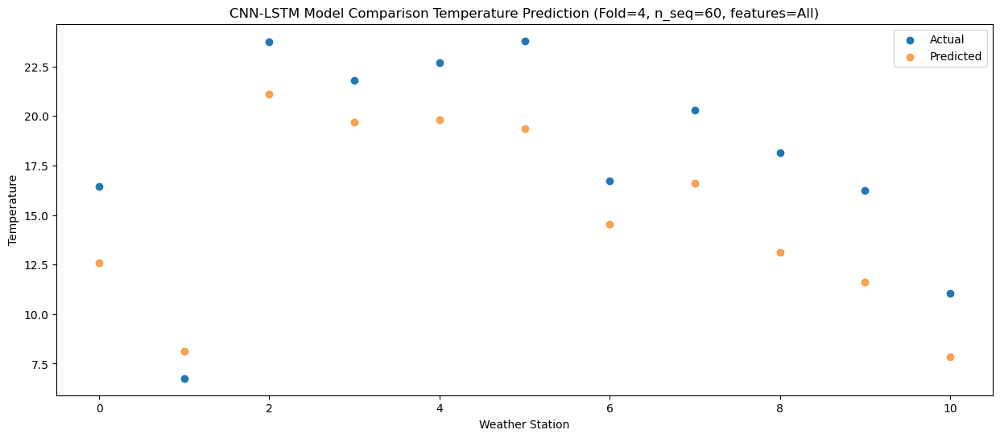

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   18.96  14.410910
1                 1    7.13   8.590614
2                 2   23.95  22.155067
3                 3   25.12  21.103184
4                 4   26.12  21.293169
5                 5   25.70  20.930134
6                 6   17.98  15.443797
7                 7   23.99  18.031772
8                 8   20.08  14.542456
9                 9   17.05  13.227754
10               10   13.66   9.349360


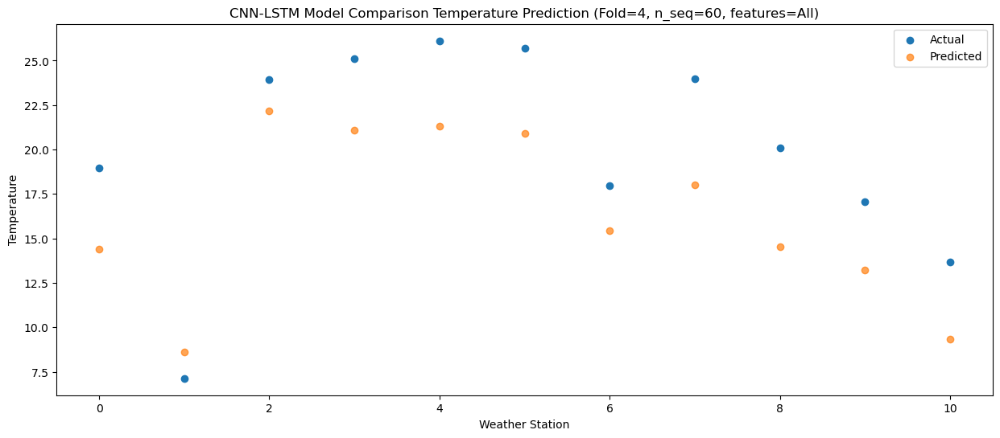

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   17.30  12.403703
1                 1    7.08   7.173982
2                 2   22.41  20.136638
3                 3   22.39  18.952276
4                 4   23.28  19.139552
5                 5   22.40  19.080797
6                 6   16.46  13.721238
7                 7   20.47  15.973893
8                 8   17.85  12.719592
9                 9   15.75  11.251490
10               10   12.59   7.777022


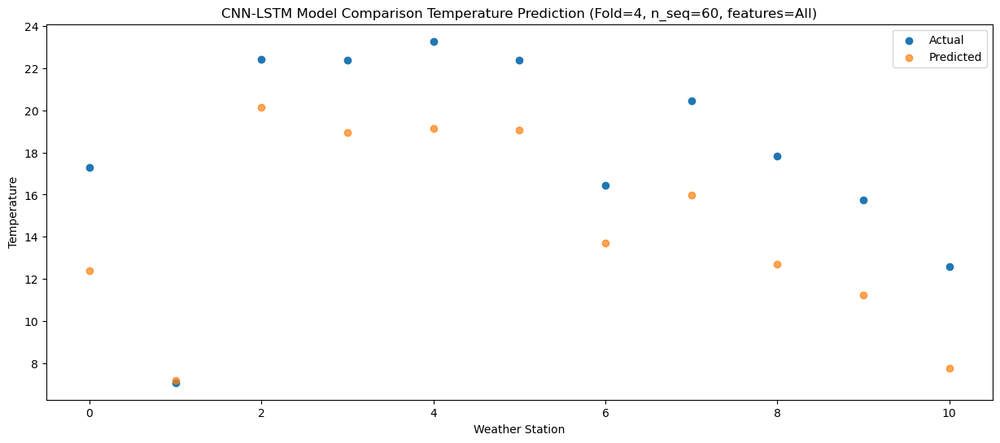

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0   13.39   8.887419
1                 1    5.64   4.943189
2                 2   20.34  17.167207
3                 3   18.96  15.887940
4                 4   19.19  16.063152
5                 5   19.50  15.928902
6                 6   13.37  10.642894
7                 7   16.88  12.687265
8                 8   13.94   9.056059
9                 9   11.61   7.623332
10               10    8.54   3.865107


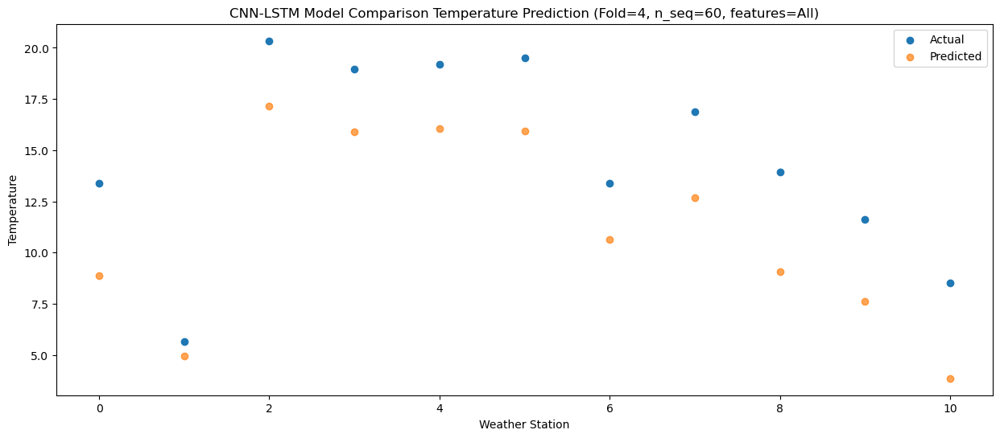

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    6.04   1.101251
1                 1    1.81  -1.464361
2                 2   14.21  10.127841
3                 3   12.09   8.524973
4                 4   12.04   8.649354
5                 5   12.69   8.547308
6                 6    6.50   3.677190
7                 7   10.51   5.282614
8                 8    6.45   1.620686
9                 9    4.14  -0.032110
10               10    1.68  -3.530118


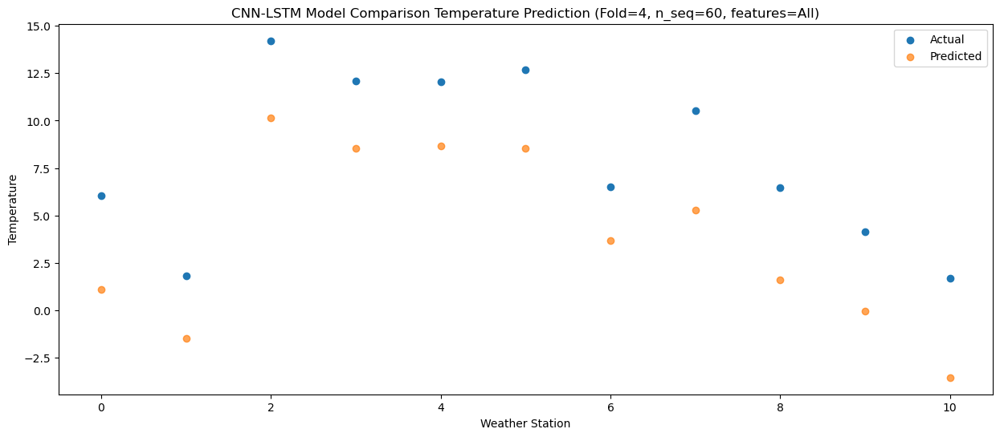

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -2.29  -5.674878
1                 1    0.35  -4.110658
2                 2    9.62   5.866436
3                 3    5.04   2.656324
4                 4    4.95   2.551274
5                 5    4.84   2.622308
6                 6    3.80   0.388094
7                 7    3.96  -0.116159
8                 8    0.66  -2.910403
9                 9   -1.40  -5.703173
10               10   -2.40  -7.512234


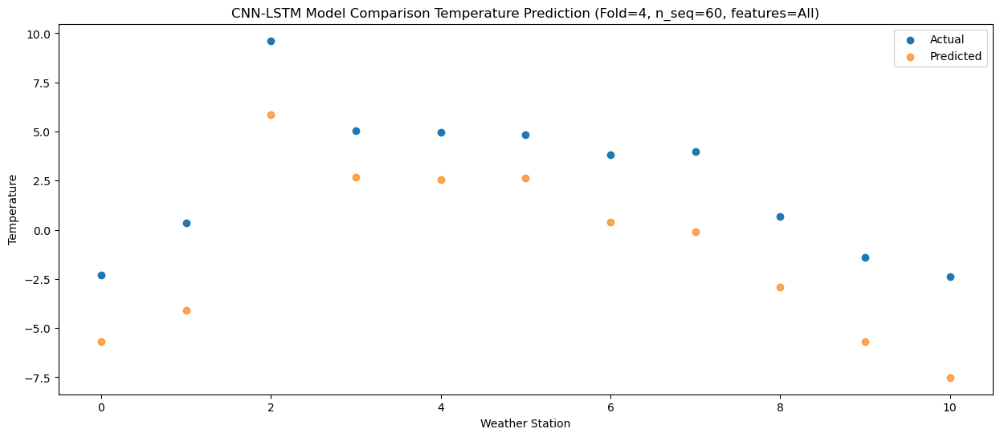

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -8.43 -11.222969
1                 1   -4.50  -8.746445
2                 2    7.19   0.845351
3                 3    2.35  -2.081199
4                 4    1.98  -2.181658
5                 5    3.24  -2.277957
6                 6   -2.15  -5.187519
7                 7   -0.89  -5.358135
8                 8   -5.12  -8.951925
9                 9   -8.13 -11.604100
10               10   -9.11 -13.991977


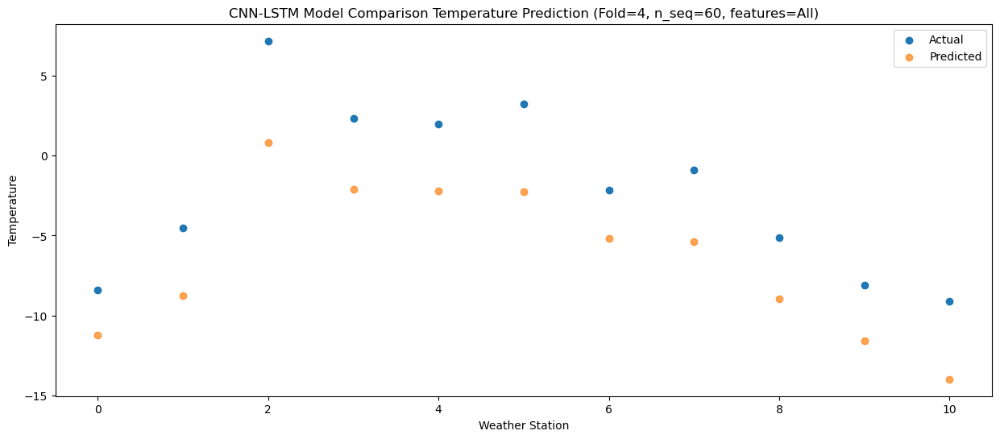

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -6.47 -10.087665
1                 1   -4.65  -7.563426
2                 2    7.60   2.050475
3                 3    3.34  -1.006934
4                 4    2.75  -1.129358
5                 5    3.61  -1.187023
6                 6    0.87  -3.841974
7                 7    0.76  -4.166901
8                 8   -3.16  -7.596907
9                 9   -5.89 -10.349398
10               10   -7.48 -12.531201


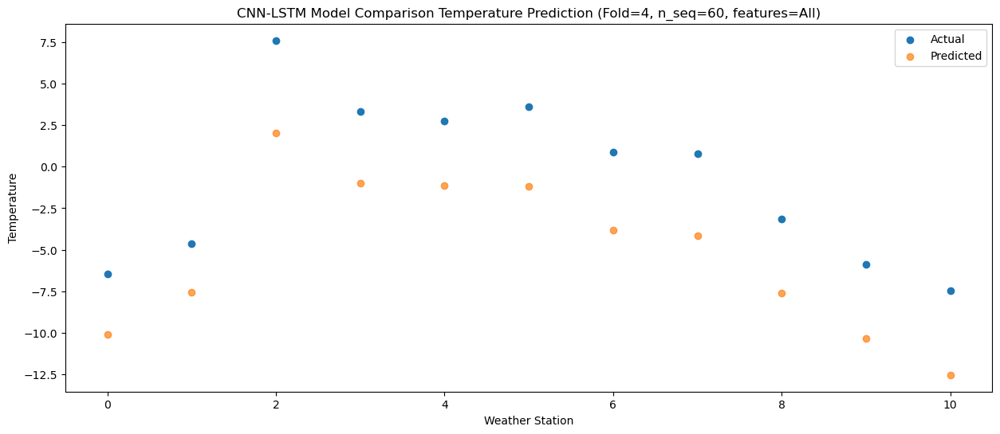

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -4.72  -8.841118
1                 1   -1.35  -5.399179
2                 2    9.54   3.881378
3                 3    3.40   0.620225
4                 4    2.98   0.476075
5                 5    3.78   0.174673
6                 6    4.29  -2.089264
7                 7    2.90  -2.664927
8                 8   -1.57  -6.355011
9                 9   -4.70  -9.066761
10               10   -7.34 -11.550336


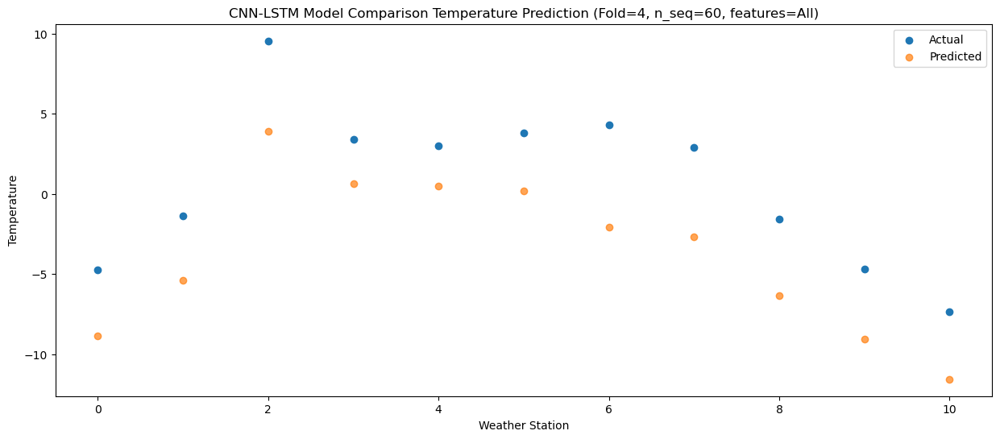

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -2.54  -5.725156
1                 1    0.37  -3.488606
2                 2   11.69   6.300379
3                 3    7.93   3.564888
4                 4    7.83   3.499961
5                 5    8.85   3.064282
6                 6    4.77  -0.129666
7                 7    4.62   0.024677
8                 8   -0.30  -4.128727
9                 9   -2.16  -6.391089
10               10   -6.46  -9.613815


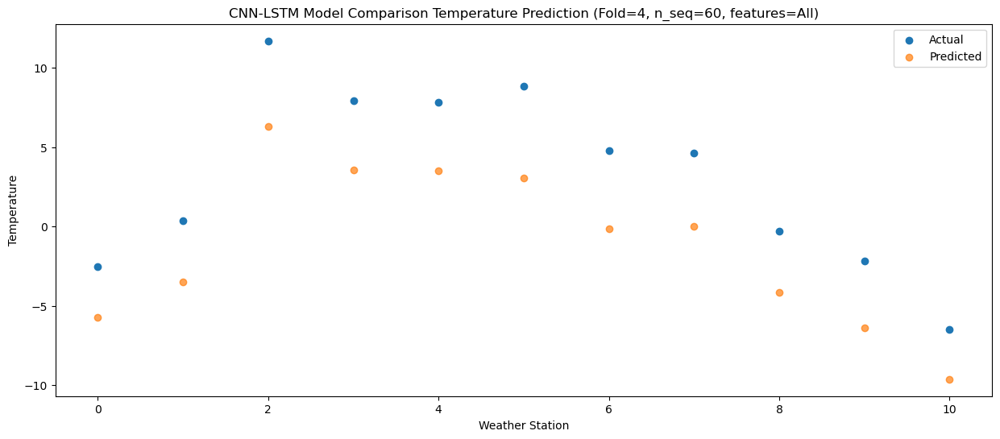

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    5.29   0.317572
1                 1    3.09  -0.360553
2                 2   13.44  10.600723
3                 3   10.53   8.291532
4                 4   10.48   8.312308
5                 5   13.07   8.130304
6                 6    7.88   4.421673
7                 7   10.24   5.159392
8                 8    6.20   1.658407
9                 9    5.17  -0.391553
10               10    2.01  -3.432856


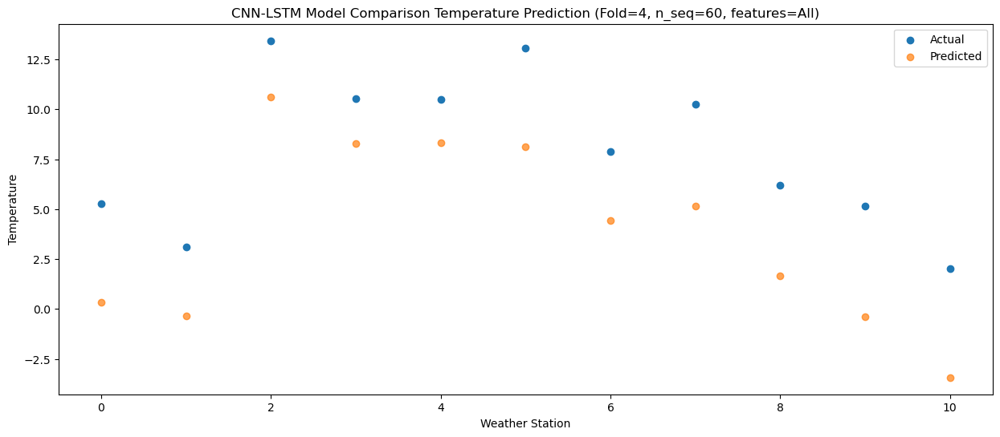

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0   11.10   6.991554
1                 1    3.87   2.906991
2                 2   18.30  15.329841
3                 3   16.21  14.029707
4                 4   16.64  14.216357
5                 5   17.99  13.723253
6                 6   10.50   8.448669
7                 7   15.02  10.678041
8                 8   11.91   6.627739
9                 9   10.93   5.556563
10               10    5.70   1.077642


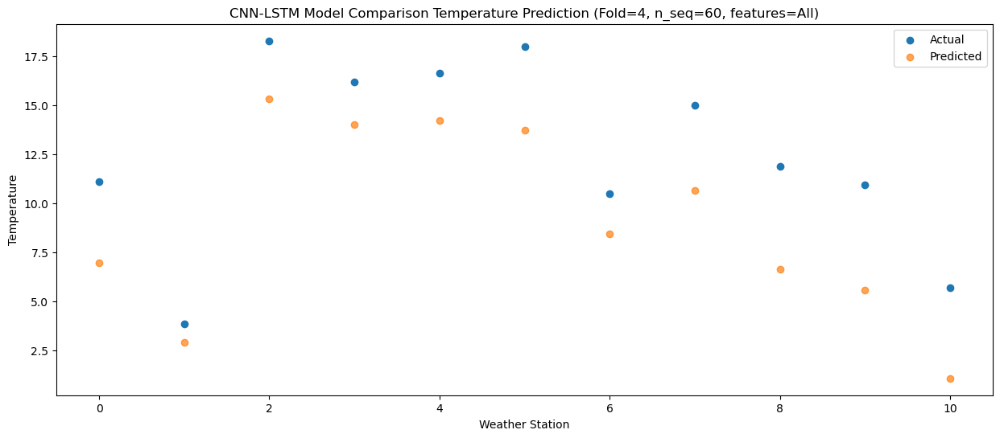

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   16.01  11.328834
1                 1    6.08   6.459864
2                 2   21.89  19.460084
3                 3   20.40  18.201965
4                 4   21.75  18.393303
5                 5   24.47  17.792259
6                 6   14.14  12.486410
7                 7   19.10  14.907538
8                 8   15.79  10.905977
9                 9   15.24   9.919996
10               10   10.01   5.343923


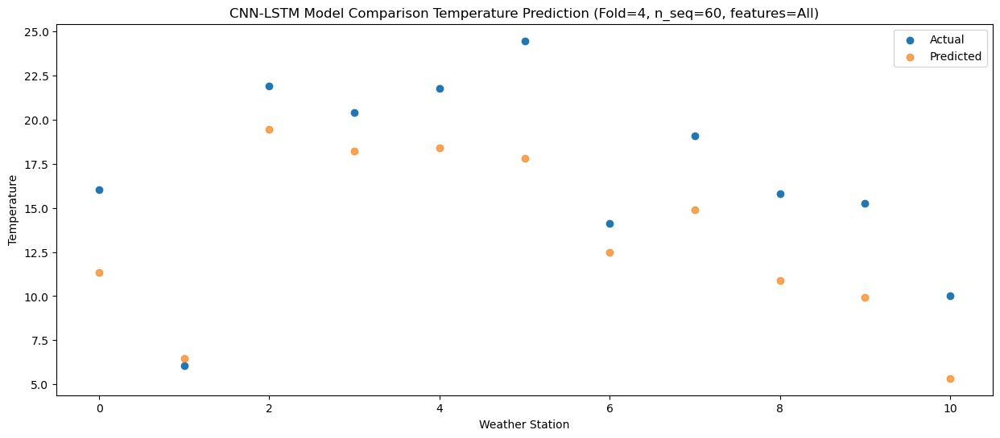

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   17.32  13.455376
1                 1    7.69   9.593352
2                 2   23.67  21.894633
3                 3   22.95  20.476139
4                 4   24.83  20.640403
5                 5   25.93  20.453345
6                 6   18.01  15.306132
7                 7   21.06  17.259586
8                 8   18.52  13.562720
9                 9   16.77  12.177384
10               10   13.10   8.356658


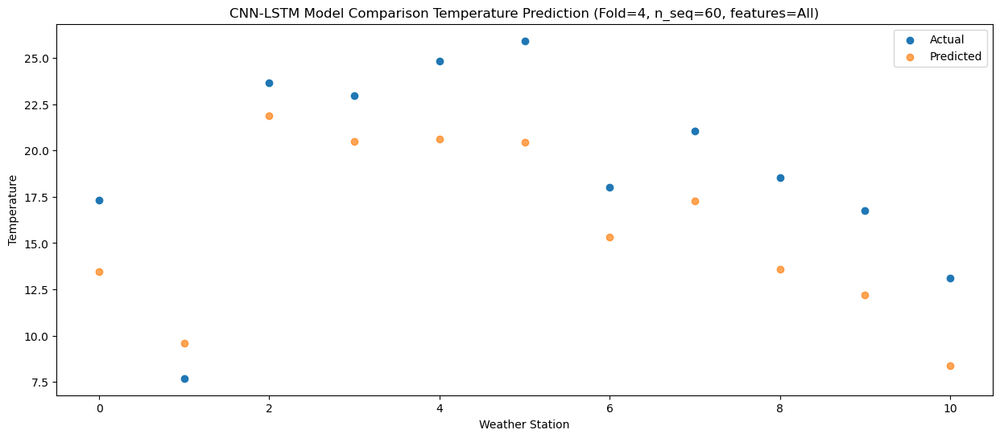

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   17.12  13.468548
1                 1    8.20   9.628453
2                 2   25.75  21.824468
3                 3   25.50  20.647387
4                 4   26.70  20.849160
5                 5   26.02  20.317951
6                 6   17.45  14.853790
7                 7   20.87  17.137947
8                 8   17.36  12.838930
9                 9   15.51  11.873708
10               10   11.77   7.170819


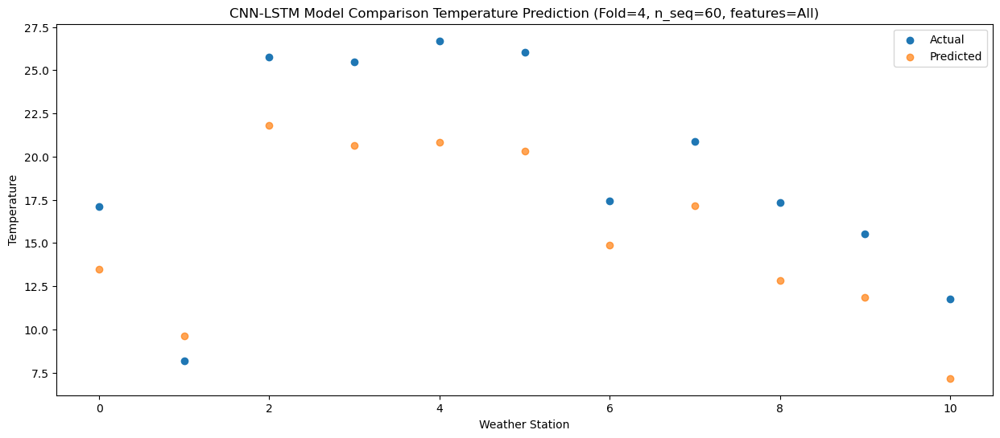

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0   14.29  10.003834
1                 1    6.10   6.047335
2                 2   22.00  18.231798
3                 3   20.80  16.967321
4                 4   21.61  17.164380
5                 5   22.54  16.699868
6                 6   13.61  11.420575
7                 7   16.93  13.600385
8                 8   14.27   9.522313
9                 9   12.47   8.511318
10               10    9.43   3.966416


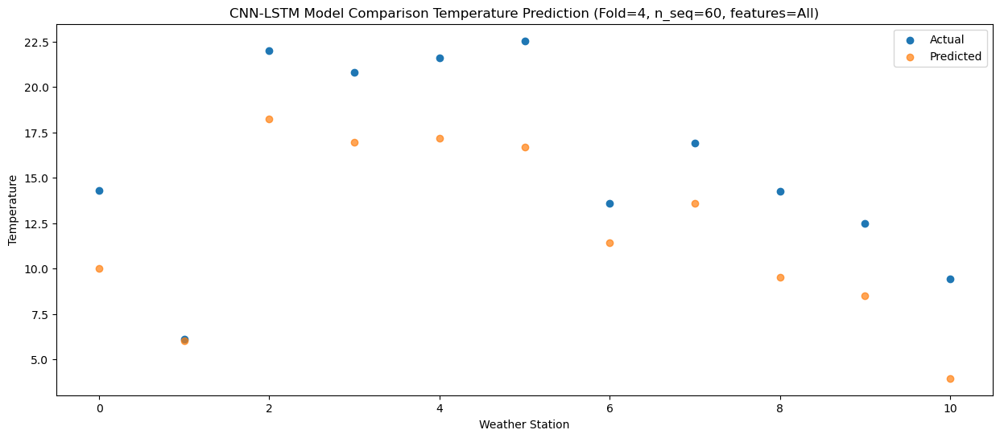

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    7.17   2.109812
1                 1    2.45   0.270321
2                 2   15.89  11.504529
3                 3   12.67   9.638764
4                 4   12.78   9.735988
5                 5   14.01   9.583408
6                 6    8.17   5.111889
7                 7   11.03   6.394248
8                 8    8.13   2.673442
9                 9    6.06   1.022252
10               10    4.17  -2.526497


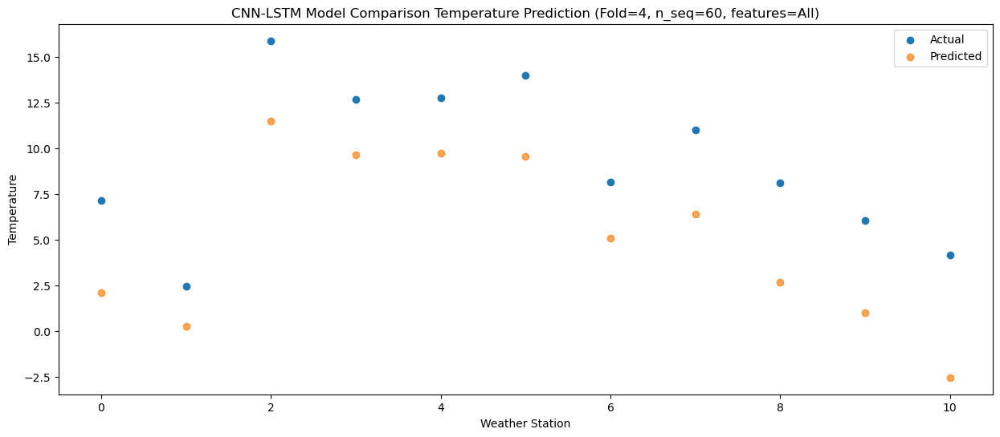

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    0.92  -4.898371
1                 1   -1.26  -5.836262
2                 2    8.93   5.001376
3                 3    6.60   3.112134
4                 4    6.25   3.195751
5                 5    7.30   2.937780
6                 6    2.44  -1.589414
7                 7    5.13  -0.355096
8                 8    1.06  -4.430583
9                 9   -1.03  -6.076155
10               10   -3.22  -9.837395


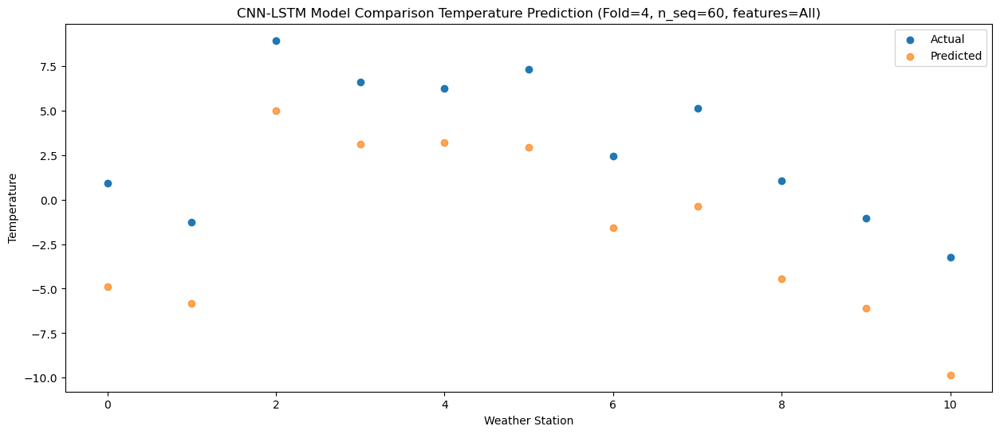

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -2.48  -7.377304
1                 1   -3.38  -7.982392
2                 2    6.38   2.689524
3                 3    3.58   0.548419
4                 4    3.12   0.592114
5                 5    4.50   0.565618
6                 6    0.23  -3.592394
7                 7    2.25  -2.695579
8                 8   -0.83  -6.353581
9                 9   -3.02  -8.303959
10               10   -3.88 -11.438527


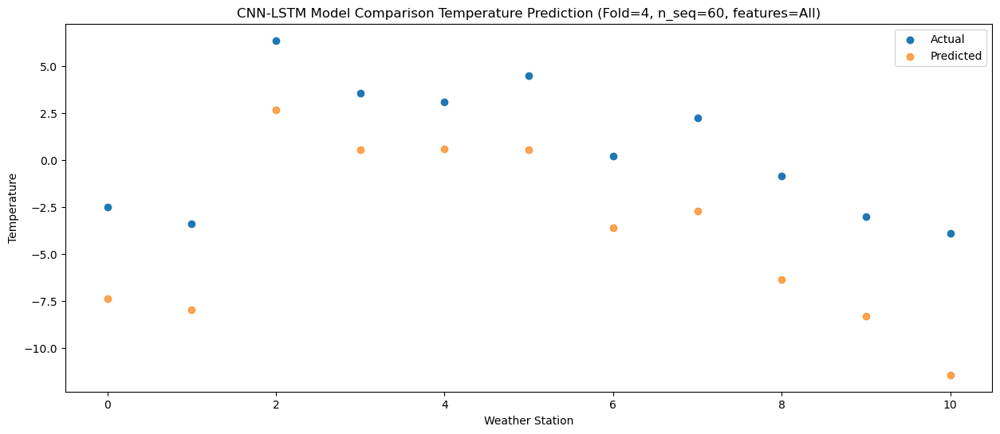

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0  -11.07 -13.935718
1                 1   -4.80 -10.825217
2                 2    2.19  -2.185558
3                 3   -1.94  -5.025801
4                 4   -2.23  -5.080103
5                 5    0.25  -4.700348
6                 6   -2.21  -7.971229
7                 7   -4.91  -8.388639
8                 8   -7.11 -12.007584
9                 9  -10.60 -14.620886
10               10   -9.65 -16.863610


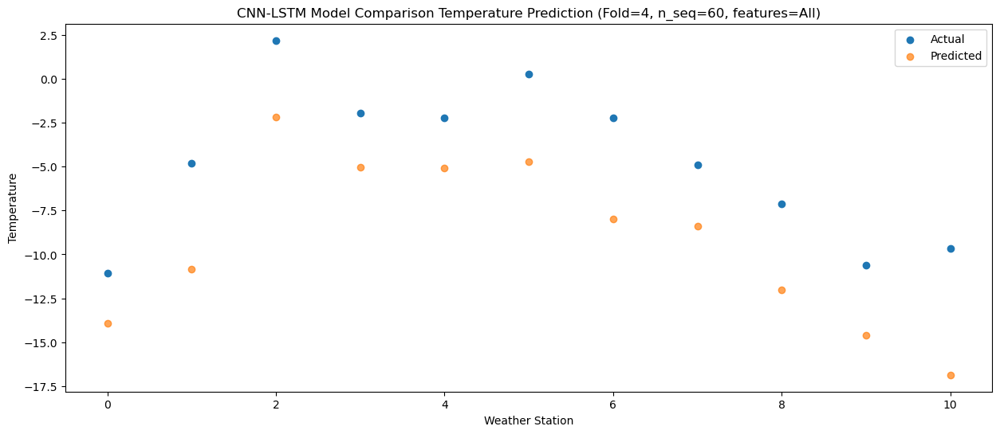

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    0.04  -6.268508
1                 1   -5.07  -7.043131
2                 2    8.51   3.833962
3                 3    6.47   2.129898
4                 4    6.09   2.221888
5                 5    7.07   1.662154
6                 6    1.20  -3.179447
7                 7    5.00  -1.635137
8                 8   -0.77  -6.278475
9                 9   -2.83  -7.677181
10               10   -6.17 -12.064543


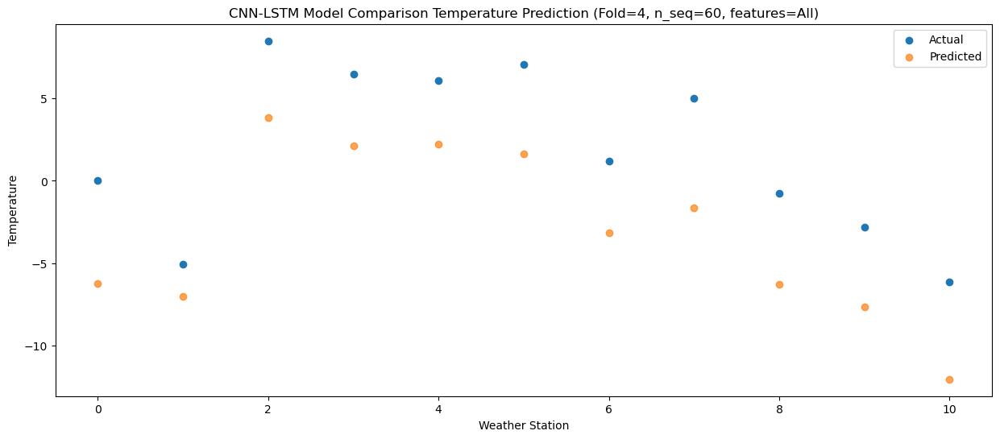

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.57  -3.049122
1                 1   -0.17  -2.770429
2                 2   10.74   7.793363
3                 3    8.88   5.658680
4                 4    8.66   5.677747
5                 5    9.67   5.178313
6                 6    4.99   1.064257
7                 7    7.43   2.038925
8                 8    3.67  -2.312472
9                 9    1.32  -4.101016
10               10   -2.82  -7.897081


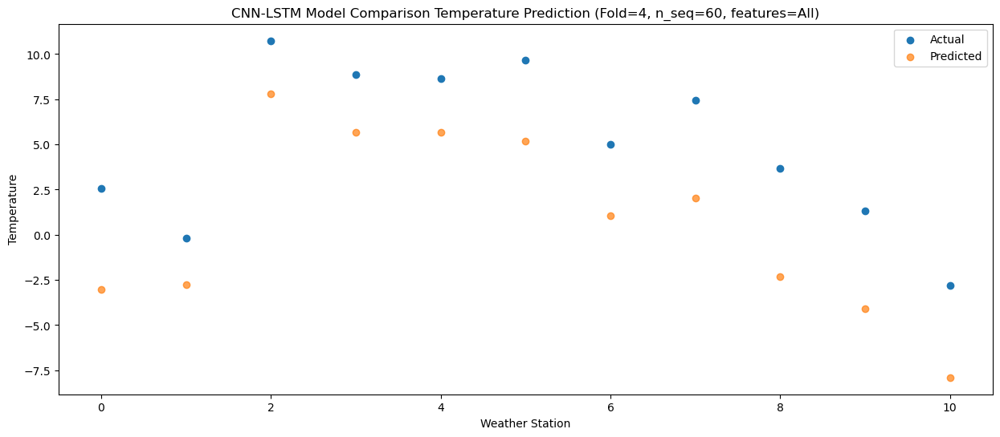

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    7.19   2.386954
1                 1    0.88   0.906890
2                 2   14.56  12.247044
3                 3   12.73  10.480747
4                 4   12.71  10.568265
5                 5   14.63   9.937055
6                 6    9.22   5.355846
7                 7   11.57   6.897429
8                 8    8.25   2.498904
9                 9    5.81   1.114322
10               10    2.90  -3.188015


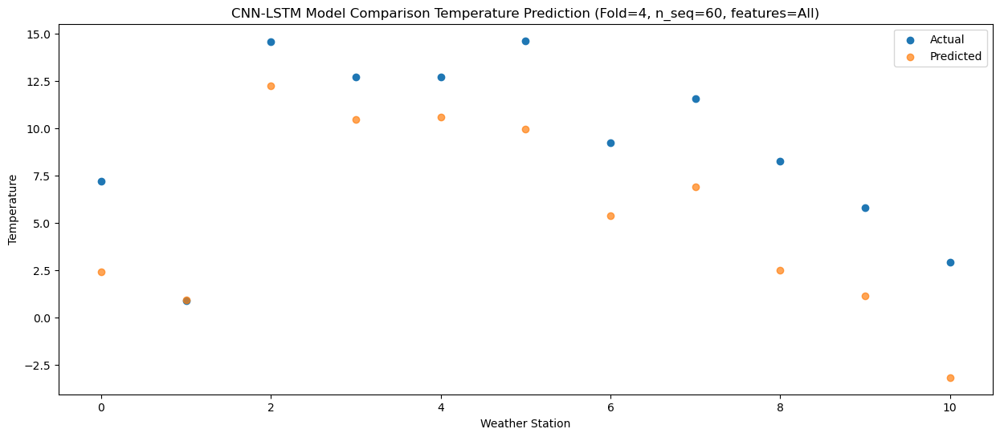

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0   12.20   7.918723
1                 1    6.33   5.689956
2                 2   20.08  17.521216
3                 3   17.49  15.640528
4                 4   17.51  15.715851
5                 5   19.92  15.092829
6                 6   13.29  10.765390
7                 7   16.22  12.308304
8                 8   14.85   8.284919
9                 9   12.84   6.845287
10               10    9.00   2.796464


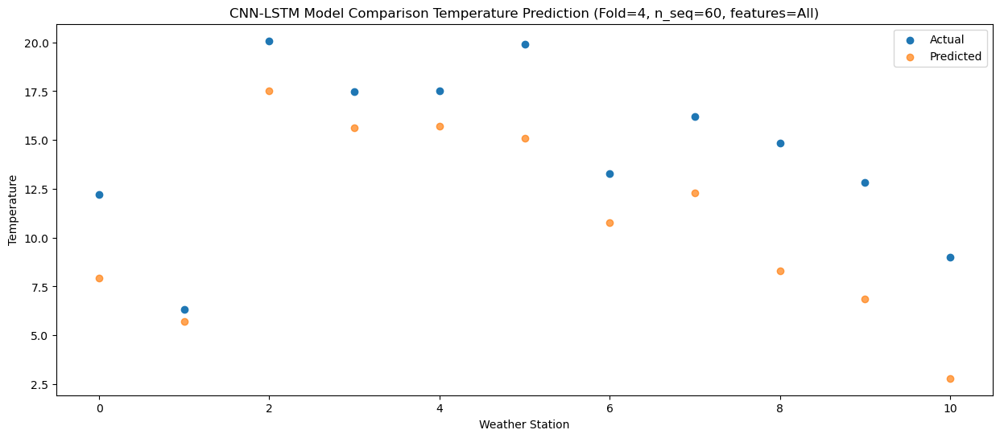

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   17.39  13.089258
1                 1    6.98   9.471608
2                 2   22.71  21.648547
3                 3   21.52  20.251154
4                 4   21.96  20.416110
5                 5   23.93  19.951352
6                 6   16.71  14.841303
7                 7   19.94  16.888821
8                 8   18.21  12.840570
9                 9   16.81  11.694191
10               10   12.16   7.368061


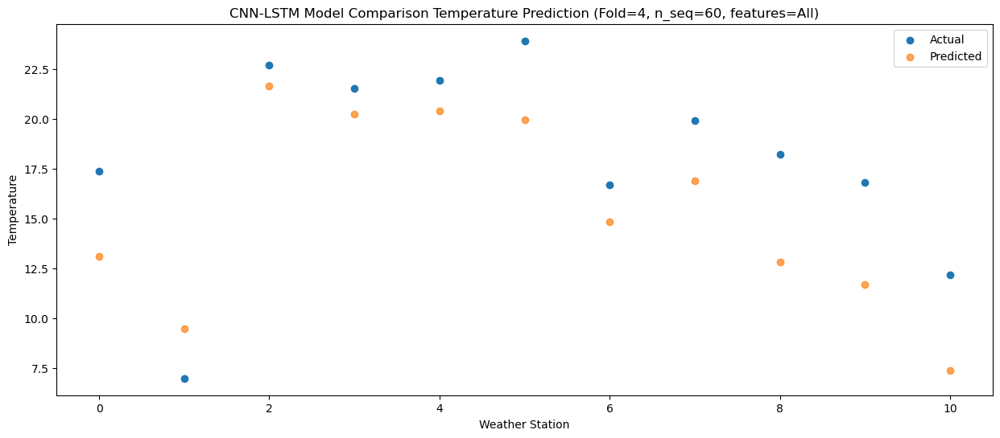

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   18.15  12.578119
1                 1    7.67   9.209507
2                 2   23.73  20.952933
3                 3   22.42  19.611777
4                 4   22.67  19.795608
5                 5   22.76  19.720496
6                 6   18.17  14.341061
7                 7   20.24  16.252061
8                 8   18.22  12.330940
9                 9   15.84  11.070374
10               10   13.68   7.099815


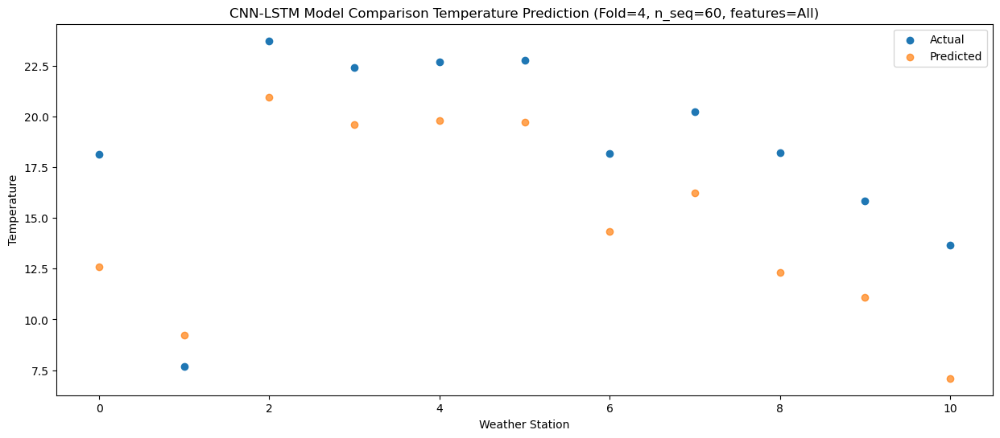

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   16.66  12.936606
1                 1    7.37   9.043408
2                 2   24.30  21.212646
3                 3   24.17  20.163943
4                 4   24.63  20.381059
5                 5   25.22  19.886571
6                 6   17.01  14.043833
7                 7   20.68  16.515164
8                 8   18.14  11.975233
9                 9   15.50  11.136374
10               10   12.54   6.239412


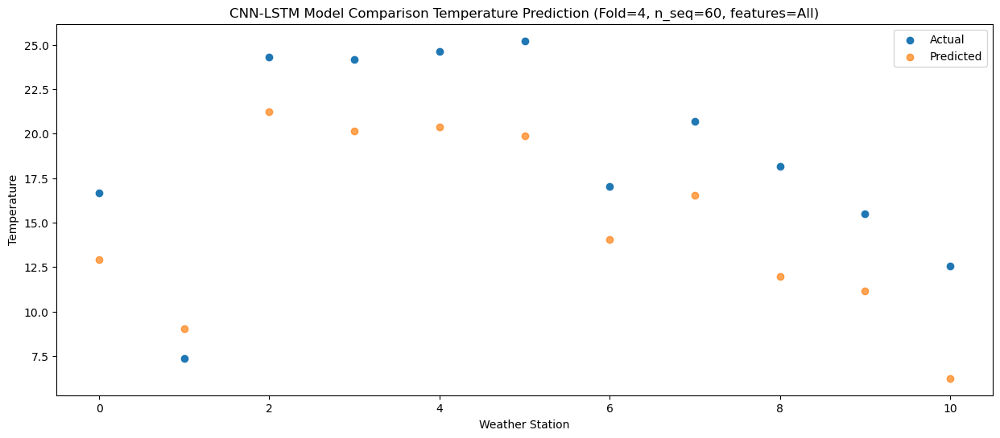

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0   14.23   9.322083
1                 1    6.50   5.768134
2                 2   20.69  17.609597
3                 3   18.78  16.478314
4                 4   18.62  16.694145
5                 5   18.77  16.300057
6                 6   14.57  10.557595
7                 7   16.54  12.858796
8                 8   15.53   8.378989
9                 9   12.27   7.520303
10               10   10.27   2.705596


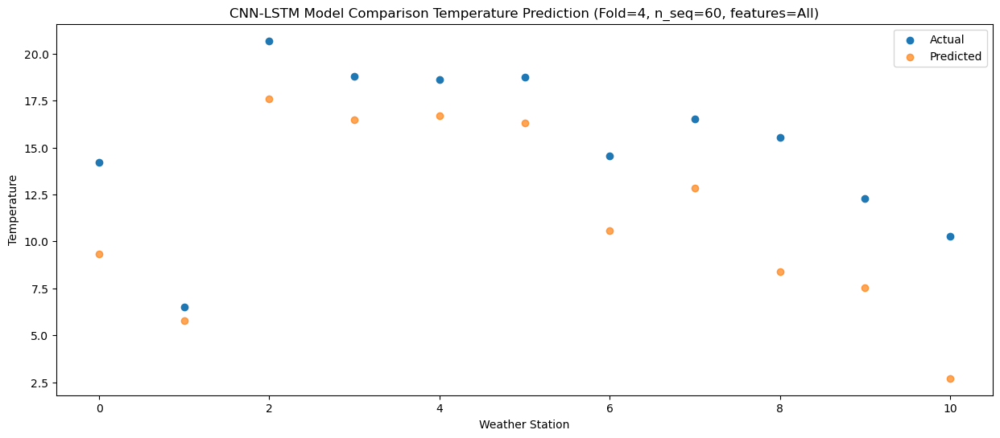

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   10.10   4.324055
1                 1    2.73   1.710656
2                 2   16.55  13.173227
3                 3   16.03  12.012278
4                 4   16.20  12.204250
5                 5   17.06  11.679337
6                 6    8.95   5.891383
7                 7   12.86   8.169252
8                 8    9.60   3.317786
9                 9    7.20   2.448865
10               10    3.80  -2.552585


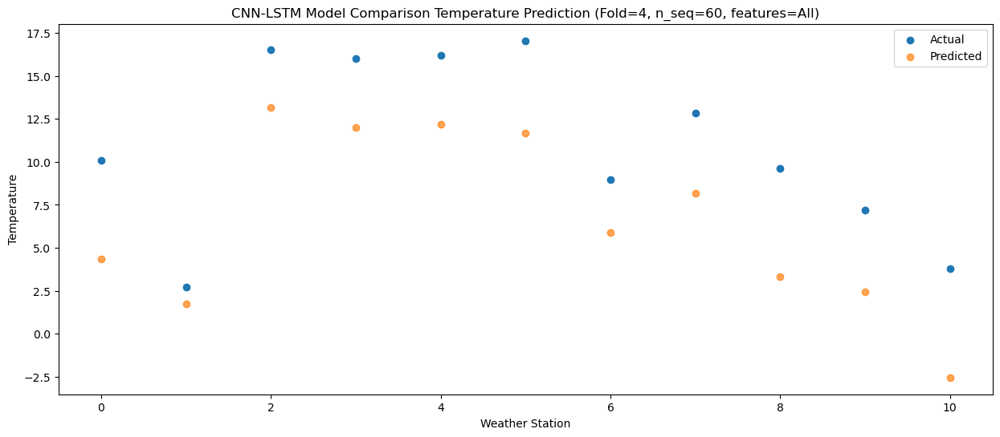

f, t:
[[ -2.86  -2.38   6.75   4.23   3.65   5.12   0.86   2.01  -2.64  -4.88
   -6.79]
 [ -4.52  -2.56   6.81   2.58   1.87   3.48   0.51   1.2   -3.46  -5.2
   -7.57]
 [ -7.48  -4.02   6.62   2.82   2.49   2.75   0.34  -0.45  -4.39  -7.64
   -8.77]
 [ -6.37  -2.47   6.88   2.49   2.11   1.99   0.81   0.12  -5.22  -7.89
   -9.58]
 [  1.16   1.6   14.68   9.95   9.99   9.55   6.42   7.05   1.6   -0.29
   -3.42]
 [  3.59   3.28  13.73  10.61  10.68  12.52   7.69   8.63   4.59   2.82
   -2.04]
 [  8.66   4.68  17.61  15.74  16.33  19.09  10.48  12.73  10.17   8.7
    4.7 ]
 [ 17.91   6.44  21.7   20.7   21.04  22.42  15.07  19.08  17.46  16.43
   11.19]
 [ 18.72   6.76  23.27  22.56  23.48  25.25  18.11  21.62  19.5   17.64
   14.63]
 [ 16.62   6.61  22.44  22.31  22.8   24.63  16.91  19.63  17.3   15.04
   12.22]
 [ 11.78   6.03  20.34  16.53  16.5   16.9   13.11  16.05  13.54  11.14
    8.23]
 [  3.73   4.53  15.    10.8   10.75  12.94   9.29   9.12   6.7    3.8
    2.07]
 [  1.54   1.

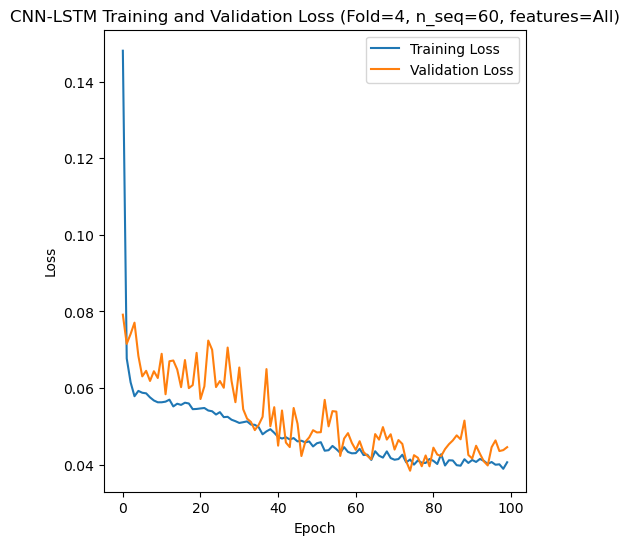

[[3.8184117897675853], [2.0972350420526693], [6.4299495427995765], [5.904582870946659], [3.5740929122456935]]
[[array(3.81841179)], [array(2.09723504)], [array(6.42994954)], [array(5.90458287)], [array(3.57409291)]]
[[3.21060722135188], [1.6808474856565385], [5.513736035032143], [4.9607592452784255], [3.1547434162878227]]
[[1.263782206976535], [0.9144934569577251], [3.107173086283716], [2.761860122214263], [1.49634244682787]]
[[0.7657583999234852], [0.9319023218863147], [0.4187781917005158], [0.6029853690020446], [0.8459751458376504]]
[[array(0.01972034)], [array(0.12635146)], [array(-0.97307345)], [array(1.35181309)], [array(0.75119492)]]
[[array(0.92634663)], [array(0.94103444)], [array(0.83917891)], [array(0.79011962)], [array(0.95772867)]]
[-2.98 -3.45 -3.72 ... 12.54 10.27  3.8 ]
[-3.34740158 -4.4187338  -4.5233064  ...  6.23941218  2.70559561
 -2.55258501]
Accuracy Results:
RMSE for each fold:
[[3.8184117897675853], [2.0972350420526693], [6.4299495427995765], [5.904582870946659],

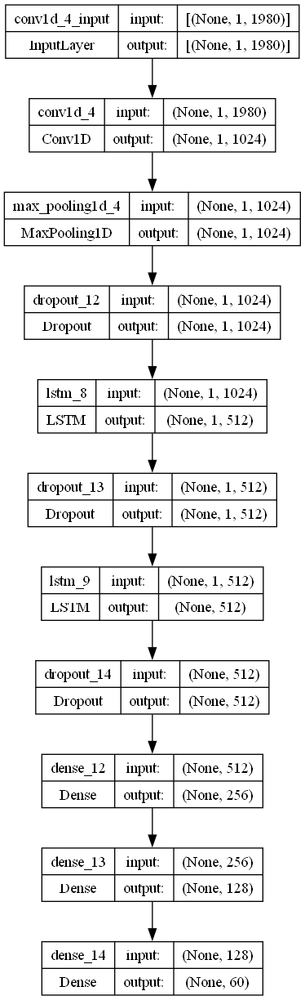

In [2]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def kmape (y_true, y_pred):
    return K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def kpearson (y_true, y_pred):
    mean_true = K.mean(y_true)
    mean_pred = K.mean(y_pred)
    return (K.square(K.mean((y_true - mean_true)*(y_pred - mean_pred))))/(K.mean(K.square(y_true - mean_true))*K.mean(K.square(y_pred - mean_pred)))

# fit the best CNN-LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from the best model
    filters = 1024
    lr = 0.19234474220376732
    optimizer = SGD(learning_rate = lr)
    activation_function = 'tanh'
    lstm_units = 512
    dropout_rate = 0.38382301488750553

    # design network
    model = Sequential()
    model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(MaxPooling1D(pool_size=1)) # CNN-LSTM only
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units, return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# Make one forecast with a CNN-LSTM
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_cnnlstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# Evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_cnnlstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# Invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # Invert the first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # Propagate the difference forecast using the inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# Inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create an array from the forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# Evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(actual, forecasts, n_lag, n_seq):

    t = np.array(actual).transpose()
    f = np.array(forecasts).transpose()

    print("f, t:")
    print(t)
    print(f)
    rmse_list = []
    mae_list = []
    skmape_list = []
    mape_list = []
    r2_list = []
    pearson_list = []
    actual_list = []

    for i in range(n_seq):
        act = [row for row in t[i]]
        predicted = [forecast for forecast in f[i]]
        rmse1 = sqrt(mean_squared_error(act, predicted))
        rmse2 = np.array(rmse(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        mae = mean_absolute_error(act, predicted)
        mse = mean_squared_error(act, predicted)
        skmape = mean_absolute_percentage_error(act, predicted)
        kmape1 = np.array(kmape(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        kpearson1 = np.array(kpearson(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        r2 = r2_score(act, predicted) 
        avg_actual = np.mean(act)
        print("Year at t+"+str(i+1)+":")
        print('t+%d SKRMSE: %f' % ((i+1), rmse1))
        print('t+%d KRMSE: %f' % ((i+1), rmse2))        
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d SKMAPE: %f' % ((i+1), skmape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))
        print('t+%d KMAPE: %f' % ((i+1), kmape1))
        print('t+%d PEARSON: %f' % ((i+1), kpearson1))
        print('t+%d AVERAGE ACTUAL: %f' % ((i+1), avg_actual))

    y_true = tf.convert_to_tensor(np.array(actual).flatten())
    y_pred = tf.convert_to_tensor(np.array(forecasts).flatten())

    rmse1 = sqrt(mean_squared_error(np.array(y_true), np.array(y_pred)))
    rmse2 = np.array(rmse(y_true, y_pred))
    mae = mean_absolute_error(np.array(y_true), np.array(y_pred))
    mse = mean_squared_error(np.array(y_true), np.array(y_pred))
    skmape = mean_absolute_percentage_error(np.array(y_true), np.array(y_pred))
    kmape1 = np.array(kmape(y_true, y_pred))
    kpearson1 = np.array(kpearson(y_true, y_pred))
    r2 = r2_score(np.array(y_true), np.array(y_pred)) 
    avg_actual = np.mean(np.array(y_true))
    rmse1_list.append(rmse1)
    rmse2_list.append(rmse2)
    mae_list.append(mae)
    skmape_list.append(skmape)
    pearson_list.append(kpearson1)
    mape_list.append(kmape1)
    r2_list.append(r2)
    actual_list.append(avg_actual)
    print("Metrics for this Fold:")
    print('SKRMSE: %f' % (rmse1))
    print('KRMSE: %f' % (rmse2))        
    print('MAE: %f' % (mae))
    print('SKMAPE: %f' % (skmape))
    print('R2_SCORE: %f' % (r2))
    print('KMAPE: %f' % (kmape1))
    print('PEARSON: %f' % (kpearson1))
    print('AVERAGE ACTUAL: %f' % (avg_actual))

    return rmse1_list, rmse2_list, mae_list, skmape_list, r2_list, mape_list, pearson_list, actual_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, actual, n_test, n_seq, n_lag):
    # Plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # Plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Temperature")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse1_avg_list = []
rmse2_avg_list = []
mae_avg_list = []
skmape_avg_list = []
r2_score_avg_list = []
mape_avg_list = []
pearson_avg_list = []
actual_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]
    
    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    print(dataset)

    series = pd.Series(dataset[:, 0]) # Using first column (temperatures)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))
    
    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test, n_seq)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    print(results_df)
    
    print("Actual and Forecasts:")
    print(actual)
    print(forecasts)
    
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Temp\tPredicted Temp\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        actual_ws = actual[j]
        
        plot_forecasts(series_ws, forecasts_ws, actual_ws, n_test, n_seq, n_lag)

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)

        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='CNN-LSTM Model Comparison Temperature Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=All)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Temperature')
        plt.legend()
        plt.show()

    rmse1_list = [] # list stores sklearn's root mean squared errors for each future time prediction
    rmse2_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores mean absolute errors for each future time prediction
    skmape_list = [] # list stores sklearn's mean squared percentage errors for each future time prediction
    r2_list = [] # list stores sklearn's r2 pearson values for each future time prediction
    mape_list = [] # list stores mean squared percentage errors for each future time prediction
    pearson_list = [] # list stores r2 pearson values for each future time prediction
    actual_list = [] # list stores average actual values for each future time prediction

    # evaluate forecasts
    rmse1_list, rmse2_list, mae_list, skmape_list, r2_list, mape_list, pearson_list, actual_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse1_avg_list.append(rmse1_list)
    rmse2_avg_list.append(rmse2_list)
    mae_avg_list.append(mae_list)
    skmape_avg_list.append(skmape_list)
    r2_score_avg_list.append(r2_list)
    mape_avg_list.append(mape_list)
    pearson_avg_list.append(pearson_list)
    actual_avg_list.append(actual_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)
            
    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'CNN-LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=All)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse1_avg_list)
print(rmse2_avg_list)
print(mae_avg_list)
print(skmape_avg_list)
print(r2_score_avg_list)
print(mape_avg_list)
print(pearson_avg_list)
print(np.array(actual_results).flatten())
print(np.array(forecast_results).flatten())
a2 = np.array(actual_results).flatten()
f2 = np.array(forecast_results).flatten()
p1 = np.array(pearson(tf.convert_to_tensor(a2), tf.convert_to_tensor(f2)))
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse1_avg_list)
print("Average SKRMSE:"+str(np.mean(rmse1_avg_list)))
print("Average KRMSE:"+str(np.mean(rmse2_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average SKMAPE:"+str(np.mean(skmape_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average PEARSON:"+str(p1))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))

# Plot model architecture
filename = "cnnlstm_model_optimized_CV_S60.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)